In [1]:
import giraffe
import matplotlib.pyplot as plt
import networkx as nx
from netZooPy.otter.otter import otter
from netZooPy.panda.panda import Panda 
import notebooks
import numpy as np
from numpy.random import default_rng
import pandas as pd
import random
import scipy
from scipy import stats
from sklearn.metrics import roc_curve, auc

In [2]:
cd ..

/Users/soel/Desktop/giraffe/notebooks


In [3]:
TF = 100  # Number of transcription factors
G = 500  # Number of genes
n = 50  # Number of samples

def generate_ppi(tf):
    sample_ppi = pd.read_csv('data/sample_data/PPI.csv') #  PPI from human data
    degree = nx.degree_histogram(nx.from_numpy_array(sample_ppi.to_numpy()))
    degree_prob = [d / np.sum(degree) for d in degree] #  Degree distribution for each node
    #  Sample degrees for each node according to distribution observed in real data
    D = random.choices(population = [i for i in range(len(degree_prob))], weights = degree_prob, k = tf)
    G = nx.expected_degree_graph(D) 
    PPI = nx.to_numpy_array(G) #  Create undirected PPI network
    np.fill_diagonal(PPI, 1) #  By definition, transcription factors interact with themselves
    giraffe.utils.check_symmetric(PPI) #  Sanity check
    return PPI

def find_cliques(ppi) :
    """
    Returns a maps from a transcription factor to the id of the cliques it belongs to
    """
    G = nx.from_numpy_array(ppi)
    cliques = {}
    idx = 0
    for i in nx.find_cliques(G):
        if len(i) > 1:
            for protein in i:
                if protein in cliques.keys():
                    cliques[protein] = cliques[protein] + [idx]
                else:
                    cliques[protein] = [idx]
            idx += 1
    # idx: number of cliques in ppi
    # map from transcription factor to its cliques (cliques of size 1 are neglected)
    return idx, cliques

def generate_tfa(ppi, n):
    tf = ppi.shape[0]
    
    cliques_no, cliques = find_cliques(ppi) #  number of cliques and map tf -> cliques_id
    cliques_quantity = np.zeros((n, cliques_no)) #  quantity for each protein complex
    
    #  Generate quantity for each complex
    for i in range(cliques_no) :
        cliques_quantity[:, i] = np.random.uniform(0, .1, n)
    
    # The quantity for each tf is the sum of the cliques it belongs to
    TFA = np.zeros((tf, n))
    for k, v in cliques.items() :
        TFA[k, :] = np.sum(cliques_quantity[:, [v]])
    
    # If a transcription factor is not part of a complex, it can still be active
    for i in range(tf) :
        if np.sum(TFA[i, :]) == 0 :
            TFA[i, :] = np.random.uniform(0, 1, n)
            
    return TFA #  Generated matrix

def generate_regulation(g, tf, ppi, sparsity = .15, a = .5) :
    rng = default_rng()
    rvs = stats.uniform(loc = -a, scale = 2 * a).rvs
    
    R = np.zeros((g, tf)) #  To store the ground-truth regulation matrix
    
    cliques_no, cliques = find_cliques(ppi) #  number of cliques and map tf -> cliques_id
    cliques_to_regulation = np.zeros((g, cliques_no)) #  How much each clique regulates the genes
    
    for i in range(cliques_no) :
        regulation = scipy.sparse.random(g, 1, sparsity, random_state = rng, data_rvs = rvs).A
        cliques_to_regulation[:, i] = regulation.flatten()
    
    for k, v in cliques.items() :
        R[:, k] = np.sum(cliques_to_regulation[:, [v]])
    
    #  If a transcription factor is not part of any clique, it can still regulate gene expression 
    for i in range(tf) :
        if np.sum(R[:, i]) == 0 :
            R[:, i] = scipy.sparse.random(g, 1, sparsity, random_state = rng, data_rvs = rvs).A.flatten()
            
    return R #  Generated matrix

def generate_motif(R, shuffle = .2):
    motif = R.copy()
    motif[motif != 0] = 1
    rng = default_rng()
    rvs = stats.uniform(loc = 1, scale = 0).rvs
    flip = scipy.sparse.random(R.shape[0], R.shape[1], shuffle, random_state = rng, data_rvs = rvs).A
    for i in range(R.shape[0]):
        for j in range(R.shape[1]):
            if flip[i, j] == 0:
                continue
            if motif[i, j] == 0:
                motif[i, j] = 1
            else:
                motif[i, j] = 0
    return motif

def compute_expression(R, TFA, confounder = None) :
    res = R.dot(np.abs(TFA))
    if confounder is None:
        return res
    return res + np.array([confounder for i in range(R.shape[0])])

In [37]:
n=50
ppi = generate_ppi(TF)
TFA = generate_tfa(ppi, n)
R = generate_regulation(G, TF, ppi, sparsity = .15, a = 1)
gene_expression = compute_expression(R, TFA)

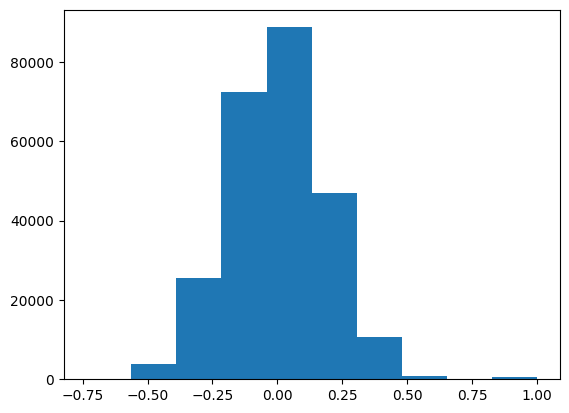

In [38]:
import seaborn as sns
import matplotlib as plt
import pylab
C = np.corrcoef(gene_expression)
pylab.figure()
pylab.hist(C[~np.isnan(C)])
pylab.show()

## GIRAFFE

In [39]:
def simulation(n = 50, shuffling = 0.2, sparsity = .15, a = 1, approx = True):
    ppi = generate_ppi(TF)
    TFA = generate_tfa(ppi, n)
    R = generate_regulation(G, TF, ppi, sparsity = sparsity, a = a)
    gene_expression = compute_expression(R, TFA)
    motif = generate_motif(R, shuffling)
    R[R != 0] = 1
    R_giraffe = giraffe.Giraffe(gene_expression, motif.copy(), ppi, lr = 1e-4,).get_regulation()
    return notebooks.plot_auroc(R, [np.abs(R_giraffe), motif], ["GIRAFFE", "Motif"], title = "AUROC, reliability of the motif = " + str(1 - shuffling), approx = approx)

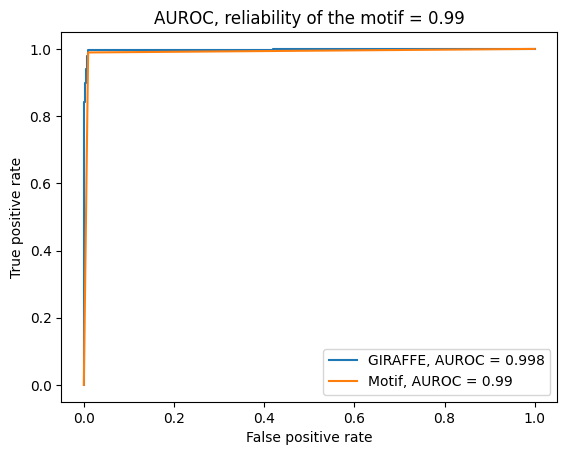

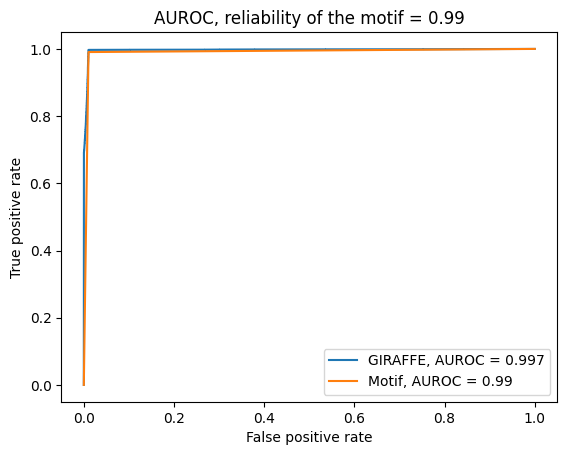

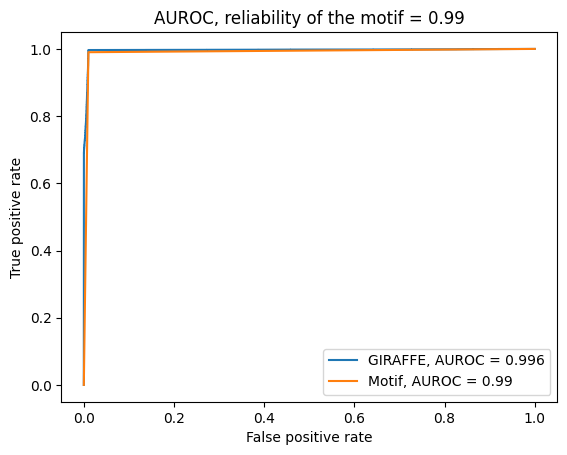

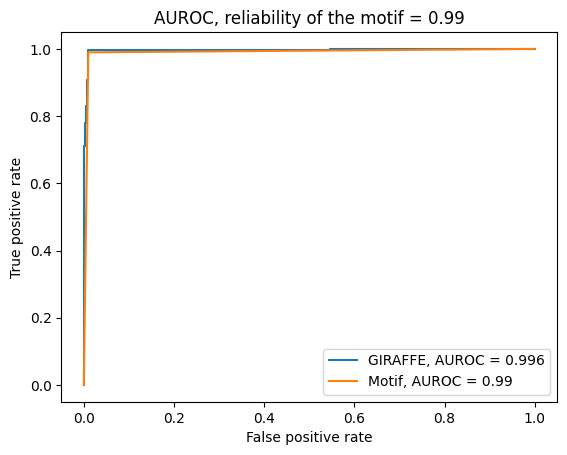

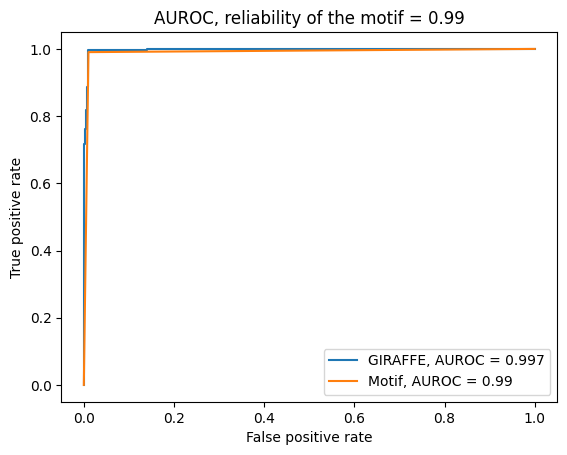

...

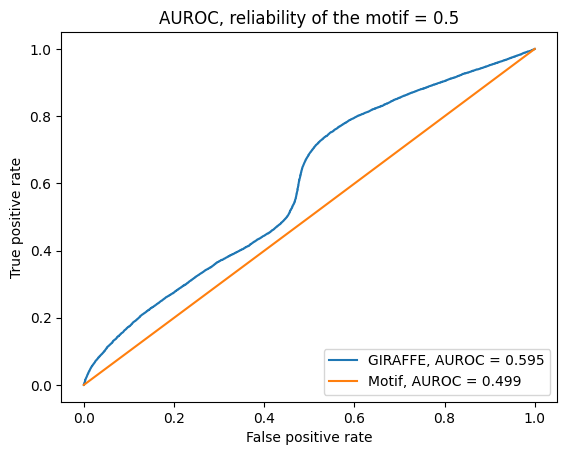

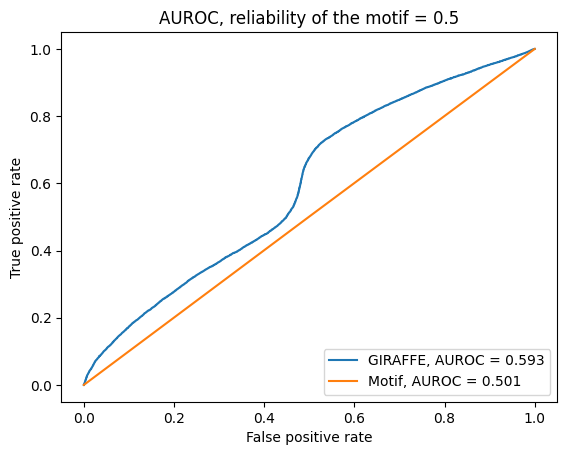

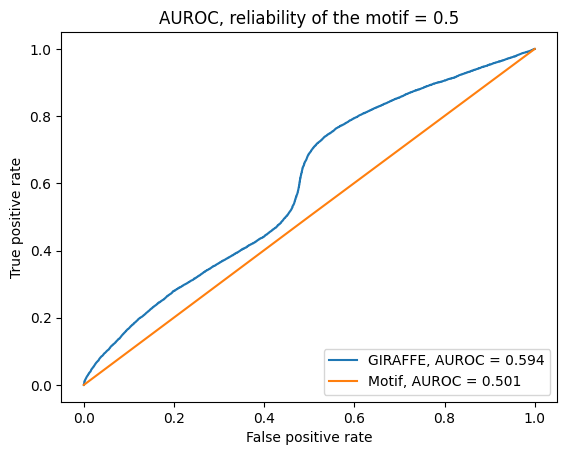

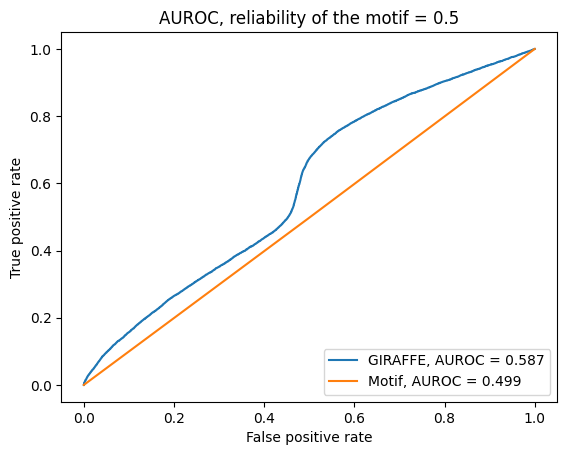

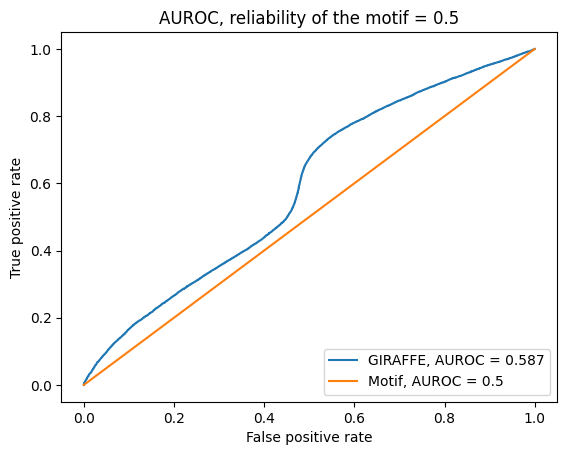

In [5]:
B = 50
res_giraffe = {}
shuffling = [0.01, 0.1, 0.2, 0.3, 0.4, 0.5]
for shuffle in shuffling:
    for i in range(B):
        score = simulation(shuffling = shuffle)[0]
        if shuffle in res_giraffe.keys():
            res_giraffe[shuffle] += [score]
        else:
            res_giraffe[shuffle] = [score]

In [6]:
for shuffle in shuffling:
    print(f"Prior reliability {1 - shuffle}: mean {np.mean(res_giraffe[shuffle])}, sd {np.std(res_giraffe[shuffle])}")

Prior reliability 0.99: mean 0.9965600000000001, sd 0.0005351635264103866
Prior reliability 0.9: mean 0.96494, sd 0.0009035485598461223
Prior reliability 0.8: mean 0.9278199999999999, sd 0.0009526804291051652
Prior reliability 0.7: mean 0.86114, sd 0.0016125755796241009
Prior reliability 0.6: mean 0.7739999999999999, sd 0.002720294101747091
Prior reliability 0.5: mean 0.5926199999999999, sd 0.004127420501960036


## OTTER

In [7]:
def simulation(n = 50, shuffling = 0.2, sparsity = .15, a = 1, approx = True):
    ppi = generate_ppi(TF)
    TFA = generate_tfa(ppi, n)
    R = generate_regulation(G, TF, ppi, sparsity = sparsity, a = a)
    gene_expression = compute_expression(R, TFA)
    motif = generate_motif(R, shuffling)
    
    R_otter = otter(motif.copy().T, ppi, np.corrcoef(gene_expression), Iter = 200).T
    return notebooks.plot_auroc(R, [R_otter, motif], ["OTTER", "Motif"], title = "AUROC, reliability of the motif = " + str(1 - shuffling), approx = approx)

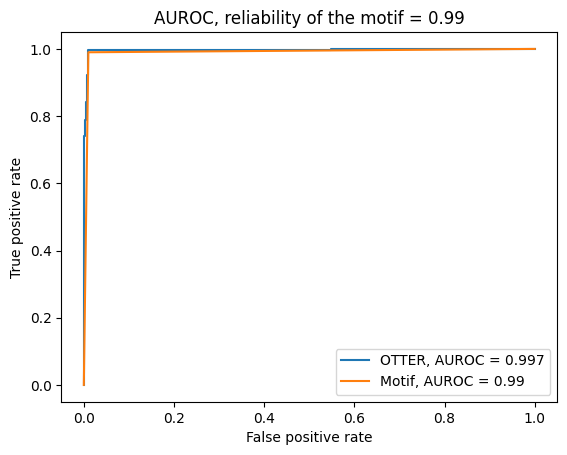

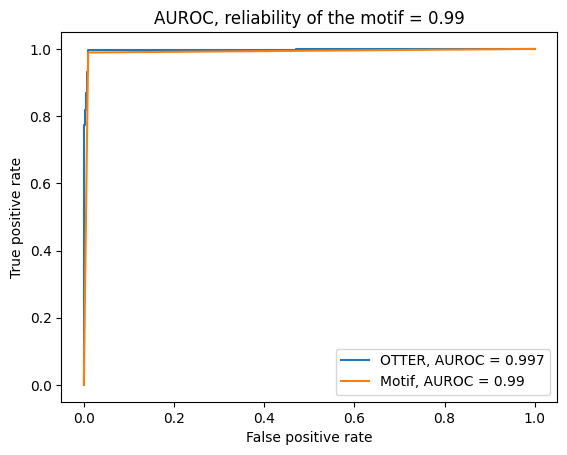

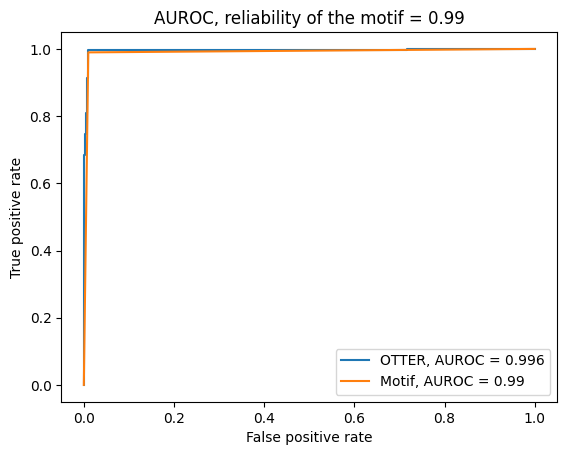

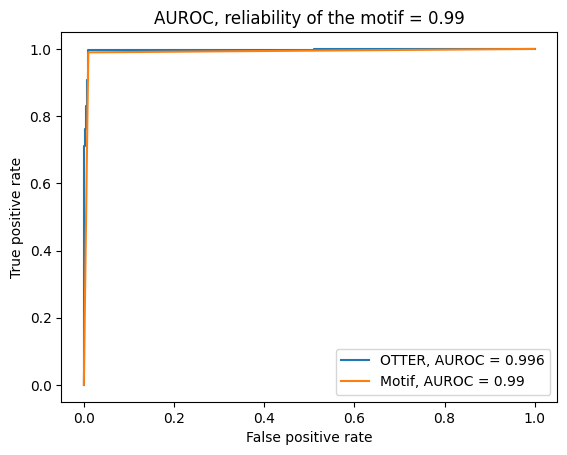

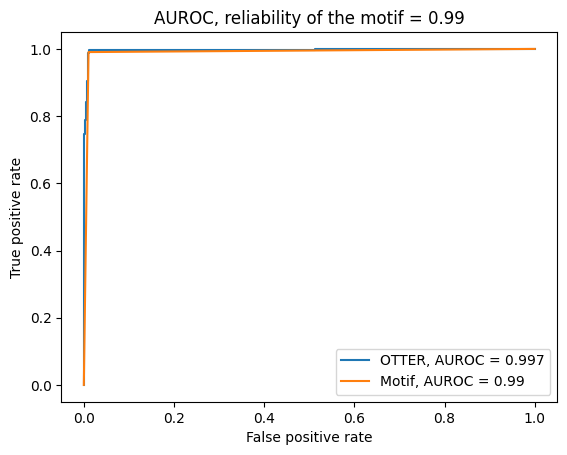

...

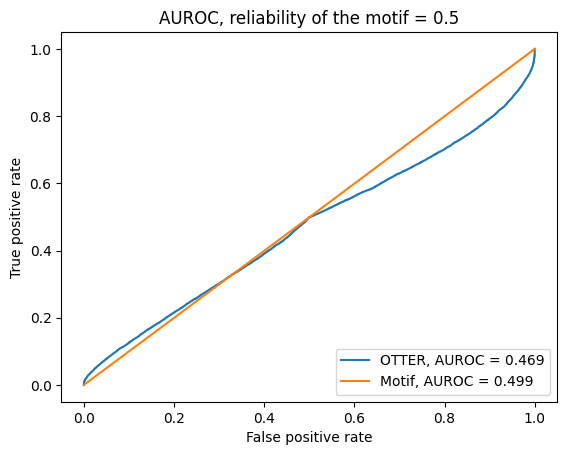

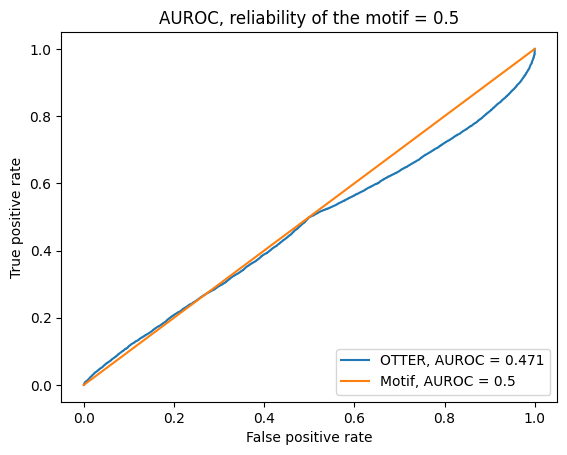

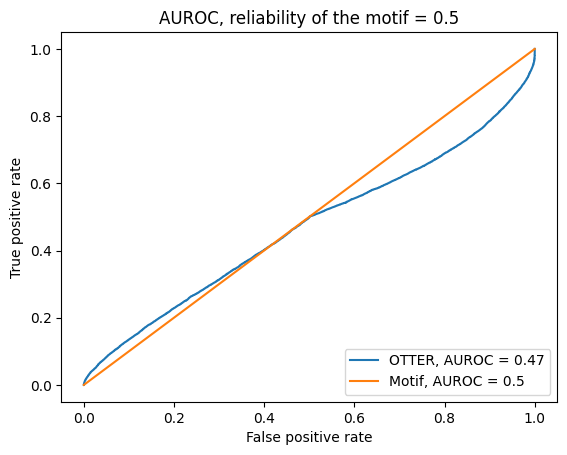

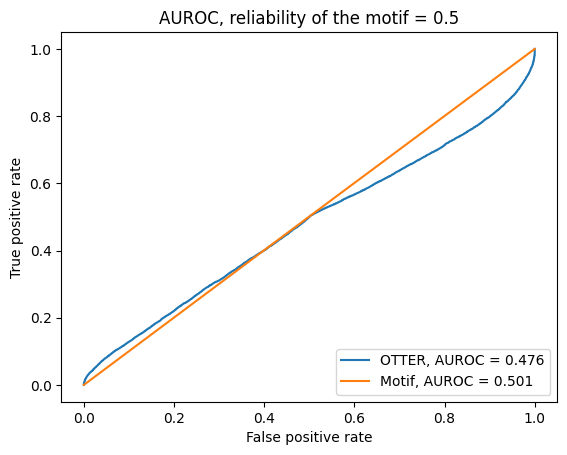

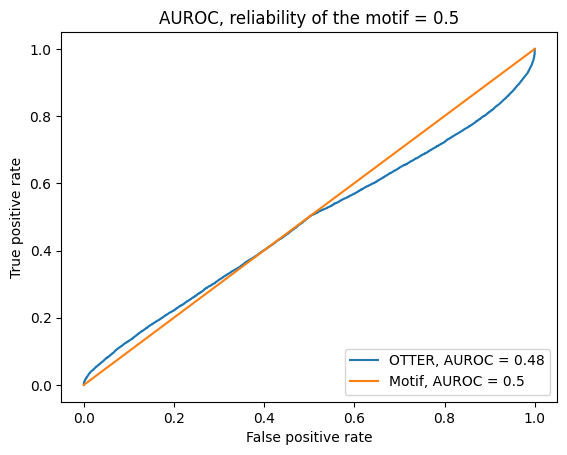

/Users/soel/Library/Python/3.9/lib/python/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/Users/soel/Library/Python/3.9/lib/python/site-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


ValueError: Input contains NaN.

In [8]:
B = 50
res_otter = {}
shuffling = [0.01, 0.1, 0.2, 0.3, 0.4, 0.5]
for shuffle in shuffling:
    for i in range(B):
        score = simulation(shuffling = shuffle)[0]
        if shuffle in res_otter.keys():
            res_otter[shuffle] += [score]
        else:
            res_otter[shuffle] = [score]

In [9]:
for shuffle in shuffling:
    print(f"Prior reliability {1 - shuffle}: mean {np.mean(res_otter[shuffle])}, sd {np.std(res_otter[shuffle])}")

Prior reliability 0.99: mean 0.9967, sd 0.0006082762530298225
Prior reliability 0.9: mean 0.9632999999999999, sd 0.004243819034784593
Prior reliability 0.8: mean 0.9141400000000002, sd 0.005905963088269352
Prior reliability 0.7: mean 0.8486600000000002, sd 0.008869295349688167
Prior reliability 0.6: mean 0.7390199999999999, sd 0.012357167960337848
Prior reliability 0.5: mean 0.4715, sd 0.0037969285832981634


## PANDA

In [10]:
def simulation(n = 50, shuffling = 0.2, sparsity = .15, a = 1, approx = True):
    ppi = generate_ppi(TF)
    TFA = generate_tfa(ppi, n)
    R = generate_regulation(G, TF, ppi, sparsity = sparsity, a = a)
    gene_expression = compute_expression(R, TFA)
    motif = generate_motif(R, shuffling)
    
    R_panda = notebooks.compute_panda_locally(gene_expression, motif, ppi)
    return notebooks.plot_auroc(R, [R_panda, motif], ["PANDA", "Motif"], title = "AUROC, reliability of the motif = " + str(1 - shuffling), approx = approx)

0.01
Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 138
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5040099370209417
step: 1, hamming: 0.44325000737869047
step: 2, hamming: 0.5276720455761512
step: 3, hamming: 0.5702855146735023
step: 4, hamming: 0.5915767653718694
step: 5, hamming: 0.5968406410201544
step: 6, hamming: 0.5887549679374471
step: 7, hamming: 0.5696820975502133
step: 8, hamming: 0.5420247333281758
step: 9, hamming: 0.5081351201493206
step: 10, hamming: 0.4701723786402474
step: 11, hamming: 0.4300059531426565
step: 12, hamming: 0.38918064959566256
step: 13, hamming: 0.34892166860127855
step: 14, hamming: 0.31016036711185396
step: 15, hamming: 0.2735678663376574
step: 16, hamming: 0.2395914397

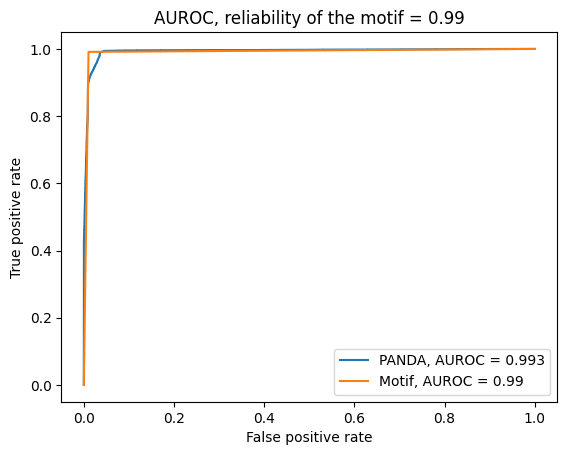

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 188
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5407446483273044
step: 1, hamming: 0.5857833044188343
step: 2, hamming: 0.6925006510698927
step: 3, hamming: 0.7538827045835134
step: 4, hamming: 0.7910688098806974
step: 5, hamming: 0.8086927304426668
step: 6, hamming: 0.809590739805188
step: 7, hamming: 0.7964933288070071
step: 8, hamming: 0.7719882754431543
step: 9, hamming: 0.7384241990735495
step: 10, hamming: 0.69789076995907
step: 11, hamming: 0.6522470111237155
step: 12, hamming: 0.6031791096623429
step: 13, hamming: 0.5522227446089422
step: 14, hamming: 0.5007526723985076
step: 15, hamming: 0.4499663351321784
step: 16, hamming: 0.4008689348751105
step:

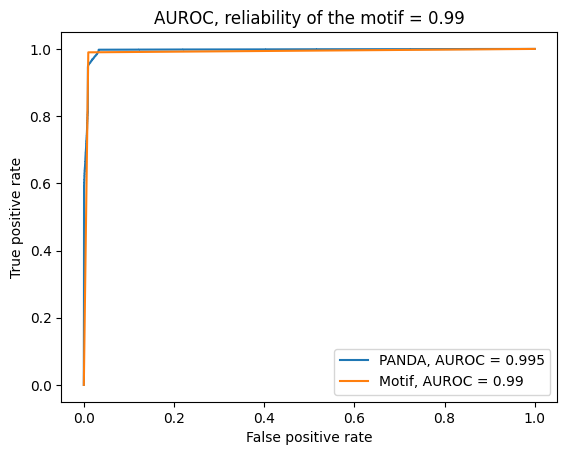

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 178
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5359726065977468
step: 1, hamming: 0.5748087765261499
step: 2, hamming: 0.6763508509913554
step: 3, hamming: 0.7336812475733894
step: 4, hamming: 0.7673486423143936
step: 5, hamming: 0.781648320549979
step: 6, hamming: 0.7791421841187013
step: 7, hamming: 0.7625240241003208
step: 8, hamming: 0.7345264824076899
step: 9, hamming: 0.6976733809395637
step: 10, hamming: 0.6542156729305363
step: 11, hamming: 0.6061795348700069
step: 12, hamming: 0.5554140132921402
step: 13, hamming: 0.5035853658950895
step: 14, hamming: 0.4521417744439764
step: 15, hamming: 0.40228190617907605
step: 16, hamming: 0.3549392729299589
st

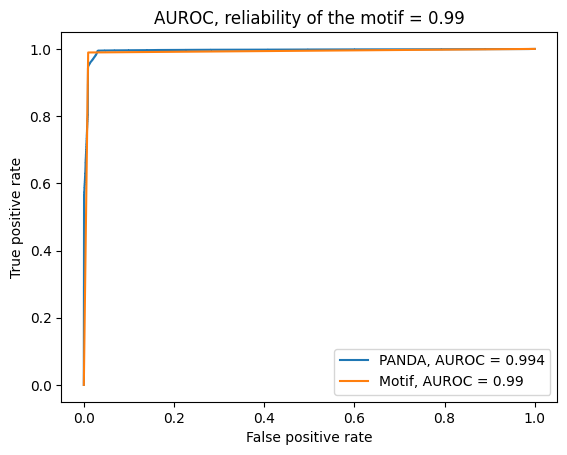

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 188
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5547507807957157
step: 1, hamming: 0.6019495667157501
step: 2, hamming: 0.7055536462781453
step: 3, hamming: 0.7668744984409773
step: 4, hamming: 0.8043576266903544
step: 5, hamming: 0.8216923201301933
step: 6, hamming: 0.8214147898330749
step: 7, hamming: 0.8063572275381395
step: 8, hamming: 0.7792806078338556
step: 9, hamming: 0.7426803517162162
step: 10, hamming: 0.698801559966245
step: 11, hamming: 0.6497069681435347
step: 12, hamming: 0.5973072153252221
step: 13, hamming: 0.5433467567390056
step: 14, hamming: 0.4893671600235905
step: 15, hamming: 0.4366731052748517
step: 16, hamming: 0.38631259786415006
st

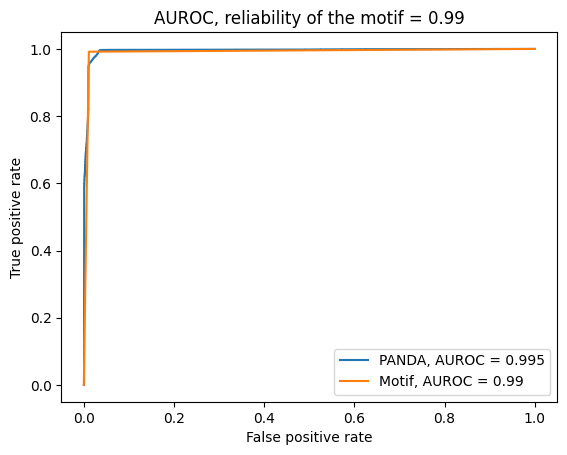

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 186
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5565761006878439
step: 1, hamming: 0.5812334500582814
step: 2, hamming: 0.6997473970861056
step: 3, hamming: 0.771368150197048
step: 4, hamming: 0.8193591091947194
step: 5, hamming: 0.8491403856450137
step: 6, hamming: 0.8637962145594652
step: 7, hamming: 0.8660524390784385
step: 8, hamming: 0.8582934089390025
step: 9, hamming: 0.8424516571335292
step: 10, hamming: 0.8200469804261287
step: 11, hamming: 0.792284845263459
step: 12, hamming: 0.7601477585802255
step: 13, hamming: 0.7244651873286915
step: 14, hamming: 0.6859643378438698
step: 15, hamming: 0.6453060322829297
step: 16, hamming: 0.603108916836825
step:

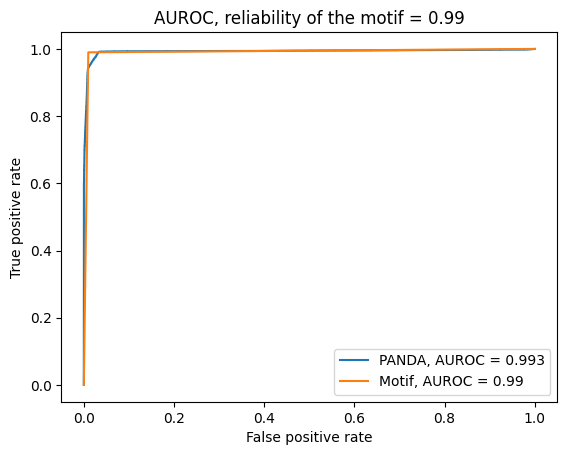

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5559489877145022
step: 1, hamming: 0.6068986578159643
step: 2, hamming: 0.7152268741789762
step: 3, hamming: 0.7794952265945472
step: 4, hamming: 0.8193210540979396
step: 5, hamming: 0.8386729120621087
step: 6, hamming: 0.8403595883668198
step: 7, hamming: 0.8272506345159418
step: 8, hamming: 0.8019707395120149
step: 9, hamming: 0.7668472193767935
step: 10, hamming: 0.7240329659063185
step: 11, hamming: 0.6755435212801252
step: 12, hamming: 0.6232818861810824
step: 13, hamming: 0.5690345627241342
step: 14, hamming: 0.5144117996826688
step: 15, hamming: 0.46077907556969705
step: 16, hamming: 0.40922876034735933


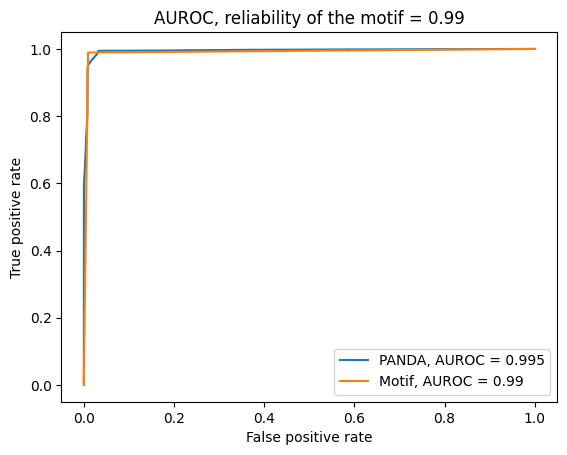

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 190
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5241662629359962
step: 1, hamming: 0.5356135644360316
step: 2, hamming: 0.6368210522094259
step: 3, hamming: 0.6927833371403327
step: 4, hamming: 0.7252166262993506
step: 5, hamming: 0.7388782155305
step: 6, hamming: 0.7363149439182313
step: 7, hamming: 0.7201106667662471
step: 8, hamming: 0.6929231143796981
step: 9, hamming: 0.6572549583389214
step: 10, hamming: 0.6153691577439132
step: 11, hamming: 0.5692921933509879
step: 12, hamming: 0.5208305950098789
step: 13, hamming: 0.47156965571936704
step: 14, hamming: 0.42286052634222226
step: 15, hamming: 0.3758066739587991
step: 16, hamming: 0.33125670475206903
st

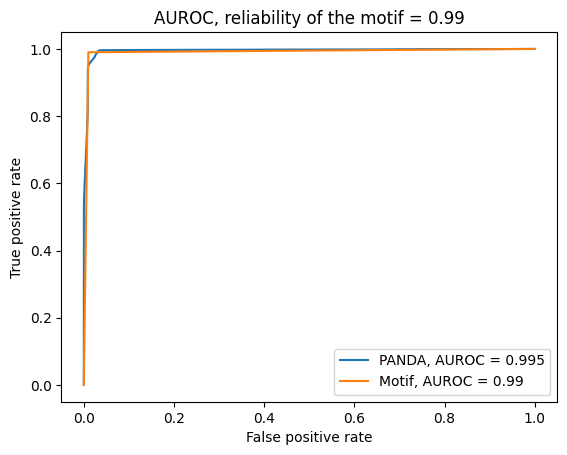

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 150
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5235380742254945
step: 1, hamming: 0.5237746390890694
step: 2, hamming: 0.6183840583360668
step: 3, hamming: 0.6697945777930088
step: 4, hamming: 0.6984203932682499
step: 5, hamming: 0.7088223261682235
step: 6, hamming: 0.7035430384630375
step: 7, hamming: 0.685166020512633
step: 8, hamming: 0.6563509086534947
step: 9, hamming: 0.6196254658987806
step: 10, hamming: 0.577294199309485
step: 11, hamming: 0.5314191283639159
step: 12, hamming: 0.4838099533520645
step: 13, hamming: 0.43600762488910644
step: 14, hamming: 0.3892724145136337
step: 15, hamming: 0.344584283364123
step: 16, hamming: 0.30265548646521795
ste

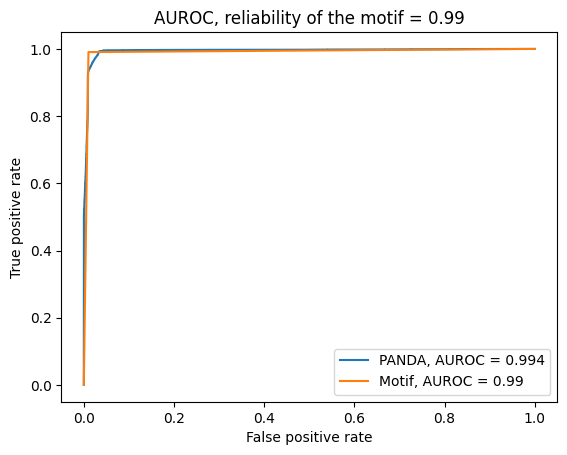

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 176
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.540428795934497
step: 1, hamming: 0.5786928049876263
step: 2, hamming: 0.679418756681512
step: 3, hamming: 0.7365423001843703
step: 4, hamming: 0.769614665065509
step: 5, hamming: 0.7828746183070737
step: 6, hamming: 0.7788430662889779
step: 7, hamming: 0.7603083448433615
step: 8, hamming: 0.7301611059309508
step: 9, hamming: 0.6911299444296218
step: 10, hamming: 0.6456755222538195
step: 11, hamming: 0.596005923518325
step: 12, hamming: 0.5440832202451847
step: 13, hamming: 0.4916108954356875
step: 14, hamming: 0.4400107091254631
step: 15, hamming: 0.3904105147274543
step: 16, hamming: 0.34365057465702353
step:

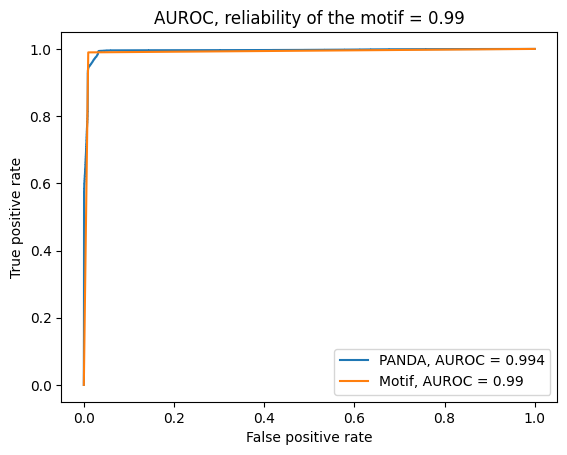

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5473792837495786
step: 1, hamming: 0.5802334991379872
step: 2, hamming: 0.6953540366286458
step: 3, hamming: 0.7640187107741667
step: 4, hamming: 0.8087999795845371
step: 5, hamming: 0.8349971611847231
step: 6, hamming: 0.8455757681638986
step: 7, hamming: 0.8431043809506069
step: 8, hamming: 0.8298755869767284
step: 9, hamming: 0.8078423617999175
step: 10, hamming: 0.7786629164725715
step: 11, hamming: 0.7437661089510632
step: 12, hamming: 0.7043939561738232
step: 13, hamming: 0.6616490856869263
step: 14, hamming: 0.6165358082492454
step: 15, hamming: 0.5699867186642149
step: 16, hamming: 0.5228725915367275
st

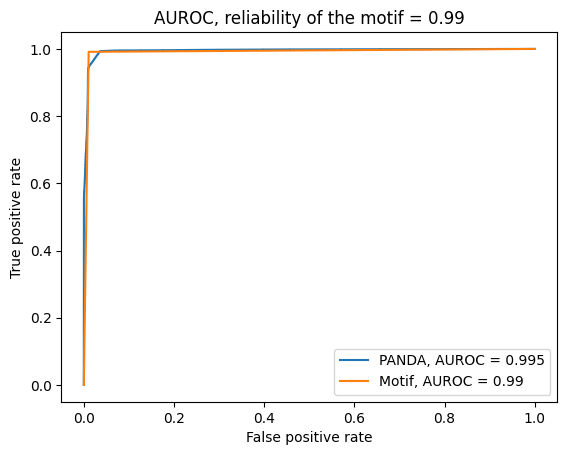

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 156
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5378981929031624
step: 1, hamming: 0.5397795720870842
step: 2, hamming: 0.6347417706307108
step: 3, hamming: 0.6871772334467278
step: 4, hamming: 0.7166422495747694
step: 5, hamming: 0.7274033957990725
step: 6, hamming: 0.7218280572712796
step: 7, hamming: 0.7025231082622737
step: 8, hamming: 0.6722698032295976
step: 9, hamming: 0.6337300618601778
step: 10, hamming: 0.5893465091817046
step: 11, hamming: 0.5413229221589123
step: 12, hamming: 0.4916036056961138
step: 13, hamming: 0.44184287122115223
step: 14, hamming: 0.39338183411411853
step: 15, hamming: 0.3472445645984988
step: 16, hamming: 0.3041539644069305


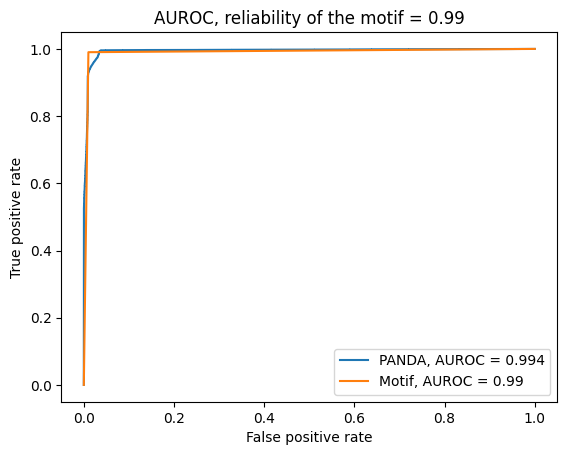

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 164
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5470705327523273
step: 1, hamming: 0.5781028422907185
step: 2, hamming: 0.6793159957314526
step: 3, hamming: 0.7371961360502879
step: 4, hamming: 0.7710797943241042
step: 5, hamming: 0.7854331409523343
step: 6, hamming: 0.783019237644008
step: 7, hamming: 0.7666444877152989
step: 8, hamming: 0.7389966793600742
step: 9, hamming: 0.7025930380710249
step: 10, hamming: 0.6597453808035142
step: 11, hamming: 0.6125352325275147
step: 12, hamming: 0.5627835644211782
step: 13, hamming: 0.5120501090780083
step: 14, hamming: 0.4616503431783793
step: 15, hamming: 0.41266525989755837
step: 16, hamming: 0.3659456350357375
st

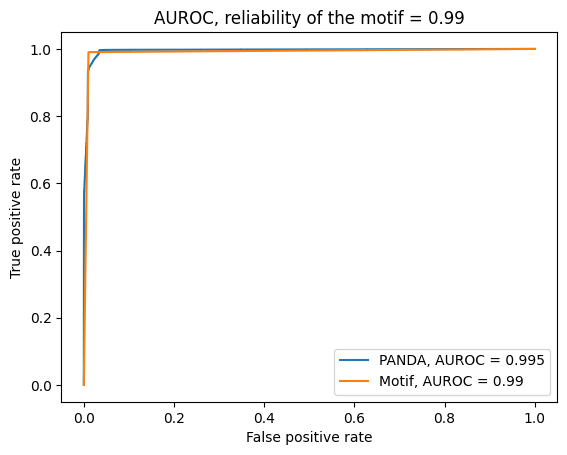

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 190
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5393576477110605
step: 1, hamming: 0.5622661258030621
step: 2, hamming: 0.6616091914538711
step: 3, hamming: 0.7176318218024588
step: 4, hamming: 0.7490473064942238
step: 5, hamming: 0.7604438476569916
step: 6, hamming: 0.7546064748206697
step: 7, hamming: 0.7343552642001436
step: 8, hamming: 0.7025521944937737
step: 9, hamming: 0.6619603429679659
step: 10, hamming: 0.6151721232128765
step: 11, hamming: 0.5645517891628227
step: 12, hamming: 0.5121789741897252
step: 13, hamming: 0.4598127306046133
step: 14, hamming: 0.4088739850190529
step: 15, hamming: 0.3604454300169659
step: 16, hamming: 0.3152880761166703
st

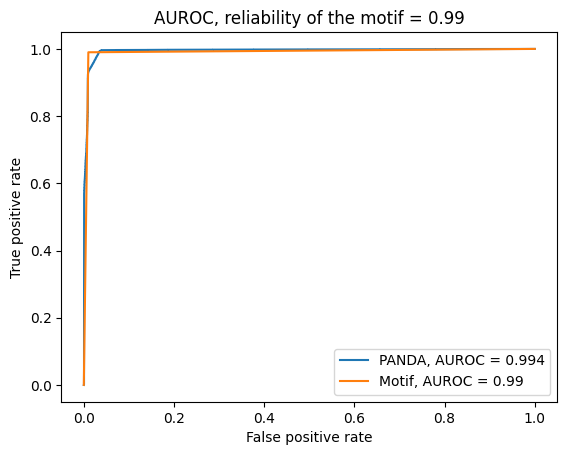

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 148
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5491870732328965
step: 1, hamming: 0.5621737601359659
step: 2, hamming: 0.662517177819424
step: 3, hamming: 0.7208857405660503
step: 4, hamming: 0.7561417962086572
step: 5, hamming: 0.772471995547764
step: 6, hamming: 0.7724566259637832
step: 7, hamming: 0.7586408315527986
step: 8, hamming: 0.7335462729186568
step: 9, hamming: 0.6995228455443808
step: 10, hamming: 0.658708773739959
step: 11, hamming: 0.6130383591573475
step: 12, hamming: 0.5642644610849121
step: 13, hamming: 0.5139703492403963
step: 14, hamming: 0.46356079812765244
step: 15, hamming: 0.4142405283433968
step: 16, hamming: 0.36699119912420386
ste

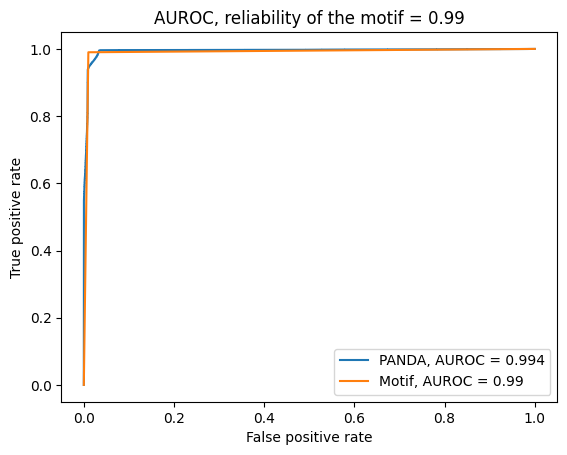

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5337473747463652
step: 1, hamming: 0.5711299951457532
step: 2, hamming: 0.6761180096026715
step: 3, hamming: 0.7362895716772877
step: 4, hamming: 0.7720235850564042
step: 5, hamming: 0.7880052470645079
step: 6, hamming: 0.7869845294290927
step: 7, hamming: 0.7716756873263463
step: 8, hamming: 0.7447589831885157
step: 9, hamming: 0.7087330229742832
step: 10, hamming: 0.6658748992172874
step: 11, hamming: 0.6182421120472804
step: 12, hamming: 0.5676909827137133
step: 13, hamming: 0.5158834134021193
step: 14, hamming: 0.4642723053834937
step: 15, hamming: 0.4140666711893851
step: 16, hamming: 0.3662198789505357
st

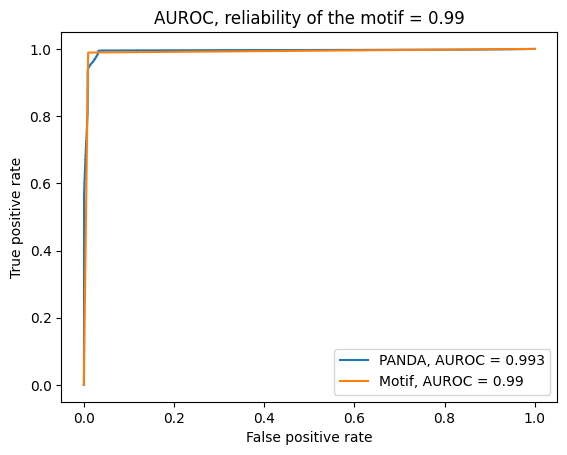

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5383799640240052
step: 1, hamming: 0.5887385146882063
step: 2, hamming: 0.7036896681461927
step: 3, hamming: 0.7717921204973431
step: 4, hamming: 0.8158005884754365
step: 5, hamming: 0.8405372509003457
step: 6, hamming: 0.8487917574618569
step: 7, hamming: 0.8431589466924857
step: 8, hamming: 0.8259598295553433
step: 9, hamming: 0.7991768379515557
step: 10, hamming: 0.764513650985582
step: 11, hamming: 0.7235076453394105
step: 12, hamming: 0.677607330279267
step: 13, hamming: 0.6282189636342389
step: 14, hamming: 0.5767096921012097
step: 15, hamming: 0.5243799812174759
step: 16, hamming: 0.47242587933173247
ste

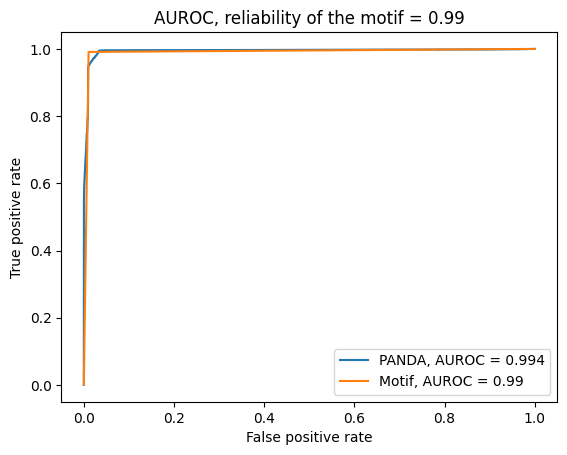

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 214
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5532093374907872
step: 1, hamming: 0.5991628068188104
step: 2, hamming: 0.7083108609692235
step: 3, hamming: 0.7720137935049218
step: 4, hamming: 0.8110966676386976
step: 5, hamming: 0.8299080431878634
step: 6, hamming: 0.8313990566551859
step: 7, hamming: 0.8185847567969118
step: 8, hamming: 0.794163161472992
step: 9, hamming: 0.7604932495260157
step: 10, hamming: 0.7196619142213111
step: 11, hamming: 0.6735574100869118
step: 12, hamming: 0.6238883264776736
step: 13, hamming: 0.5722230326360843
step: 14, hamming: 0.519963790547979
step: 15, hamming: 0.4683242065263366
step: 16, hamming: 0.4183144212477077
step

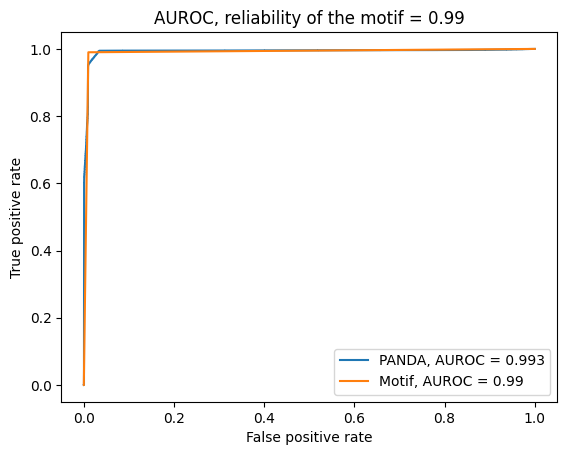

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 208
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5413976143745347
step: 1, hamming: 0.5719615080736913
step: 2, hamming: 0.676053612519504
step: 3, hamming: 0.7340229382331627
step: 4, hamming: 0.7673335571499367
step: 5, hamming: 0.7805944761893003
step: 6, hamming: 0.7766435736579052
step: 7, hamming: 0.758341749026697
step: 8, hamming: 0.72849309022203
step: 9, hamming: 0.6896979204506339
step: 10, hamming: 0.6443447488544282
step: 11, hamming: 0.5946231141540023
step: 12, hamming: 0.5425208733199691
step: 13, hamming: 0.4897936392852049
step: 14, hamming: 0.43792312480970025
step: 15, hamming: 0.3880883958251985
step: 16, hamming: 0.3411623578773806
step:

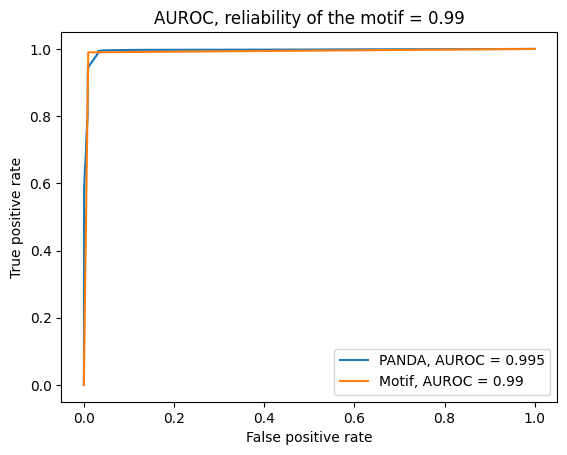

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5407940571379444
step: 1, hamming: 0.5864426366645507
step: 2, hamming: 0.6914660219470973
step: 3, hamming: 0.752023043464153
step: 4, hamming: 0.7880556969467623
step: 5, hamming: 0.8039098657380502
step: 6, hamming: 0.8023846546267129
step: 7, hamming: 0.7862089365227898
step: 8, hamming: 0.7580408709852362
step: 9, hamming: 0.7203746117708928
step: 10, hamming: 0.6755382026031892
step: 11, hamming: 0.6257179032948542
step: 12, hamming: 0.5729371474497773
step: 13, hamming: 0.5190122921548977
step: 14, hamming: 0.465509115837662
step: 15, hamming: 0.41371090620441675
step: 16, hamming: 0.36460488173850475
st

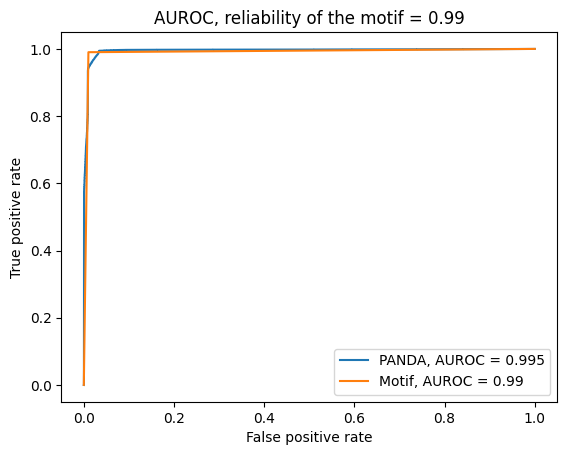

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 216
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5605538945278011
step: 1, hamming: 0.619520016400864
step: 2, hamming: 0.7304158777916278
step: 3, hamming: 0.7967212015388491
step: 4, hamming: 0.8384185829363231
step: 5, hamming: 0.8597170119589267
step: 6, hamming: 0.8634797133359001
step: 7, hamming: 0.8525714098656535
step: 8, hamming: 0.8295992839651262
step: 9, hamming: 0.7967903595941838
step: 10, hamming: 0.7561059431277181
step: 11, hamming: 0.7093691783507577
step: 12, hamming: 0.65832238185199
step: 13, hamming: 0.604620498693022
step: 14, hamming: 0.5497986649243937
step: 15, hamming: 0.4952337528324631
step: 16, hamming: 0.4421091886668037
step: 

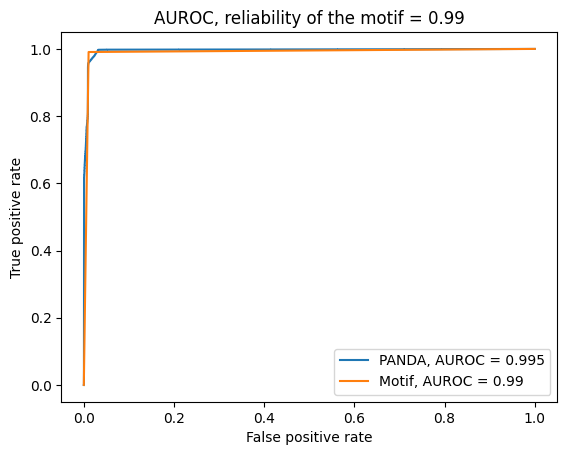

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 146
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.521646472434185
step: 1, hamming: 0.48392306076124597
step: 2, hamming: 0.5726774515025803
step: 3, hamming: 0.6182484327905119
step: 4, hamming: 0.6416592818973206
step: 5, hamming: 0.6478005475618698
step: 6, hamming: 0.6391911609362062
step: 7, hamming: 0.6183123550604906
step: 8, hamming: 0.5878715784531695
step: 9, hamming: 0.5505330239221157
step: 10, hamming: 0.5086831555826378
step: 11, hamming: 0.46437901302603035
step: 12, hamming: 0.4193453427346835
step: 13, hamming: 0.3749821629290027
step: 14, hamming: 0.33236209651557946
step: 15, hamming: 0.2922544425981282
step: 16, hamming: 0.25515910706976813

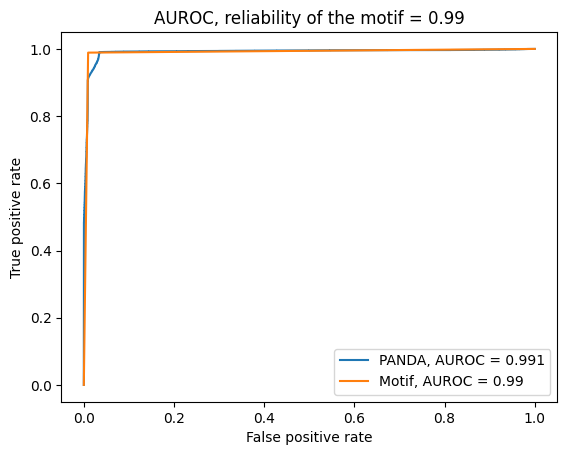

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5315617393728392
step: 1, hamming: 0.5270633687744826
step: 2, hamming: 0.619234012574768
step: 3, hamming: 0.6685641427081958
step: 4, hamming: 0.6956746824664022
step: 5, hamming: 0.7051631412377701
step: 6, hamming: 0.6994390739648793
step: 7, hamming: 0.680971041985857
step: 8, hamming: 0.6524179228539593
step: 9, hamming: 0.6163284178251017
step: 10, hamming: 0.5749608176386328
step: 11, hamming: 0.5302713281957291
step: 12, hamming: 0.48394285237492535
step: 13, hamming: 0.437397646055462
step: 14, hamming: 0.39179751889140607
step: 15, hamming: 0.3480513815423399
step: 16, hamming: 0.3068315608656004
ste

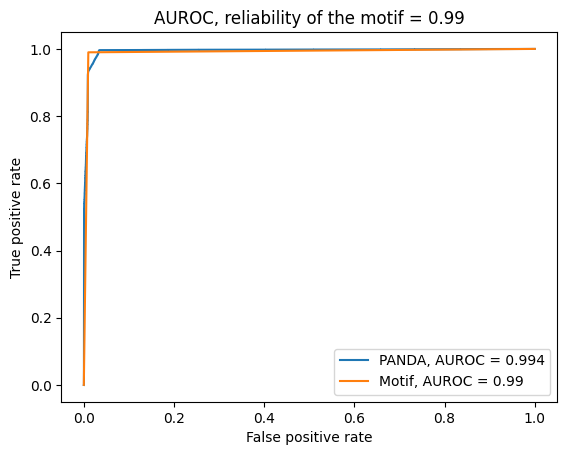

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 176
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5450564815223191
step: 1, hamming: 0.6089089072683426
step: 2, hamming: 0.7158477918969725
step: 3, hamming: 0.7798926370531627
step: 4, hamming: 0.8202987762052154
step: 5, hamming: 0.8411246408990344
step: 6, hamming: 0.8452366513035338
step: 7, hamming: 0.8354628594113023
step: 8, hamming: 0.8143652623407613
step: 9, hamming: 0.7841812429400297
step: 10, hamming: 0.7468483553447123
step: 11, hamming: 0.7040585643653069
step: 12, hamming: 0.6573142119862245
step: 13, hamming: 0.6079718288782994
step: 14, hamming: 0.5572702153055766
step: 15, hamming: 0.5063332376891947
step: 16, hamming: 0.4561616099223839
st

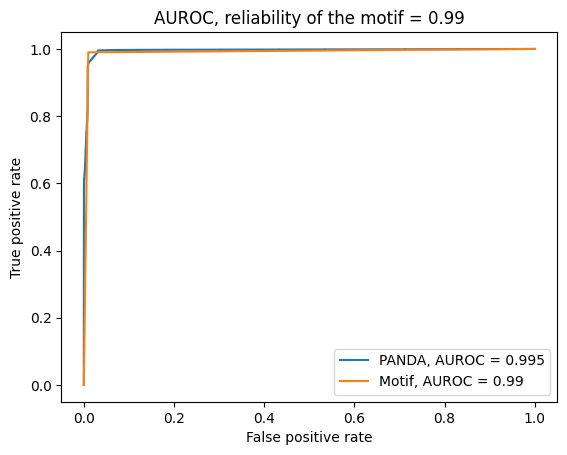

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 204
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5586628898055189
step: 1, hamming: 0.6309717278554259
step: 2, hamming: 0.7514484872350409
step: 3, hamming: 0.8266744457322052
step: 4, hamming: 0.8777485288004168
step: 5, hamming: 0.9095368684874416
step: 6, hamming: 0.9251526671682542
step: 7, hamming: 0.9272093275959354
step: 8, hamming: 0.9178453129437776
step: 9, hamming: 0.8987776795465982
step: 10, hamming: 0.8713709801755223
step: 11, hamming: 0.8367383605253645
step: 12, hamming: 0.7958709676305946
step: 13, hamming: 0.7497527221432632
step: 14, hamming: 0.6994314100124784
step: 15, hamming: 0.6460452161007264
step: 16, hamming: 0.5908120409701622
st

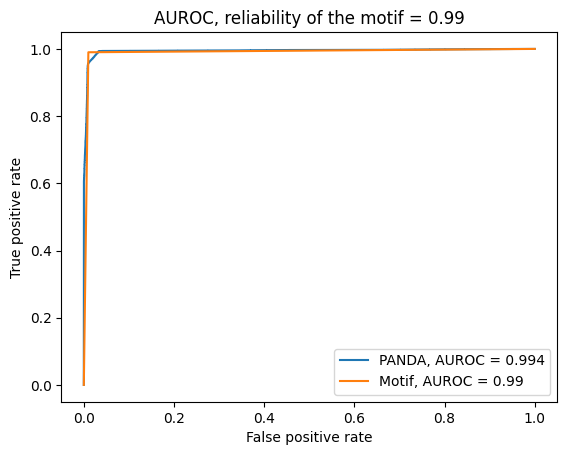

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 148
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5387791641247722
step: 1, hamming: 0.5616606781462211
step: 2, hamming: 0.6637139737548554
step: 3, hamming: 0.7217119279911635
step: 4, hamming: 0.755813842700125
step: 5, hamming: 0.7705865307268679
step: 6, hamming: 0.7686214145118135
step: 7, hamming: 0.752537845534279
step: 8, hamming: 0.7249999660181369
step: 9, hamming: 0.6885190278894692
step: 10, hamming: 0.6453852950695993
step: 11, hamming: 0.5976791022350537
step: 12, hamming: 0.547284903645073
step: 13, hamming: 0.4958850027625915
step: 14, hamming: 0.44492400859506154
step: 15, hamming: 0.3955928164759539
step: 16, hamming: 0.34881274756102176
ste

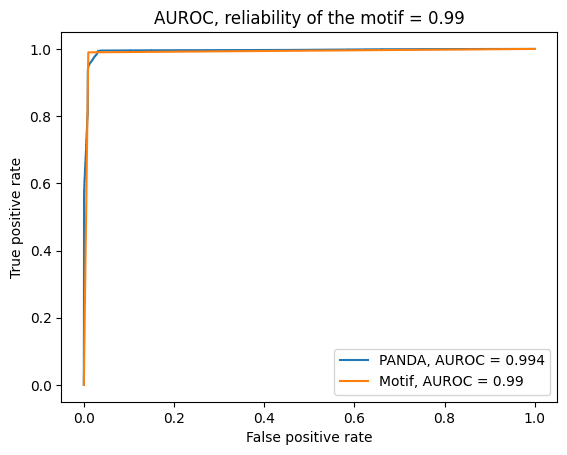

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 176
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5571332465471516
step: 1, hamming: 0.5916578030453618
step: 2, hamming: 0.702095669047718
step: 3, hamming: 0.7676046348588028
step: 4, hamming: 0.8091496915909981
step: 5, hamming: 0.8314100652858262
step: 6, hamming: 0.8373419095931786
step: 7, hamming: 0.8296557276567665
step: 8, hamming: 0.8108678061856355
step: 9, hamming: 0.7831907542672787
step: 10, hamming: 0.7485243628459394
step: 11, hamming: 0.7085032353542423
step: 12, hamming: 0.6645579318355435
step: 13, hamming: 0.6179626992757632
step: 14, hamming: 0.5698589201947146
step: 15, hamming: 0.5212640997893453
step: 16, hamming: 0.4730756624332581
ste

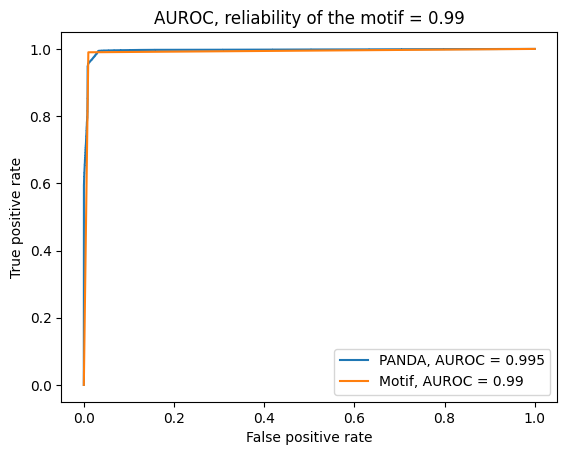

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 186
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5548993127664353
step: 1, hamming: 0.5752772995095145
step: 2, hamming: 0.6796649175532602
step: 3, hamming: 0.7407359257902488
step: 4, hamming: 0.7786430200840654
step: 5, hamming: 0.7974272250596307
step: 6, hamming: 0.7995262750751962
step: 7, hamming: 0.7874188354521808
step: 8, hamming: 0.7635250101249992
step: 9, hamming: 0.7300787368741888
step: 10, hamming: 0.6891326361680861
step: 11, hamming: 0.6426022940198552
step: 12, hamming: 0.5923095954647146
step: 13, hamming: 0.5399791031589202
step: 14, hamming: 0.4871921384349145
step: 15, hamming: 0.435328213270103
step: 16, hamming: 0.38551839975344754
st

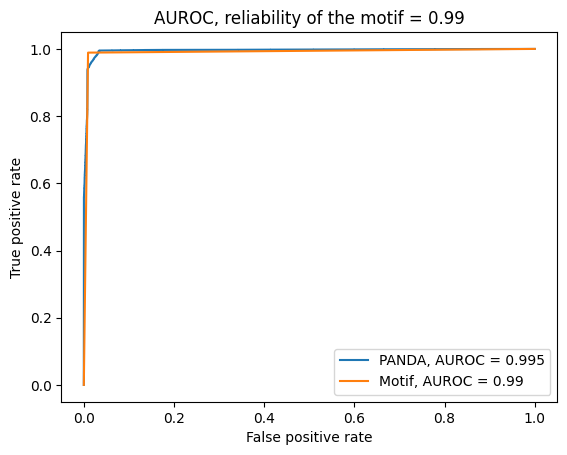

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 200
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5516945129844958
step: 1, hamming: 0.6148551189622264
step: 2, hamming: 0.7249595527257061
step: 3, hamming: 0.7900226748900078
step: 4, hamming: 0.8305075214811616
step: 5, hamming: 0.8509213957914826
step: 6, hamming: 0.8541406629524564
step: 7, hamming: 0.8429107743965609
step: 8, hamming: 0.819810793797106
step: 9, hamming: 0.7870998141248207
step: 10, hamming: 0.7467520370128174
step: 11, hamming: 0.700582839913333
step: 12, hamming: 0.6502882771842249
step: 13, hamming: 0.5974394062290567
step: 14, hamming: 0.5434887731749838
step: 15, hamming: 0.4897604122376986
step: 16, hamming: 0.437409347756455
step:

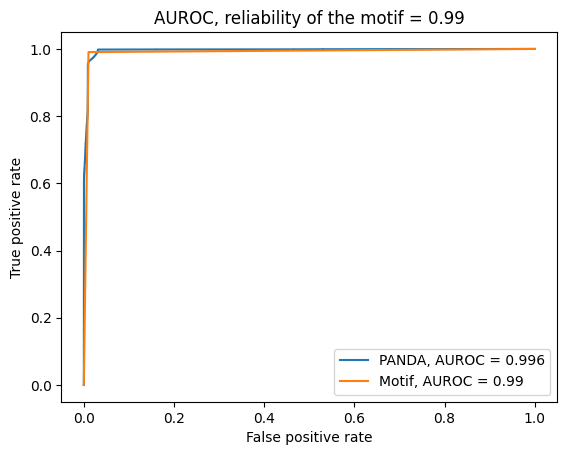

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.544302973905465
step: 1, hamming: 0.5778334757266719
step: 2, hamming: 0.67924936068075
step: 3, hamming: 0.7366174076630619
step: 4, hamming: 0.7699837863296518
step: 5, hamming: 0.7836196605794419
step: 6, hamming: 0.7801093127112411
step: 7, hamming: 0.7622325095341225
step: 8, hamming: 0.7327692664277151
step: 9, hamming: 0.6942941146173374
step: 10, hamming: 0.6492091309605903
step: 11, hamming: 0.5997178154897064
step: 12, hamming: 0.5477942441238194
step: 13, hamming: 0.4951646005210165
step: 14, hamming: 0.44328835114277265
step: 15, hamming: 0.3933394287230101
step: 16, hamming: 0.3462000546561078
step

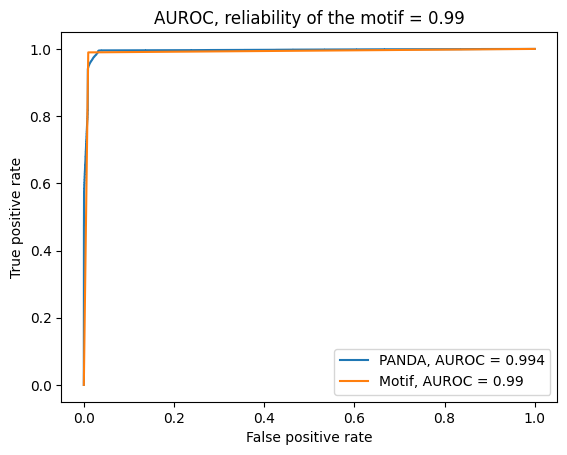

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 172
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5419826121610909
step: 1, hamming: 0.5437980105320557
step: 2, hamming: 0.6429443834388575
step: 3, hamming: 0.6985397573291853
step: 4, hamming: 0.7305144819099352
step: 5, hamming: 0.7435512194111613
step: 6, hamming: 0.7403590956775903
step: 7, hamming: 0.723517261587517
step: 8, hamming: 0.6956827172754723
step: 9, hamming: 0.659400951218833
step: 10, hamming: 0.6169820888459863
step: 11, hamming: 0.5704904855536036
step: 12, hamming: 0.5217519980132004
step: 13, hamming: 0.47235347248462006
step: 14, hamming: 0.423627601160693
step: 15, hamming: 0.3766436363860429
step: 16, hamming: 0.3322092850985136
step

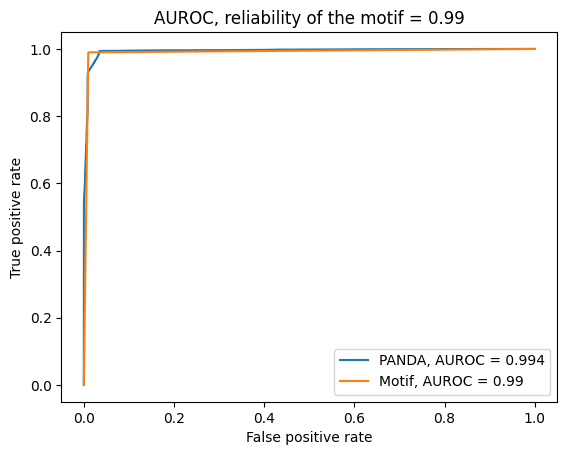

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 162
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.54526525659271
step: 1, hamming: 0.5767328879605297
step: 2, hamming: 0.6822150076070641
step: 3, hamming: 0.7429864830423739
step: 4, hamming: 0.7799264196262441
step: 5, hamming: 0.7977462453572849
step: 6, hamming: 0.7992590171366547
step: 7, hamming: 0.7871478294101734
step: 8, hamming: 0.7640305529116449
step: 9, hamming: 0.7323409576798352
step: 10, hamming: 0.6942097987623148
step: 11, hamming: 0.6514622050073511
step: 12, hamming: 0.6056683795179287
step: 13, hamming: 0.5581845109140391
step: 14, hamming: 0.5101789920112465
step: 15, hamming: 0.46264450053774314
step: 16, hamming: 0.41640468825271443
st

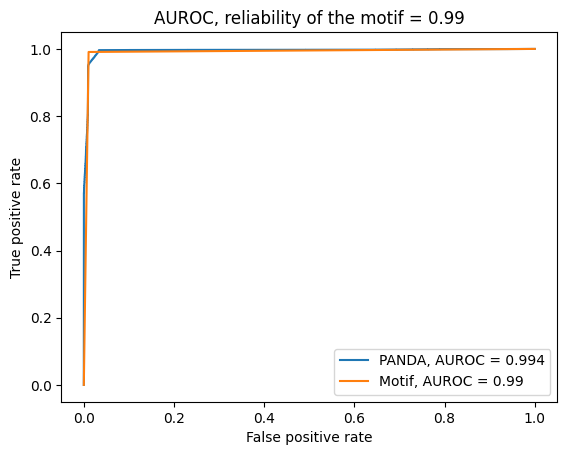

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 182
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5470009933097558
step: 1, hamming: 0.5770457436262327
step: 2, hamming: 0.6824305869177784
step: 3, hamming: 0.7417574629152985
step: 4, hamming: 0.7765659004776752
step: 5, hamming: 0.7915941567601575
step: 6, hamming: 0.7897125733701807
step: 7, hamming: 0.7737213315172252
step: 8, hamming: 0.7463916756966449
step: 9, hamming: 0.710245128367365
step: 10, hamming: 0.6675256956931215
step: 11, hamming: 0.6202412837176546
step: 12, hamming: 0.570185362351656
step: 13, hamming: 0.5189385432975008
step: 14, hamming: 0.4678663009939582
step: 15, hamming: 0.4181125521982408
step: 16, hamming: 0.3705900480145595
step

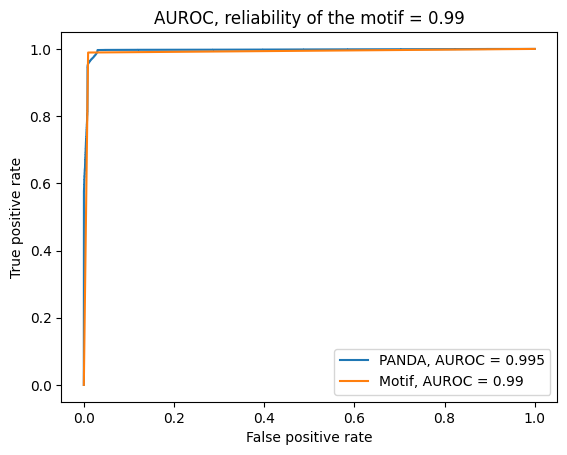

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 202
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5505352093607608
step: 1, hamming: 0.5786930431321864
step: 2, hamming: 0.6833035855673497
step: 3, hamming: 0.7439865404646505
step: 4, hamming: 0.7811615381167151
step: 5, hamming: 0.7989042260656117
step: 6, hamming: 0.7997013520588699
step: 7, hamming: 0.786315065604559
step: 8, hamming: 0.7613978479441569
step: 9, hamming: 0.7272682316441277
step: 10, hamming: 0.6859906113448467
step: 11, hamming: 0.6394718451952529
step: 12, hamming: 0.5894846070445406
step: 13, hamming: 0.5376649006776109
step: 14, hamming: 0.4854921460929829
step: 15, hamming: 0.43425578016319244
step: 16, hamming: 0.385021560103961
ste

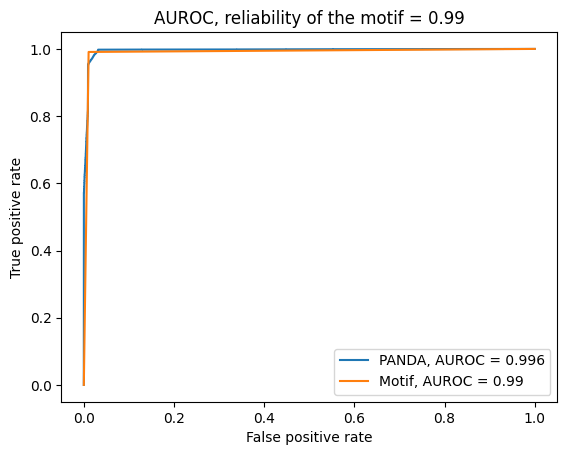

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5354475618774347
step: 1, hamming: 0.5692727331592018
step: 2, hamming: 0.6732796755570779
step: 3, hamming: 0.7327515909807047
step: 4, hamming: 0.7682617340322585
step: 5, hamming: 0.7842377418970674
step: 6, hamming: 0.7833831035174333
step: 7, hamming: 0.7683358919083546
step: 8, hamming: 0.7416620844935793
step: 9, hamming: 0.7057608657748184
step: 10, hamming: 0.6628642959700719
step: 11, hamming: 0.6150491628760795
step: 12, hamming: 0.5642277671541078
step: 13, hamming: 0.5121228942661689
step: 14, hamming: 0.4602359158265977
step: 15, hamming: 0.4098170365264992
step: 16, hamming: 0.36184707863981935
s

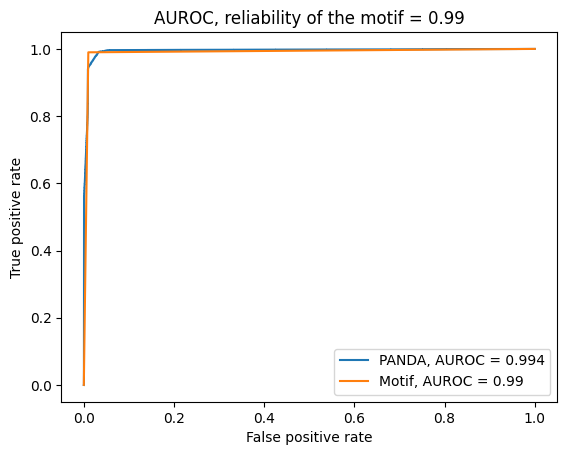

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 150
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.517684960173755
step: 1, hamming: 0.4953168517963451
step: 2, hamming: 0.5940762266764941
step: 3, hamming: 0.6478809672908367
step: 4, hamming: 0.6788917488155503
step: 5, hamming: 0.6921732953752171
step: 6, hamming: 0.6902601316497409
step: 7, hamming: 0.6755727482301415
step: 8, hamming: 0.6506212248043732
step: 9, hamming: 0.6178034042812107
step: 10, hamming: 0.579276166746636
step: 11, hamming: 0.5369336411059041
step: 12, hamming: 0.49241892640124374
step: 13, hamming: 0.4471423986775178
step: 14, hamming: 0.4022906034689178
step: 15, hamming: 0.3588306636246056
step: 16, hamming: 0.3175141967174222
ste

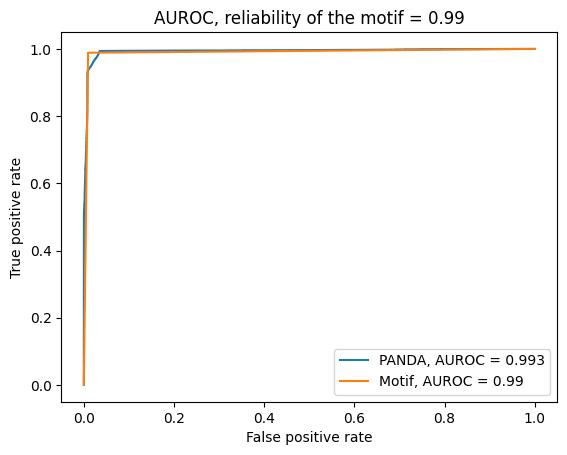

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 150
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5215878168211926
step: 1, hamming: 0.5096631267816355
step: 2, hamming: 0.6018075848639455
step: 3, hamming: 0.6499259916362947
step: 4, hamming: 0.6749310945239424
step: 5, hamming: 0.6817697697706498
step: 6, hamming: 0.6731755392044196
step: 7, hamming: 0.6518117043490871
step: 8, hamming: 0.620401381404046
step: 9, hamming: 0.5815917682169041
step: 10, hamming: 0.5378407406556454
step: 11, hamming: 0.49133353010441766
step: 12, hamming: 0.4439231697212826
step: 13, hamming: 0.3971099310948906
step: 14, hamming: 0.3520503661587883
step: 15, hamming: 0.30958240333860537
step: 16, hamming: 0.27026028044952727


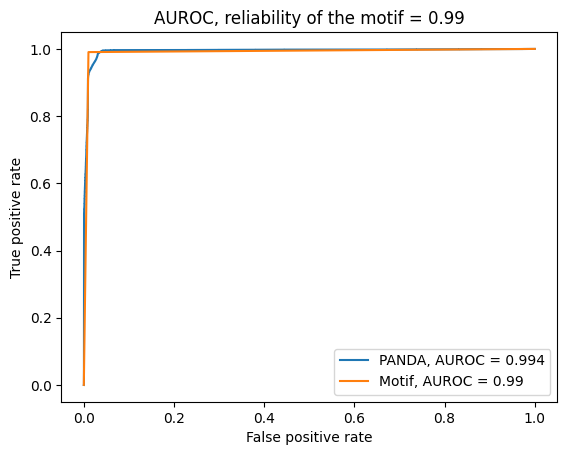

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 176
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5289811427958887
step: 1, hamming: 0.5397230054867999
step: 2, hamming: 0.6433825517602769
step: 3, hamming: 0.7014217625641501
step: 4, hamming: 0.7355249143573168
step: 5, hamming: 0.7503819055384126
step: 6, hamming: 0.7487086119364469
step: 7, hamming: 0.733185839891312
step: 8, hamming: 0.7064702395484551
step: 9, hamming: 0.6710374642132262
step: 10, hamming: 0.6291424973009239
step: 11, hamming: 0.5828426388877019
step: 12, hamming: 0.533989879422425
step: 13, hamming: 0.4842111766647683
step: 14, hamming: 0.4348872460146938
step: 15, hamming: 0.38714051521207177
step: 16, hamming: 0.341835029834799
step

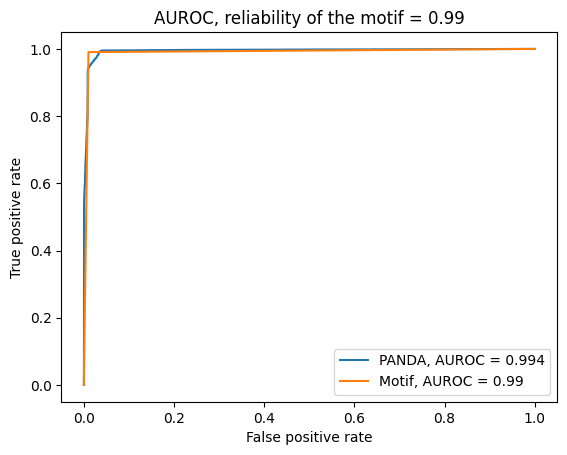

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 178
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5371426237190257
step: 1, hamming: 0.5516240776036125
step: 2, hamming: 0.6468332839840174
step: 3, hamming: 0.6984567655486579
step: 4, hamming: 0.7271505662452196
step: 5, hamming: 0.7373467301451607
step: 6, hamming: 0.7315263708387447
step: 7, hamming: 0.7123730528645819
step: 8, hamming: 0.6826748839471107
step: 9, hamming: 0.6450712801560404
step: 10, hamming: 0.6019092316818625
step: 11, hamming: 0.5552336375615005
step: 12, hamming: 0.5068033599952003
step: 13, hamming: 0.45810278691958944
step: 14, hamming: 0.4103506437567489
step: 15, hamming: 0.36450791111424374
step: 16, hamming: 0.3212910884012723


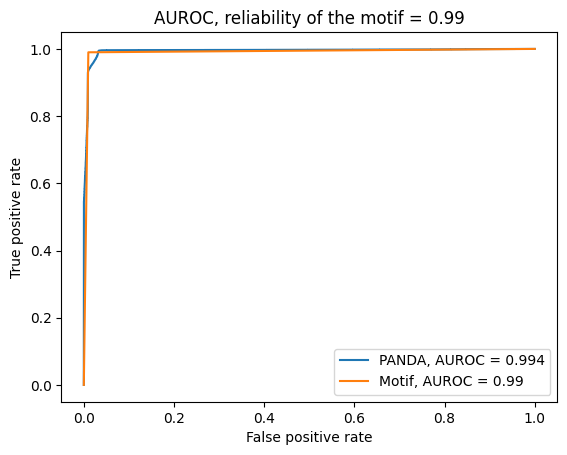

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.565113720918289
step: 1, hamming: 0.6047983902044859
step: 2, hamming: 0.7113156810382666
step: 3, hamming: 0.7741746739054136
step: 4, hamming: 0.8122341852011252
step: 5, hamming: 0.8296528907333136
step: 6, hamming: 0.8293013116066748
step: 7, hamming: 0.814158849908961
step: 8, hamming: 0.7870089273499269
step: 9, hamming: 0.7503449824291911
step: 10, hamming: 0.7064001675947853
step: 11, hamming: 0.6572315498880199
step: 12, hamming: 0.6047554545431661
step: 13, hamming: 0.5507234593544479
step: 14, hamming: 0.4966739034795303
step: 15, hamming: 0.4438947647400611
step: 16, hamming: 0.3934097473799644
step

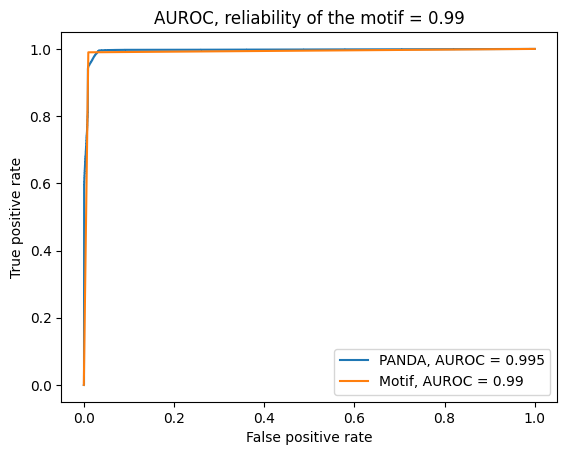

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 150
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.521915095270253
step: 1, hamming: 0.522208343408592
step: 2, hamming: 0.6185062880950917
step: 3, hamming: 0.669908395033931
step: 4, hamming: 0.6978338593964174
step: 5, hamming: 0.7071789232720577
step: 6, hamming: 0.7006037282349318
step: 7, hamming: 0.6808008715208911
step: 8, hamming: 0.6505570840111051
step: 9, hamming: 0.6125040651858791
step: 10, hamming: 0.5690359813683359
step: 11, hamming: 0.522299917379929
step: 12, hamming: 0.47415559315806594
step: 13, hamming: 0.4261531204972404
step: 14, hamming: 0.3795269762089984
step: 15, hamming: 0.33520774491455474
step: 16, hamming: 0.29384574301351707
ste

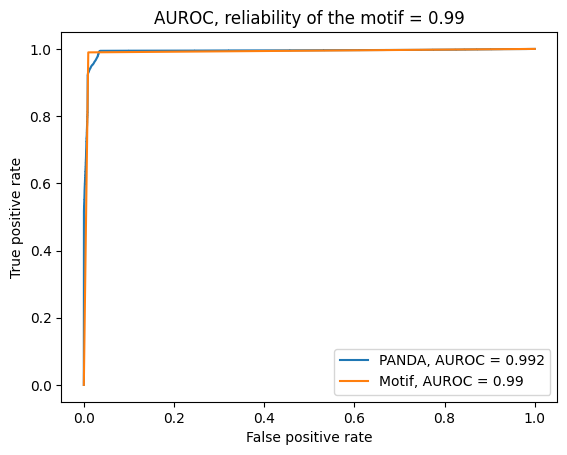

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 144
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5346772814532222
step: 1, hamming: 0.5739207011712045
step: 2, hamming: 0.6925716565649414
step: 3, hamming: 0.7628118981729995
step: 4, hamming: 0.8091199211042984
step: 5, hamming: 0.8369423824004034
step: 6, hamming: 0.8494102272397638
step: 7, hamming: 0.8492469602539392
step: 8, hamming: 0.8388165684453017
step: 9, hamming: 0.8200823081725493
step: 10, hamming: 0.7946585771344828
step: 11, hamming: 0.7638817388769163
step: 12, hamming: 0.7288699141388782
step: 13, hamming: 0.6905752221450606
step: 14, hamming: 0.6498283846248432
step: 15, hamming: 0.6073730624424643
step: 16, hamming: 0.5638893262453394
st

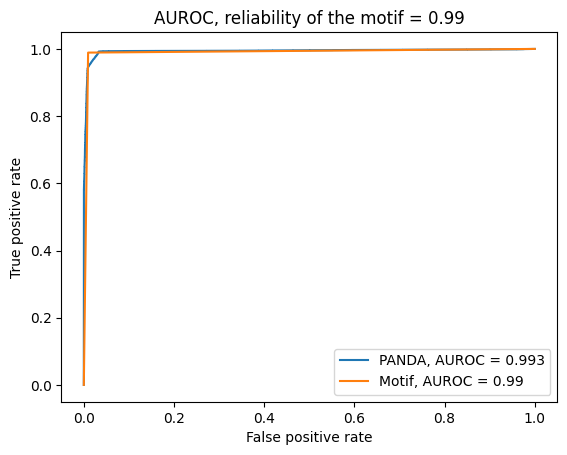

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 158
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5200879816668404
step: 1, hamming: 0.49833531077060894
step: 2, hamming: 0.5884211078850502
step: 3, hamming: 0.635647813782534
step: 4, hamming: 0.6601704312788126
step: 5, hamming: 0.6668926199605364
step: 6, hamming: 0.6585117390332969
step: 7, hamming: 0.6376342380197737
step: 8, hamming: 0.606972017972362
step: 9, hamming: 0.5691822575165725
step: 10, hamming: 0.5266956439494854
step: 11, hamming: 0.4816188177754259
step: 12, hamming: 0.4357111523167284
step: 13, hamming: 0.3903815447609853
step: 14, hamming: 0.3467121270534306
step: 15, hamming: 0.3054886970813116
step: 16, hamming: 0.2672363144316365
ste

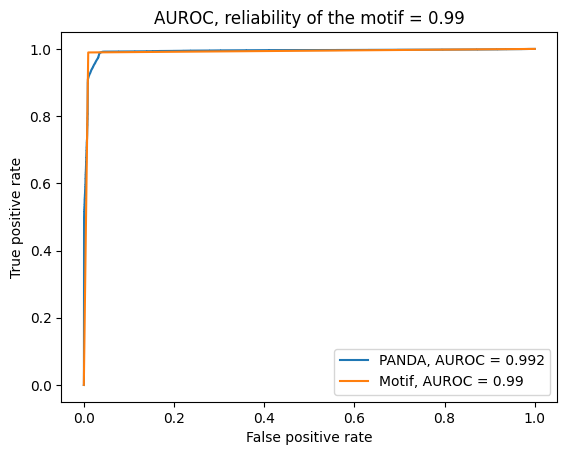

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.529866404765854
step: 1, hamming: 0.5429446805731672
step: 2, hamming: 0.6417844344535749
step: 3, hamming: 0.6956464366332987
step: 4, hamming: 0.7262298058987477
step: 5, hamming: 0.7380878260531463
step: 6, hamming: 0.7337858656028386
step: 7, hamming: 0.7159731651812574
step: 8, hamming: 0.6873878993883691
step: 9, hamming: 0.6506121205217965
step: 10, hamming: 0.6079479796812516
step: 11, hamming: 0.5614448758222086
step: 12, hamming: 0.5129059449361199
step: 13, hamming: 0.4638876644864002
step: 14, hamming: 0.4156873683440823
step: 15, hamming: 0.36933537620754525
step: 16, hamming: 0.3255992383754763
st

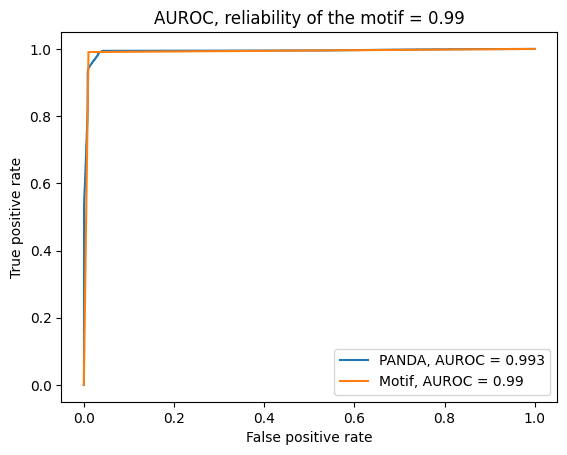

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 238
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5777056086241763
step: 1, hamming: 0.6633168346672308
step: 2, hamming: 0.7739871975617088
step: 3, hamming: 0.8425454065571817
step: 4, hamming: 0.8856244477275178
step: 5, hamming: 0.9072615124366953
step: 6, hamming: 0.9104798548403521
step: 7, hamming: 0.8980566027480972
step: 8, hamming: 0.8723626273758273
step: 9, hamming: 0.8355271160416649
step: 10, hamming: 0.7896923278701486
step: 11, hamming: 0.7370339782694826
step: 12, hamming: 0.6797175999226677
step: 13, hamming: 0.6198229617542742
step: 14, hamming: 0.5592508622372095
step: 15, hamming: 0.49964739453807533
step: 16, hamming: 0.442358597068185
st

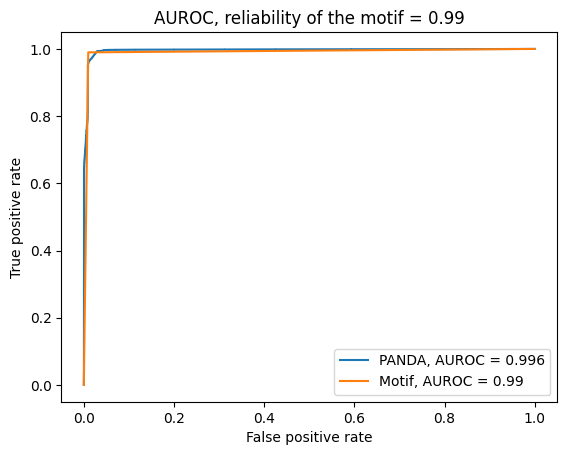

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 212
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5374067884819841
step: 1, hamming: 0.5722119326183699
step: 2, hamming: 0.6738928136955525
step: 3, hamming: 0.7316237502939089
step: 4, hamming: 0.7650823161377972
step: 5, hamming: 0.7787581505065683
step: 6, hamming: 0.7753149381174631
step: 7, hamming: 0.7575119956854275
step: 8, hamming: 0.7281087204841783
step: 9, hamming: 0.6897244561296998
step: 10, hamming: 0.6447844522104161
step: 11, hamming: 0.5954805847148493
step: 12, hamming: 0.5437713210489172
step: 13, hamming: 0.4913789430422644
step: 14, hamming: 0.439761192150341
step: 15, hamming: 0.3900854532765199
step: 16, hamming: 0.34322467045922095
st

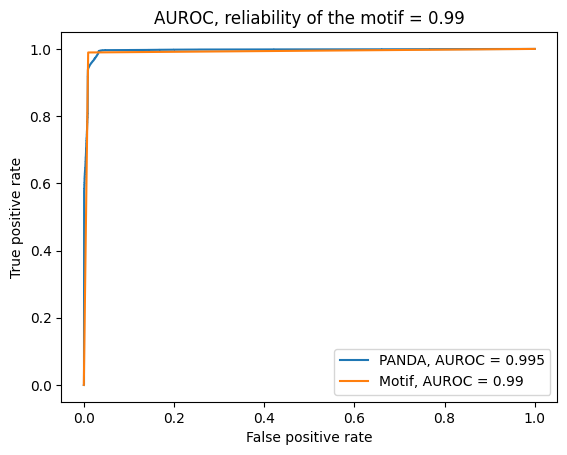

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 172
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5383192753848483
step: 1, hamming: 0.5733333822497813
step: 2, hamming: 0.6786206974162784
step: 3, hamming: 0.7391938800713966
step: 4, hamming: 0.7759256276141615
step: 5, hamming: 0.7932762724903383
step: 6, hamming: 0.7939547556563479
step: 7, hamming: 0.7806052520865754
step: 8, hamming: 0.7556859109795028
step: 9, hamming: 0.721467567931796
step: 10, hamming: 0.6800652564445125
step: 11, hamming: 0.6334540102321766
step: 12, hamming: 0.5834607476603165
step: 13, hamming: 0.5317641061794739
step: 14, hamming: 0.4798595528779034
step: 15, hamming: 0.42902402094018016
step: 16, hamming: 0.38029016849344816
s

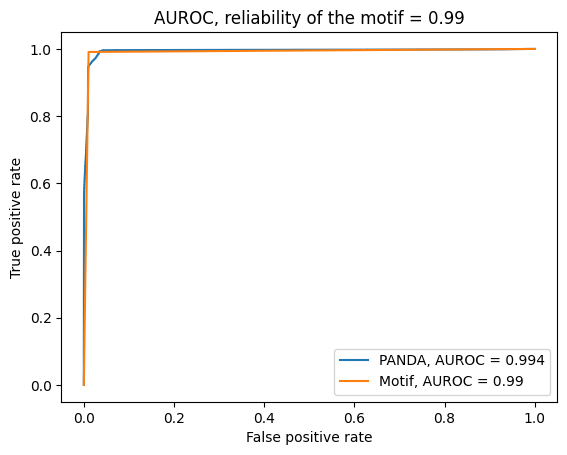

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.04 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5412003540346368
step: 1, hamming: 0.562989931424963
step: 2, hamming: 0.6650403732271506
step: 3, hamming: 0.7246215227137174
step: 4, hamming: 0.7605572901128236
step: 5, hamming: 0.7773149543720804
step: 6, hamming: 0.7774626197270447
step: 7, hamming: 0.763617630044054
step: 8, hamming: 0.7384450791723344
step: 9, hamming: 0.7044111629637271
step: 10, hamming: 0.6636989332524712
step: 11, hamming: 0.6182413979750945
step: 12, hamming: 0.5697631609853112
step: 13, hamming: 0.5198007776196291
step: 14, hamming: 0.4697059547391694
step: 15, hamming: 0.4206347703379905
step: 16, hamming: 0.37353154137306893
ste

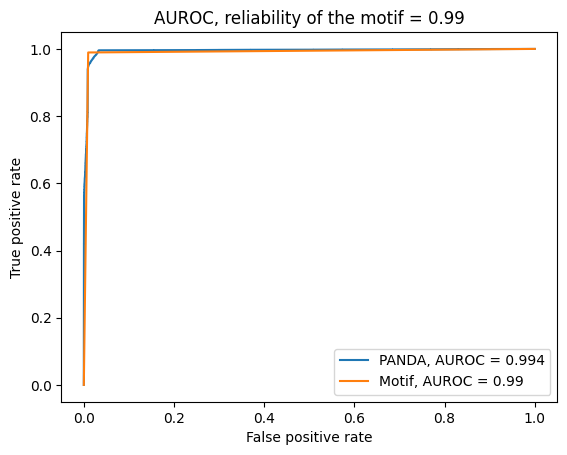

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5492300612631716
step: 1, hamming: 0.5780640270503434
step: 2, hamming: 0.6809575398708272
step: 3, hamming: 0.7394010383793473
step: 4, hamming: 0.77361248935845
step: 5, hamming: 0.7883224351103244
step: 6, hamming: 0.7863557362145757
step: 7, hamming: 0.7704176224182053
step: 8, hamming: 0.7432076009455292
step: 9, hamming: 0.7072724119441789
step: 10, hamming: 0.664881334109127
step: 11, hamming: 0.6180233151601168
step: 12, hamming: 0.5684520838595776
step: 13, hamming: 0.5177147339186217
step: 14, hamming: 0.4671500620827379
step: 15, hamming: 0.41787433964400555
step: 16, hamming: 0.37077387244326443
ste

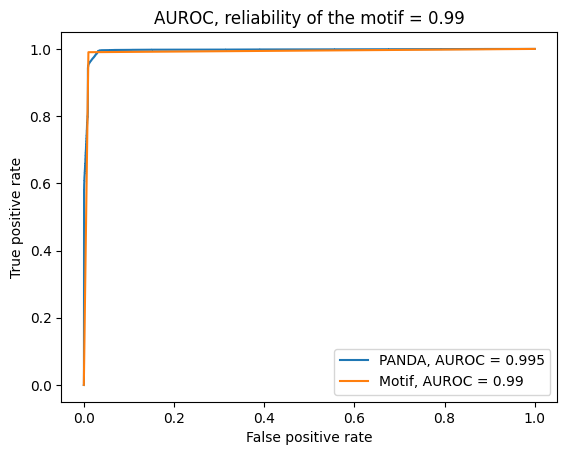

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 172
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5337774521082576
step: 1, hamming: 0.5545625505963853
step: 2, hamming: 0.6550292233048636
step: 3, hamming: 0.7117963088780797
step: 4, hamming: 0.745727838093255
step: 5, hamming: 0.7611447754718359
step: 6, hamming: 0.7606957994060797
step: 7, hamming: 0.7470308986789527
step: 8, hamming: 0.7227927882591515
step: 9, hamming: 0.6904075615221434
step: 10, hamming: 0.6520057874841637
step: 11, hamming: 0.6094293017862261
step: 12, hamming: 0.5642536959154834
step: 13, hamming: 0.51781558827365
step: 14, hamming: 0.4712402783690904
step: 15, hamming: 0.42546516974272086
step: 16, hamming: 0.38125303240849767
ste

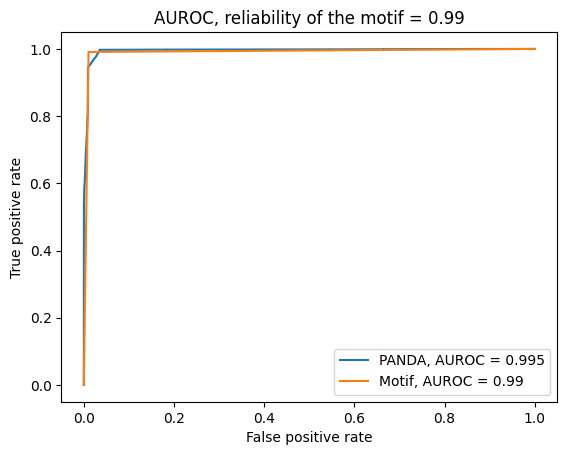

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 160
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5371741320221345
step: 1, hamming: 0.5597551853416818
step: 2, hamming: 0.6615945424842915
step: 3, hamming: 0.7194200759144179
step: 4, hamming: 0.7534995580035103
step: 5, hamming: 0.7684063955317159
step: 6, hamming: 0.7669063715477733
step: 7, hamming: 0.7517659824319409
step: 8, hamming: 0.7256298286312893
step: 9, hamming: 0.6909265278883141
step: 10, hamming: 0.649840725837636
step: 11, hamming: 0.6043069318460106
step: 12, hamming: 0.5560347271406264
step: 13, hamming: 0.5065338335947085
step: 14, hamming: 0.4571178249860861
step: 15, hamming: 0.4088926761942705
step: 16, hamming: 0.3627462133609514
ste

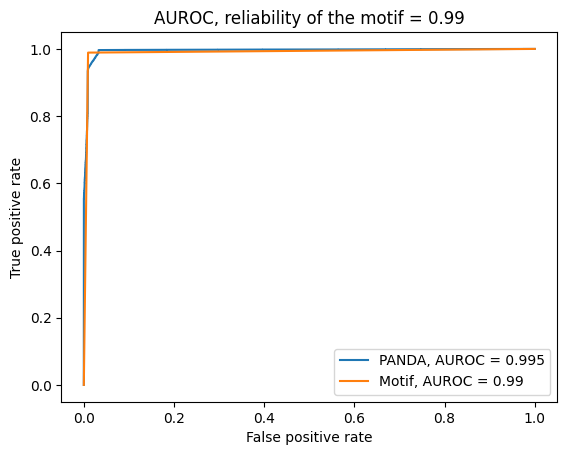

0.1
Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 146
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5391980619194462
step: 1, hamming: 0.4948362739456007
step: 2, hamming: 0.5983473396604314
step: 3, hamming: 0.6538329242569151
step: 4, hamming: 0.6860667587957909
step: 5, hamming: 0.7008039698757805
step: 6, hamming: 0.7007313227343074
step: 7, hamming: 0.6881857051892285
step: 8, hamming: 0.6655507909299239
step: 9, hamming: 0.6351438982575971
step: 10, hamming: 0.5990637698694181
step: 11, hamming: 0.5591230756616231
step: 12, hamming: 0.5168513406603372
step: 13, hamming: 0.47352578758799346
step: 14, hamming: 0.43020436637709675
step: 15, hamming: 0.3877524343760314
step: 16, hamming: 0.3468626714668

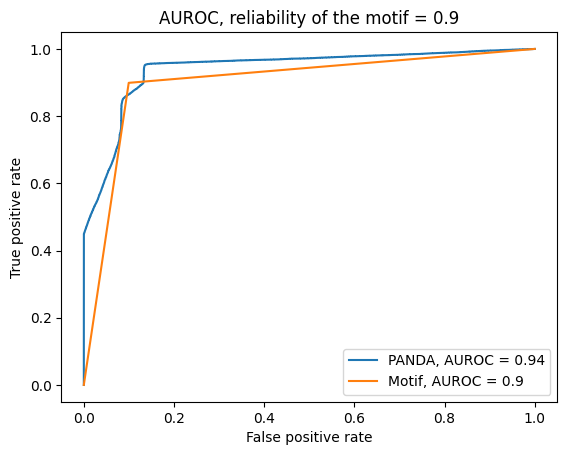

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 180
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.542268634039871
step: 1, hamming: 0.5132603930109553
step: 2, hamming: 0.6211478413602222
step: 3, hamming: 0.67955176622405
step: 4, hamming: 0.7142009148642727
step: 5, hamming: 0.7307670148413842
step: 6, hamming: 0.731943999295195
step: 7, hamming: 0.7201796041622738
step: 8, hamming: 0.6979523553577888
step: 9, hamming: 0.667604344754503
step: 10, hamming: 0.6312249924186236
step: 11, hamming: 0.5906289092972624
step: 12, hamming: 0.5473709420531393
step: 13, hamming: 0.5027693382772799
step: 14, hamming: 0.4579303725869798
step: 15, hamming: 0.4137708157468138
step: 16, hamming: 0.3710357858882323
step: 1

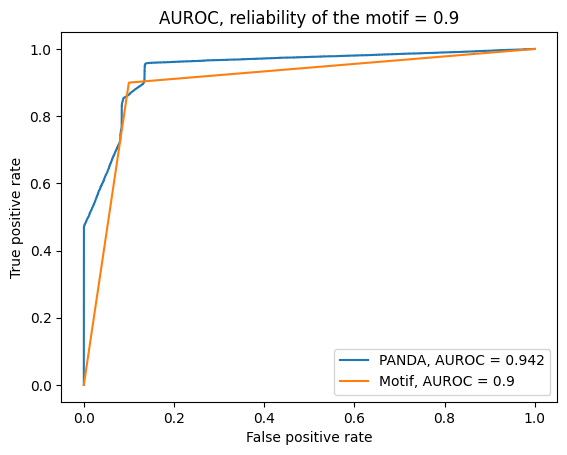

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 152
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5504024321008206
step: 1, hamming: 0.5165996111742411
step: 2, hamming: 0.6208191443816972
step: 3, hamming: 0.6762269524922259
step: 4, hamming: 0.7079573680176077
step: 5, hamming: 0.7216777280372787
step: 6, hamming: 0.7201033784968985
step: 7, hamming: 0.705676267371263
step: 8, hamming: 0.6808990496080021
step: 9, hamming: 0.6481911868382499
step: 10, hamming: 0.6097386158744046
step: 11, hamming: 0.5674345074101576
step: 12, hamming: 0.5228850212908779
step: 13, hamming: 0.47743770249029727
step: 14, hamming: 0.4322102617514851
step: 15, hamming: 0.38811221386413436
step: 16, hamming: 0.34586205113746793


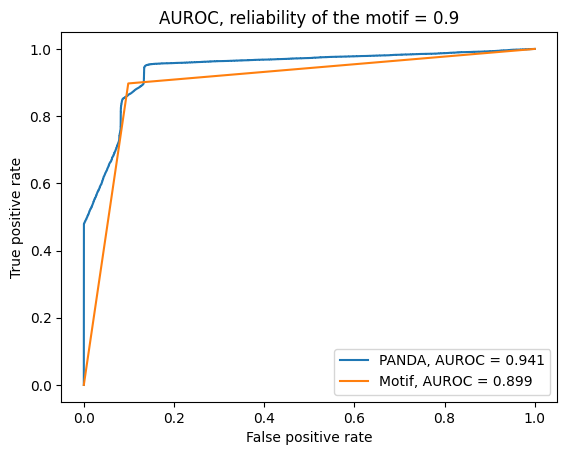

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5777502872384325
step: 1, hamming: 0.5849117476144007
step: 2, hamming: 0.6999556503004977
step: 3, hamming: 0.7650040654273611
step: 4, hamming: 0.805180288080829
step: 5, hamming: 0.8256963044383783
step: 6, hamming: 0.8291712130424378
step: 7, hamming: 0.8181361707989183
step: 8, hamming: 0.7951499367728451
step: 9, hamming: 0.7625697334771804
step: 10, hamming: 0.7224823529479542
step: 11, hamming: 0.6767626006486382
step: 12, hamming: 0.6271334222382847
step: 13, hamming: 0.5751862460884584
step: 14, hamming: 0.522374417873165
step: 15, hamming: 0.46999075827235887
step: 16, hamming: 0.419139438111664
step

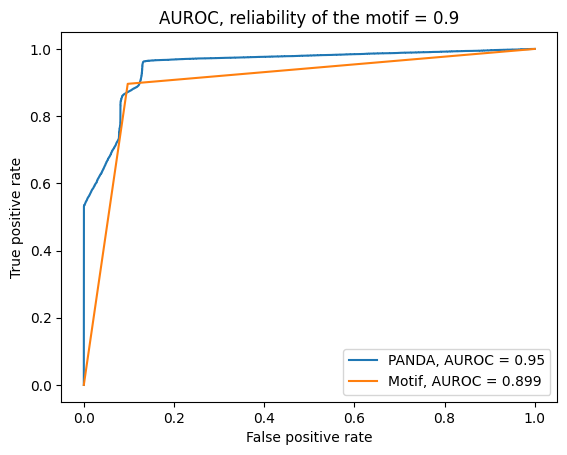

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 210
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5762000983400345
step: 1, hamming: 0.5972747704594523
step: 2, hamming: 0.7193880227960208
step: 3, hamming: 0.790814159754556
step: 4, hamming: 0.8376431046858371
step: 5, hamming: 0.8654352856176915
step: 6, hamming: 0.8770885527840565
step: 7, hamming: 0.8753199421561135
step: 8, hamming: 0.8626926512254979
step: 9, hamming: 0.8414075840142123
step: 10, hamming: 0.8132625015243535
step: 11, hamming: 0.7797188971212385
step: 12, hamming: 0.741987394528024
step: 13, hamming: 0.701096586065552
step: 14, hamming: 0.6579411611666004
step: 15, hamming: 0.6133143393023657
step: 16, hamming: 0.5679294241038114
step:

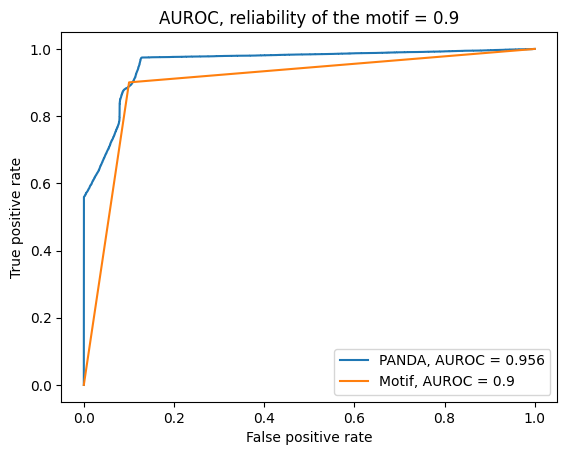

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 188
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5582934342957712
step: 1, hamming: 0.5398123864470433
step: 2, hamming: 0.6503835792098064
step: 3, hamming: 0.7107425369246364
step: 4, hamming: 0.7468288561646416
step: 5, hamming: 0.7641883150796988
step: 6, hamming: 0.7655225305991673
step: 7, hamming: 0.753333233853217
step: 8, hamming: 0.7301712179404926
step: 9, hamming: 0.6984442666904642
step: 10, hamming: 0.6602893063820656
step: 11, hamming: 0.6175624248189139
step: 12, hamming: 0.5718786677529953
step: 13, hamming: 0.5246434033079614
step: 14, hamming: 0.47706954086431136
step: 15, hamming: 0.4301849494253166
step: 16, hamming: 0.3848357431043823
st

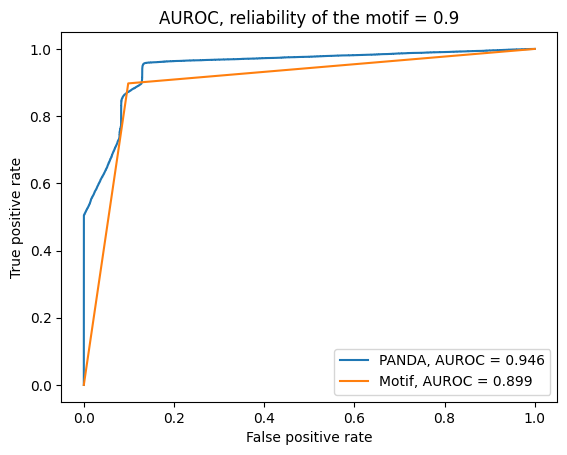

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 200
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5735532788801989
step: 1, hamming: 0.5518623818306031
step: 2, hamming: 0.6588104762526144
step: 3, hamming: 0.7168482043061812
step: 4, hamming: 0.7502931620545927
step: 5, hamming: 0.7647180578082284
step: 6, hamming: 0.76296406258266
step: 7, hamming: 0.7476404768010647
step: 8, hamming: 0.7213863419128373
step: 9, hamming: 0.686739913568657
step: 10, hamming: 0.6459938005036583
step: 11, hamming: 0.601136316875233
step: 12, hamming: 0.5538613601352841
step: 13, hamming: 0.5056030480021118
step: 14, hamming: 0.45756124090506595
step: 15, hamming: 0.4107160034570888
step: 16, hamming: 0.3658404407125966
step:

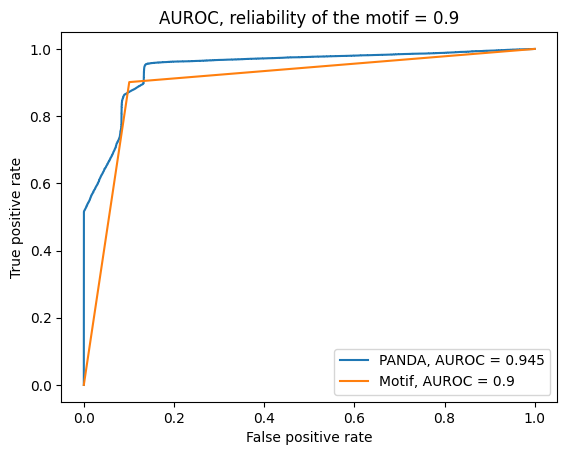

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 164
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5579594827990044
step: 1, hamming: 0.5465100879246924
step: 2, hamming: 0.6548258822058751
step: 3, hamming: 0.713914841721361
step: 4, hamming: 0.748726942322525
step: 5, hamming: 0.7647171230816414
step: 6, hamming: 0.7646331647583239
step: 7, hamming: 0.7510114758858327
step: 8, hamming: 0.7263982611846693
step: 9, hamming: 0.6931996205420794
step: 10, hamming: 0.6535813541162554
step: 11, hamming: 0.6094503720441425
step: 12, hamming: 0.562474597829094
step: 13, hamming: 0.5141075652471655
step: 14, hamming: 0.46560373866252636
step: 15, hamming: 0.4180240827684096
step: 16, hamming: 0.3722367318785814
step

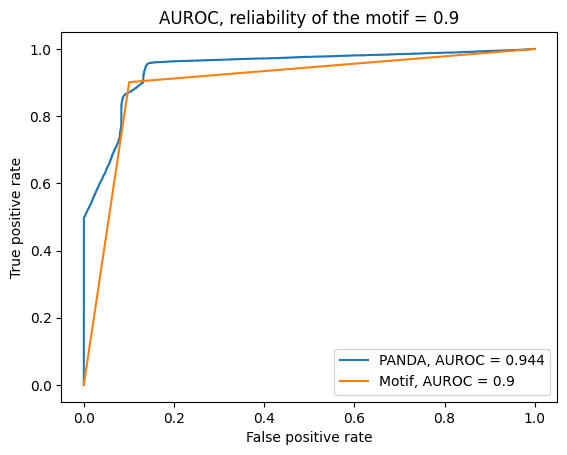

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 198
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5631539991607856
step: 1, hamming: 0.5569810262344818
step: 2, hamming: 0.6654487700207957
step: 3, hamming: 0.7245071890970868
step: 4, hamming: 0.759454428430289
step: 5, hamming: 0.7757342205812492
step: 6, hamming: 0.7760078483330493
step: 7, hamming: 0.762855563638607
step: 8, hamming: 0.7389321149218085
step: 9, hamming: 0.7067073989251806
step: 10, hamming: 0.6683414872016555
step: 11, hamming: 0.6256774577594206
step: 12, hamming: 0.5802760492382889
step: 13, hamming: 0.5334577540452181
step: 14, hamming: 0.4863385854627903
step: 15, hamming: 0.4398553613932015
step: 16, hamming: 0.3947820345066583
step

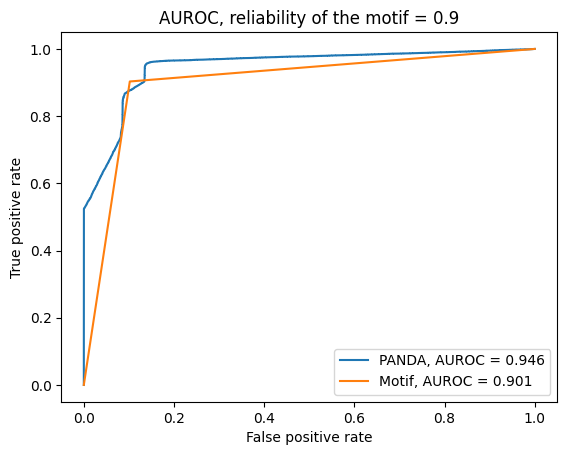

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 158
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5381761119455417
step: 1, hamming: 0.4995459797957597
step: 2, hamming: 0.6027438226209563
step: 3, hamming: 0.6573466967586085
step: 4, hamming: 0.6885328959676685
step: 5, hamming: 0.7020443342989368
step: 6, hamming: 0.7006236316481855
step: 7, hamming: 0.6867065181367406
step: 8, hamming: 0.6627717605626282
step: 9, hamming: 0.631198929843739
step: 10, hamming: 0.5941331731153146
step: 11, hamming: 0.5534260427038712
step: 12, hamming: 0.5106337478716597
step: 13, hamming: 0.46704201369386544
step: 14, hamming: 0.4236982368554702
step: 15, hamming: 0.3814400319765201
step: 16, hamming: 0.3409191820926774
st

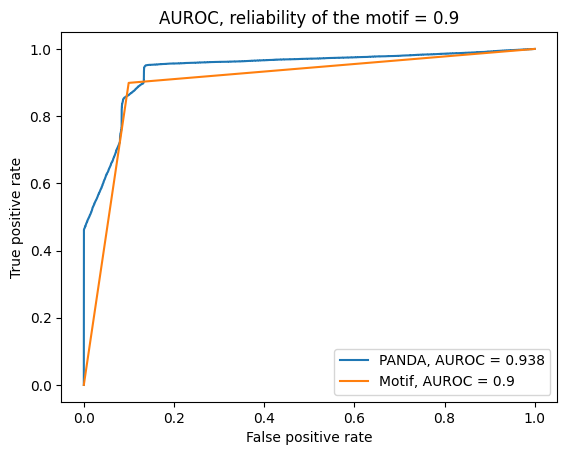

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 156
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5649516962942983
step: 1, hamming: 0.5651601452060396
step: 2, hamming: 0.6751334847219033
step: 3, hamming: 0.7364289120247002
step: 4, hamming: 0.7737557353027766
step: 5, hamming: 0.7923203888333676
step: 6, hamming: 0.7947726304147266
step: 7, hamming: 0.7837224746227579
step: 8, hamming: 0.7617964257200879
step: 9, hamming: 0.7313876284699292
step: 10, hamming: 0.6945695183291728
step: 11, hamming: 0.6531164143898451
step: 12, hamming: 0.6085465345765637
step: 13, hamming: 0.562159025275273
step: 14, hamming: 0.5150650282502409
step: 15, hamming: 0.46821180695787246
step: 16, hamming: 0.42239863070636646
s

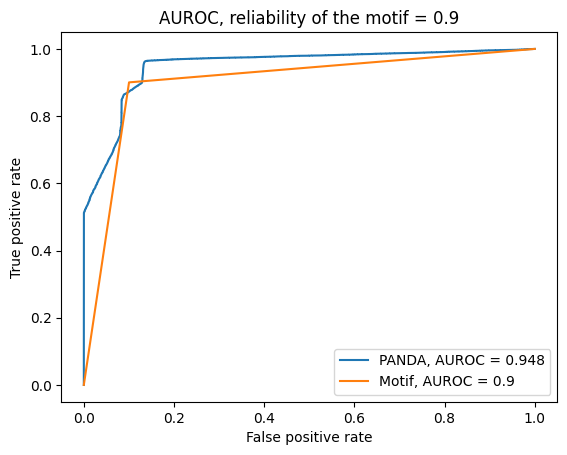

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 150
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5321116546694296
step: 1, hamming: 0.478306403071178
step: 2, hamming: 0.5800410497909704
step: 3, hamming: 0.633694625477949
step: 4, hamming: 0.6643870864397217
step: 5, hamming: 0.677633116813106
step: 6, hamming: 0.6760108078047788
step: 7, hamming: 0.6617912480738757
step: 8, hamming: 0.6373420767523607
step: 9, hamming: 0.6050186371265781
step: 10, hamming: 0.5670084267767886
step: 11, hamming: 0.5252470360612508
step: 12, hamming: 0.4814079508579743
step: 13, hamming: 0.4369069676406111
step: 14, hamming: 0.39291557402448146
step: 15, hamming: 0.3503717968815408
step: 16, hamming: 0.3099920166107732
step

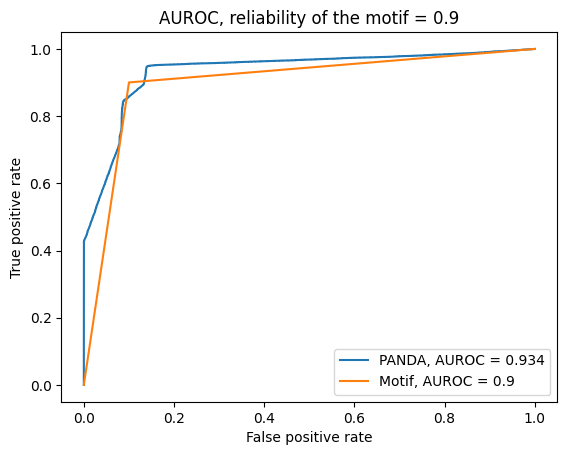

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 158
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5560582812340071
step: 1, hamming: 0.5430477393185072
step: 2, hamming: 0.6530363418608675
step: 3, hamming: 0.7134477953792558
step: 4, hamming: 0.7495542159672295
step: 5, hamming: 0.7668668213835365
step: 6, hamming: 0.7680833191027718
step: 7, hamming: 0.7557339444751423
step: 8, hamming: 0.7324085047009466
step: 9, hamming: 0.700534824774027
step: 10, hamming: 0.662250513151202
step: 11, hamming: 0.6194106216581577
step: 12, hamming: 0.5736276914306881
step: 13, hamming: 0.5263041569986742
step: 14, hamming: 0.4786479931582309
step: 15, hamming: 0.43168080764766986
step: 16, hamming: 0.3862435622420639
ste

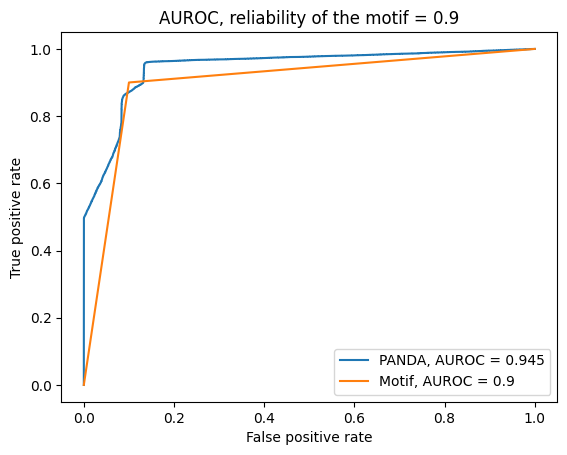

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 148
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5357291821488003
step: 1, hamming: 0.46904322244563074
step: 2, hamming: 0.5704148438221145
step: 3, hamming: 0.6232276563652623
step: 4, hamming: 0.6528760051485945
step: 5, hamming: 0.665288945230801
step: 6, hamming: 0.6632282509077166
step: 7, hamming: 0.6490489968167714
step: 8, hamming: 0.6251541787501117
step: 9, hamming: 0.5938892022085408
step: 10, hamming: 0.5573867843984887
step: 11, hamming: 0.5174914272630429
step: 12, hamming: 0.4757521201111525
step: 13, hamming: 0.43344504704087367
step: 14, hamming: 0.39160232472631834
step: 15, hamming: 0.35103878287120965
step: 16, hamming: 0.3123760029388687

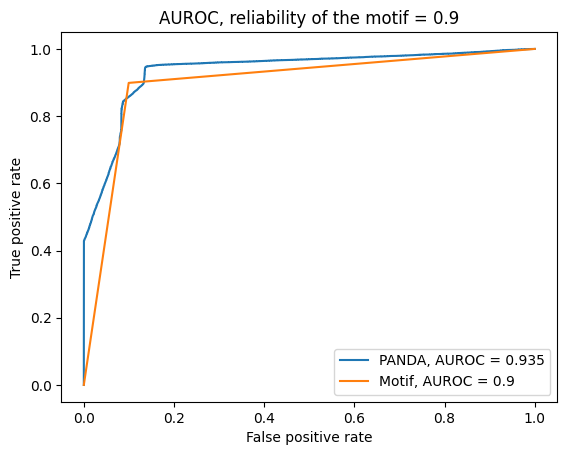

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 196
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5791887181429622
step: 1, hamming: 0.5973104498685168
step: 2, hamming: 0.7125549071683309
step: 3, hamming: 0.7777812637712281
step: 4, hamming: 0.8181749443857514
step: 5, hamming: 0.8390329065126598
step: 6, hamming: 0.8432255580485718
step: 7, hamming: 0.8335145487053554
step: 8, hamming: 0.8125378916075744
step: 9, hamming: 0.7826349568212584
step: 10, hamming: 0.7458167132131461
step: 11, hamming: 0.7038016350431301
step: 12, hamming: 0.6580617507532092
step: 13, hamming: 0.609875352635551
step: 14, hamming: 0.5603753314982163
step: 15, hamming: 0.5105795712598654
step: 16, hamming: 0.4614005217450143
ste

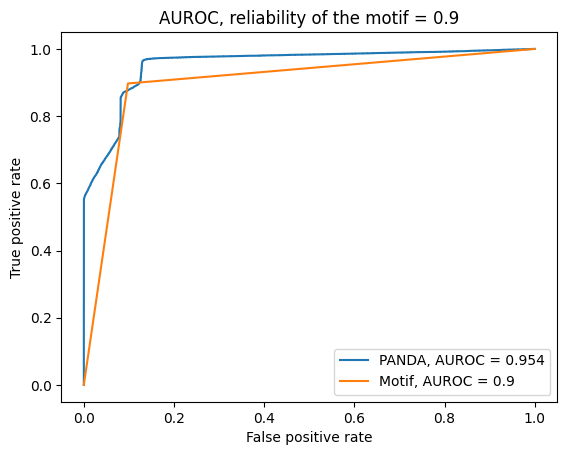

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 166
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.539779739311166
step: 1, hamming: 0.49296216315806457
step: 2, hamming: 0.5925371478253456
step: 3, hamming: 0.6445160592621636
step: 4, hamming: 0.6732831405078432
step: 5, hamming: 0.6844161714782164
step: 6, hamming: 0.6805813006117232
step: 7, hamming: 0.6642041299063229
step: 8, hamming: 0.6378102664642152
step: 9, hamming: 0.6038569203505829
step: 10, hamming: 0.5645669759225184
step: 11, hamming: 0.521874383492334
step: 12, hamming: 0.47742973501374014
step: 13, hamming: 0.43260988250211246
step: 14, hamming: 0.3885381433978269
step: 15, hamming: 0.34609940767726516
step: 16, hamming: 0.30595673260761747

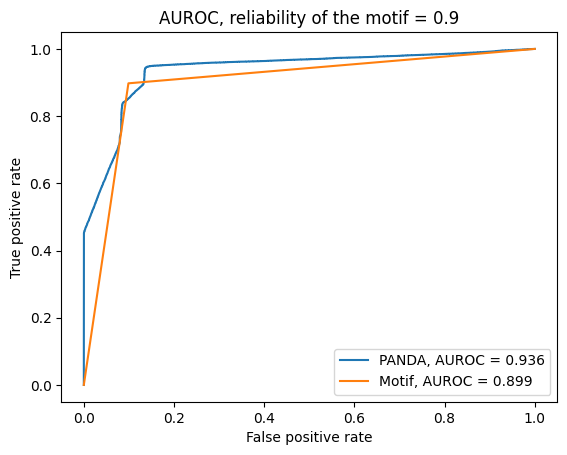

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 212
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5784756492490115
step: 1, hamming: 0.6100390943745229
step: 2, hamming: 0.732729089988338
step: 3, hamming: 0.8041342617079457
step: 4, hamming: 0.8503604634399556
step: 5, hamming: 0.8769733706653515
step: 6, hamming: 0.8869938786645082
step: 7, hamming: 0.8831948370171608
step: 8, hamming: 0.8681580318312954
step: 9, hamming: 0.8441231013614271
step: 10, hamming: 0.8129708327363796
step: 11, hamming: 0.7762720315870705
step: 12, hamming: 0.7353559729606116
step: 13, hamming: 0.691373438546772
step: 14, hamming: 0.6453402900428462
step: 15, hamming: 0.59816248505094
step: 16, hamming: 0.5506482422713871
step: 

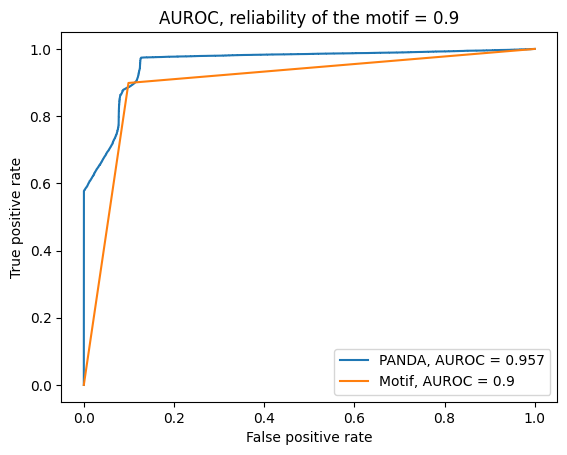

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 214
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5844696827005591
step: 1, hamming: 0.6188963552122534
step: 2, hamming: 0.7416066740560581
step: 3, hamming: 0.8128714117052913
step: 4, hamming: 0.8587314685920213
step: 5, hamming: 0.8843327083662478
step: 6, hamming: 0.8925750138180698
step: 7, hamming: 0.8863132806747591
step: 8, hamming: 0.8681374823975528
step: 9, hamming: 0.8401688539576257
step: 10, hamming: 0.8041496396154703
step: 11, hamming: 0.761612227812423
step: 12, hamming: 0.7139880167327989
step: 13, hamming: 0.6626626114335177
step: 14, hamming: 0.6089942940281045
step: 15, hamming: 0.5543013622030215
step: 16, hamming: 0.4998253723202975
ste

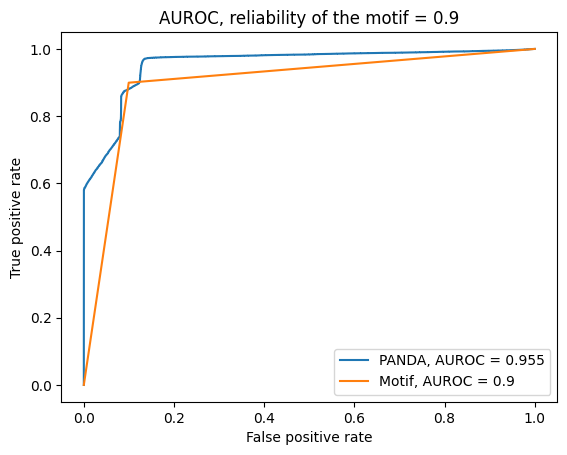

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 188
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5616398070075908
step: 1, hamming: 0.5545572108553808
step: 2, hamming: 0.6632886842759405
step: 3, hamming: 0.7235062587457035
step: 4, hamming: 0.7603427338923469
step: 5, hamming: 0.7792114499511759
step: 6, hamming: 0.7826466222469798
step: 7, hamming: 0.7730709936117169
step: 8, hamming: 0.7530344037869452
step: 9, hamming: 0.7249450865996097
step: 10, hamming: 0.6908707328197627
step: 11, hamming: 0.6525030022351337
step: 12, hamming: 0.6112156048645387
step: 13, hamming: 0.5681397678710788
step: 14, hamming: 0.5242238437891623
step: 15, hamming: 0.4802724174653375
step: 16, hamming: 0.43696966703068163
s

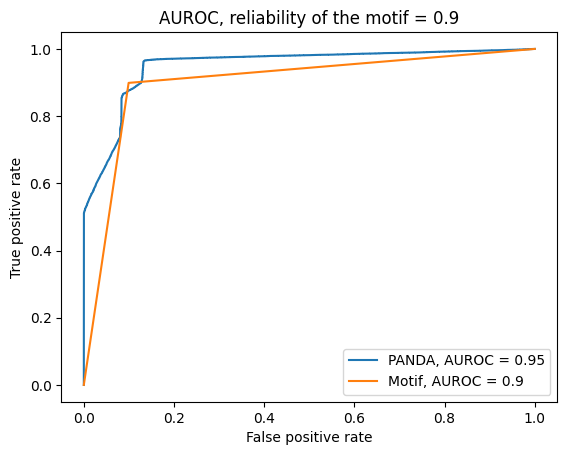

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 182
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.556279416029171
step: 1, hamming: 0.5550928118081373
step: 2, hamming: 0.6676499584272764
step: 3, hamming: 0.7297377219024388
step: 4, hamming: 0.7675321282347534
step: 5, hamming: 0.786771679658428
step: 6, hamming: 0.7902709967187151
step: 7, hamming: 0.7805701604166166
step: 8, hamming: 0.760192093120596
step: 9, hamming: 0.7315081090326093
step: 10, hamming: 0.6966041135985038
step: 11, hamming: 0.6572355658036537
step: 12, hamming: 0.6148570491473601
step: 13, hamming: 0.5706778948642902
step: 14, hamming: 0.5257114198161829
step: 15, hamming: 0.48080994808133026
step: 16, hamming: 0.4366881017755047
step

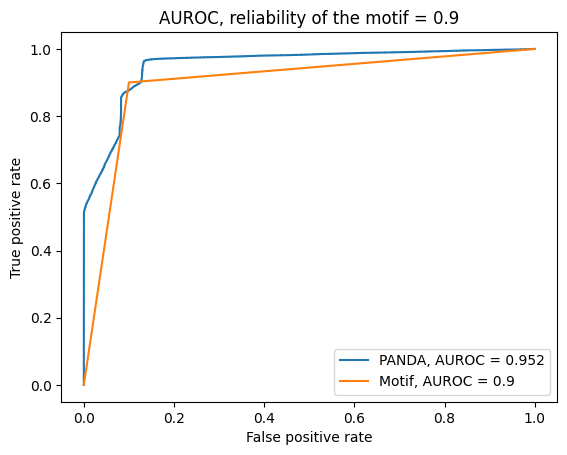

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5776614495891564
step: 1, hamming: 0.5642490378000399
step: 2, hamming: 0.6798754454857999
step: 3, hamming: 0.7441590518099117
step: 4, hamming: 0.7837600673470506
step: 5, hamming: 0.8042175876293299
step: 6, hamming: 0.808202848316719
step: 7, hamming: 0.7982419778586264
step: 8, hamming: 0.776901540142444
step: 9, hamming: 0.7465807479922919
step: 10, hamming: 0.7093794915937857
step: 11, hamming: 0.6671128027870239
step: 12, hamming: 0.6213694145636902
step: 13, hamming: 0.5735519035391081
step: 14, hamming: 0.5248934378133311
step: 15, hamming: 0.47645899429178445
step: 16, hamming: 0.42914369116868273
st

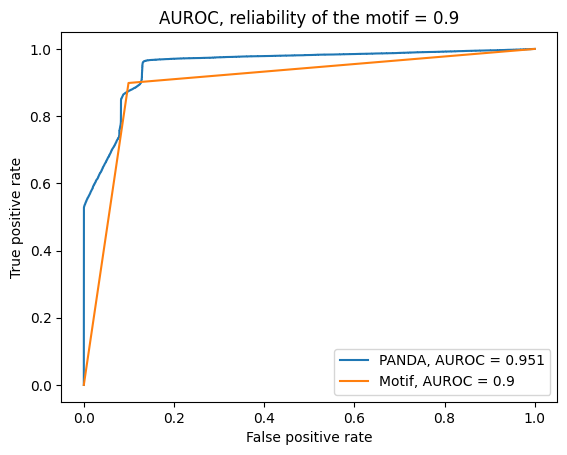

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 158
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5619373914507819
step: 1, hamming: 0.5430311352277407
step: 2, hamming: 0.6500021028907872
step: 3, hamming: 0.7087998476306864
step: 4, hamming: 0.7439157362326354
step: 5, hamming: 0.7606298916951071
step: 6, hamming: 0.7615997505709985
step: 7, hamming: 0.7493416583385404
step: 8, hamming: 0.7263837084521086
step: 9, hamming: 0.6951151122164179
step: 10, hamming: 0.657652038745792
step: 11, hamming: 0.6158148337827427
step: 12, hamming: 0.571160772361388
step: 13, hamming: 0.5250216691478112
step: 14, hamming: 0.47853223757671737
step: 15, hamming: 0.4326485023143112
step: 16, hamming: 0.3881591451034854
ste

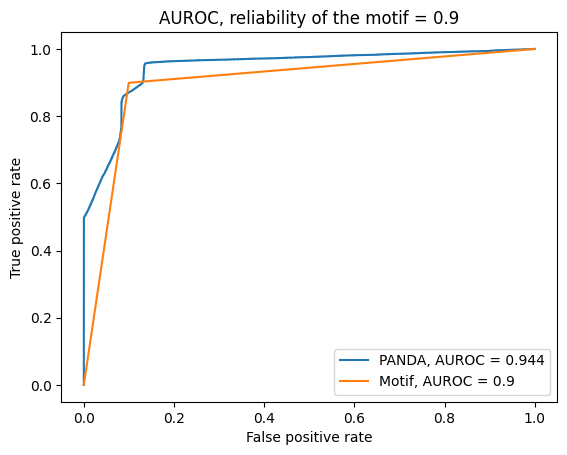

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 164
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5602397583248592
step: 1, hamming: 0.5424434434787476
step: 2, hamming: 0.6537478683651359
step: 3, hamming: 0.7150696506630743
step: 4, hamming: 0.7523449623526662
step: 5, hamming: 0.7711128462110726
step: 6, hamming: 0.7740556877740613
step: 7, hamming: 0.7637281906088564
step: 8, hamming: 0.7427147172738727
step: 9, hamming: 0.7133904611094037
step: 10, hamming: 0.6778085243072615
step: 11, hamming: 0.6377147931617196
step: 12, hamming: 0.5945924355592366
step: 13, hamming: 0.5497062405392616
step: 14, hamming: 0.5041353421062024
step: 15, hamming: 0.4587963593992911
step: 16, hamming: 0.4144582457083403
st

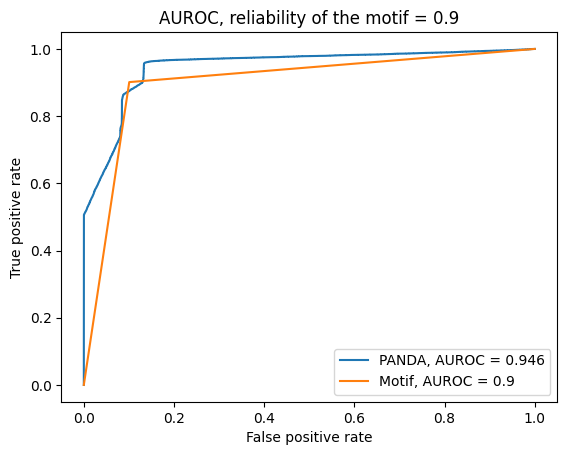

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 170
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5467847240601452
step: 1, hamming: 0.5250869570221751
step: 2, hamming: 0.6335005959350751
step: 3, hamming: 0.6917279581509804
step: 4, hamming: 0.7257760448387334
step: 5, hamming: 0.7413717755378247
step: 6, hamming: 0.7412698753623728
step: 7, hamming: 0.728027522646177
step: 8, hamming: 0.7042542348827181
step: 9, hamming: 0.6724120786535349
step: 10, hamming: 0.6346719583559028
step: 11, hamming: 0.5928891209645044
step: 12, hamming: 0.5486337446954411
step: 13, hamming: 0.503226608390172
step: 14, hamming: 0.45776835514466735
step: 15, hamming: 0.4131628090717381
step: 16, hamming: 0.37013508430370856
st

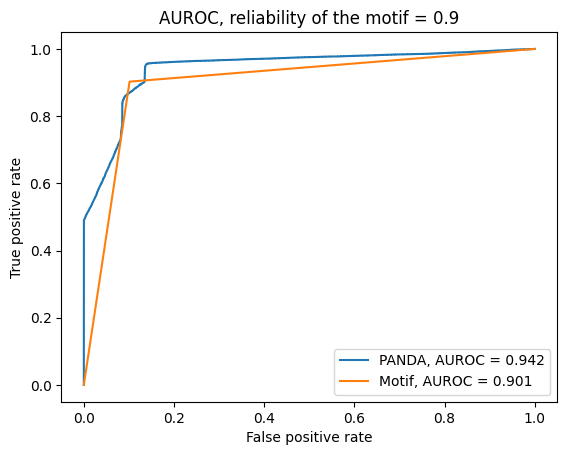

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5714939955907324
step: 1, hamming: 0.5489563460452332
step: 2, hamming: 0.6518605944804596
step: 3, hamming: 0.707168927641094
step: 4, hamming: 0.7384964442832728
step: 5, hamming: 0.7511653315139699
step: 6, hamming: 0.7479040627758116
step: 7, hamming: 0.7313198166703967
step: 8, hamming: 0.7040895524258663
step: 9, hamming: 0.6687611389469329
step: 10, hamming: 0.6276236767058883
step: 11, hamming: 0.5826631103329537
step: 12, hamming: 0.535565788274131
step: 13, hamming: 0.4877442648005354
step: 14, hamming: 0.4403642314684133
step: 15, hamming: 0.3943668723763954
step: 16, hamming: 0.3504861544643811
step

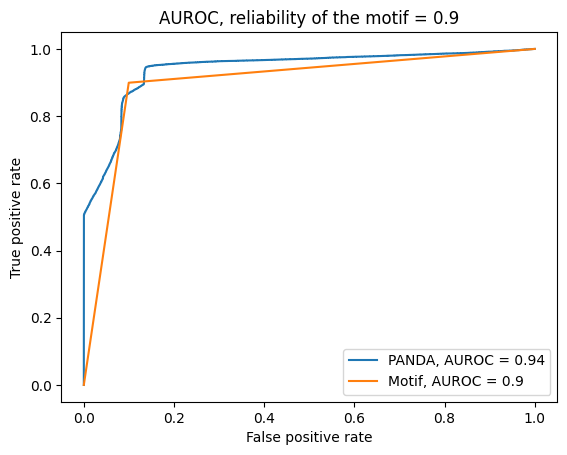

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 182
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5720363144836166
step: 1, hamming: 0.5606614168783368
step: 2, hamming: 0.6690306501066173
step: 3, hamming: 0.7290497087361233
step: 4, hamming: 0.7649290137810015
step: 5, hamming: 0.7818873250273207
step: 6, hamming: 0.7826447694822408
step: 7, hamming: 0.7697639346709839
step: 8, hamming: 0.7458170531700681
step: 9, hamming: 0.7132129919590543
step: 10, hamming: 0.6741025917954057
step: 11, hamming: 0.630365072858681
step: 12, hamming: 0.5836328647832536
step: 13, hamming: 0.5353228936941151
step: 14, hamming: 0.4866589785517615
step: 15, hamming: 0.43868366172039563
step: 16, hamming: 0.3922625741509418
st

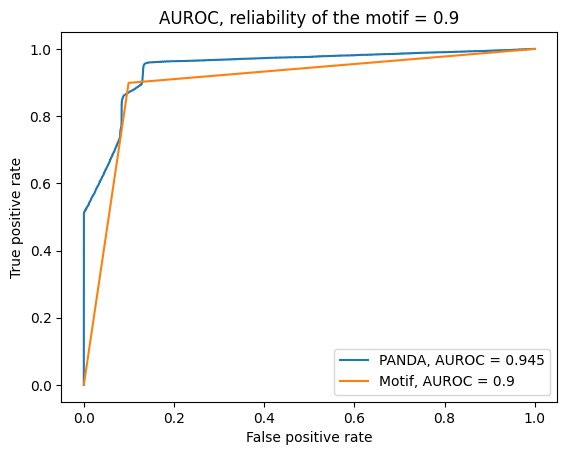

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5544888871954745
step: 1, hamming: 0.5497312197613677
step: 2, hamming: 0.6626141527567406
step: 3, hamming: 0.7254721483434238
step: 4, hamming: 0.7640210356143453
step: 5, hamming: 0.7839121626915689
step: 6, hamming: 0.7879618443278127
step: 7, hamming: 0.778734191539795
step: 8, hamming: 0.7587617839799627
step: 9, hamming: 0.7303664727831506
step: 10, hamming: 0.6955750968013444
step: 11, hamming: 0.6561121679120275
step: 12, hamming: 0.6134383547094437
step: 13, hamming: 0.568795081493667
step: 14, hamming: 0.5232428204390063
step: 15, hamming: 0.4776890162164916
step: 16, hamming: 0.43290580232693027
ste

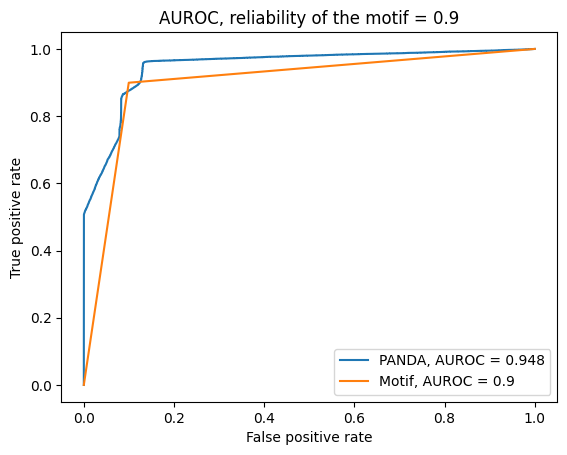

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 160
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5598330237024095
step: 1, hamming: 0.5061984170342609
step: 2, hamming: 0.6030431705769054
step: 3, hamming: 0.6525820361154006
step: 4, hamming: 0.6785774603041794
step: 5, hamming: 0.6866245919343807
step: 6, hamming: 0.6795196137199205
step: 7, hamming: 0.6598149837634919
step: 8, hamming: 0.6301679134769166
step: 9, hamming: 0.5931837677605488
step: 10, hamming: 0.5512405559776694
step: 11, hamming: 0.5064052999026618
step: 12, hamming: 0.4604015589789193
step: 13, hamming: 0.414618172961839
step: 14, hamming: 0.3701450918303048
step: 15, hamming: 0.32780670884870283
step: 16, hamming: 0.2881890940435783
st

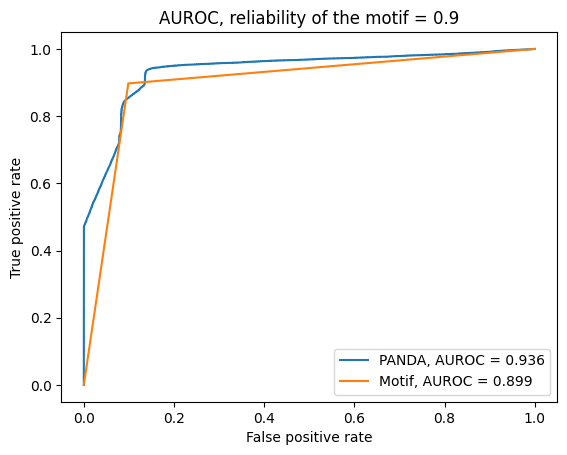

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 172
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.553256054314675
step: 1, hamming: 0.5464623389382847
step: 2, hamming: 0.6565312382671081
step: 3, hamming: 0.7163274536885655
step: 4, hamming: 0.7516384492944687
step: 5, hamming: 0.7680041019885235
step: 6, hamming: 0.7681951331124721
step: 7, hamming: 0.7548113707455116
step: 8, hamming: 0.730453633486174
step: 9, hamming: 0.6975824066686919
step: 10, hamming: 0.658412544397694
step: 11, hamming: 0.6148738395105252
step: 12, hamming: 0.5686288758668971
step: 13, hamming: 0.5210992656293273
step: 14, hamming: 0.47348475670616313
step: 15, hamming: 0.4267757172696007
step: 16, hamming: 0.38176489532387275
ste

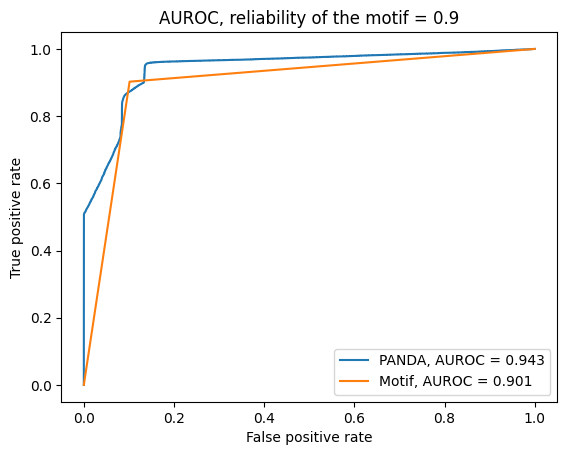

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 176
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5723021490064661
step: 1, hamming: 0.5663508798636074
step: 2, hamming: 0.6767780273472608
step: 3, hamming: 0.7382268240918268
step: 4, hamming: 0.7753387165120924
step: 5, hamming: 0.7934916230648001
step: 6, hamming: 0.7954242083339972
step: 7, hamming: 0.7837460449732152
step: 8, hamming: 0.7610617004292839
step: 9, hamming: 0.7297734542373032
step: 10, hamming: 0.691990873968838
step: 11, hamming: 0.6495309319624247
step: 12, hamming: 0.6039528887865766
step: 13, hamming: 0.556598008998408
step: 14, hamming: 0.5086209554668508
step: 15, hamming: 0.461010272083599
step: 16, hamming: 0.4145997372263001
step:

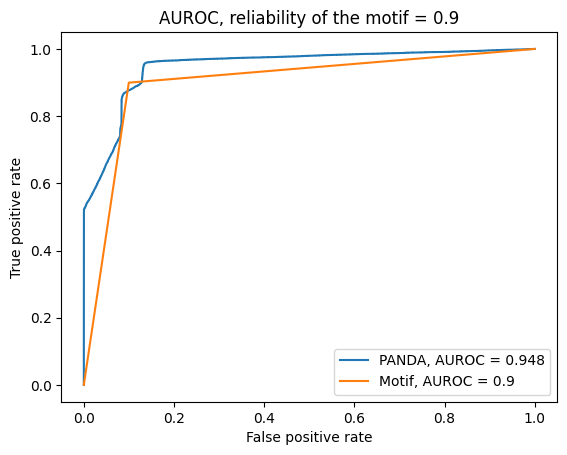

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 202
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5679207036759635
step: 1, hamming: 0.5651657681333282
step: 2, hamming: 0.6783673103383953
step: 3, hamming: 0.7416893653249709
step: 4, hamming: 0.7805432222336828
step: 5, hamming: 0.8003717355061534
step: 6, hamming: 0.803956114207457
step: 7, hamming: 0.793883557687403
step: 8, hamming: 0.7727054552771121
step: 9, hamming: 0.7427748372584029
step: 10, hamming: 0.7061583158504054
step: 11, hamming: 0.6646342358252736
step: 12, hamming: 0.6197323186560814
step: 13, hamming: 0.5727791565250934
step: 14, hamming: 0.5249310551240873
step: 15, hamming: 0.47719118774852537
step: 16, hamming: 0.4304163194820229
ste

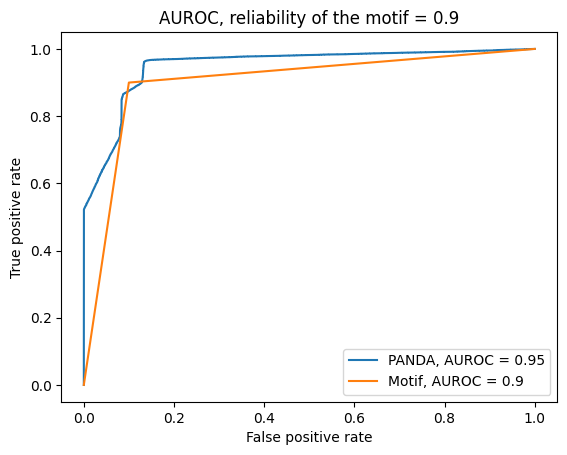

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 158
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5454308060428759
step: 1, hamming: 0.5042629962316384
step: 2, hamming: 0.6092866486144453
step: 3, hamming: 0.6653545615929327
step: 4, hamming: 0.6978692498727067
step: 5, hamming: 0.712372010797837
step: 6, hamming: 0.7115723796459297
step: 7, hamming: 0.697933320353472
step: 8, hamming: 0.6740122920463282
step: 9, hamming: 0.6422622635630193
step: 10, hamming: 0.6048778103824555
step: 11, hamming: 0.5637445552260736
step: 12, hamming: 0.5204506562253958
step: 13, hamming: 0.4763151555930331
step: 14, hamming: 0.4324141735179875
step: 15, hamming: 0.3896051555927814
step: 16, hamming: 0.3485506829698048
step

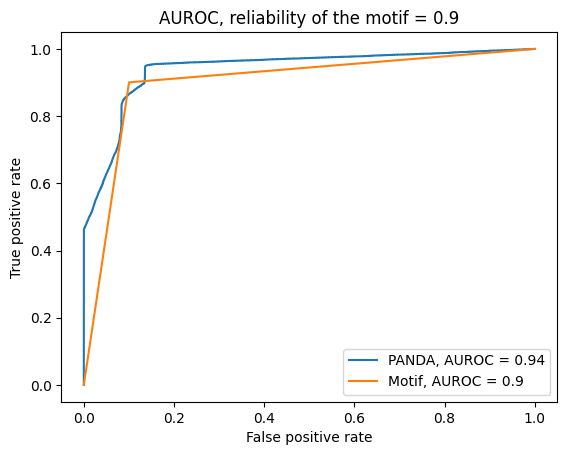

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 204
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.03 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5678663326681537
step: 1, hamming: 0.5811151756366493
step: 2, hamming: 0.6994451150273704
step: 3, hamming: 0.7669263120032223
step: 4, hamming: 0.8097721719471931
step: 5, hamming: 0.833520442482382
step: 6, hamming: 0.8410069562103104
step: 7, hamming: 0.8348951322386088
step: 8, hamming: 0.8177555635189262
step: 9, hamming: 0.7918680422813399
step: 10, hamming: 0.7591786983834223
step: 11, hamming: 0.7213406024748307
step: 12, hamming: 0.6797630124950226
step: 13, hamming: 0.6356534033665955
step: 14, hamming: 0.5900502774402276
step: 15, hamming: 0.5438479287102136
step: 16, hamming: 0.49781541555037523
st

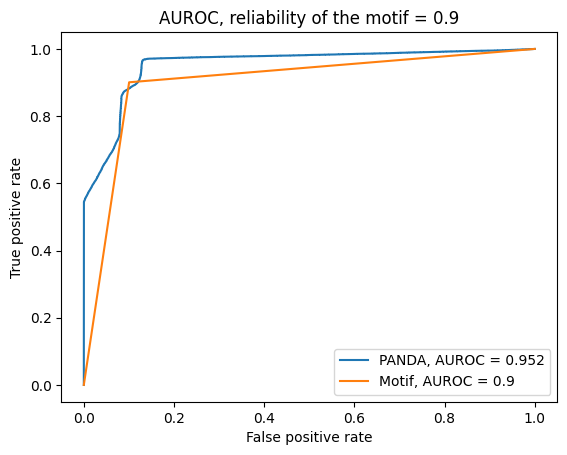

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 192
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5707323846351879
step: 1, hamming: 0.590244083862709
step: 2, hamming: 0.7041947718635693
step: 3, hamming: 0.7684527148633209
step: 4, hamming: 0.8081632468240675
step: 5, hamming: 0.8285665032825493
step: 6, hamming: 0.8323784792788075
step: 7, hamming: 0.8222709180486748
step: 8, hamming: 0.8008576340463125
step: 9, hamming: 0.7704640375926669
step: 10, hamming: 0.7330803773955386
step: 11, hamming: 0.6904241934532227
step: 12, hamming: 0.6440013228002133
step: 13, hamming: 0.5951495163416725
step: 14, hamming: 0.5450713467069296
step: 15, hamming: 0.49485177362945093
step: 16, hamming: 0.4454579814829889
st

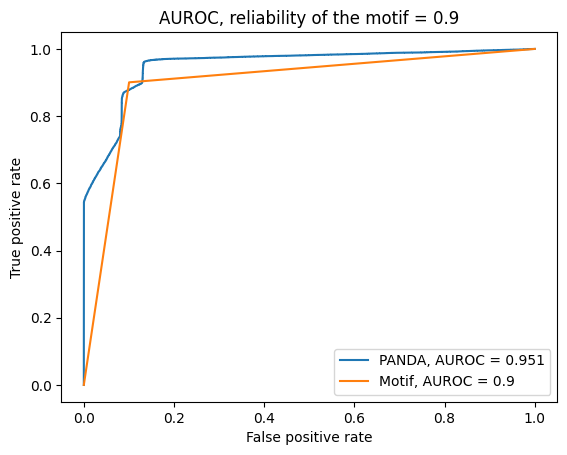

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 200
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5839812460377973
step: 1, hamming: 0.593431730878173
step: 2, hamming: 0.704079586610687
step: 3, hamming: 0.7652402940622207
step: 4, hamming: 0.8012261650324178
step: 5, hamming: 0.8172537547481162
step: 6, hamming: 0.8161438651578229
step: 7, hamming: 0.8006790093740946
step: 8, hamming: 0.7736410085275024
step: 9, hamming: 0.7376060529862433
step: 10, hamming: 0.694908984437691
step: 11, hamming: 0.6476167439193484
step: 12, hamming: 0.59752182741475
step: 13, hamming: 0.5461619401554276
step: 14, hamming: 0.49484225235904067
step: 15, hamming: 0.44464781860191516
step: 16, hamming: 0.39644788647000406
step

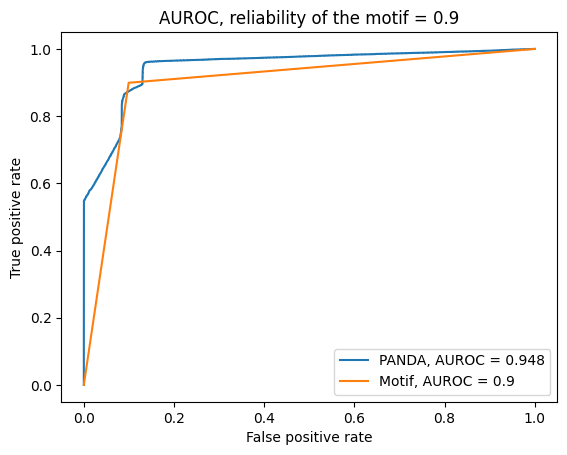

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 216
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5924762595593592
step: 1, hamming: 0.643990039964668
step: 2, hamming: 0.7704120548828942
step: 3, hamming: 0.8460807642362123
step: 4, hamming: 0.89616460648638
step: 5, hamming: 0.926052770915301
step: 6, hamming: 0.9388964996129817
step: 7, hamming: 0.937678726575786
step: 8, hamming: 0.9250215142530647
step: 9, hamming: 0.9030264122632596
step: 10, hamming: 0.8733426431026463
step: 11, hamming: 0.8373047130449496
step: 12, hamming: 0.7960465788984358
step: 13, hamming: 0.7505783392515164
step: 14, hamming: 0.7018435822363724
step: 15, hamming: 0.6507642880189161
step: 16, hamming: 0.5982669214327537
step: 1

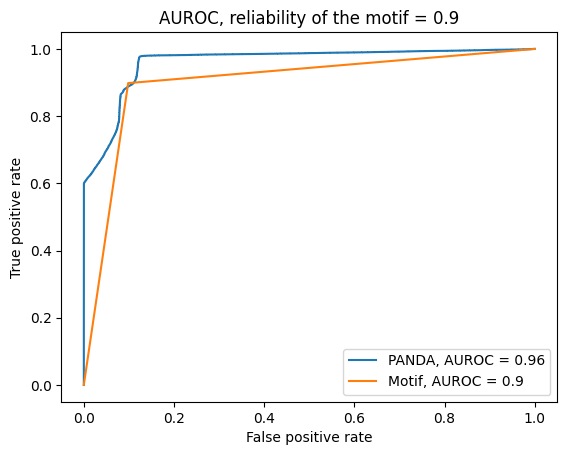

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 152
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5575106929508418
step: 1, hamming: 0.547003181115132
step: 2, hamming: 0.6597911033651911
step: 3, hamming: 0.722343886096639
step: 4, hamming: 0.7609630149302601
step: 5, hamming: 0.7812416495907277
step: 6, hamming: 0.7858239129524311
step: 7, hamming: 0.7771378807934344
step: 8, hamming: 0.7576591715453506
step: 9, hamming: 0.7296976873101823
step: 10, hamming: 0.695248418252151
step: 11, hamming: 0.6559821059678921
step: 12, hamming: 0.6133072413409705
step: 13, hamming: 0.568437696639354
step: 14, hamming: 0.5224390905546937
step: 15, hamming: 0.47625349683389073
step: 16, hamming: 0.43070899724266176
step

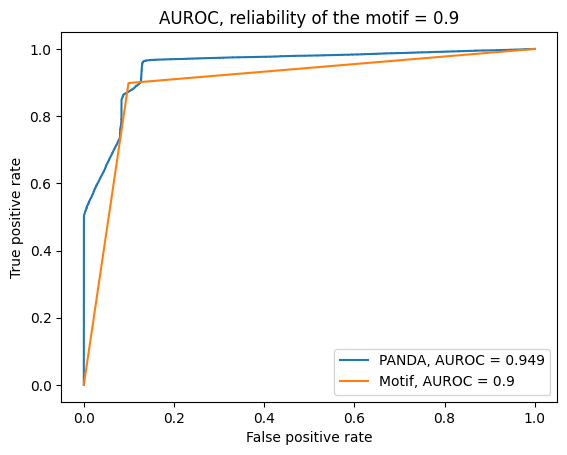

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.564483272371329
step: 1, hamming: 0.5803567740324892
step: 2, hamming: 0.7015659284931022
step: 3, hamming: 0.7711606456775227
step: 4, hamming: 0.8159204496735176
step: 5, hamming: 0.8414429681055285
step: 6, hamming: 0.8507013709095046
step: 7, hamming: 0.8463849948981527
step: 8, hamming: 0.8309606526287165
step: 9, hamming: 0.8066026726937832
step: 10, hamming: 0.7751806537711077
step: 11, hamming: 0.7382867274493561
step: 12, hamming: 0.6972841430718857
step: 13, hamming: 0.6533602487396492
step: 14, hamming: 0.6075669353432922
step: 15, hamming: 0.5608430910718877
step: 16, hamming: 0.5140237588308957
ste

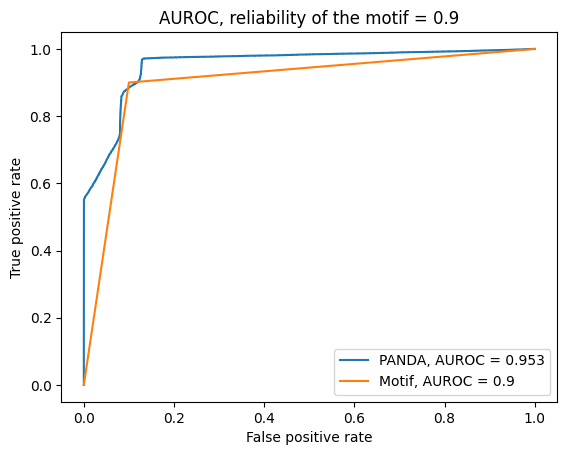

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 172
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5572572583082712
step: 1, hamming: 0.5492359252886364
step: 2, hamming: 0.6558266173127582
step: 3, hamming: 0.7132068239858131
step: 4, hamming: 0.7462958187001562
step: 5, hamming: 0.760544906897792
step: 6, hamming: 0.7587209521852015
step: 7, hamming: 0.7434562012308498
step: 8, hamming: 0.7174379063711838
step: 9, hamming: 0.6831973678972216
step: 10, hamming: 0.6429957027380565
step: 11, hamming: 0.5987799140509763
step: 12, hamming: 0.5521975377992921
step: 13, hamming: 0.5046378368508335
step: 14, hamming: 0.4572637959398671
step: 15, hamming: 0.4110287250750522
step: 16, hamming: 0.3666873918452207
ste

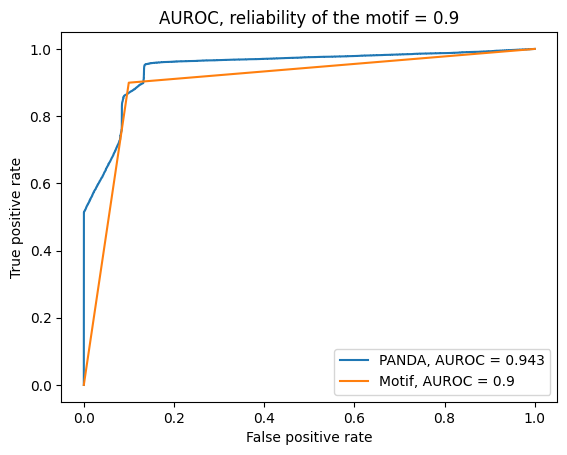

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 188
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5617586503319791
step: 1, hamming: 0.5518920227392359
step: 2, hamming: 0.664446089402498
step: 3, hamming: 0.7265214385908354
step: 4, hamming: 0.7641339586607139
step: 5, hamming: 0.7828656233538965
step: 6, hamming: 0.7854567347747193
step: 7, hamming: 0.7744532888570834
step: 8, hamming: 0.7523767538534352
step: 9, hamming: 0.7215658996479474
step: 10, hamming: 0.6840964664412857
step: 11, hamming: 0.6417721056196751
step: 12, hamming: 0.5961610107016753
step: 13, hamming: 0.5486379282173666
step: 14, hamming: 0.5004097606941516
step: 15, hamming: 0.4525283801642955
step: 16, hamming: 0.405891724332208
step

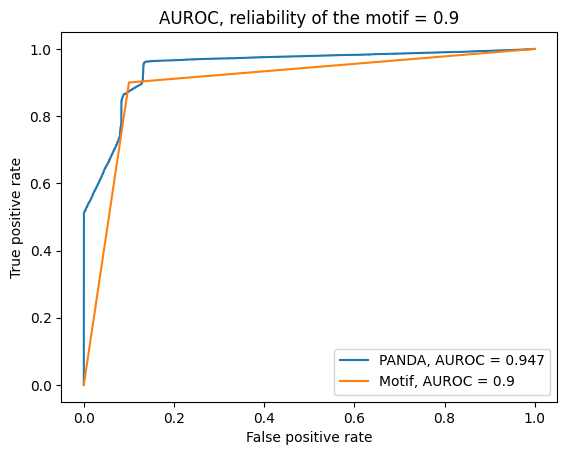

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 168
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5572365597439821
step: 1, hamming: 0.5395142519073577
step: 2, hamming: 0.64897987576774
step: 3, hamming: 0.7081871835758353
step: 4, hamming: 0.7432217998510016
step: 5, hamming: 0.7597387995677977
step: 6, hamming: 0.7604914372804414
step: 7, hamming: 0.7480010771712078
step: 8, hamming: 0.7248231404889031
step: 9, hamming: 0.6933792741609688
step: 10, hamming: 0.655820031315195
step: 11, hamming: 0.6139900117745646
step: 12, hamming: 0.5694518202992637
step: 13, hamming: 0.5235249364438211
step: 14, hamming: 0.47731997485605704
step: 15, hamming: 0.4317633171251943
step: 16, hamming: 0.3876138395756522
step

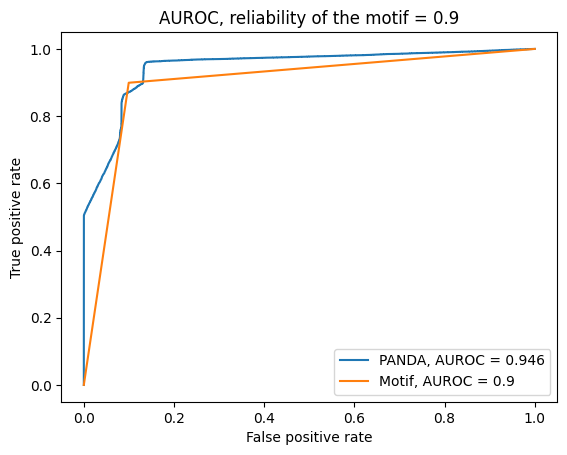

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5469180584518812
step: 1, hamming: 0.5276523829822436
step: 2, hamming: 0.6337066304305667
step: 3, hamming: 0.6906168416151848
step: 4, hamming: 0.7234746205126131
step: 5, hamming: 0.7379155090264985
step: 6, hamming: 0.736696926767856
step: 7, hamming: 0.7223147012041817
step: 8, hamming: 0.6973266262283654
step: 9, hamming: 0.664203920780058
step: 10, hamming: 0.6251715908470605
step: 11, hamming: 0.5821521348631329
step: 12, hamming: 0.5367872157051372
step: 13, hamming: 0.4904625942972113
step: 14, hamming: 0.44433098400368115
step: 15, hamming: 0.3993288349328498
step: 16, hamming: 0.35619230476883323
st

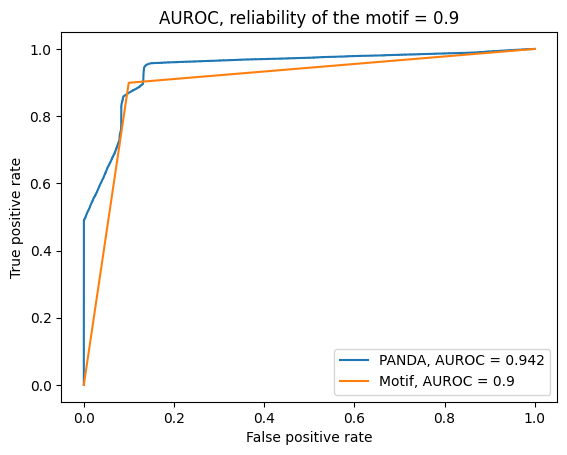

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 170
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5608079913321541
step: 1, hamming: 0.5631897071416375
step: 2, hamming: 0.6785480685891331
step: 3, hamming: 0.7431956286078462
step: 4, hamming: 0.7832712327628718
step: 5, hamming: 0.8043484099541943
step: 6, hamming: 0.8092002257810423
step: 7, hamming: 0.8004575521818231
step: 8, hamming: 0.780724539911154
step: 9, hamming: 0.7523657606389005
step: 10, hamming: 0.71742951130002
step: 11, hamming: 0.6776689810855844
step: 12, hamming: 0.6345821647118098
step: 13, hamming: 0.5894471949597766
step: 14, hamming: 0.5433516871688768
step: 15, hamming: 0.4972161562571976
step: 16, hamming: 0.4518117018071509
step:

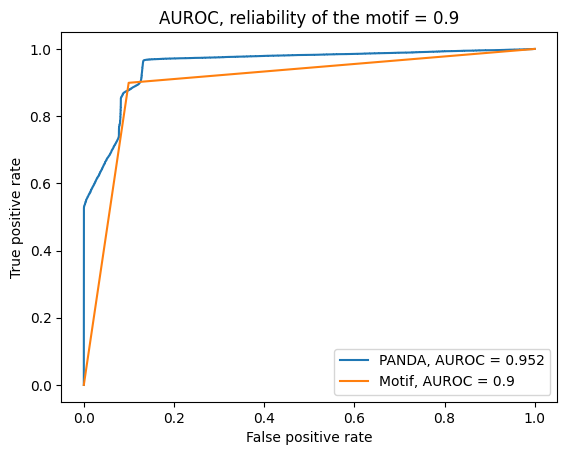

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 180
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5722788010705235
step: 1, hamming: 0.5742393816032956
step: 2, hamming: 0.690911379777987
step: 3, hamming: 0.7573781831008368
step: 4, hamming: 0.7991129422139547
step: 5, hamming: 0.8215118961000544
step: 6, hamming: 0.8273912269868791
step: 7, hamming: 0.819419960154883
step: 8, hamming: 0.8001422908417231
step: 9, hamming: 0.7718015770559647
step: 10, hamming: 0.7363219261469068
step: 11, hamming: 0.6953627098928586
step: 12, hamming: 0.650379472952022
step: 13, hamming: 0.6026763815734894
step: 14, hamming: 0.553442324885489
step: 15, hamming: 0.503765813264088
step: 16, hamming: 0.45463111293712166
step: 

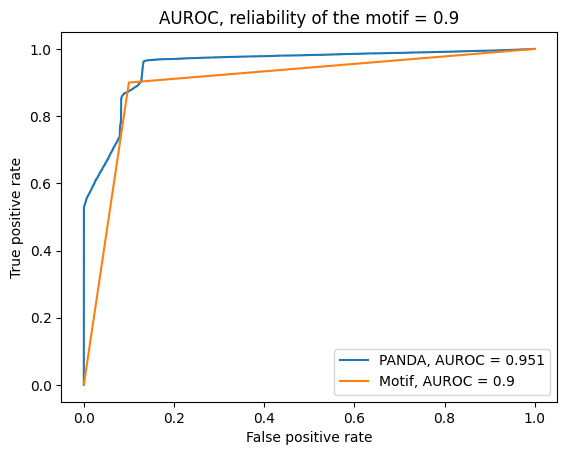

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 192
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5628304802483967
step: 1, hamming: 0.5622231460679152
step: 2, hamming: 0.6798602496750357
step: 3, hamming: 0.7464432935265589
step: 4, hamming: 0.788601659972186
step: 5, hamming: 0.8119714142770403
step: 6, hamming: 0.819364229594868
step: 7, hamming: 0.8133569380336747
step: 8, hamming: 0.7964195061191709
step: 9, hamming: 0.7707518877141645
step: 10, hamming: 0.738218573512757
step: 11, hamming: 0.7003752087320226
step: 12, hamming: 0.6585383195208467
step: 13, hamming: 0.6138579196359506
step: 14, hamming: 0.5673715389049254
step: 15, hamming: 0.5200342893246829
step: 16, hamming: 0.4727280278479588
step:

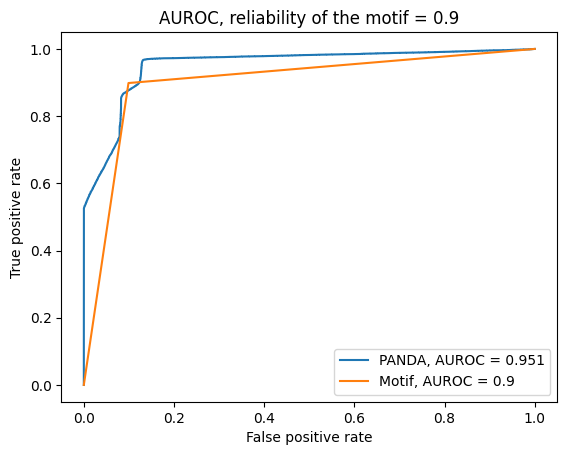

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5672269999816574
step: 1, hamming: 0.5803390393907307
step: 2, hamming: 0.6952003867605623
step: 3, hamming: 0.7593511026735179
step: 4, hamming: 0.79881542910509
step: 5, hamming: 0.8190805571168052
step: 6, hamming: 0.822987620766522
step: 7, hamming: 0.8132797393956721
step: 8, hamming: 0.7926232791615476
step: 9, hamming: 0.7634279261203321
step: 10, hamming: 0.7277813721103273
step: 11, hamming: 0.6874492229968475
step: 12, hamming: 0.6439121820010781
step: 13, hamming: 0.5984146747676895
step: 14, hamming: 0.5520058758365161
step: 15, hamming: 0.5055701930953549
step: 16, hamming: 0.45984977072829253
step

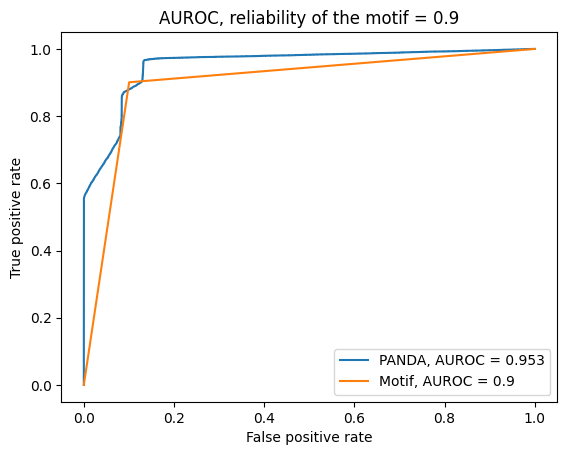

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 206
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5660743994837544
step: 1, hamming: 0.5728751591146388
step: 2, hamming: 0.6870037107499194
step: 3, hamming: 0.7508839525320173
step: 4, hamming: 0.7899939655609403
step: 5, hamming: 0.8096906381546795
step: 6, hamming: 0.812732092605673
step: 7, hamming: 0.8017821376592852
step: 8, hamming: 0.7794588433051828
step: 9, hamming: 0.7481495194816785
step: 10, hamming: 0.7099606694435728
step: 11, hamming: 0.6667363214356253
step: 12, hamming: 0.6200993120976314
step: 13, hamming: 0.5714804572144425
step: 14, hamming: 0.5221324319228036
step: 15, hamming: 0.4731330234764467
step: 16, hamming: 0.4253839970693013
ste

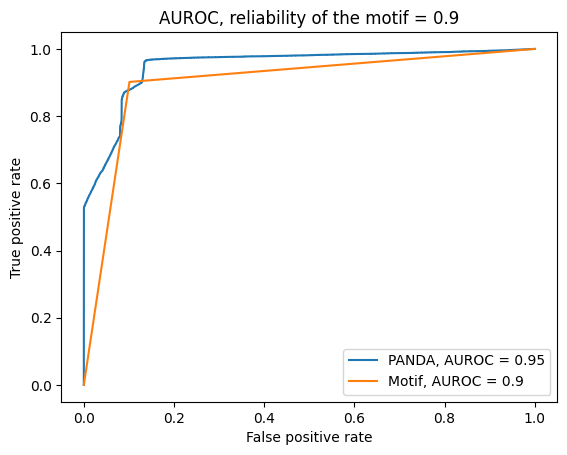

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 166
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.564987150550944
step: 1, hamming: 0.5508302864422207
step: 2, hamming: 0.6630539124532858
step: 3, hamming: 0.7256765006205423
step: 4, hamming: 0.7639949542425178
step: 5, hamming: 0.7835392554906276
step: 6, hamming: 0.7870135615632734
step: 7, hamming: 0.7769667520177432
step: 8, hamming: 0.7559527378055272
step: 9, hamming: 0.7263093849181338
step: 10, hamming: 0.6900687240975382
step: 11, hamming: 0.6489767561919522
step: 12, hamming: 0.6045401517252142
step: 13, hamming: 0.5580693210964814
step: 14, hamming: 0.5107107260609626
step: 15, hamming: 0.46346637356765386
step: 16, hamming: 0.41720124367811834
s

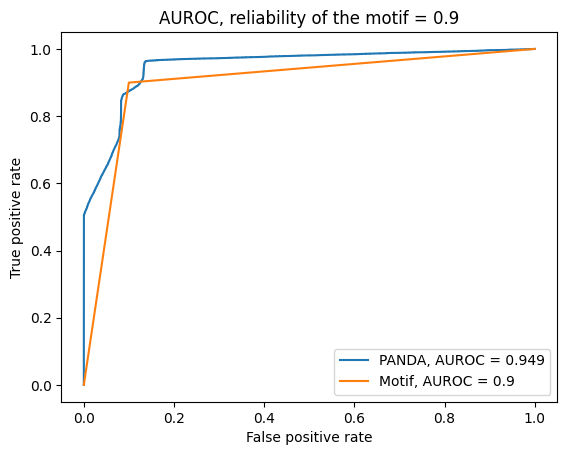

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5698510705935624
step: 1, hamming: 0.5762155970560575
step: 2, hamming: 0.6927153887836794
step: 3, hamming: 0.7582693517786202
step: 4, hamming: 0.7990639220739784
step: 5, hamming: 0.8206160023735605
step: 6, hamming: 0.8257721408746218
step: 7, hamming: 0.817139737976037
step: 8, hamming: 0.797225028222238
step: 9, hamming: 0.7683194472693078
step: 10, hamming: 0.7324294251911962
step: 11, hamming: 0.6912695696894807
step: 12, hamming: 0.6463100109239721
step: 13, hamming: 0.5988392886776881
step: 14, hamming: 0.5500120814184399
step: 15, hamming: 0.500871692356405
step: 16, hamming: 0.45235105302475337
step

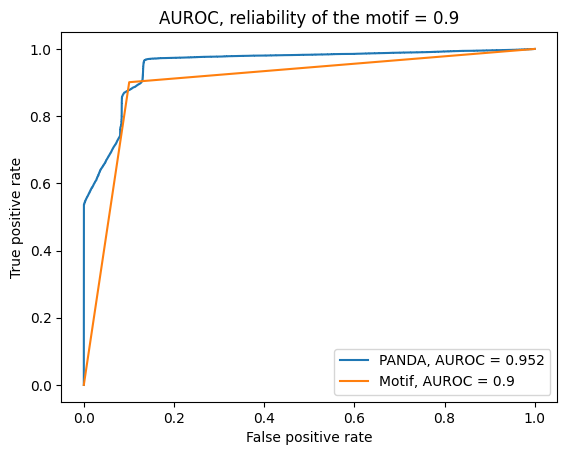

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 212
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5715122328933796
step: 1, hamming: 0.5761883309453546
step: 2, hamming: 0.6915082422006346
step: 3, hamming: 0.7561533502441298
step: 4, hamming: 0.7959045080118798
step: 5, hamming: 0.8163315533119286
step: 6, hamming: 0.8202909013244288
step: 7, hamming: 0.8104057188202394
step: 8, hamming: 0.7892586937607471
step: 9, hamming: 0.7592272174924477
step: 10, hamming: 0.7223879411056133
step: 11, hamming: 0.6805186412678402
step: 12, hamming: 0.6351487818672595
step: 13, hamming: 0.5876090999875937
step: 14, hamming: 0.5390634300301969
step: 15, hamming: 0.4905257139364989
step: 16, hamming: 0.4428680742992283
st

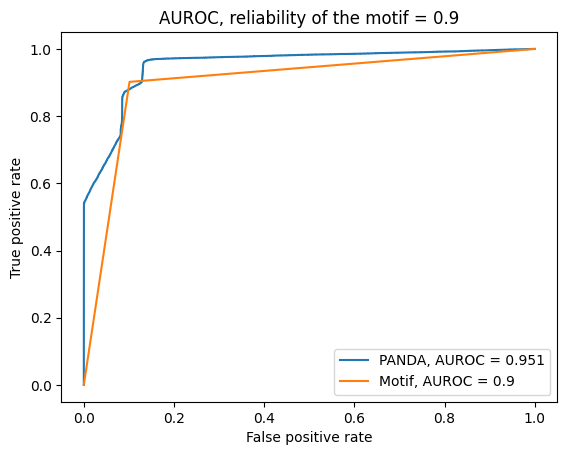

0.2
Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 192
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5635425738010675
step: 1, hamming: 0.5344897449123496
step: 2, hamming: 0.6535249375189564
step: 3, hamming: 0.7200495934902089
step: 4, hamming: 0.7618221498994243
step: 5, hamming: 0.7848480199729846
step: 6, hamming: 0.7919335687991208
step: 7, hamming: 0.7855625375597994
step: 8, hamming: 0.768206202644666
step: 9, hamming: 0.742172089642952
step: 10, hamming: 0.7094927581452134
step: 11, hamming: 0.6719060164357503
step: 12, hamming: 0.6308809261431573
step: 13, hamming: 0.5876578163683535
step: 14, hamming: 0.5432864685353249
step: 15, hamming: 0.4986562224869008
step: 16, hamming: 0.4545175676842498


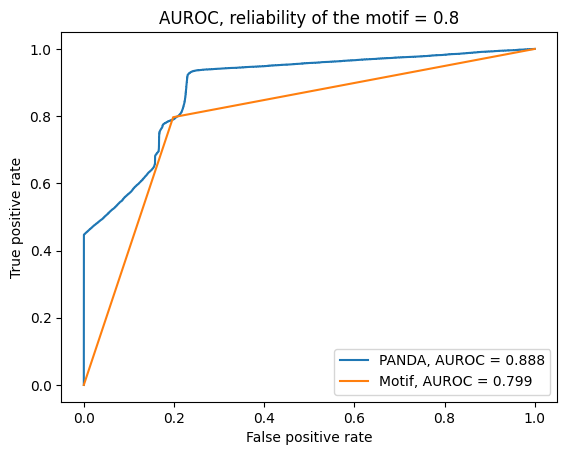

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 216
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5852829914485087
step: 1, hamming: 0.5814413898405228
step: 2, hamming: 0.7073967302431926
step: 3, hamming: 0.7805478167586053
step: 4, hamming: 0.82886966176347
step: 5, hamming: 0.8582246668003614
step: 6, hamming: 0.8714616527651422
step: 7, hamming: 0.8711363532579328
step: 8, hamming: 0.8596774302747207
step: 9, hamming: 0.839215290004469
step: 10, hamming: 0.8115173270959363
step: 11, hamming: 0.7780242052110278
step: 12, hamming: 0.7399308765042725
step: 13, hamming: 0.6982666588623677
step: 14, hamming: 0.6539566179884067
step: 15, hamming: 0.6078609320242329
step: 16, hamming: 0.5607944297007655
step:

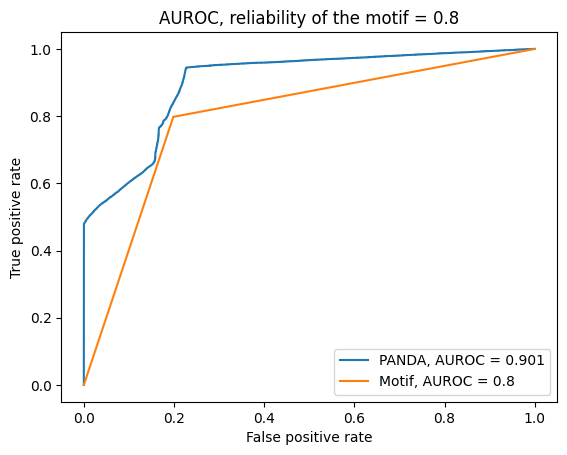

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 204
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5711229189081045
step: 1, hamming: 0.5529353514737058
step: 2, hamming: 0.6761329000376838
step: 3, hamming: 0.7457737989173427
step: 4, hamming: 0.7902562021378982
step: 5, hamming: 0.8157088973692955
step: 6, hamming: 0.8250450611191976
step: 7, hamming: 0.8208345293941655
step: 8, hamming: 0.8055751342840134
step: 9, hamming: 0.7815477846480163
step: 10, hamming: 0.7507261362313529
step: 11, hamming: 0.7147729661586677
step: 12, hamming: 0.6750800628890292
step: 13, hamming: 0.6328180161507077
step: 14, hamming: 0.5889798958438587
step: 15, hamming: 0.5444148729860415
step: 16, hamming: 0.4998526797504795
st

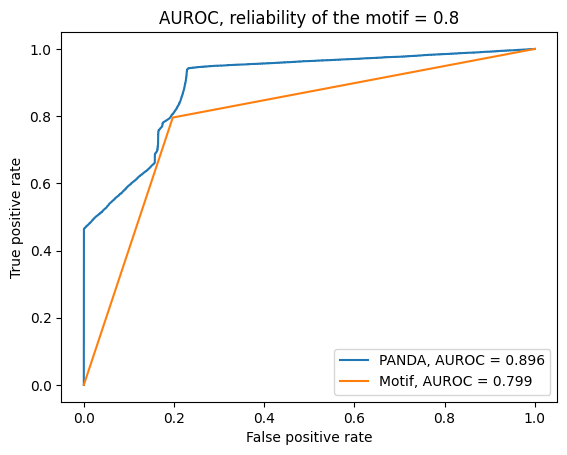

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 172
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5870320353942056
step: 1, hamming: 0.5848736701756018
step: 2, hamming: 0.710246369532875
step: 3, hamming: 0.7819269317650968
step: 4, hamming: 0.8281121464635774
step: 5, hamming: 0.8546132992587728
step: 6, hamming: 0.8643272548826149
step: 7, hamming: 0.8599678330684835
step: 8, hamming: 0.844130455079009
step: 9, hamming: 0.8190871995049144
step: 10, hamming: 0.7867462132813274
step: 11, hamming: 0.7487121202483679
step: 12, hamming: 0.7063600692903445
step: 13, hamming: 0.6608906363580065
step: 14, hamming: 0.6133689671016581
step: 15, hamming: 0.5647542624022387
step: 16, hamming: 0.5159191640303037
step

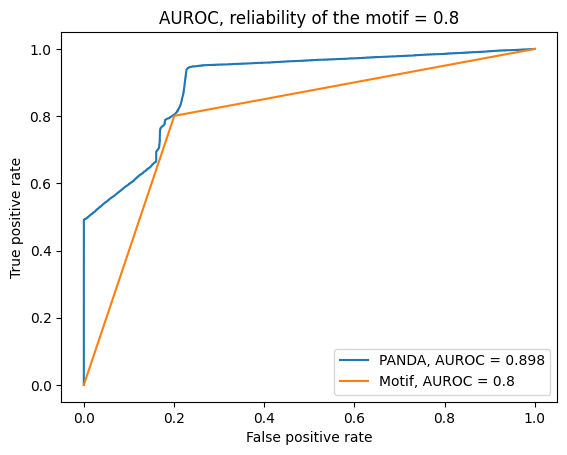

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 192
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5846356311216925
step: 1, hamming: 0.5655625339807063
step: 2, hamming: 0.6861111281581099
step: 3, hamming: 0.7547505288345121
step: 4, hamming: 0.7987264135359285
step: 5, hamming: 0.8237347069736671
step: 6, hamming: 0.8324837941694221
step: 7, hamming: 0.8274894923629984
step: 8, hamming: 0.8112553640254891
step: 9, hamming: 0.7860410383823618
step: 10, hamming: 0.75375740895642
step: 11, hamming: 0.7159996581062038
step: 12, hamming: 0.6741223333107141
step: 13, hamming: 0.6293039727579068
step: 14, hamming: 0.5825941488242415
step: 15, hamming: 0.5349454463186658
step: 16, hamming: 0.487229983099831
step:

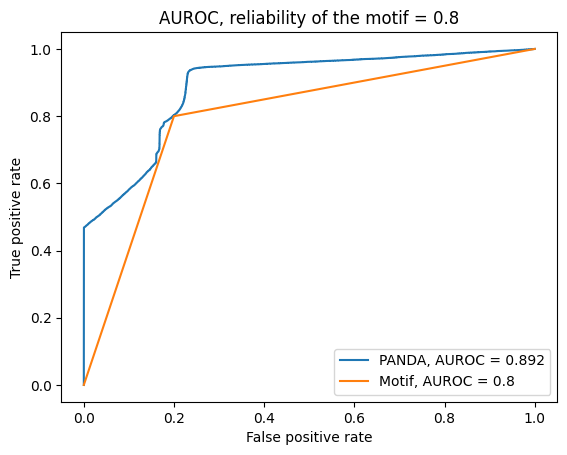

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5942287912444804
step: 1, hamming: 0.5821881422375207
step: 2, hamming: 0.7045948260735666
step: 3, hamming: 0.7741053311753894
step: 4, hamming: 0.8179775607982497
step: 5, hamming: 0.8420528026520627
step: 6, hamming: 0.8492512217724907
step: 7, hamming: 0.8422155707015114
step: 8, hamming: 0.8234851644354133
step: 9, hamming: 0.7953682725234564
step: 10, hamming: 0.7598833957218766
step: 11, hamming: 0.7187683589680404
step: 12, hamming: 0.6735264948923501
step: 13, hamming: 0.625482257344379
step: 14, hamming: 0.5758230455942339
step: 15, hamming: 0.525620181578353
step: 16, hamming: 0.47583352164349735
ste

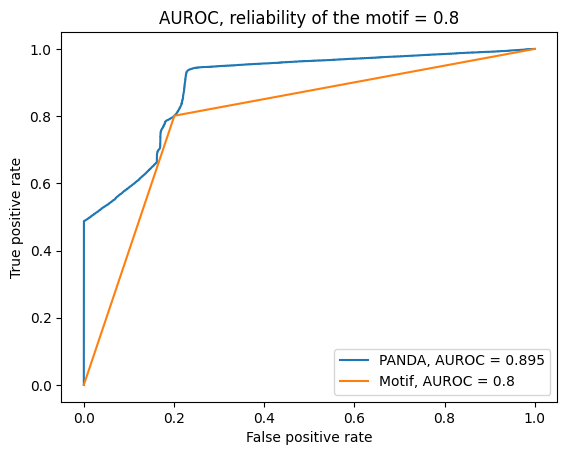

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 162
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5502458489676404
step: 1, hamming: 0.4813338575652256
step: 2, hamming: 0.588035410641336
step: 3, hamming: 0.6447802080211903
step: 4, hamming: 0.6782136504237819
step: 5, hamming: 0.6941320976880418
step: 6, hamming: 0.6951515104669732
step: 7, hamming: 0.6835927760251476
step: 8, hamming: 0.6618643235486956
step: 9, hamming: 0.6323122724929815
step: 10, hamming: 0.5970604927910494
step: 11, hamming: 0.5579480940051801
step: 12, hamming: 0.5165272671179415
step: 13, hamming: 0.47408389179919813
step: 14, hamming: 0.43166556266435746
step: 15, hamming: 0.39011024535310823
step: 16, hamming: 0.35007264143276406

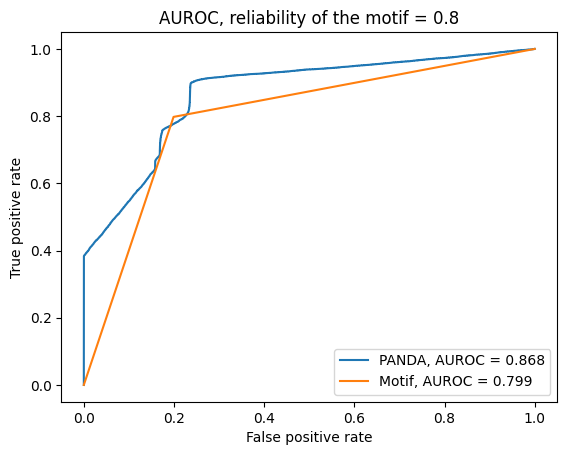

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 192
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5696988889984811
step: 1, hamming: 0.5363684278521479
step: 2, hamming: 0.6544460930619199
step: 3, hamming: 0.7210273406320449
step: 4, hamming: 0.7633032612626655
step: 5, hamming: 0.7871967661792044
step: 6, hamming: 0.795429998409913
step: 7, hamming: 0.7904454693566193
step: 8, hamming: 0.7746899148818038
step: 9, hamming: 0.7504284191215963
step: 10, hamming: 0.7196258141925882
step: 11, hamming: 0.6839342663726291
step: 12, hamming: 0.6447304145000018
step: 13, hamming: 0.6031652788523663
step: 14, hamming: 0.5602103860958351
step: 15, hamming: 0.5166938912332699
step: 16, hamming: 0.4733259865682536
ste

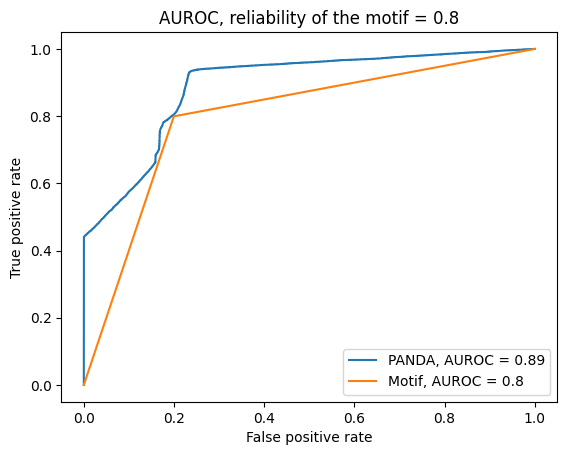

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 170
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5697570372199429
step: 1, hamming: 0.5469576732787214
step: 2, hamming: 0.6669995610622746
step: 3, hamming: 0.7345513507717918
step: 4, hamming: 0.7773843329604709
step: 5, hamming: 0.801453584142306
step: 6, hamming: 0.8095671171909045
step: 7, hamming: 0.8042638655250133
step: 8, hamming: 0.7880425101676511
step: 9, hamming: 0.7631951185260146
step: 10, hamming: 0.7317087027306816
step: 11, hamming: 0.6952549280791037
step: 12, hamming: 0.6552285959705987
step: 13, hamming: 0.6128008482663893
step: 14, hamming: 0.5689664625487141
step: 15, hamming: 0.5245781201572158
step: 16, hamming: 0.4803685539860869
ste

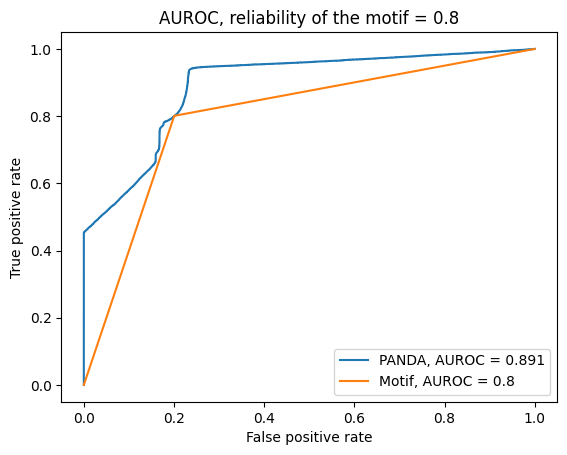

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 192
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5824848344995258
step: 1, hamming: 0.5624331272067461
step: 2, hamming: 0.6919565099923205
step: 3, hamming: 0.7662968904463427
step: 4, hamming: 0.8154549299473521
step: 5, hamming: 0.8457450503428107
step: 6, hamming: 0.8601390586185889
step: 7, hamming: 0.8612139545255992
step: 8, hamming: 0.8514023483923355
step: 9, hamming: 0.832849871903455
step: 10, hamming: 0.8073499595085455
step: 11, hamming: 0.7763707933274506
step: 12, hamming: 0.7411187959240029
step: 13, hamming: 0.7026025429264866
step: 14, hamming: 0.6616844333350248
step: 15, hamming: 0.6191190396316517
step: 16, hamming: 0.5755801823116118
ste

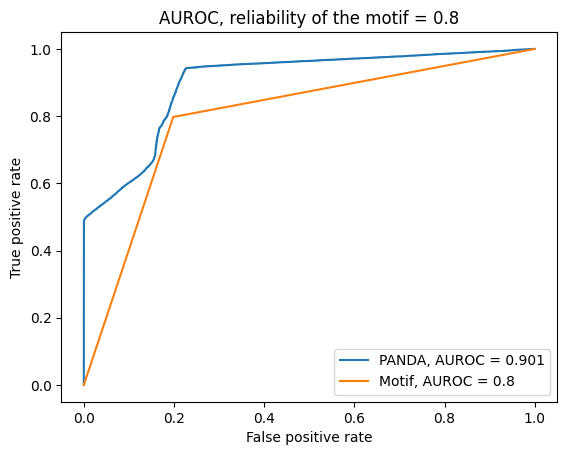

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 204
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5796600620984038
step: 1, hamming: 0.5641847612929005
step: 2, hamming: 0.6891791929035733
step: 3, hamming: 0.7612277715683853
step: 4, hamming: 0.8082521824058222
step: 5, hamming: 0.8361829756559556
step: 6, hamming: 0.8478713613684328
step: 7, hamming: 0.8458625712112557
step: 8, hamming: 0.8326211280115114
step: 9, hamming: 0.8103569216077369
step: 10, hamming: 0.7809546538287222
step: 11, hamming: 0.7460001747795131
step: 12, hamming: 0.706835632248124
step: 13, hamming: 0.664612643883186
step: 14, hamming: 0.6203354257625419
step: 15, hamming: 0.5748917341923528
step: 16, hamming: 0.5290719969035533
step

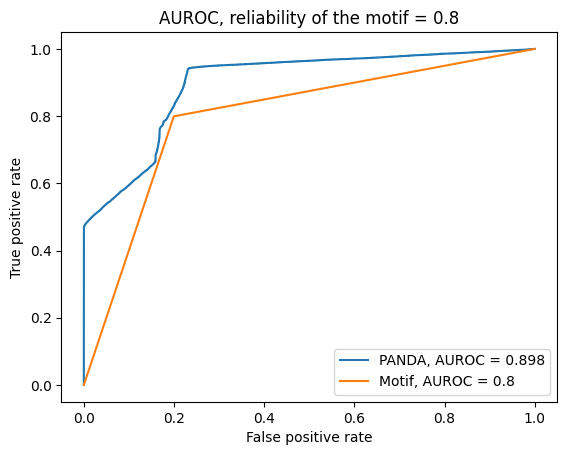

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 176
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5758161324529517
step: 1, hamming: 0.5643697188927401
step: 2, hamming: 0.6862770609732249
step: 3, hamming: 0.7550400865242839
step: 4, hamming: 0.7984181156785621
step: 5, hamming: 0.8223492655443577
step: 6, hamming: 0.8296496927357259
step: 7, hamming: 0.822892710777364
step: 8, hamming: 0.8046446949197158
step: 9, hamming: 0.7772847673441076
step: 10, hamming: 0.7429040063939574
step: 11, hamming: 0.703304496501381
step: 12, hamming: 0.6600348734824248
step: 13, hamming: 0.614426497347412
step: 14, hamming: 0.5676203323500055
step: 15, hamming: 0.52058569127897
step: 16, hamming: 0.4741346899073332
step: 1

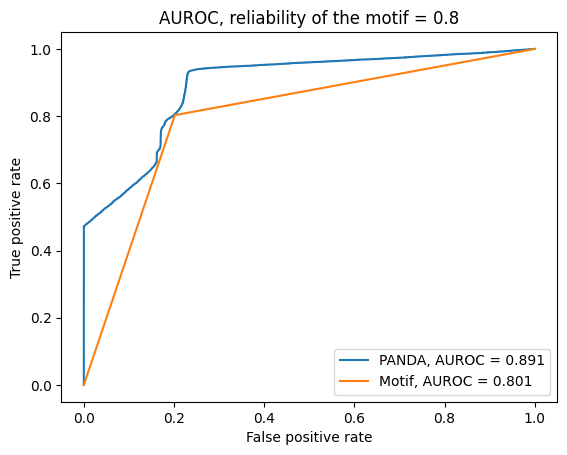

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 180
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5801645337287678
step: 1, hamming: 0.5541739004907449
step: 2, hamming: 0.6751257190445364
step: 3, hamming: 0.7432679085895307
step: 4, hamming: 0.78660202197491
step: 5, hamming: 0.8112245156248645
step: 6, hamming: 0.8199802648305278
step: 7, hamming: 0.8153901299673526
step: 8, hamming: 0.7999572266993077
step: 9, hamming: 0.7759942826393145
step: 10, hamming: 0.7454882186437745
step: 11, hamming: 0.7100790414188594
step: 12, hamming: 0.6711070446221707
step: 13, hamming: 0.6296773921268004
step: 14, hamming: 0.5867168235638969
step: 15, hamming: 0.5430159348394331
step: 16, hamming: 0.4992581098686023
step

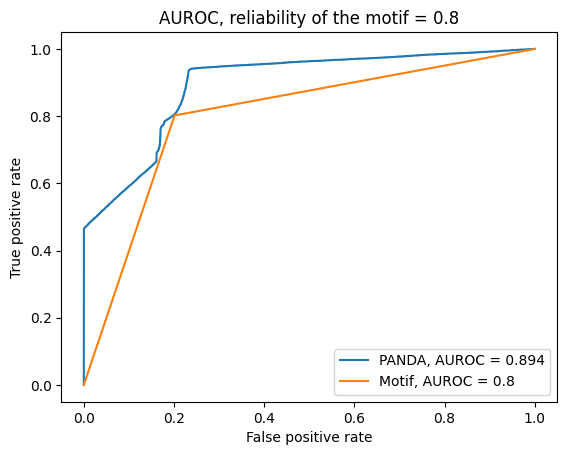

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 202
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.03 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5886117533429899
step: 1, hamming: 0.5922768363751629
step: 2, hamming: 0.7206473395754547
step: 3, hamming: 0.7956089196808674
step: 4, hamming: 0.8454429122052382
step: 5, hamming: 0.8762122677228039
step: 6, hamming: 0.8909436797311197
step: 7, hamming: 0.8923490395013769
step: 8, hamming: 0.8829760556679037
step: 9, hamming: 0.8650410236352302
step: 10, hamming: 0.8403553393099557
step: 11, hamming: 0.8103532315172974
step: 12, hamming: 0.7761681745137711
step: 13, hamming: 0.7387149988672929
step: 14, hamming: 0.6987577369765866
step: 15, hamming: 0.656959436414791
step: 16, hamming: 0.6139164194206513
ste

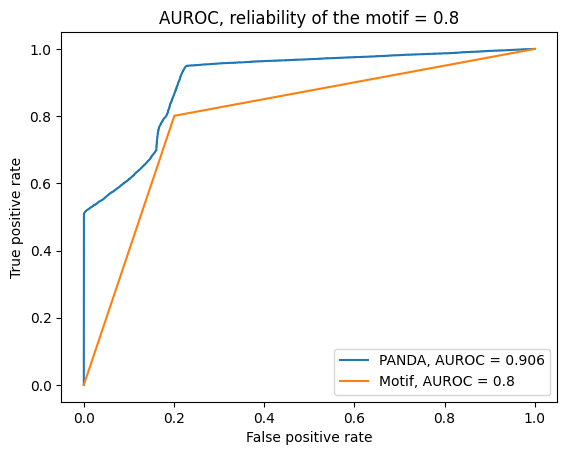

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 190
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5668562367491267
step: 1, hamming: 0.5412600541984812
step: 2, hamming: 0.6620278499831125
step: 3, hamming: 0.730095965364785
step: 4, hamming: 0.7734455385019298
step: 5, hamming: 0.7980893710928034
step: 6, hamming: 0.806824972850387
step: 7, hamming: 0.8021597873391091
step: 8, hamming: 0.7865733707305604
step: 9, hamming: 0.7623461298255944
step: 10, hamming: 0.7314534756334689
step: 11, hamming: 0.6955571869387569
step: 12, hamming: 0.6560448079098465
step: 13, hamming: 0.6140810017899175
step: 14, hamming: 0.5706530516744825
step: 15, hamming: 0.5266051617225851
step: 16, hamming: 0.4826623459694964
step

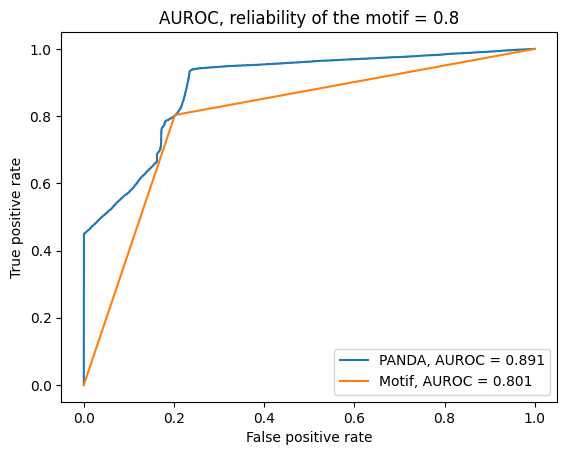

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 160
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5604338460598827
step: 1, hamming: 0.5181448183345865
step: 2, hamming: 0.631662158373384
step: 3, hamming: 0.6940269641128775
step: 4, hamming: 0.7324621479996837
step: 5, hamming: 0.752839919446298
step: 6, hamming: 0.7578020923823301
step: 7, hamming: 0.7496686518598487
step: 8, hamming: 0.7308288726626728
step: 9, hamming: 0.7035739017667465
step: 10, hamming: 0.6699301839372301
step: 11, hamming: 0.6316124189269856
step: 12, hamming: 0.5900580155994615
step: 13, hamming: 0.5464843122322462
step: 14, hamming: 0.5019373578399945
step: 15, hamming: 0.45732407454645935
step: 16, hamming: 0.4134291724493396
ste

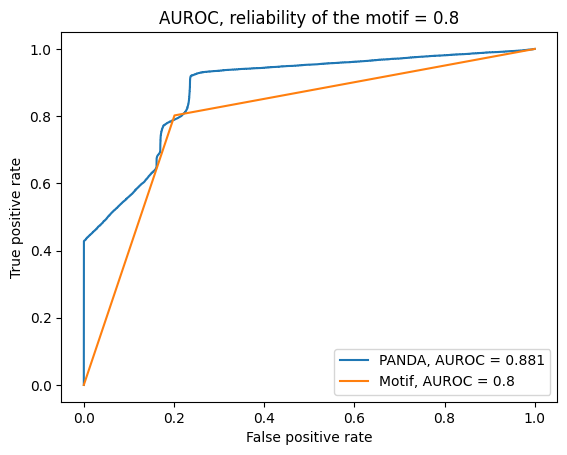

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 176
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.568788246866455
step: 1, hamming: 0.5480673967024468
step: 2, hamming: 0.6680392460653443
step: 3, hamming: 0.7356086247496635
step: 4, hamming: 0.7784706717862266
step: 5, hamming: 0.8025382213074994
step: 6, hamming: 0.8105367629094659
step: 7, hamming: 0.8049119744188865
step: 8, hamming: 0.7881087456943024
step: 9, hamming: 0.7623947041304306
step: 10, hamming: 0.729738494747484
step: 11, hamming: 0.6918073176462927
step: 12, hamming: 0.6500214266411977
step: 13, hamming: 0.6056138457687591
step: 14, hamming: 0.5596730702179815
step: 15, hamming: 0.513166707441326
step: 16, hamming: 0.46694988398356047
step

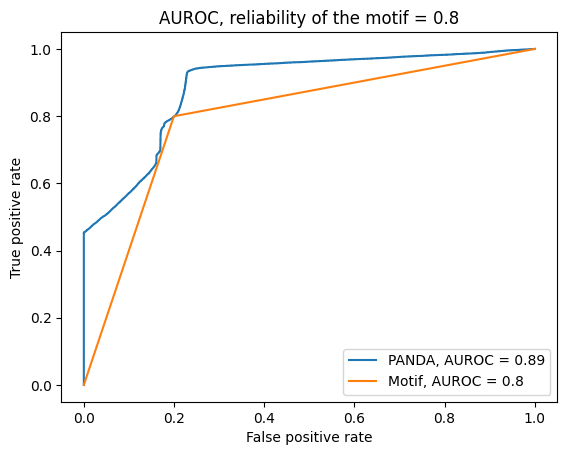

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 176
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5583683527099109
step: 1, hamming: 0.5172514010661198
step: 2, hamming: 0.6342035000162846
step: 3, hamming: 0.6990358524023047
step: 4, hamming: 0.7394600205103173
step: 5, hamming: 0.7616001484765318
step: 6, hamming: 0.7682463800780026
step: 7, hamming: 0.7617833755013199
step: 8, hamming: 0.7446034190981148
step: 9, hamming: 0.7189892746890567
step: 10, hamming: 0.6869729853247535
step: 11, hamming: 0.6502828531066583
step: 12, hamming: 0.6103591665565757
step: 13, hamming: 0.5683981727462586
step: 14, hamming: 0.5253982464461536
step: 15, hamming: 0.4821975404710318
step: 16, hamming: 0.439501023517324
ste

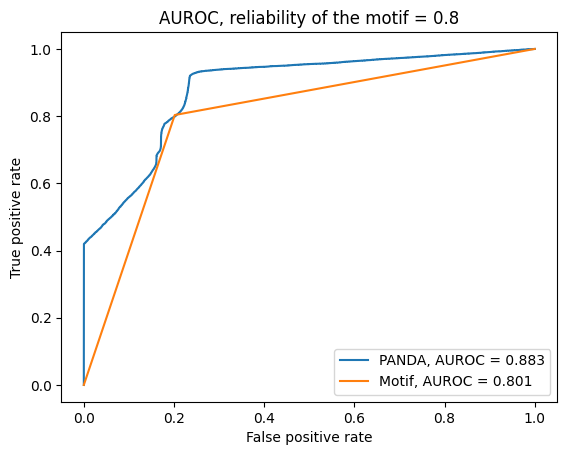

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 212
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5912639752428912
step: 1, hamming: 0.6216736054452666
step: 2, hamming: 0.758141672244638
step: 3, hamming: 0.8402515302076273
step: 4, hamming: 0.8970500852066794
step: 5, hamming: 0.9347161936901768
step: 6, hamming: 0.9564247914438198
step: 7, hamming: 0.9649626474905352
step: 8, hamming: 0.9627894466675454
step: 9, hamming: 0.9518902076675577
step: 10, hamming: 0.9338008533899042
step: 11, hamming: 0.9097177514767685
step: 12, hamming: 0.8806066751529917
step: 13, hamming: 0.8472847062359561
step: 14, hamming: 0.8104742643224684
step: 15, hamming: 0.7708346443870804
step: 16, hamming: 0.7289777829946176
ste

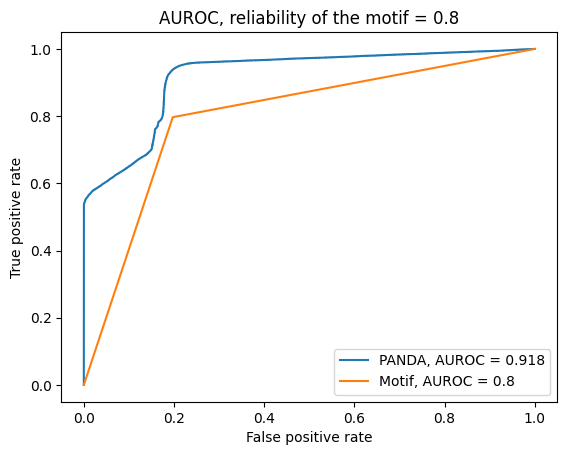

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 172
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5884249100213169
step: 1, hamming: 0.5799304173429871
step: 2, hamming: 0.708494419156941
step: 3, hamming: 0.7832607692980337
step: 4, hamming: 0.8328757293441185
step: 5, hamming: 0.8633658640039656
step: 6, hamming: 0.8775935172222404
step: 7, hamming: 0.8780251546487273
step: 8, hamming: 0.8669687168416738
step: 9, hamming: 0.8464433828206578
step: 10, hamming: 0.8181249421960184
step: 11, hamming: 0.7833963560477049
step: 12, hamming: 0.7434414580346588
step: 13, hamming: 0.6993322935877573
step: 14, hamming: 0.6520899355404991
step: 15, hamming: 0.6027165759018354
step: 16, hamming: 0.5522026422707345
ste

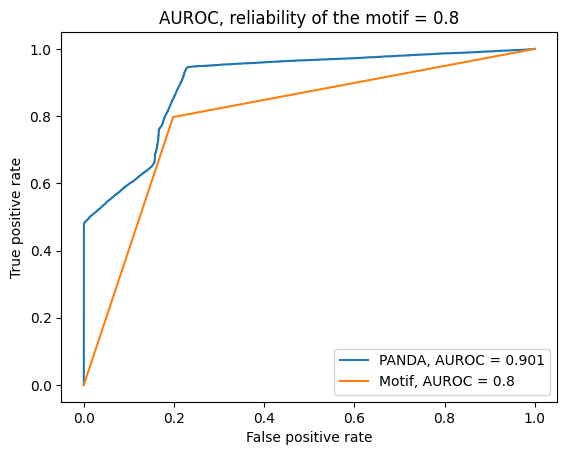

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.564735635207844
step: 1, hamming: 0.5275154242197704
step: 2, hamming: 0.6406251811307143
step: 3, hamming: 0.7031225725704385
step: 4, hamming: 0.7411777152005873
step: 5, hamming: 0.7606110279089598
step: 6, hamming: 0.7641852305637322
step: 7, hamming: 0.7543414701233352
step: 8, hamming: 0.7335329663437157
step: 9, hamming: 0.7041012512857618
step: 10, hamming: 0.668159168946888
step: 11, hamming: 0.6275508761371427
step: 12, hamming: 0.5838584873795479
step: 13, hamming: 0.5384294915317712
step: 14, hamming: 0.49240645557735757
step: 15, hamming: 0.44675106046136
step: 16, hamming: 0.40226028571965966
step

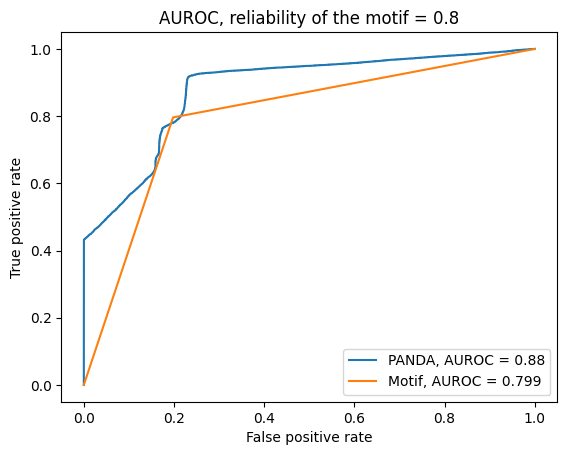

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 188
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5682150418793182
step: 1, hamming: 0.545928042994732
step: 2, hamming: 0.6651728829018768
step: 3, hamming: 0.7327219393986873
step: 4, hamming: 0.7758962581293106
step: 5, hamming: 0.8005181011972538
step: 6, hamming: 0.8093063765423812
step: 7, hamming: 0.8047110747002125
step: 8, hamming: 0.7891863416674119
step: 9, hamming: 0.7650029081090247
step: 10, hamming: 0.7341269904129932
step: 11, hamming: 0.6982155094004848
step: 12, hamming: 0.6586601125262258
step: 13, hamming: 0.6166347464827368
step: 14, hamming: 0.5731359003572496
step: 15, hamming: 0.529014747087669
step: 16, hamming: 0.4850006931388212
step

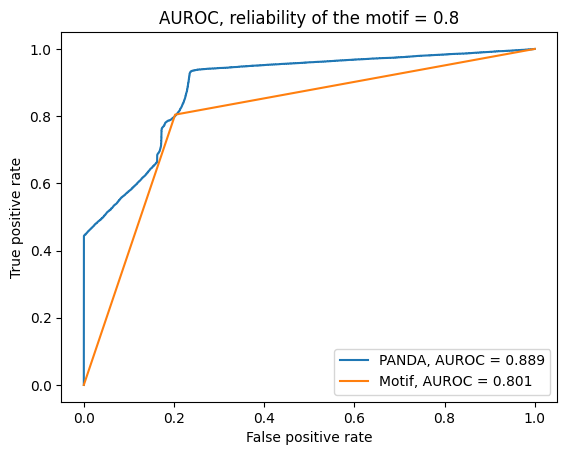

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 186
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5878716180742394
step: 1, hamming: 0.5669031201016821
step: 2, hamming: 0.6919451287449452
step: 3, hamming: 0.7636633675370645
step: 4, hamming: 0.8104791509700691
step: 5, hamming: 0.8383811414103662
step: 6, hamming: 0.850170252109417
step: 7, hamming: 0.8483265789006418
step: 8, hamming: 0.8352442471404876
step: 9, hamming: 0.8130533561930162
step: 10, hamming: 0.7835292097548225
step: 11, hamming: 0.7481248471783339
step: 12, hamming: 0.7080586256331598
step: 13, hamming: 0.6644012929987689
step: 14, hamming: 0.6181403579437635
step: 15, hamming: 0.5702184652104504
step: 16, hamming: 0.5215479548852785
ste

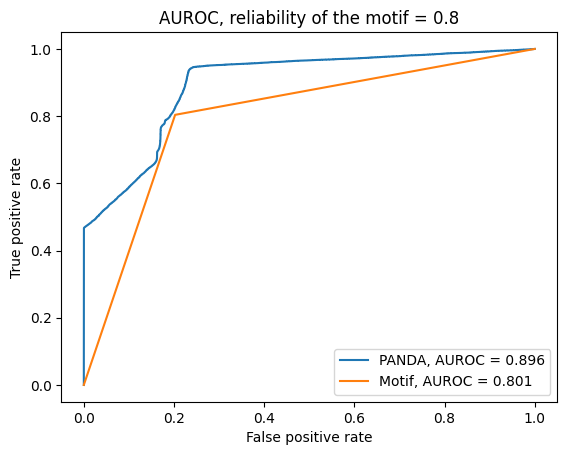

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5943769064107778
step: 1, hamming: 0.6145564139483018
step: 2, hamming: 0.7465739734941631
step: 3, hamming: 0.824519058000621
step: 4, hamming: 0.8770761141863429
step: 5, hamming: 0.910420289295584
step: 6, hamming: 0.9276809869933201
step: 7, hamming: 0.9316828537953206
step: 8, hamming: 0.925066457601675
step: 9, hamming: 0.9100808193767301
step: 10, hamming: 0.8885034965047622
step: 11, hamming: 0.861687819027113
step: 12, hamming: 0.8306613526653799
step: 13, hamming: 0.7962229265195473
step: 14, hamming: 0.759019225159176
step: 15, hamming: 0.7196003766407961
step: 16, hamming: 0.6784590547490934
step: 1

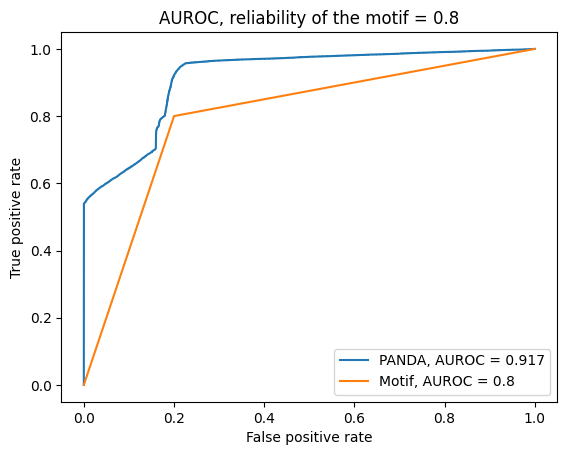

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 182
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5811629034151905
step: 1, hamming: 0.5516596764938552
step: 2, hamming: 0.6685219876456202
step: 3, hamming: 0.7339577309942255
step: 4, hamming: 0.7748463790218578
step: 5, hamming: 0.7971084761284215
step: 6, hamming: 0.8035985547426034
step: 7, hamming: 0.7968275588122299
step: 8, hamming: 0.7792736169315846
step: 9, hamming: 0.7532568730806339
step: 10, hamming: 0.7208176764116472
step: 11, hamming: 0.6836709894075138
step: 12, hamming: 0.6432267540626266
step: 13, hamming: 0.6006428035020344
step: 14, hamming: 0.5568807744732032
step: 15, hamming: 0.512750891148983
step: 16, hamming: 0.46894287345849694
st

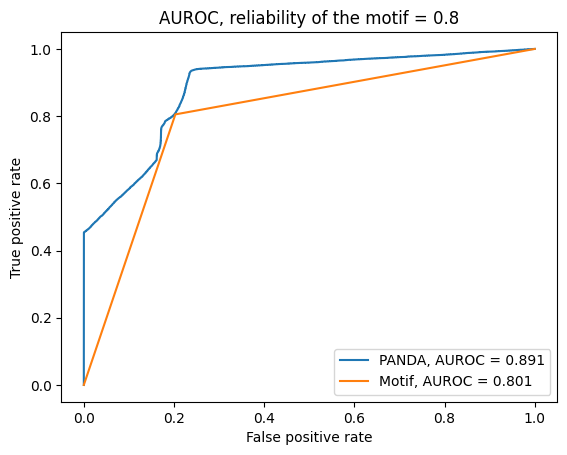

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 204
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5814792893082703
step: 1, hamming: 0.5604373897080246
step: 2, hamming: 0.6803291577065104
step: 3, hamming: 0.7476839655828806
step: 4, hamming: 0.7899386305320188
step: 5, hamming: 0.8130346603301742
step: 6, hamming: 0.819742081692861
step: 7, hamming: 0.8125821229694584
step: 8, hamming: 0.7940934298311059
step: 9, hamming: 0.7666332624049728
step: 10, hamming: 0.7322498142051515
step: 11, hamming: 0.6926756157889469
step: 12, hamming: 0.6493780452048319
step: 13, hamming: 0.6036170995215131
step: 14, hamming: 0.5564894058602743
step: 15, hamming: 0.5089568462937288
step: 16, hamming: 0.46186323436143395
st

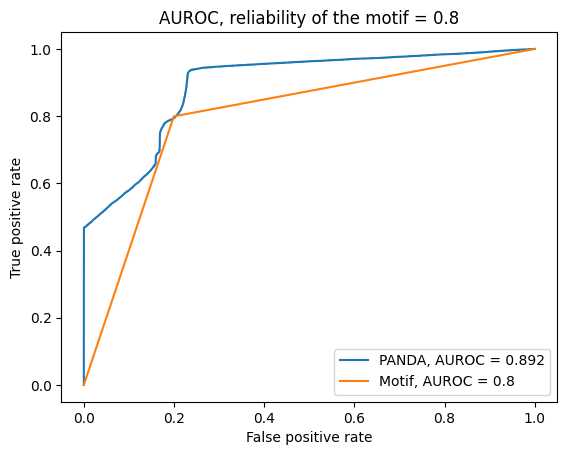

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 214
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5897127376364897
step: 1, hamming: 0.5707622347956379
step: 2, hamming: 0.69333887050078
step: 3, hamming: 0.7636758794828016
step: 4, hamming: 0.8093336906342538
step: 5, hamming: 0.8362193008539113
step: 6, hamming: 0.8471272706583135
step: 7, hamming: 0.8445912095617168
step: 8, hamming: 0.8311250216251796
step: 9, hamming: 0.8090075106539419
step: 10, hamming: 0.7801617270752533
step: 11, hamming: 0.7461618981516197
step: 12, hamming: 0.7082952162141141
step: 13, hamming: 0.6676298971657728
step: 14, hamming: 0.6250703281624471
step: 15, hamming: 0.581396381240709
step: 16, hamming: 0.5372901735942027
step:

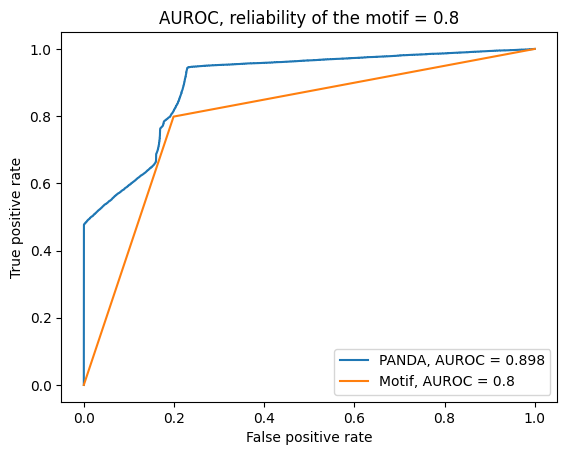

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5732129617852123
step: 1, hamming: 0.5339253932532134
step: 2, hamming: 0.6441702327662968
step: 3, hamming: 0.7037032327145606
step: 4, hamming: 0.7389311717122213
step: 5, hamming: 0.7556406038462888
step: 6, hamming: 0.7565850220343562
step: 7, hamming: 0.744270886432429
step: 8, hamming: 0.7212611486928253
step: 9, hamming: 0.6900211273497082
step: 10, hamming: 0.6527631119754151
step: 11, hamming: 0.6113823253049884
step: 12, hamming: 0.5674619633199122
step: 13, hamming: 0.5223108276394531
step: 14, hamming: 0.4770055272729322
step: 15, hamming: 0.4324236128307356
step: 16, hamming: 0.3892671876542908
ste

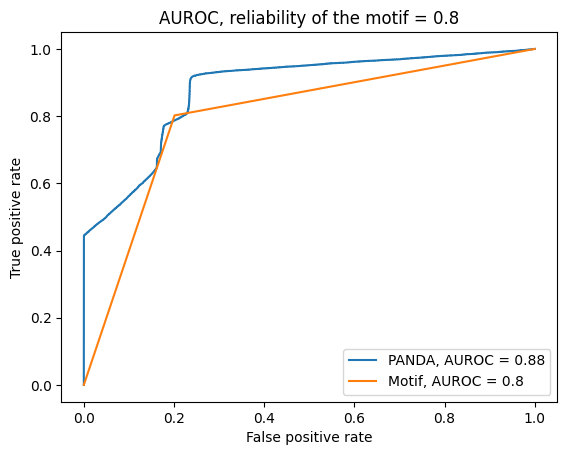

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 180
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5679694845336577
step: 1, hamming: 0.5251925934680541
step: 2, hamming: 0.6385656686990364
step: 3, hamming: 0.7007255433241618
step: 4, hamming: 0.7384782996735372
step: 5, hamming: 0.7576185519621633
step: 6, hamming: 0.7608434380231752
step: 7, hamming: 0.7505642596983907
step: 8, hamming: 0.7292404018405226
step: 9, hamming: 0.6992375363092118
step: 10, hamming: 0.6626827637912074
step: 11, hamming: 0.6214267918340565
step: 12, hamming: 0.5770659321845125
step: 13, hamming: 0.5309764911832475
step: 14, hamming: 0.48434060652392286
step: 15, hamming: 0.4381613994458248
step: 16, hamming: 0.39327197478651926


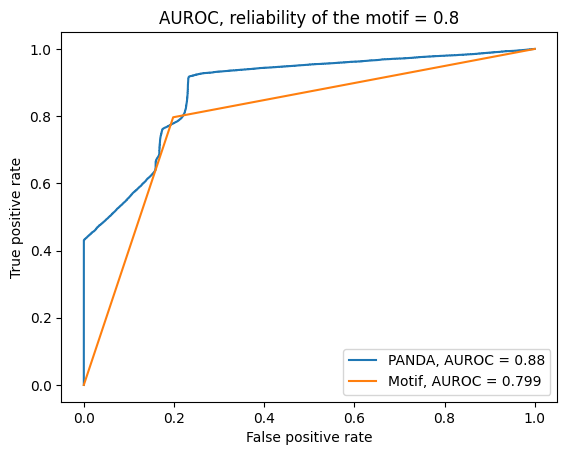

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 218
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6014247226477709
step: 1, hamming: 0.6397517842742725
step: 2, hamming: 0.7797004417939888
step: 3, hamming: 0.8640254079273603
step: 4, hamming: 0.9221383162826641
step: 5, hamming: 0.9603464214231426
step: 6, hamming: 0.9819777085305466
step: 7, hamming: 0.9898376919748282
step: 8, hamming: 0.9863122331022771
step: 9, hamming: 0.9733254045294989
step: 10, hamming: 0.952399280232269
step: 11, hamming: 0.9247595781992793
step: 12, hamming: 0.8914333972717485
step: 13, hamming: 0.8533245484053732
step: 14, hamming: 0.8112681101421768
step: 15, hamming: 0.7660685070919832
step: 16, hamming: 0.7185216607246304
ste

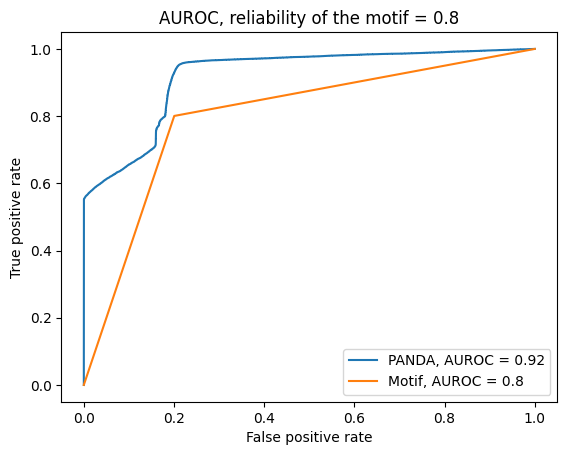

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 158
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5717706546301238
step: 1, hamming: 0.5413937523978882
step: 2, hamming: 0.6616081940058393
step: 3, hamming: 0.729949349077843
step: 4, hamming: 0.7739498311121908
step: 5, hamming: 0.7995506783810595
step: 6, hamming: 0.8094969467042848
step: 7, hamming: 0.8062032108676698
step: 8, hamming: 0.792071084692239
step: 9, hamming: 0.7693301265343833
step: 10, hamming: 0.7399116689928368
step: 11, hamming: 0.7054287066426117
step: 12, hamming: 0.6672179545668664
step: 13, hamming: 0.6263969105348864
step: 14, hamming: 0.5839132264747502
step: 15, hamming: 0.540581417654156
step: 16, hamming: 0.49710831411350953
step

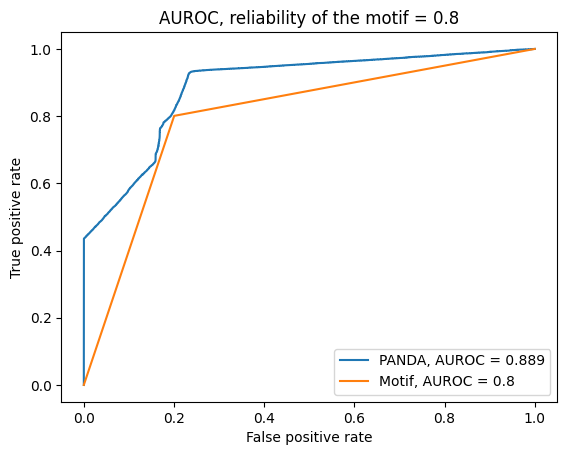

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5680701429429666
step: 1, hamming: 0.5306273020268589
step: 2, hamming: 0.6526006606383401
step: 3, hamming: 0.7219130013754073
step: 4, hamming: 0.7669377254943414
step: 5, hamming: 0.7937643027054702
step: 6, hamming: 0.8051454630165331
step: 7, hamming: 0.8034608224874449
step: 8, hamming: 0.7910669051645682
step: 9, hamming: 0.7701408419021604
step: 10, hamming: 0.7425566902869679
step: 11, hamming: 0.7098696560998992
step: 12, hamming: 0.673360104130545
step: 13, hamming: 0.6340926707975032
step: 14, hamming: 0.5929691061683147
step: 15, hamming: 0.5507683583403312
step: 16, hamming: 0.508173966114572
step

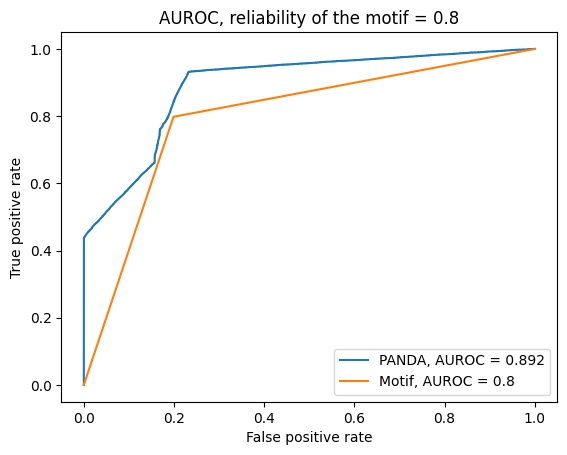

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 180
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5607575145552897
step: 1, hamming: 0.5000313965509194
step: 2, hamming: 0.6128494310259452
step: 3, hamming: 0.6747742204426802
step: 4, hamming: 0.7127443266989022
step: 5, hamming: 0.7326938664789747
step: 6, hamming: 0.7373196684356036
step: 7, hamming: 0.7289724911630974
step: 8, hamming: 0.7100425184332881
step: 9, hamming: 0.6828286429728794
step: 10, hamming: 0.6493983649500085
step: 11, hamming: 0.6115328286377743
step: 12, hamming: 0.5707358212166876
step: 13, hamming: 0.5282673561573151
step: 14, hamming: 0.4851779163766305
step: 15, hamming: 0.4423364152519533
step: 16, hamming: 0.4004523943748006
st

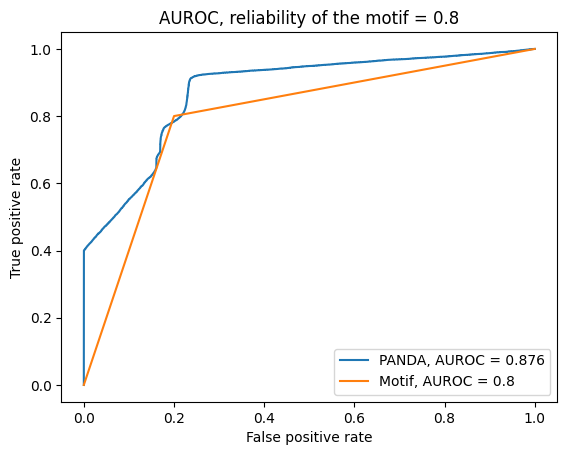

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 206
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5848798932382933
step: 1, hamming: 0.5740687061641659
step: 2, hamming: 0.6968437113640112
step: 3, hamming: 0.7664860380118773
step: 4, hamming: 0.8108967249491275
step: 5, hamming: 0.8360623947741284
step: 6, hamming: 0.8448444558237951
step: 7, hamming: 0.8398882822931637
step: 8, hamming: 0.8238160644928523
step: 9, hamming: 0.7989891515009377
step: 10, hamming: 0.7674018255679409
step: 11, hamming: 0.7307072615893481
step: 12, hamming: 0.6902822705622724
step: 13, hamming: 0.6472852307104612
step: 14, hamming: 0.6026997740284047
step: 15, hamming: 0.5573678747250757
step: 16, hamming: 0.5120150085826277
st

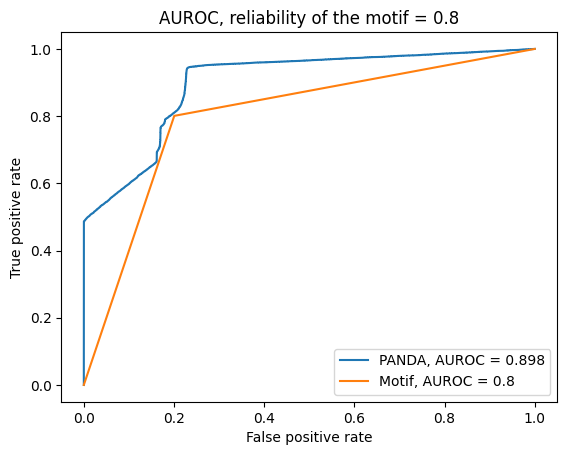

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5821632001219067
step: 1, hamming: 0.598718412295514
step: 2, hamming: 0.730027581420701
step: 3, hamming: 0.8077385415615599
step: 4, hamming: 0.8603323647542632
step: 5, hamming: 0.8938046922250078
step: 6, hamming: 0.9110785768764798
step: 7, hamming: 0.9147541546367016
step: 8, hamming: 0.9072583880332962
step: 9, hamming: 0.8906536453989898
step: 10, hamming: 0.8665978574210226
step: 11, hamming: 0.8364250475753925
step: 12, hamming: 0.8012513865118072
step: 13, hamming: 0.7620582243824288
step: 14, hamming: 0.7197433650332978
step: 15, hamming: 0.6751469406152425
step: 16, hamming: 0.6290605336941764
step

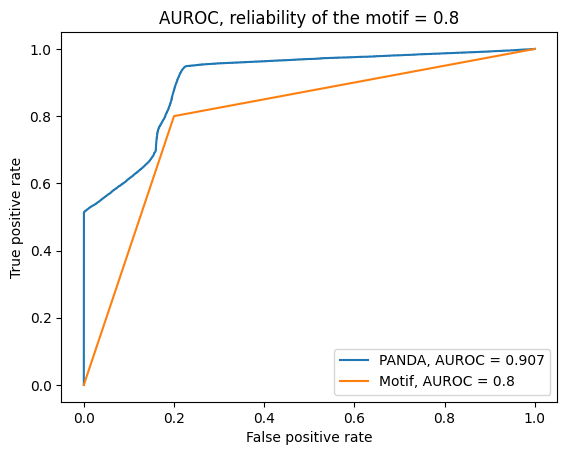

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 192
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5775446704499827
step: 1, hamming: 0.5601905712617274
step: 2, hamming: 0.6811301714177628
step: 3, hamming: 0.7495673704204772
step: 4, hamming: 0.7933915534498446
step: 5, hamming: 0.8185757633727153
step: 6, hamming: 0.8279042680626447
step: 7, hamming: 0.8239212174295109
step: 8, hamming: 0.8091683181440383
step: 9, hamming: 0.785953922487515
step: 10, hamming: 0.7562225808282863
step: 11, hamming: 0.721557329356578
step: 12, hamming: 0.6832429932207944
step: 13, hamming: 0.6423390884349222
step: 14, hamming: 0.5997401479229579
step: 15, hamming: 0.5562186949043859
step: 16, hamming: 0.5124530395440506
step

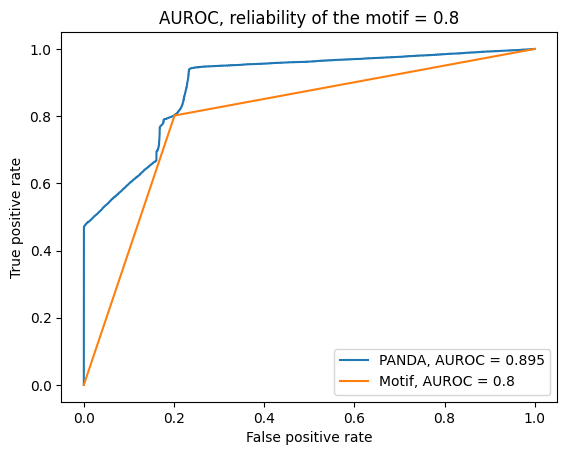

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 170
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5735060899064636
step: 1, hamming: 0.5240880859694056
step: 2, hamming: 0.6372402437718304
step: 3, hamming: 0.699380327704386
step: 4, hamming: 0.7370770045006679
step: 5, hamming: 0.756167384643842
step: 6, hamming: 0.7594605038457737
step: 7, hamming: 0.749472053214042
step: 8, hamming: 0.7287215815832736
step: 9, hamming: 0.6995919004842729
step: 10, hamming: 0.6642127932011727
step: 11, hamming: 0.6244234652086956
step: 12, hamming: 0.5817808514311276
step: 13, hamming: 0.5375871660866288
step: 14, hamming: 0.4929217531654462
step: 15, hamming: 0.44867032656335243
step: 16, hamming: 0.40554943294969753
ste

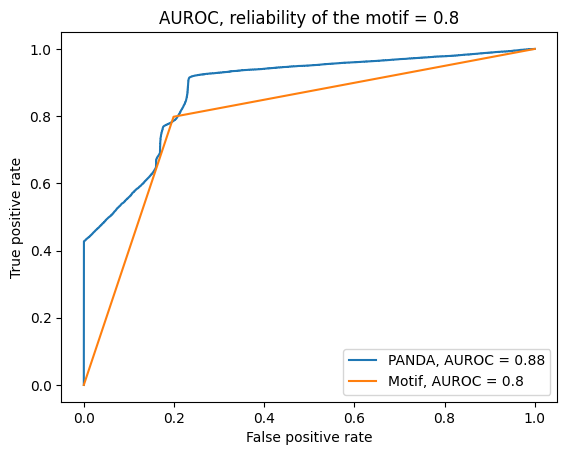

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 172
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5802175859795858
step: 1, hamming: 0.5602307614061887
step: 2, hamming: 0.6773205758085923
step: 3, hamming: 0.7427681943984075
step: 4, hamming: 0.7833797614849193
step: 5, hamming: 0.8049066027013292
step: 6, hamming: 0.8101044979966677
step: 7, hamming: 0.8015376362030859
step: 8, hamming: 0.7817948903373726
step: 9, hamming: 0.7532701105309535
step: 10, hamming: 0.7180423248315657
step: 11, hamming: 0.6778767766536423
step: 12, hamming: 0.6342713493173496
step: 13, hamming: 0.588505604425663
step: 14, hamming: 0.5416785619924892
step: 15, hamming: 0.49473560162964886
step: 16, hamming: 0.44848581434806867
s

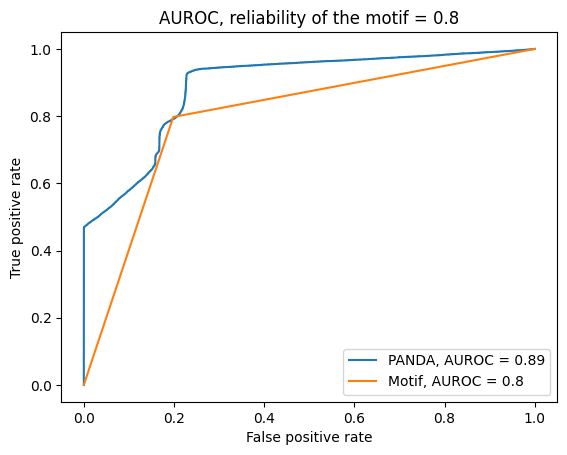

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 144
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5634044149377829
step: 1, hamming: 0.5037420638742492
step: 2, hamming: 0.6175285310587575
step: 3, hamming: 0.6802295141934281
step: 4, hamming: 0.7190156260398997
step: 5, hamming: 0.7397654129226134
step: 6, hamming: 0.7451538560883275
step: 7, hamming: 0.7375161523383447
step: 8, hamming: 0.7192100341558508
step: 9, hamming: 0.6924986667188152
step: 10, hamming: 0.6594214646419426
step: 11, hamming: 0.6217436319182961
step: 12, hamming: 0.5809635963028549
step: 13, hamming: 0.5383445338228569
step: 14, hamming: 0.49494844547350697
step: 15, hamming: 0.451664130253003
step: 16, hamming: 0.4092278278343445
st

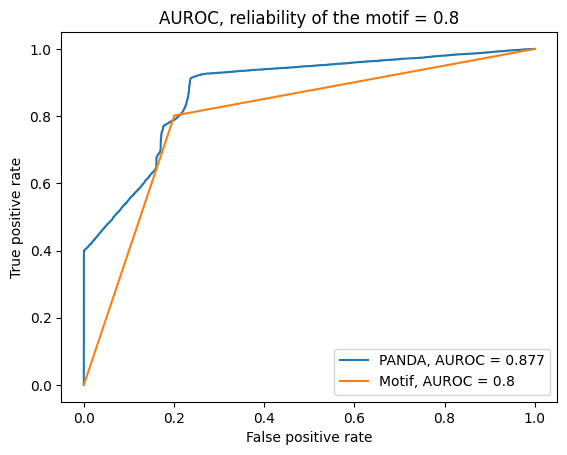

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 148
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.555069733584903
step: 1, hamming: 0.49996063397925217
step: 2, hamming: 0.6115264415423823
step: 3, hamming: 0.6717969058588243
step: 4, hamming: 0.7081327740386676
step: 5, hamming: 0.7266563870372155
step: 6, hamming: 0.7301145961692488
step: 7, hamming: 0.72084450796812
step: 8, hamming: 0.7012342976069038
step: 9, hamming: 0.6735957152365852
step: 10, hamming: 0.6400005754377709
step: 11, hamming: 0.6022155944141014
step: 12, hamming: 0.5617107972138529
step: 13, hamming: 0.5196980998003694
step: 14, hamming: 0.47717472706317415
step: 15, hamming: 0.43496035706811964
step: 16, hamming: 0.393724975867143
ste

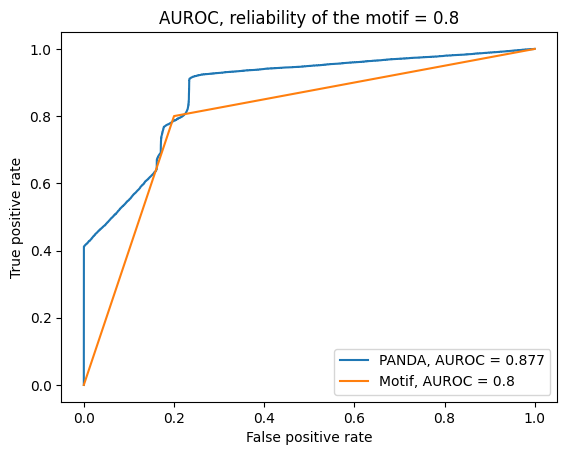

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 212
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5730478337306292
step: 1, hamming: 0.5491121539952997
step: 2, hamming: 0.6682727556069908
step: 3, hamming: 0.7350623773567196
step: 4, hamming: 0.7771724685287985
step: 5, hamming: 0.800577380923332
step: 6, hamming: 0.808025396835077
step: 7, hamming: 0.8020102094463744
step: 8, hamming: 0.7850520759551468
step: 9, hamming: 0.7594882863142277
step: 10, hamming: 0.7273314649215511
step: 11, hamming: 0.6902595256122951
step: 12, hamming: 0.6496704680845062
step: 13, hamming: 0.6067448842627516
step: 14, hamming: 0.5624929333278069
step: 15, hamming: 0.5177837237502327
step: 16, hamming: 0.4733626084567267
step

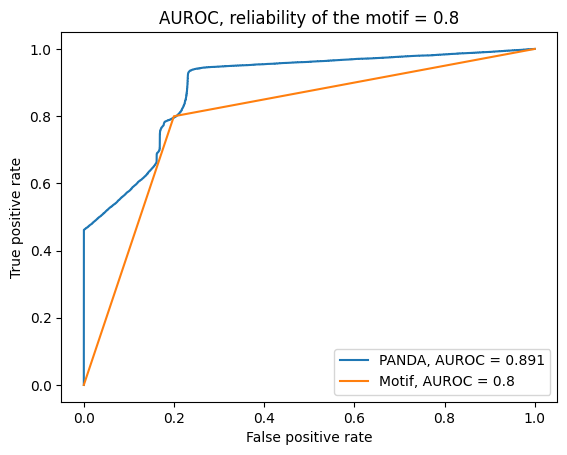

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 186
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5957265379489102
step: 1, hamming: 0.5893703570955806
step: 2, hamming: 0.7144067682344041
step: 3, hamming: 0.7864488842389654
step: 4, hamming: 0.8332257716589084
step: 5, hamming: 0.8606010257013086
step: 6, hamming: 0.8714458693341369
step: 7, hamming: 0.8683793089272854
step: 8, hamming: 0.8539460127138613
step: 9, hamming: 0.8304274018931792
step: 10, hamming: 0.799758667945529
step: 11, hamming: 0.7635609005938064
step: 12, hamming: 0.7232099354005493
step: 13, hamming: 0.6798930112439519
step: 14, hamming: 0.6346439607121979
step: 15, hamming: 0.5883645000014464
step: 16, hamming: 0.5418387399272795
ste

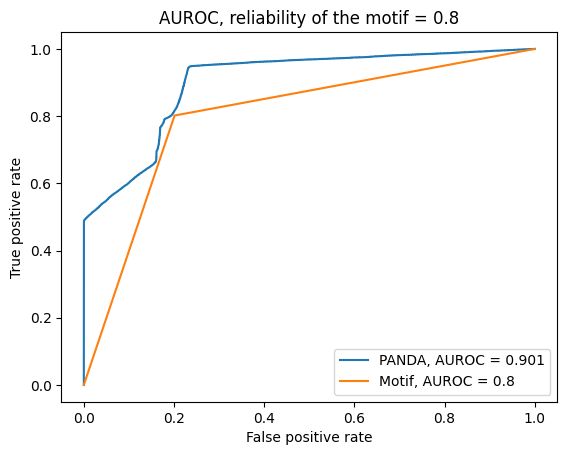

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 196
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.570624626860953
step: 1, hamming: 0.5454469966282933
step: 2, hamming: 0.6651309631041622
step: 3, hamming: 0.7319898957738732
step: 4, hamming: 0.7740151730287783
step: 5, hamming: 0.7971519190856164
step: 6, hamming: 0.8042180472444614
step: 7, hamming: 0.7977379998519748
step: 8, hamming: 0.7802304343235262
step: 9, hamming: 0.7540254661552578
step: 10, hamming: 0.7211508925513123
step: 11, hamming: 0.6833288050756848
step: 12, hamming: 0.6420167585240186
step: 13, hamming: 0.5984506616319804
step: 14, hamming: 0.553679986925073
step: 15, hamming: 0.5085960293861868
step: 16, hamming: 0.4639534825687886
step

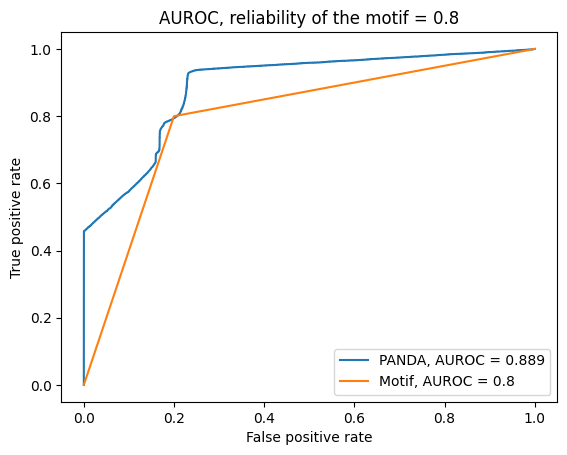

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 192
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5705406915395844
step: 1, hamming: 0.5597972473753946
step: 2, hamming: 0.6823711900966088
step: 3, hamming: 0.7523424758510832
step: 4, hamming: 0.7974231583283102
step: 5, hamming: 0.8235665248363988
step: 6, hamming: 0.8336353913714197
step: 7, hamming: 0.830232793307632
step: 8, hamming: 0.8158949057846442
step: 9, hamming: 0.7928963942274851
step: 10, hamming: 0.7631751061639578
step: 11, hamming: 0.7283532242570473
step: 12, hamming: 0.6897797444725482
step: 13, hamming: 0.6485751625860041
step: 14, hamming: 0.605676629254704
step: 15, hamming: 0.5618787600042597
step: 16, hamming: 0.5178656889522237
step

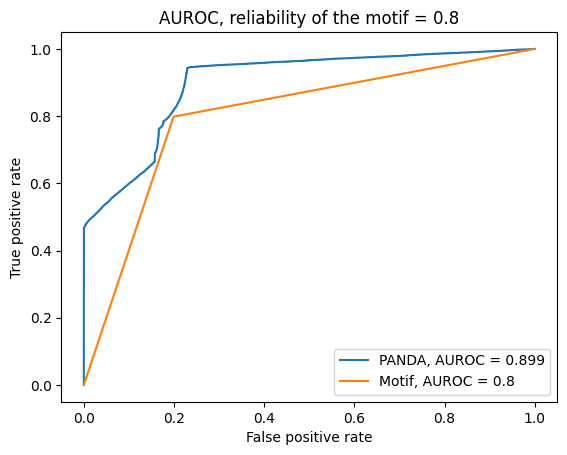

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 182
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5721049811434376
step: 1, hamming: 0.5303882137220097
step: 2, hamming: 0.6497910192568195
step: 3, hamming: 0.7167233312087676
step: 4, hamming: 0.7591625543351626
step: 5, hamming: 0.7831277594945363
step: 6, hamming: 0.7913872507542474
step: 7, hamming: 0.7863801116437322
step: 8, hamming: 0.77053772472763
step: 9, hamming: 0.7461261458388132
step: 10, hamming: 0.7151240838084537
step: 11, hamming: 0.6792030821278988
step: 12, hamming: 0.6397626072030425
step: 13, hamming: 0.5979779110027177
step: 14, hamming: 0.5548426596828606
step: 15, hamming: 0.5112021603768323
step: 16, hamming: 0.467777581324621
step:

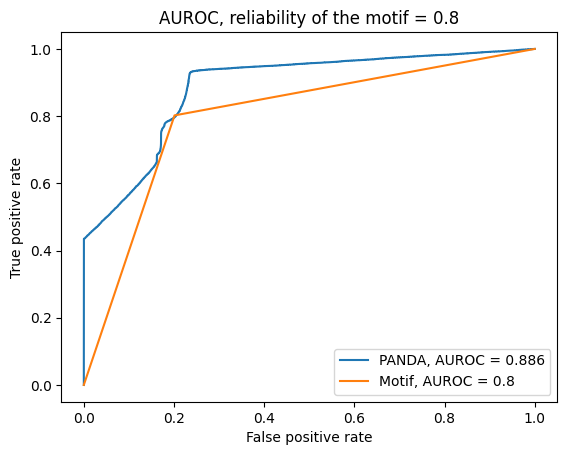

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 168
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5675348253173335
step: 1, hamming: 0.5254137431643122
step: 2, hamming: 0.6439798747700113
step: 3, hamming: 0.710087717118821
step: 4, hamming: 0.7517828071967119
step: 5, hamming: 0.7751555927569946
step: 6, hamming: 0.7829977838762701
step: 7, hamming: 0.777722224463443
step: 8, hamming: 0.7617314159198775
step: 9, hamming: 0.7372849211115727
step: 10, hamming: 0.7063664300431133
step: 11, hamming: 0.670645027652879
step: 12, hamming: 0.6315038063106597
step: 13, hamming: 0.590092761326361
step: 14, hamming: 0.5473793830483764
step: 15, hamming: 0.504187249046312
step: 16, hamming: 0.4612220242158202
step: 1

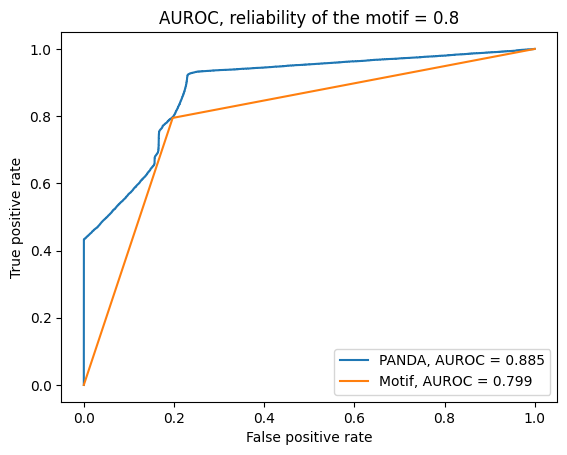

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 216
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5804475956738309
step: 1, hamming: 0.5656321764710339
step: 2, hamming: 0.6853624589796653
step: 3, hamming: 0.7528861799360274
step: 4, hamming: 0.7951959872066615
step: 5, hamming: 0.8182895976045542
step: 6, hamming: 0.8250659653292939
step: 7, hamming: 0.8181546162400505
step: 8, hamming: 0.800165655717379
step: 9, hamming: 0.7734934853602924
step: 10, hamming: 0.7402014430817048
step: 11, hamming: 0.7020244668896429
step: 12, hamming: 0.6604120018383723
step: 13, hamming: 0.6165731475720188
step: 14, hamming: 0.5715189713434942
step: 15, hamming: 0.526099951956062
step: 16, hamming: 0.4810354400155989
step

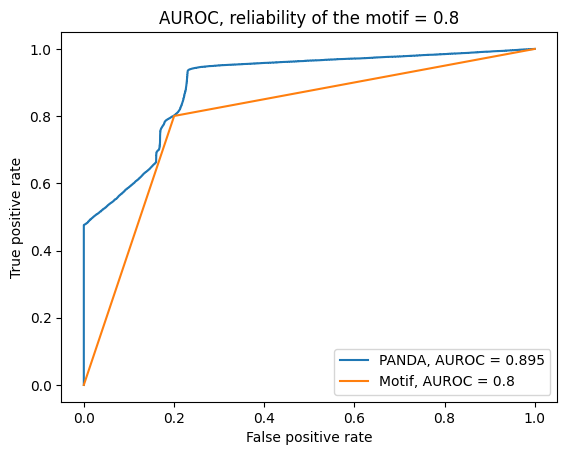

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 202
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5992020409121308
step: 1, hamming: 0.616527171178647
step: 2, hamming: 0.7453809516028181
step: 3, hamming: 0.8209648746702918
step: 4, hamming: 0.8707627535414921
step: 5, hamming: 0.9006119551405523
step: 6, hamming: 0.913428187060744
step: 7, hamming: 0.9118310738132194
step: 8, hamming: 0.8982449158100421
step: 9, hamming: 0.8747481808369652
step: 10, hamming: 0.8430684803488324
step: 11, hamming: 0.8046580180113735
step: 12, hamming: 0.7607853559274579
step: 13, hamming: 0.7126229000064119
step: 14, hamming: 0.6613121400454808
step: 15, hamming: 0.6079949191638993
step: 16, hamming: 0.5538103715517401
step

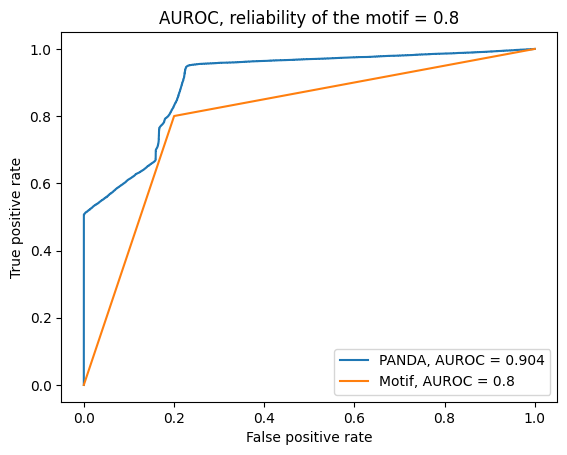

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 156
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5634378272030612
step: 1, hamming: 0.5063859274056864
step: 2, hamming: 0.618324146329351
step: 3, hamming: 0.6792606751872134
step: 4, hamming: 0.7159223664642428
step: 5, hamming: 0.7341981370481983
step: 6, hamming: 0.7368145586771002
step: 7, hamming: 0.7261007860521764
step: 8, hamming: 0.7043977082739244
step: 9, hamming: 0.6739942910894016
step: 10, hamming: 0.637011899636419
step: 11, hamming: 0.5953410552681434
step: 12, hamming: 0.5506366831012408
step: 13, hamming: 0.5043363596583315
step: 14, hamming: 0.45768103009611727
step: 15, hamming: 0.4117245041944167
step: 16, hamming: 0.36733594285543786
st

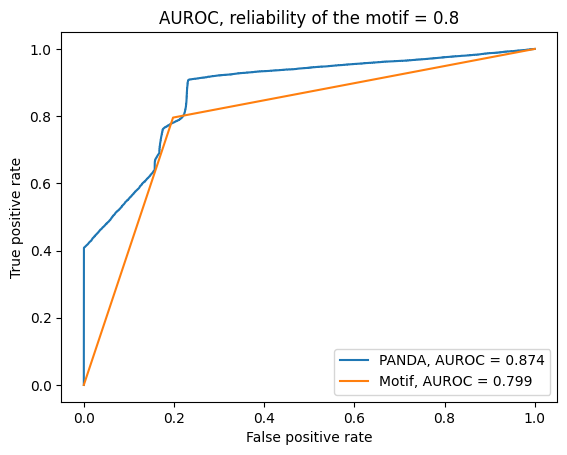

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 172
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.56882718842265
step: 1, hamming: 0.5142457722812033
step: 2, hamming: 0.6257944398552905
step: 3, hamming: 0.6866267616856029
step: 4, hamming: 0.7233185095785769
step: 5, hamming: 0.7417671951928532
step: 6, hamming: 0.744672895629787
step: 7, hamming: 0.7344044040028446
step: 8, hamming: 0.7133941843933409
step: 9, hamming: 0.6839998206942426
step: 10, hamming: 0.6483474064326021
step: 11, hamming: 0.6082737342451366
step: 12, hamming: 0.5653345914416502
step: 13, hamming: 0.5208392099860637
step: 14, hamming: 0.47588682689951867
step: 15, hamming: 0.43139530638175244
step: 16, hamming: 0.3881206336642217
ste

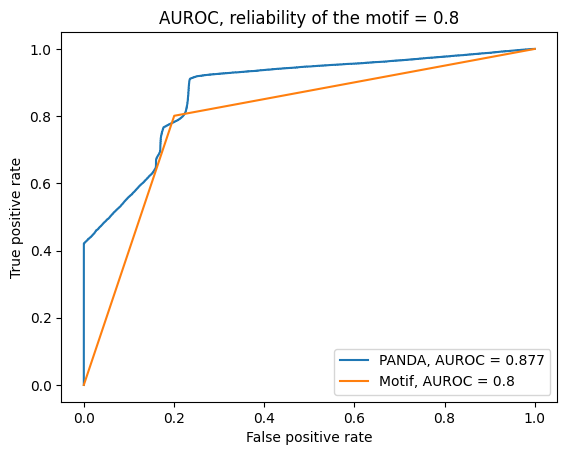

0.3
Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 162
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.580608577066816
step: 1, hamming: 0.5435612962505115
step: 2, hamming: 0.6681386317125189
step: 3, hamming: 0.7389756776156547
step: 4, hamming: 0.7847417182198357
step: 5, hamming: 0.8115588333424344
step: 6, hamming: 0.8222283193023261
step: 7, hamming: 0.8192052093298307
step: 8, hamming: 0.8049306107716484
step: 9, hamming: 0.781676384546465
step: 10, hamming: 0.7514230184679591
step: 11, hamming: 0.7158406714328295
step: 12, hamming: 0.6763283984638556
step: 13, hamming: 0.6340691861392744
step: 14, hamming: 0.5900785760324628
step: 15, hamming: 0.5452396321035843
step: 16, hamming: 0.50032448879506
st

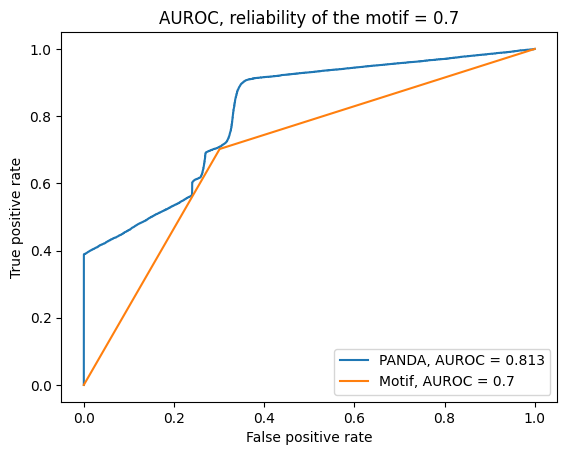

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 178
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5999357438971826
step: 1, hamming: 0.5732715694006841
step: 2, hamming: 0.7050753057577688
step: 3, hamming: 0.7823672731391813
step: 4, hamming: 0.8341931481934363
step: 5, hamming: 0.8668331078400822
step: 6, hamming: 0.8833144787746542
step: 7, hamming: 0.8862646733306713
step: 8, hamming: 0.8781444452966685
step: 9, hamming: 0.8611354276951796
step: 10, hamming: 0.837086037735148
step: 11, hamming: 0.8075204281234806
step: 12, hamming: 0.7736779701828493
step: 13, hamming: 0.7365654262085404
step: 14, hamming: 0.6970104988744146
step: 15, hamming: 0.6557091905790166
step: 16, hamming: 0.6132636882010163
ste

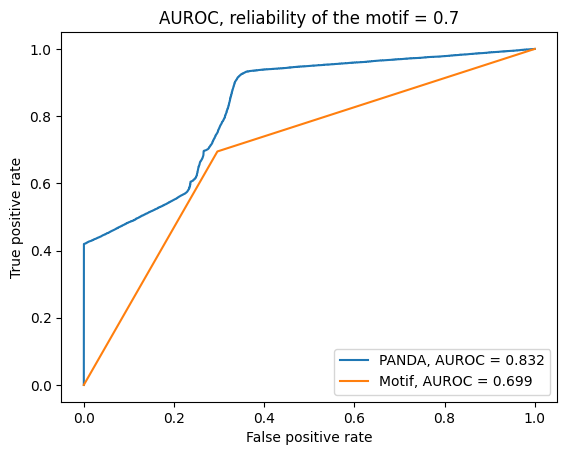

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 208
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5899830717682866
step: 1, hamming: 0.5520739952511388
step: 2, hamming: 0.6778182773582556
step: 3, hamming: 0.7500954549161944
step: 4, hamming: 0.7975125031935464
step: 5, hamming: 0.8261206702189012
step: 6, hamming: 0.8386690594468934
step: 7, hamming: 0.8376072092239204
step: 8, hamming: 0.8253457509894242
step: 9, hamming: 0.8040615173140856
step: 10, hamming: 0.7755938276219158
step: 11, hamming: 0.741461353399212
step: 12, hamming: 0.7029314398471086
step: 13, hamming: 0.6610890497397077
step: 14, hamming: 0.6168937367080249
step: 15, hamming: 0.5712186879407445
step: 16, hamming: 0.5248745174712167
ste

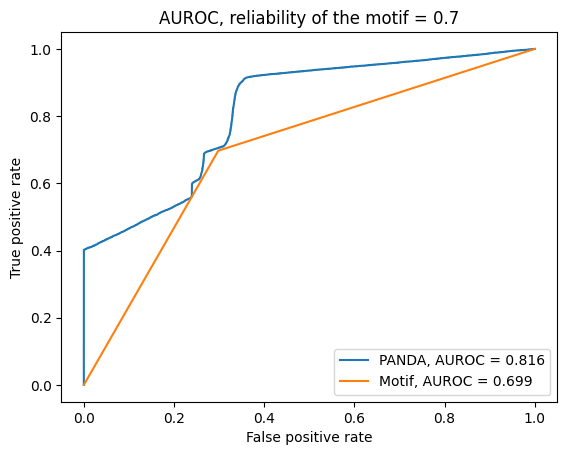

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 202
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5814441522208764
step: 1, hamming: 0.5566378368677939
step: 2, hamming: 0.6826357377087836
step: 3, hamming: 0.755008833148814
step: 4, hamming: 0.8023246308823954
step: 5, hamming: 0.8306926960606821
step: 6, hamming: 0.8429895866424679
step: 7, hamming: 0.8417683313942778
step: 8, hamming: 0.8295283824703592
step: 9, hamming: 0.8085503449720352
step: 10, hamming: 0.7807804594138853
step: 11, hamming: 0.7478210738726475
step: 12, hamming: 0.7109777729734502
step: 13, hamming: 0.6713206063317726
step: 14, hamming: 0.6297399084654304
step: 15, hamming: 0.5869908885068579
step: 16, hamming: 0.5437267392972733
ste

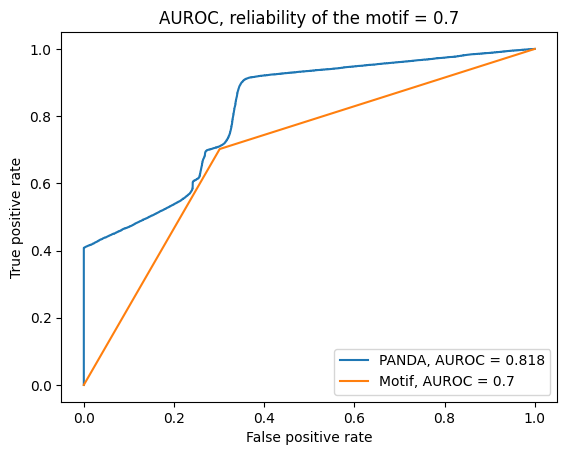

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 130
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5687101436682516
step: 1, hamming: 0.5055005296345522
step: 2, hamming: 0.6258401588986822
step: 3, hamming: 0.6934048474356675
step: 4, hamming: 0.7366832633946276
step: 5, hamming: 0.7617046917033032
step: 6, hamming: 0.7711289054459951
step: 7, hamming: 0.7672546874431369
step: 8, hamming: 0.7524141198740021
step: 9, hamming: 0.7288434533968468
step: 10, hamming: 0.6985467224123051
step: 11, hamming: 0.6632471262848096
step: 12, hamming: 0.62439843690007
step: 13, hamming: 0.5832199041639115
step: 14, hamming: 0.5407346946355667
step: 15, hamming: 0.4978036294017074
step: 16, hamming: 0.4551516386295334
step

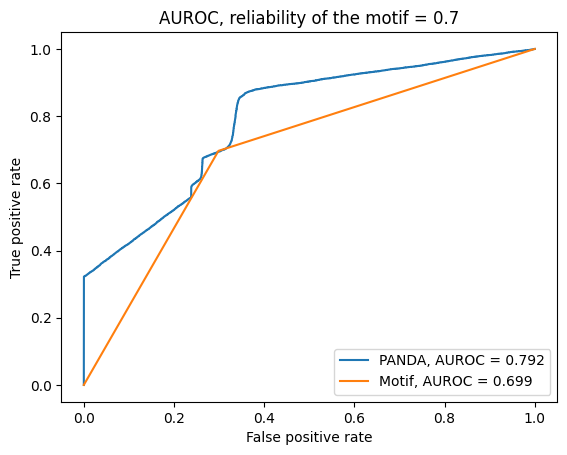

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 196
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5898966278793505
step: 1, hamming: 0.5699998902179318
step: 2, hamming: 0.7019546393606669
step: 3, hamming: 0.7784447750138086
step: 4, hamming: 0.8296508241690095
step: 5, hamming: 0.8619520175361586
step: 6, hamming: 0.8783249688672584
step: 7, hamming: 0.8814061779079702
step: 8, hamming: 0.8737327698165703
step: 9, hamming: 0.8575389854375142
step: 10, hamming: 0.8346516002018619
step: 11, hamming: 0.8065091796772584
step: 12, hamming: 0.7742376477691184
step: 13, hamming: 0.7387330884525914
step: 14, hamming: 0.7007309550223692
step: 15, hamming: 0.660857801160149
step: 16, hamming: 0.6196678725229781
ste

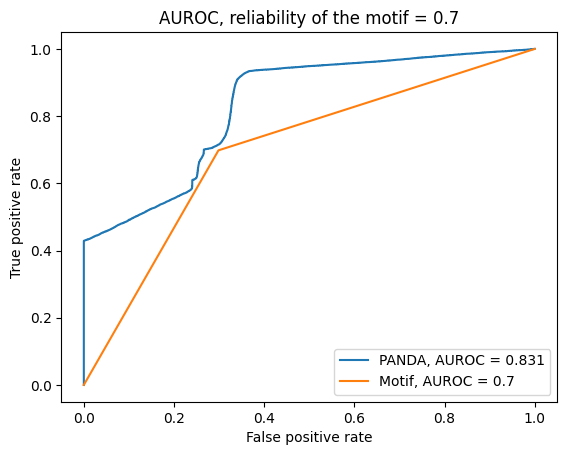

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5816693301432778
step: 1, hamming: 0.5430952019249438
step: 2, hamming: 0.6733300304181529
step: 3, hamming: 0.7489161832691867
step: 4, hamming: 0.799615673422849
step: 5, hamming: 0.8317152565024275
step: 6, hamming: 0.8480537225356868
step: 7, hamming: 0.851076589814411
step: 8, hamming: 0.8431529054212902
step: 9, hamming: 0.8264286282881532
step: 10, hamming: 0.8027260894682962
step: 11, hamming: 0.7735411772027361
step: 12, hamming: 0.7400920928331973
step: 13, hamming: 0.7033804192851986
step: 14, hamming: 0.6642459226728958
step: 15, hamming: 0.6234097176644627
step: 16, hamming: 0.5815060081417486
step

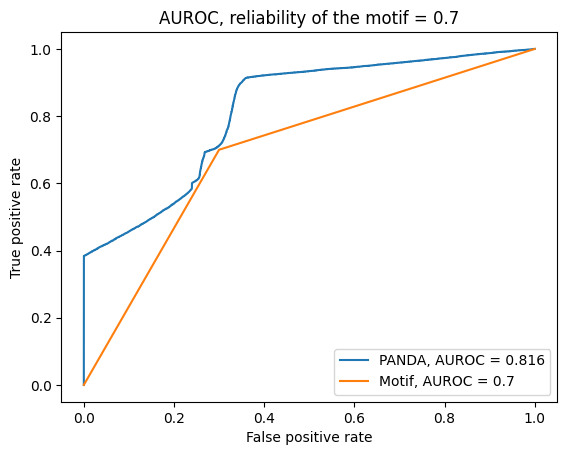

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 236
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5988102504301717
step: 1, hamming: 0.6071081174228499
step: 2, hamming: 0.7471370392065729
step: 3, hamming: 0.8316137625309861
step: 4, hamming: 0.8906964922111977
step: 5, hamming: 0.9307649723614911
step: 6, hamming: 0.9549941838318362
step: 7, hamming: 0.9661982583322943
step: 8, hamming: 0.9669248234269158
step: 9, hamming: 0.9592892882292569
step: 10, hamming: 0.9449689868951614
step: 11, hamming: 0.9252828270374285
step: 12, hamming: 0.901268169180278
step: 13, hamming: 0.8737334213060268
step: 14, hamming: 0.8432995242134586
step: 15, hamming: 0.8104413712093244
step: 16, hamming: 0.7755297641732484
ste

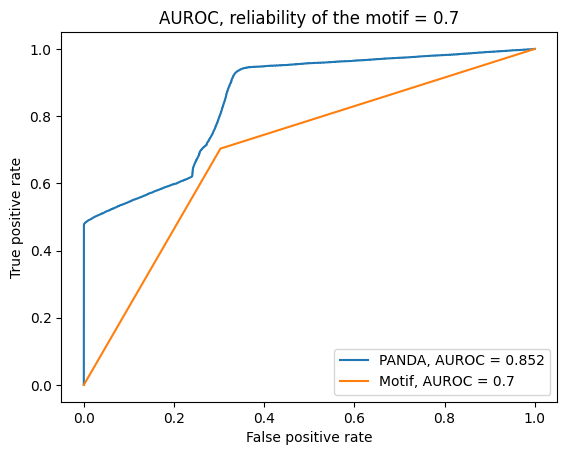

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 170
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5758596642711017
step: 1, hamming: 0.5402794048388996
step: 2, hamming: 0.6636579385455923
step: 3, hamming: 0.7339172226790526
step: 4, hamming: 0.779421163398708
step: 5, hamming: 0.8061848963078107
step: 6, hamming: 0.8169520090500446
step: 7, hamming: 0.8141209327795843
step: 8, hamming: 0.8000798143025513
step: 9, hamming: 0.7770508995172833
step: 10, hamming: 0.7469662137930636
step: 11, hamming: 0.7114475345604476
step: 12, hamming: 0.6718508757577646
step: 13, hamming: 0.6293285134304915
step: 14, hamming: 0.5848841083429963
step: 15, hamming: 0.5394116782072587
step: 16, hamming: 0.4937179034715415
ste

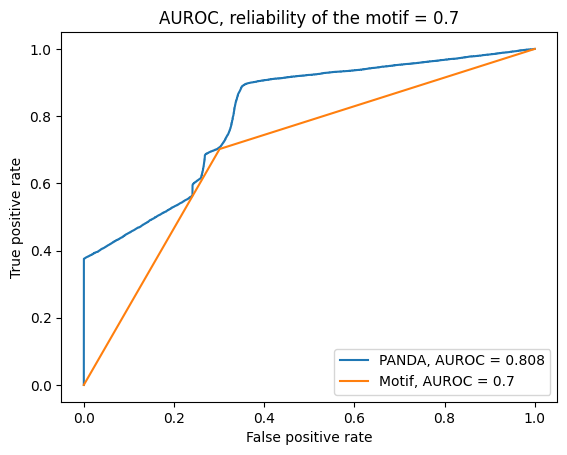

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5887024276237124
step: 1, hamming: 0.5612496970842714
step: 2, hamming: 0.6874648953108055
step: 3, hamming: 0.759971199029969
step: 4, hamming: 0.8074442994296052
step: 5, hamming: 0.8360669793734263
step: 6, hamming: 0.8486939660145414
step: 7, hamming: 0.8478377328719507
step: 8, hamming: 0.8359802722193741
step: 9, hamming: 0.8153850667675911
step: 10, hamming: 0.7879644862856358
step: 11, hamming: 0.7552746659373516
step: 12, hamming: 0.7185785026020084
step: 13, hamming: 0.6789200658873854
step: 14, hamming: 0.637184786724381
step: 15, hamming: 0.5941411192913528
step: 16, hamming: 0.5504673858597344
step

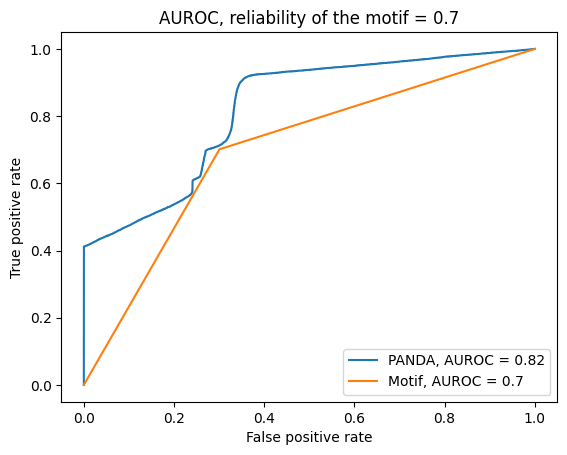

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 202
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5968603629296257
step: 1, hamming: 0.5847700688320758
step: 2, hamming: 0.7162622188599673
step: 3, hamming: 0.793312176035538
step: 4, hamming: 0.8447420264236991
step: 5, hamming: 0.8767276016070421
step: 6, hamming: 0.8921808586768858
step: 7, hamming: 0.8937051693242148
step: 8, hamming: 0.8838075324133059
step: 9, hamming: 0.8647090005695589
step: 10, hamming: 0.8382707281983187
step: 11, hamming: 0.8060322913093823
step: 12, hamming: 0.769282474484832
step: 13, hamming: 0.7291207271045838
step: 14, hamming: 0.6864998873183844
step: 15, hamming: 0.642253786004653
step: 16, hamming: 0.5971156953695331
step:

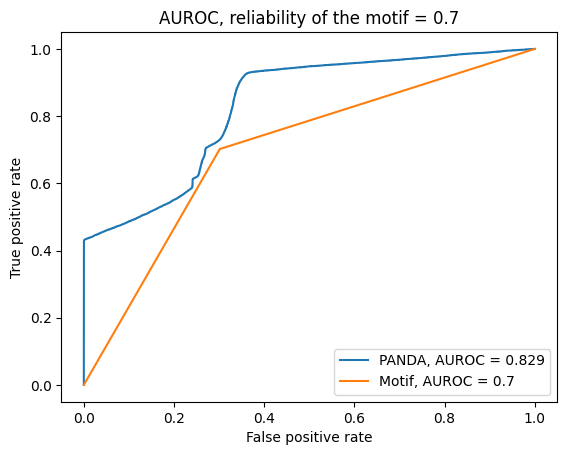

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 188
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5855255529195782
step: 1, hamming: 0.5677472652611216
step: 2, hamming: 0.7019301865445277
step: 3, hamming: 0.7810950537081383
step: 4, hamming: 0.8351778729525987
step: 5, hamming: 0.8704585703458584
step: 6, hamming: 0.8898627803644303
step: 7, hamming: 0.8959577755944338
step: 8, hamming: 0.8911683135661513
step: 9, hamming: 0.8775978862756063
step: 10, hamming: 0.8569669690279658
step: 11, hamming: 0.8306595402073006
step: 12, hamming: 0.7997992740051872
step: 13, hamming: 0.765316666404564
step: 14, hamming: 0.7279991148289282
step: 15, hamming: 0.6885267992948486
step: 16, hamming: 0.6474988384011771
ste

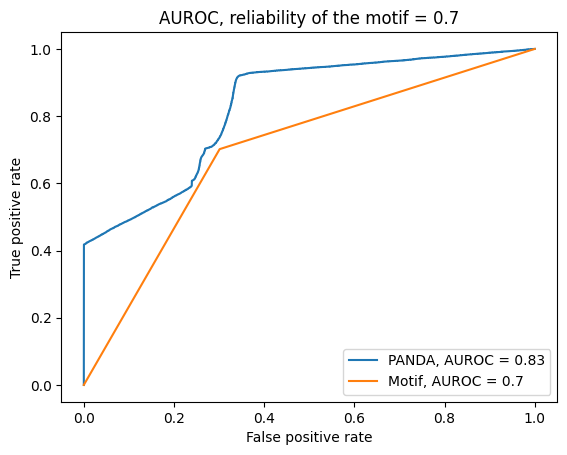

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5929179169210315
step: 1, hamming: 0.5673057878555064
step: 2, hamming: 0.6978846259317385
step: 3, hamming: 0.7736555489427783
step: 4, hamming: 0.8240675233165419
step: 5, hamming: 0.85529487696979
step: 6, hamming: 0.8701952950550527
step: 7, hamming: 0.871282445801864
step: 8, hamming: 0.8609756769697569
step: 9, hamming: 0.8414254355692733
step: 10, hamming: 0.8144382061998886
step: 11, hamming: 0.7815035726085426
step: 12, hamming: 0.7438634000498925
step: 13, hamming: 0.7025844647674173
step: 14, hamming: 0.6586160084631398
step: 15, hamming: 0.6128283753959195
step: 16, hamming: 0.5660343663649945
step:

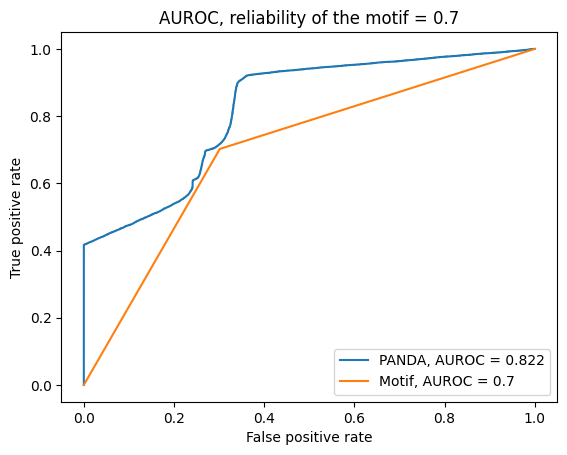

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 198
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5849982796303086
step: 1, hamming: 0.544736390546842
step: 2, hamming: 0.6711726569185225
step: 3, hamming: 0.7436955888185376
step: 4, hamming: 0.791296998582863
step: 5, hamming: 0.8201396544159285
step: 6, hamming: 0.8330246466520929
step: 7, hamming: 0.832404792574485
step: 8, hamming: 0.8206960799124536
step: 9, hamming: 0.8001170338421628
step: 10, hamming: 0.7725745366208895
step: 11, hamming: 0.7396545676102514
step: 12, hamming: 0.7026694580674675
step: 13, hamming: 0.6627177060552827
step: 14, hamming: 0.6207353298220983
step: 15, hamming: 0.5775334426730593
step: 16, hamming: 0.5338234934296303
step:

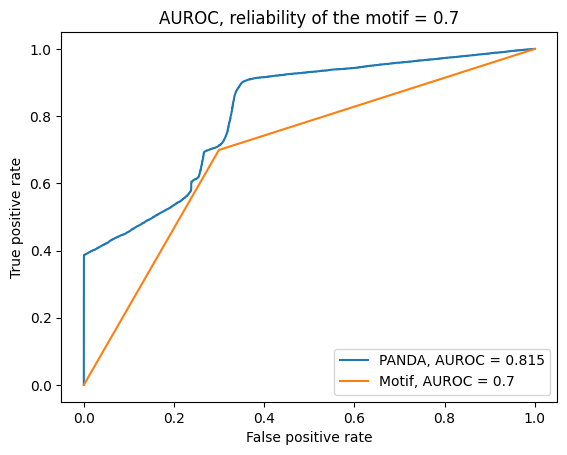

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 172
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.587705836026159
step: 1, hamming: 0.5652607080994972
step: 2, hamming: 0.6982521086630753
step: 3, hamming: 0.7754092142080409
step: 4, hamming: 0.8269711382406711
step: 5, hamming: 0.8593133359494747
step: 6, hamming: 0.875413498088541
step: 7, hamming: 0.877866860420477
step: 8, hamming: 0.8691481304249274
step: 9, hamming: 0.8514619057769414
step: 10, hamming: 0.8266701347341103
step: 11, hamming: 0.7963083233386541
step: 12, hamming: 0.7616339157821379
step: 13, hamming: 0.7236799239322932
step: 14, hamming: 0.683305910423467
step: 15, hamming: 0.6412423898158663
step: 16, hamming: 0.5981262656238737
step: 

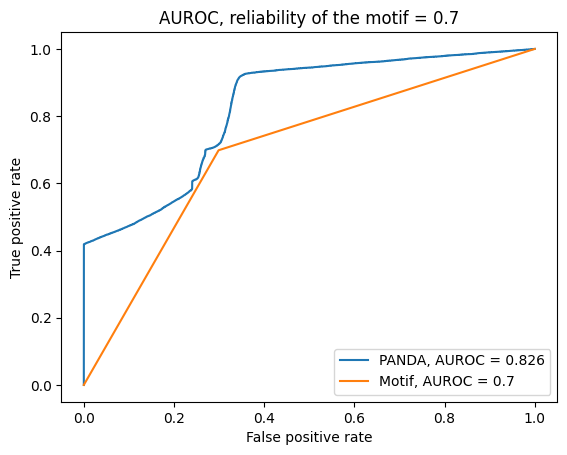

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 170
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5856689891623689
step: 1, hamming: 0.5659465466494491
step: 2, hamming: 0.6952870216088118
step: 3, hamming: 0.7705019907261388
step: 4, hamming: 0.8206490279585209
step: 5, hamming: 0.8519488758628886
step: 6, hamming: 0.8673353874108051
step: 7, hamming: 0.8693921022313704
step: 8, hamming: 0.8606027920626027
step: 9, hamming: 0.8431816797250574
step: 10, hamming: 0.8189771580084582
step: 11, hamming: 0.7894788331436677
step: 12, hamming: 0.7558749253893328
step: 13, hamming: 0.7191219209246196
step: 14, hamming: 0.6800077926099368
step: 15, hamming: 0.6392021896224026
step: 16, hamming: 0.5972931782614607
st

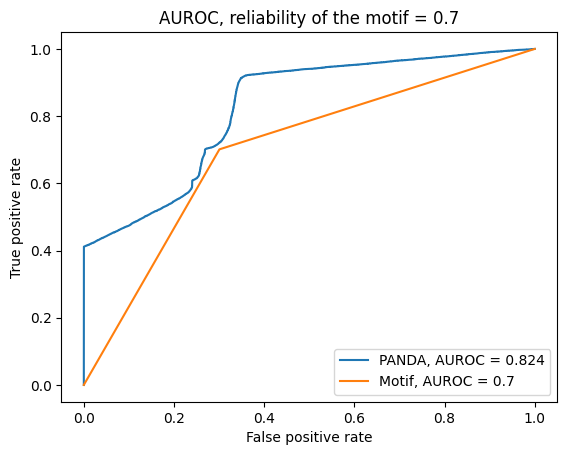

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 170
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5818656743620771
step: 1, hamming: 0.5453094538432915
step: 2, hamming: 0.667880233988096
step: 3, hamming: 0.7374418588888428
step: 4, hamming: 0.7821736290277693
step: 5, hamming: 0.8080937228146576
step: 6, hamming: 0.8179328096722033
step: 7, hamming: 0.8141197929959878
step: 8, hamming: 0.7991015351954032
step: 9, hamming: 0.7751611352722608
step: 10, hamming: 0.7442842143324713
step: 11, hamming: 0.7081356212618966
step: 12, hamming: 0.6681066263812897
step: 13, hamming: 0.6253755275074571
step: 14, hamming: 0.5809578884569192
step: 15, hamming: 0.5357420362515295
step: 16, hamming: 0.49051074623544116
st

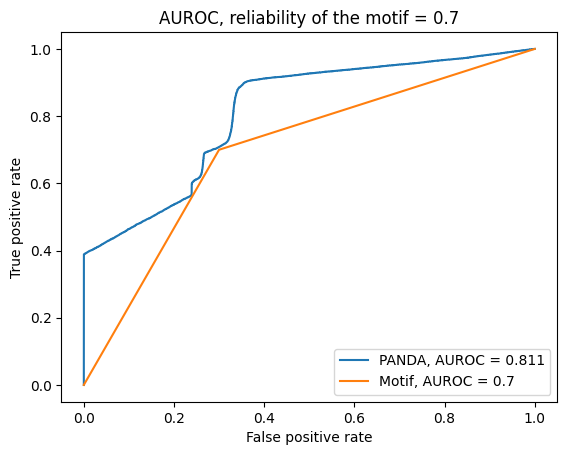

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 172
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5810079567302191
step: 1, hamming: 0.539784059876766
step: 2, hamming: 0.6642382731028045
step: 3, hamming: 0.7352024498703856
step: 4, hamming: 0.7814093414160024
step: 5, hamming: 0.8089899082176615
step: 6, hamming: 0.8207015997436432
step: 7, hamming: 0.8189861078662708
step: 8, hamming: 0.8062815539918008
step: 9, hamming: 0.7848404045036662
step: 10, hamming: 0.7566054341039641
step: 11, hamming: 0.7231965063323017
step: 12, hamming: 0.6859530185740604
step: 13, hamming: 0.6459879140640195
step: 14, hamming: 0.6042350157608777
step: 15, hamming: 0.5614866966662776
step: 16, hamming: 0.5184230088940927
ste

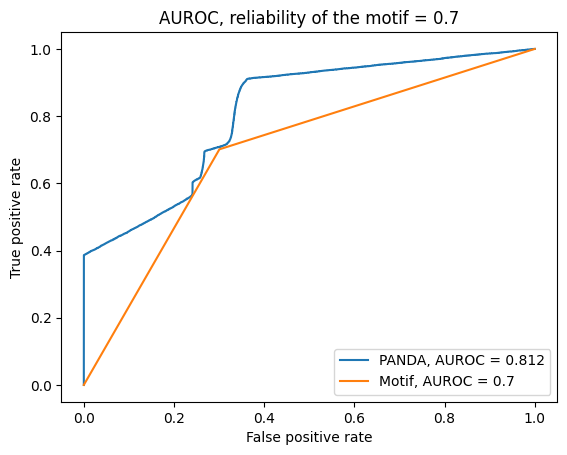

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 182
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5854904297138767
step: 1, hamming: 0.5399686328731857
step: 2, hamming: 0.663151583000107
step: 3, hamming: 0.7328878698698668
step: 4, hamming: 0.7777416872482729
step: 5, hamming: 0.8038048062640846
step: 6, hamming: 0.8138617427822255
step: 7, hamming: 0.8103677352841818
step: 8, hamming: 0.7957745478903613
step: 9, hamming: 0.7723595142891075
step: 10, hamming: 0.742098533104117
step: 11, hamming: 0.7066511600218057
step: 12, hamming: 0.6674038463475784
step: 13, hamming: 0.6255251324795008
step: 14, hamming: 0.5820131466201072
step: 15, hamming: 0.5377301643065779
step: 16, hamming: 0.4934249199519681
step

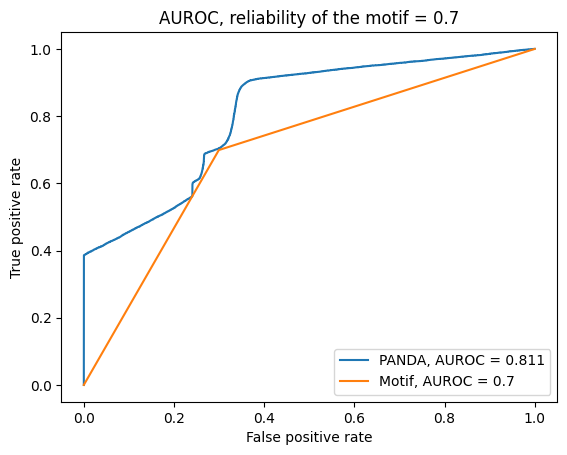

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5848996344012602
step: 1, hamming: 0.5518177670283343
step: 2, hamming: 0.67901105951242
step: 3, hamming: 0.752264503884891
step: 4, hamming: 0.8005474624728784
step: 5, hamming: 0.8299447478944113
step: 6, hamming: 0.8432520730120988
step: 7, hamming: 0.8429604024549605
step: 8, hamming: 0.8315038852251004
step: 9, hamming: 0.8110835948605739
step: 10, hamming: 0.7835787681284068
step: 11, hamming: 0.7505596628746132
step: 12, hamming: 0.7133419754697073
step: 13, hamming: 0.6730437563599901
step: 14, hamming: 0.6306293205000879
step: 15, hamming: 0.586938916979682
step: 16, hamming: 0.5427083622710602
step: 

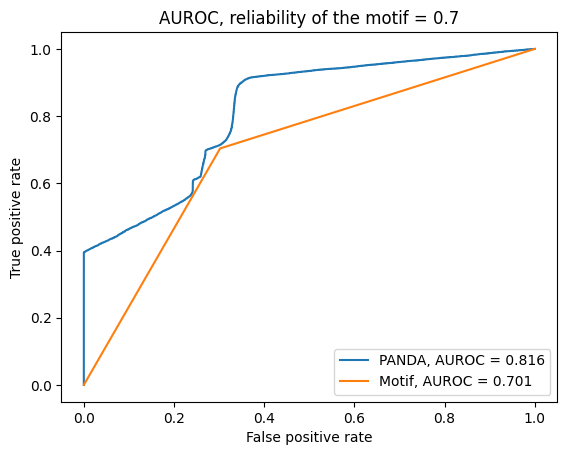

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 178
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5847523156532183
step: 1, hamming: 0.5567321131184059
step: 2, hamming: 0.6825241467318669
step: 3, hamming: 0.7540966566320222
step: 4, hamming: 0.8002779686179834
step: 5, hamming: 0.8272953946443523
step: 6, hamming: 0.8380387042223171
step: 7, hamming: 0.8350507013403186
step: 8, hamming: 0.8208460527998482
step: 9, hamming: 0.7977466571114367
step: 10, hamming: 0.7677629137211647
step: 11, hamming: 0.7325757455352229
step: 12, hamming: 0.6935732075446515
step: 13, hamming: 0.6519040645354639
step: 14, hamming: 0.6085295123151304
step: 15, hamming: 0.5642655363319278
step: 16, hamming: 0.5198141856720163
st

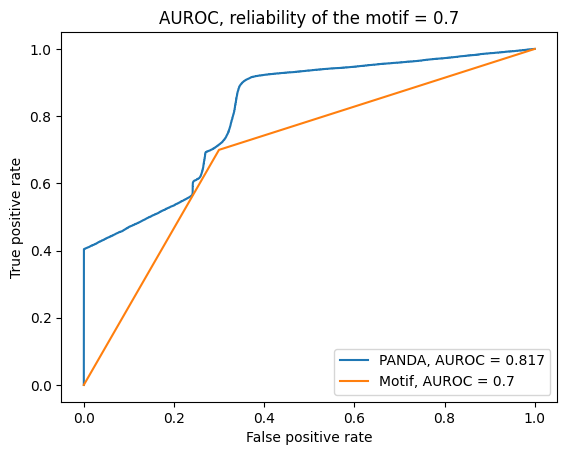

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5886456413949833
step: 1, hamming: 0.5637912032062674
step: 2, hamming: 0.6899070496848985
step: 3, hamming: 0.7624841964954419
step: 4, hamming: 0.810020720188503
step: 5, hamming: 0.8385308465525143
step: 6, hamming: 0.8507765399715729
step: 7, hamming: 0.8492447652002804
step: 8, hamming: 0.8363910272065103
step: 9, hamming: 0.8144304952706967
step: 10, hamming: 0.7852264064592891
step: 11, hamming: 0.750309545985345
step: 12, hamming: 0.7109524404915539
step: 13, hamming: 0.6682462129208523
step: 14, hamming: 0.6231610947655787
step: 15, hamming: 0.5765869549926349
step: 16, hamming: 0.5293547690196051
step

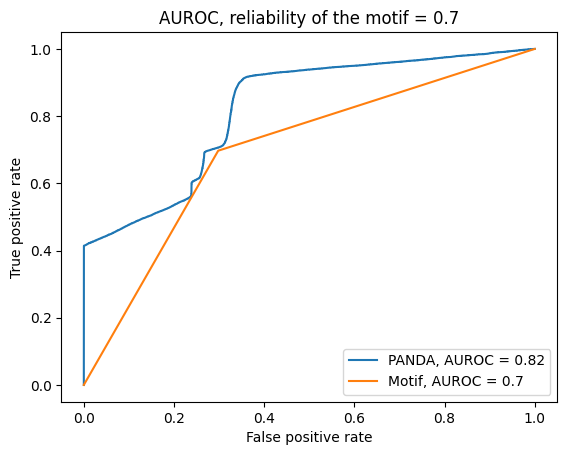

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 200
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.03 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5991112953542509
step: 1, hamming: 0.5770881370766049
step: 2, hamming: 0.708561594277946
step: 3, hamming: 0.7845586755712964
step: 4, hamming: 0.8349645350783136
step: 5, hamming: 0.8659840914702536
step: 6, hamming: 0.8804587782328002
step: 7, hamming: 0.8809357489777427
step: 8, hamming: 0.8698840281517208
step: 9, hamming: 0.8494884326178873
step: 10, hamming: 0.8215725466392267
step: 11, hamming: 0.7876413202820958
step: 12, hamming: 0.7489645422353653
step: 13, hamming: 0.7066504287155762
step: 14, hamming: 0.6616951569315034
step: 15, hamming: 0.615011922258975
step: 16, hamming: 0.5674456211050318
step

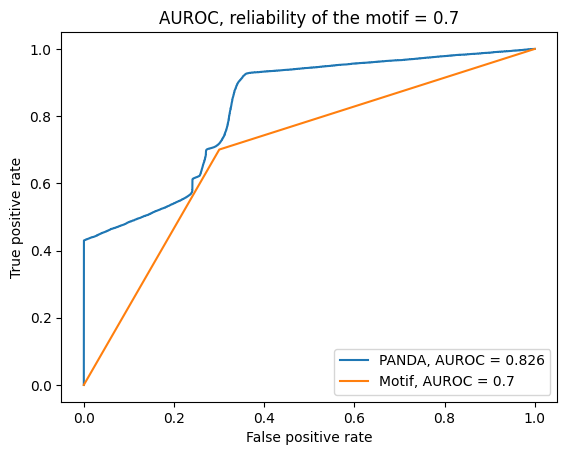

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 158
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5814227408022503
step: 1, hamming: 0.5525961079366867
step: 2, hamming: 0.6877548284423163
step: 3, hamming: 0.7682685852565946
step: 4, hamming: 0.8242703645954275
step: 5, hamming: 0.8620311156505877
step: 6, hamming: 0.8843964402691821
step: 7, hamming: 0.8937679362533238
step: 8, hamming: 0.8924208182102992
step: 9, hamming: 0.8823837085096478
step: 10, hamming: 0.8653551218365165
step: 11, hamming: 0.8427053899668643
step: 12, hamming: 0.8155247643393099
step: 13, hamming: 0.7846833663228352
step: 14, hamming: 0.7508867306672462
step: 15, hamming: 0.7147221246518991
step: 16, hamming: 0.6766955440360299
st

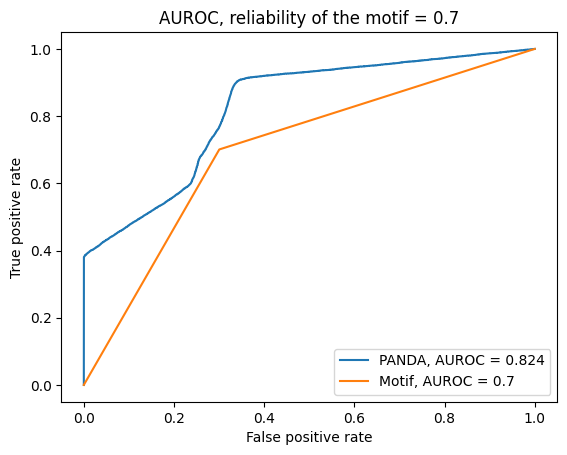

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 200
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5811419521475475
step: 1, hamming: 0.5446384832339638
step: 2, hamming: 0.6686912920873058
step: 3, hamming: 0.7391766017494759
step: 4, hamming: 0.7846105797761177
step: 5, hamming: 0.8111901072771066
step: 6, hamming: 0.8217537323672329
step: 7, hamming: 0.8187724311216328
step: 8, hamming: 0.8046944349662015
step: 9, hamming: 0.781799197566676
step: 10, hamming: 0.7520682029193406
step: 11, hamming: 0.7171575521130554
step: 12, hamming: 0.6784366998294417
step: 13, hamming: 0.6370485520667268
step: 14, hamming: 0.5939631953705001
step: 15, hamming: 0.5500163346035375
step: 16, hamming: 0.5059336036439066
ste

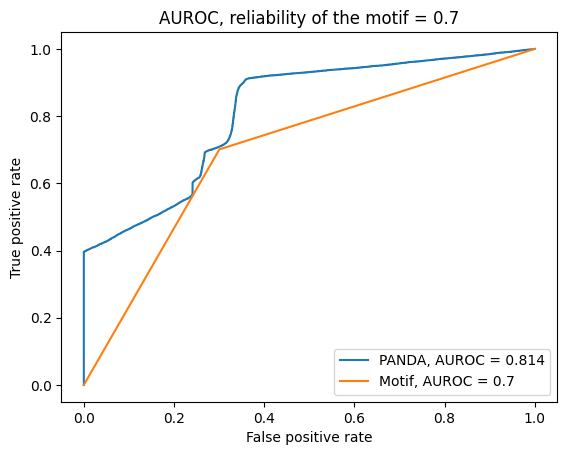

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 200
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.600721804816207
step: 1, hamming: 0.5626532472720659
step: 2, hamming: 0.686690699090702
step: 3, hamming: 0.7577597350558063
step: 4, hamming: 0.803734118690974
step: 5, hamming: 0.8306749840215294
step: 6, hamming: 0.8414389061083983
step: 7, hamming: 0.8385693275732021
step: 8, hamming: 0.8245937662501864
step: 9, hamming: 0.8018377147686119
step: 10, hamming: 0.7722874766021101
step: 11, hamming: 0.737579192928613
step: 12, hamming: 0.6990541265826472
step: 13, hamming: 0.6578244966056628
step: 14, hamming: 0.6148275722135779
step: 15, hamming: 0.5708651370960706
step: 16, hamming: 0.5266310845931106
step: 

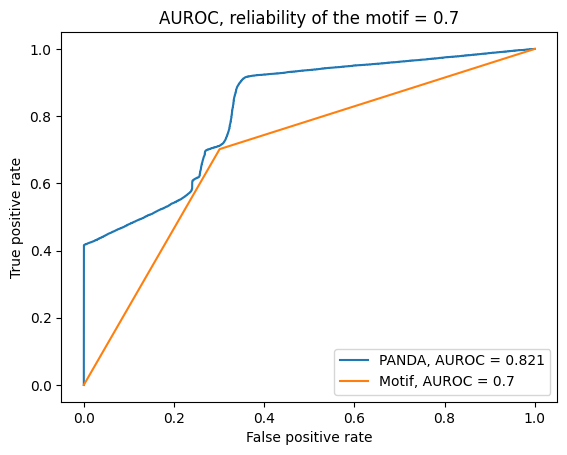

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 202
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5828457719774484
step: 1, hamming: 0.5631236780504673
step: 2, hamming: 0.6945584282515707
step: 3, hamming: 0.7711239106153819
step: 4, hamming: 0.8226937503524365
step: 5, hamming: 0.8555729109110899
step: 6, hamming: 0.872667867459538
step: 7, hamming: 0.8765540238427769
step: 8, hamming: 0.8697078731349394
step: 9, hamming: 0.8543103653206806
step: 10, hamming: 0.8321483833154414
step: 11, hamming: 0.8046410855966849
step: 12, hamming: 0.7729170871671057
step: 13, hamming: 0.7378911204037254
step: 14, hamming: 0.7003232413335954
step: 15, hamming: 0.6608614803696277
step: 16, hamming: 0.6200730100895853
ste

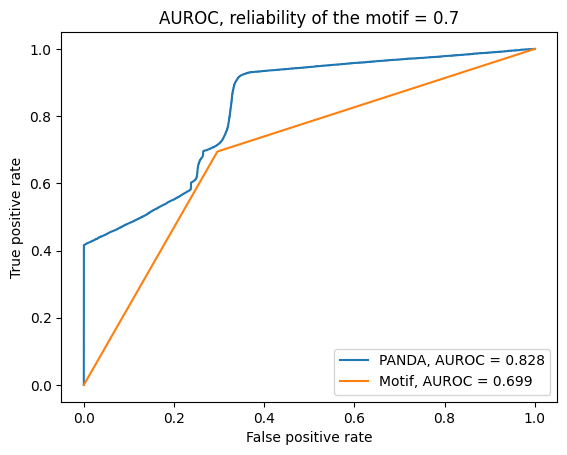

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5844052586181616
step: 1, hamming: 0.5530365376995394
step: 2, hamming: 0.6809280689470626
step: 3, hamming: 0.7542347168882217
step: 4, hamming: 0.8022702302615202
step: 5, hamming: 0.8313294651876131
step: 6, hamming: 0.8443149720001534
step: 7, hamming: 0.8437692328877212
step: 8, hamming: 0.8321760831927826
step: 9, hamming: 0.8117929500114558
step: 10, hamming: 0.7845393533990083
step: 11, hamming: 0.7519952301284306
step: 12, hamming: 0.7154527107097975
step: 13, hamming: 0.6759773895783181
step: 14, hamming: 0.6344623778437368
step: 15, hamming: 0.591671310643293
step: 16, hamming: 0.5482702063633266
ste

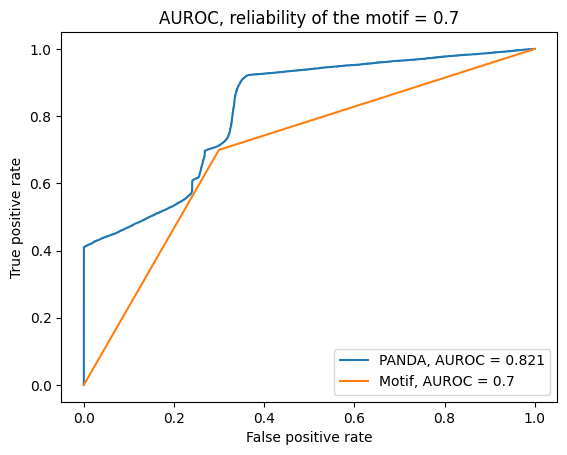

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 214
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5929377294185194
step: 1, hamming: 0.5679530642184426
step: 2, hamming: 0.7028580960236169
step: 3, hamming: 0.7818634053805497
step: 4, hamming: 0.8355493629955439
step: 5, hamming: 0.8704059706692954
step: 6, hamming: 0.8894403011732351
step: 7, hamming: 0.8952559398383773
step: 8, hamming: 0.8903180648498956
step: 9, hamming: 0.8767821644731929
step: 10, hamming: 0.8564086886336444
step: 11, hamming: 0.8305894300469449
step: 12, hamming: 0.8004198214408307
step: 13, hamming: 0.7667742689253286
step: 14, hamming: 0.7303692598028464
step: 15, hamming: 0.6918121211105592
step: 16, hamming: 0.6516373300407675
st

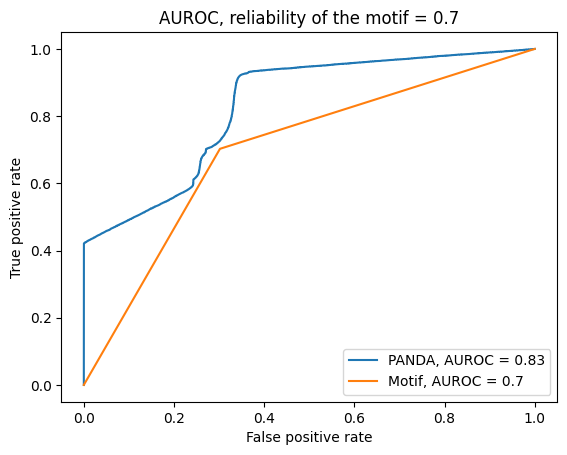

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 196
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5859974640976026
step: 1, hamming: 0.5686482499341426
step: 2, hamming: 0.70186587885159
step: 3, hamming: 0.7801463093357188
step: 4, hamming: 0.8332361415552341
step: 5, hamming: 0.8674671118956534
step: 6, hamming: 0.8857600851286529
step: 7, hamming: 0.8906372112137196
step: 8, hamming: 0.8845175081682392
step: 9, hamming: 0.8695435215312752
step: 10, hamming: 0.8474829400240379
step: 11, hamming: 0.8197528227410205
step: 12, hamming: 0.7874977833796513
step: 13, hamming: 0.7516686760425653
step: 14, hamming: 0.7130810044428553
step: 15, hamming: 0.6724517897704635
step: 16, hamming: 0.630421085776003
step:

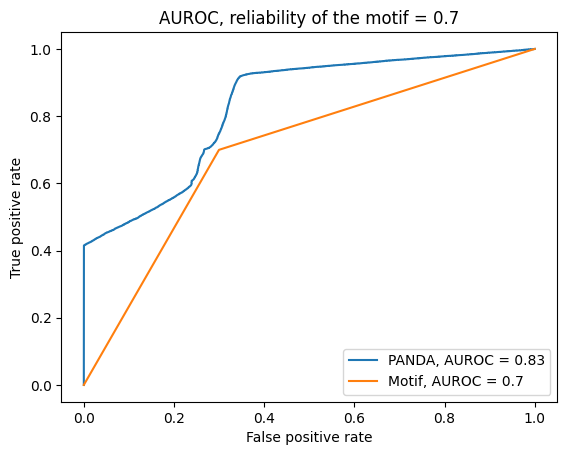

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 162
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5825070886291015
step: 1, hamming: 0.5462932528332103
step: 2, hamming: 0.67189616275785
step: 3, hamming: 0.7435937249578505
step: 4, hamming: 0.7902640542910956
step: 5, hamming: 0.8180021283789523
step: 6, hamming: 0.8295744835647318
step: 7, hamming: 0.8273859482294652
step: 8, hamming: 0.8138200047218701
step: 9, hamming: 0.7910946684294934
step: 10, hamming: 0.7611509745677878
step: 11, hamming: 0.7256321630715629
step: 12, hamming: 0.6859259667108506
step: 13, hamming: 0.6432219905136793
step: 14, hamming: 0.5985599520255245
step: 15, hamming: 0.5528618297537228
step: 16, hamming: 0.5069491013389723
step

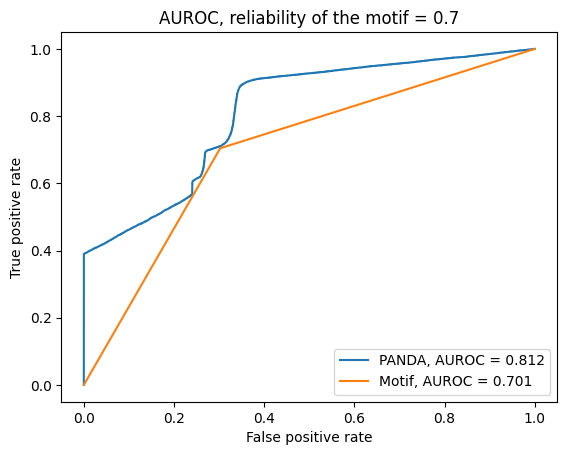

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 232
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.607702193132992
step: 1, hamming: 0.5840327811720024
step: 2, hamming: 0.715583973903488
step: 3, hamming: 0.7922695519285455
step: 4, hamming: 0.8433960325956938
step: 5, hamming: 0.8751016455120305
step: 6, hamming: 0.8903578007416462
step: 7, hamming: 0.8918768878454567
step: 8, hamming: 0.8822328334719189
step: 9, hamming: 0.863671792012043
step: 10, hamming: 0.8380597727858902
step: 11, hamming: 0.8069261144405984
step: 12, hamming: 0.7715255175029845
step: 13, hamming: 0.7328933534599898
step: 14, hamming: 0.6918935645444474
step: 15, hamming: 0.6492597309316971
step: 16, hamming: 0.6056284388058392
step:

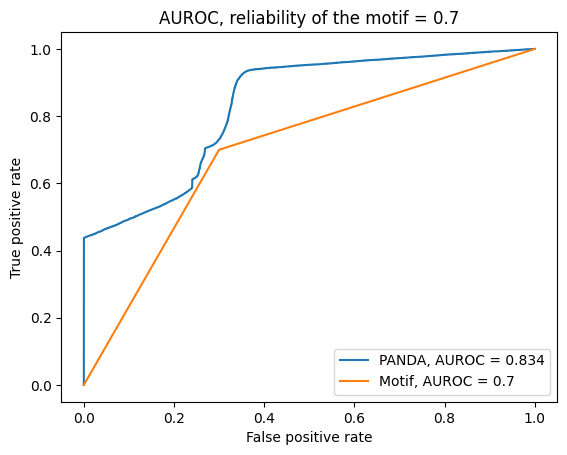

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5929163495650586
step: 1, hamming: 0.5827743553467882
step: 2, hamming: 0.7163718898193695
step: 3, hamming: 0.795386899878107
step: 4, hamming: 0.8493108166835772
step: 5, hamming: 0.8843148767975257
step: 6, hamming: 0.9033279944792434
step: 7, hamming: 0.9089731689018576
step: 8, hamming: 0.9037108655538019
step: 9, hamming: 0.8896415690710914
step: 10, hamming: 0.8684540727886262
step: 11, hamming: 0.8414841205517591
step: 12, hamming: 0.8098048043095256
step: 13, hamming: 0.7743099621014212
step: 14, hamming: 0.7357772720353305
step: 15, hamming: 0.6949094992122352
step: 16, hamming: 0.6523575430996499
ste

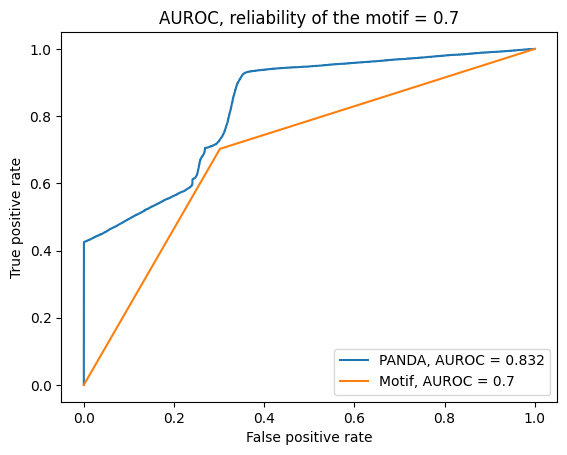

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 178
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5778566209497235
step: 1, hamming: 0.5365771303788115
step: 2, hamming: 0.6602595280766929
step: 3, hamming: 0.7300220310758205
step: 4, hamming: 0.7749152410245009
step: 5, hamming: 0.8011153370809002
step: 6, hamming: 0.8113727782148392
step: 7, hamming: 0.8081346518525635
step: 8, hamming: 0.7938672481649722
step: 9, hamming: 0.7708603392813097
step: 10, hamming: 0.7410915486830479
step: 11, hamming: 0.7062123536026275
step: 12, hamming: 0.6675939985392179
step: 13, hamming: 0.6263844475129482
step: 14, hamming: 0.583556386635066
step: 15, hamming: 0.5399425304425762
step: 16, hamming: 0.496260147655101
step

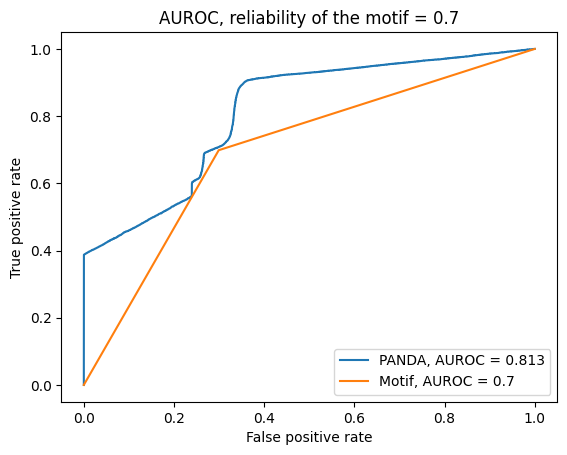

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 212
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5950843655005017
step: 1, hamming: 0.573429971425229
step: 2, hamming: 0.7036824543067133
step: 3, hamming: 0.7794700729850013
step: 4, hamming: 0.8296761062687268
step: 5, hamming: 0.8606304542776626
step: 6, hamming: 0.8753612849259792
step: 7, hamming: 0.8765212407912282
step: 8, hamming: 0.866644268508209
step: 9, hamming: 0.8479874510632898
step: 10, hamming: 0.8224454102231824
step: 11, hamming: 0.7915579105136397
step: 12, hamming: 0.7565620308177624
step: 13, hamming: 0.7184573765267421
step: 14, hamming: 0.6780677225853957
step: 15, hamming: 0.63609147641427
step: 16, hamming: 0.5931392405410056
step: 

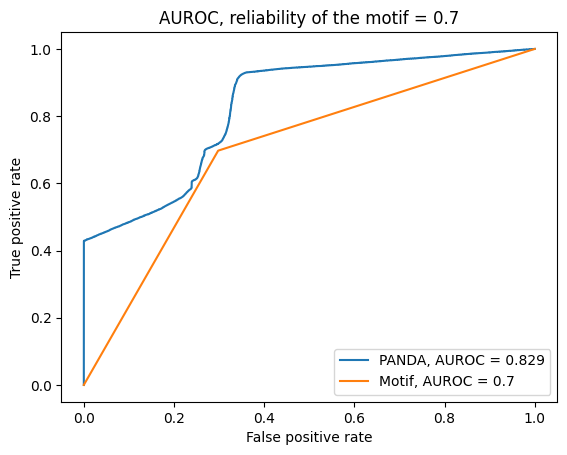

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 182
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5935620772883753
step: 1, hamming: 0.5591102073266205
step: 2, hamming: 0.6896291151078198
step: 3, hamming: 0.7653140291064562
step: 4, hamming: 0.8158692421252107
step: 5, hamming: 0.847605090634561
step: 6, hamming: 0.8634351073941993
step: 7, hamming: 0.8659220488592226
step: 8, hamming: 0.8575300450108714
step: 9, hamming: 0.8404499629600434
step: 10, hamming: 0.8165109201823725
step: 11, hamming: 0.7871943418608313
step: 12, hamming: 0.7536923234716061
step: 13, hamming: 0.7169741572423517
step: 14, hamming: 0.6778453759646602
step: 15, hamming: 0.6369944005273762
step: 16, hamming: 0.5950268413542781
ste

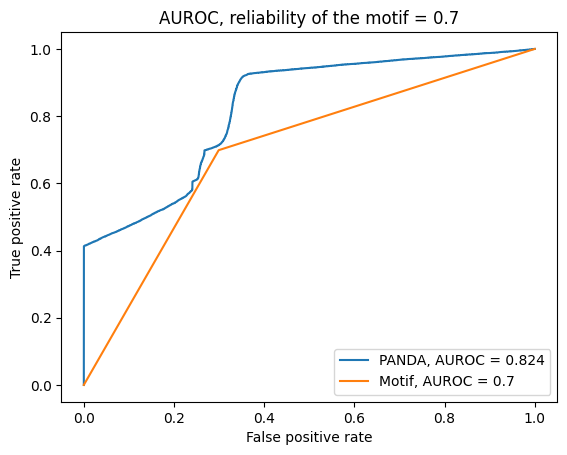

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 208
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5955112551317627
step: 1, hamming: 0.5791802282180536
step: 2, hamming: 0.7120714903068575
step: 3, hamming: 0.7899104388669216
step: 4, hamming: 0.8422844548725404
step: 5, hamming: 0.8755257446237368
step: 6, hamming: 0.892598353065965
step: 7, hamming: 0.8960751979797906
step: 8, hamming: 0.8884080787046796
step: 9, hamming: 0.8717614931720234
step: 10, hamming: 0.8479257426736868
step: 11, hamming: 0.8183456317948483
step: 12, hamming: 0.7841973068415049
step: 13, hamming: 0.7464656167648714
step: 14, hamming: 0.7060030850934452
step: 15, hamming: 0.6635680878180595
step: 16, hamming: 0.6198466681977453
ste

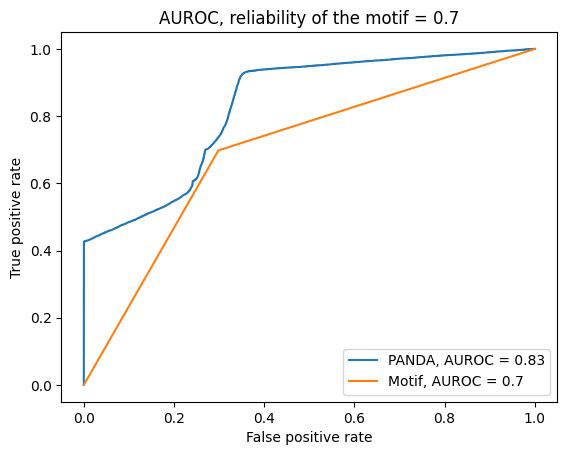

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.584842961230141
step: 1, hamming: 0.5612573701002311
step: 2, hamming: 0.6892411909090341
step: 3, hamming: 0.7630512944469798
step: 4, hamming: 0.8116490302572194
step: 5, hamming: 0.8412599583034579
step: 6, hamming: 0.8547767456894911
step: 7, hamming: 0.8547422981196383
step: 8, hamming: 0.8436409920075556
step: 9, hamming: 0.8237292156854061
step: 10, hamming: 0.7969204695985173
step: 11, hamming: 0.764782102275919
step: 12, hamming: 0.7285904592833341
step: 13, hamming: 0.6893964947225307
step: 14, hamming: 0.6480814712698385
step: 15, hamming: 0.6053994221088044
step: 16, hamming: 0.5620081905745034
step

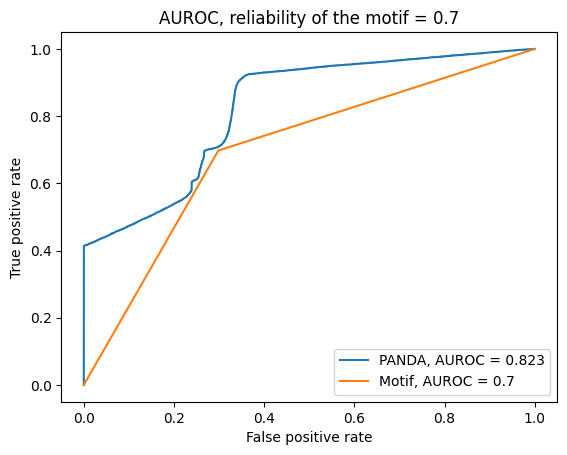

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5820348312249785
step: 1, hamming: 0.5567914945978677
step: 2, hamming: 0.6853062223132484
step: 3, hamming: 0.7586704106742638
step: 4, hamming: 0.8065853475902531
step: 5, hamming: 0.8353593250085534
step: 6, hamming: 0.8478452861559198
step: 7, hamming: 0.846527011754983
step: 8, hamming: 0.8338339005097625
step: 9, hamming: 0.8119714819756514
step: 10, hamming: 0.782801819386813
step: 11, hamming: 0.7478556110499991
step: 12, hamming: 0.7084048548428351
step: 13, hamming: 0.6655412846383953
step: 14, hamming: 0.62023971484174
step: 15, hamming: 0.5734008171892486
step: 16, hamming: 0.5258732232092218
step: 

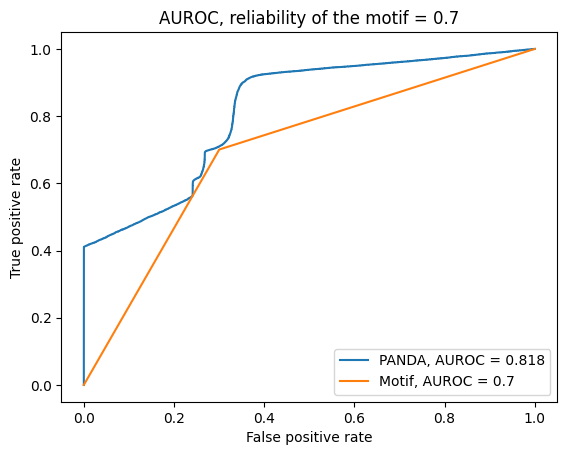

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 190
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5842021932832596
step: 1, hamming: 0.5605405606534688
step: 2, hamming: 0.6876839218107953
step: 3, hamming: 0.7607813352895357
step: 4, hamming: 0.8084894956586125
step: 5, hamming: 0.8368743738071273
step: 6, hamming: 0.8487847102350423
step: 7, hamming: 0.8467068357100598
step: 8, hamming: 0.8330576197074228
step: 9, hamming: 0.8100664505133994
step: 10, hamming: 0.7796974523198964
step: 11, hamming: 0.7436410099807725
step: 12, hamming: 0.7033445898333895
step: 13, hamming: 0.6600554246874207
step: 14, hamming: 0.6148574202518505
step: 15, hamming: 0.568696192303244
step: 16, hamming: 0.522394042908192
step

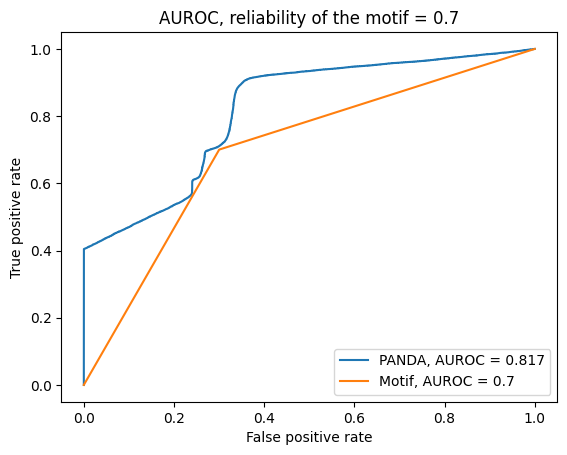

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5818942493882401
step: 1, hamming: 0.5347813195201931
step: 2, hamming: 0.6579557491099262
step: 3, hamming: 0.7280946530854626
step: 4, hamming: 0.7734543970932717
step: 5, hamming: 0.800138047398014
step: 6, hamming: 0.8109053454929185
step: 7, hamming: 0.8081600847833659
step: 8, hamming: 0.7943133639798781
step: 9, hamming: 0.7716306888763766
step: 10, hamming: 0.7420987712327157
step: 11, hamming: 0.7073926725634244
step: 12, hamming: 0.6689054429938068
step: 13, hamming: 0.6277987120818292
step: 14, hamming: 0.5850511188740873
step: 15, hamming: 0.5414964785086039
step: 16, hamming: 0.497851149719933
step

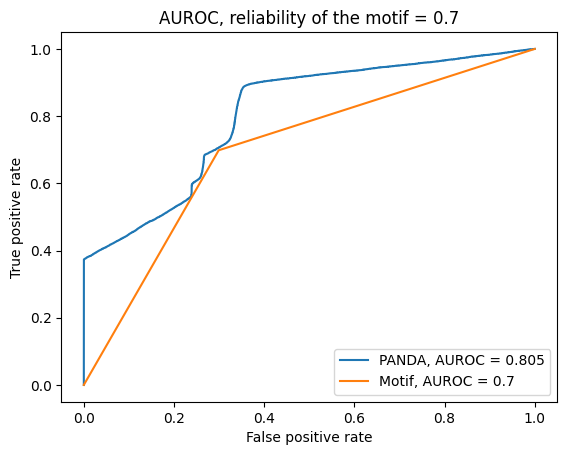

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 206
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5867212791653486
step: 1, hamming: 0.5605823176190302
step: 2, hamming: 0.6919307944764345
step: 3, hamming: 0.7677669975396203
step: 4, hamming: 0.8182109524706086
step: 5, hamming: 0.849638605314384
step: 6, hamming: 0.8649801783750296
step: 7, hamming: 0.8667638109403196
step: 8, hamming: 0.857433844035936
step: 9, hamming: 0.8391953077751155
step: 10, hamming: 0.8139094933189174
step: 11, hamming: 0.7830947537352927
step: 12, hamming: 0.7479851828402486
step: 13, hamming: 0.7096013986264242
step: 14, hamming: 0.6688101964726895
step: 15, hamming: 0.6263672427045566
step: 16, hamming: 0.5829449841410828
step

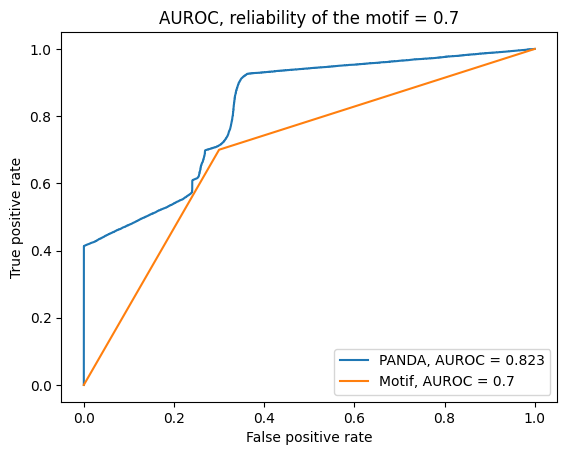

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 164
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5808736308142851
step: 1, hamming: 0.5518041285978953
step: 2, hamming: 0.6799712364602478
step: 3, hamming: 0.7537516696965707
step: 4, hamming: 0.8022367635571065
step: 5, hamming: 0.831638649498663
step: 6, hamming: 0.8448411991548213
step: 7, hamming: 0.8443714010160772
step: 8, hamming: 0.8326941125048456
step: 9, hamming: 0.8120572427880587
step: 10, hamming: 0.7843947582285334
step: 11, hamming: 0.7513258198923431
step: 12, hamming: 0.7141946589527411
step: 13, hamming: 0.6741187872944611
step: 14, hamming: 0.632035279864403
step: 15, hamming: 0.5887409614261322
step: 16, hamming: 0.5449241610440033
step

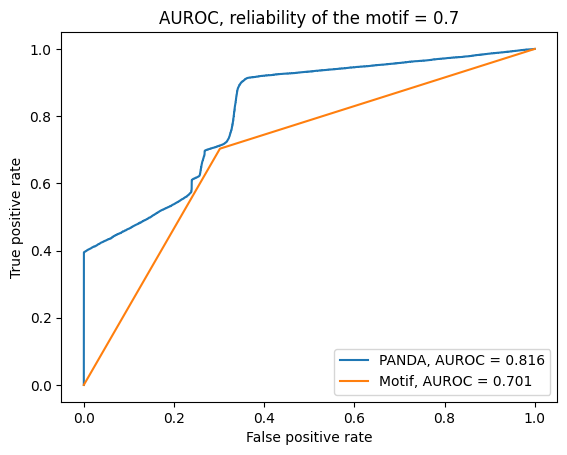

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5808817542053147
step: 1, hamming: 0.5325328598191233
step: 2, hamming: 0.6558377822918128
step: 3, hamming: 0.7260739785617927
step: 4, hamming: 0.7716646220570114
step: 5, hamming: 0.7986605910740919
step: 6, hamming: 0.8097423526770233
step: 7, hamming: 0.8072412309597008
step: 8, hamming: 0.7935175366481322
step: 9, hamming: 0.7707960250582329
step: 10, hamming: 0.7410310008152048
step: 11, hamming: 0.705882682689876
step: 12, hamming: 0.6667546520362668
step: 13, hamming: 0.6248450931423907
step: 14, hamming: 0.5811897703275208
step: 15, hamming: 0.5366913270635204
step: 16, hamming: 0.49213680389606174
st

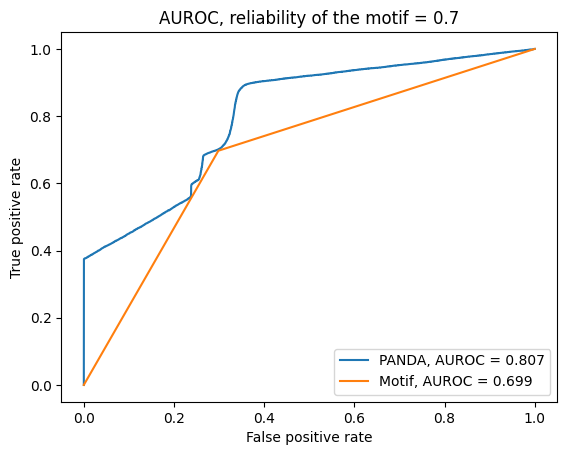

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 218
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6026237969949395
step: 1, hamming: 0.604940405742747
step: 2, hamming: 0.7393254040641785
step: 3, hamming: 0.8196924470890715
step: 4, hamming: 0.8748685789652214
step: 5, hamming: 0.9110492735941788
step: 6, hamming: 0.9312369254979264
step: 7, hamming: 0.9381676041330115
step: 8, hamming: 0.9344038895107062
step: 9, hamming: 0.9220799554458066
step: 10, hamming: 0.9028409694480009
step: 11, hamming: 0.8779350085698251
step: 12, hamming: 0.848338875347948
step: 13, hamming: 0.8148605470025982
step: 14, hamming: 0.7782066498136785
step: 15, hamming: 0.7390201155493867
step: 16, hamming: 0.6978972155832645
step

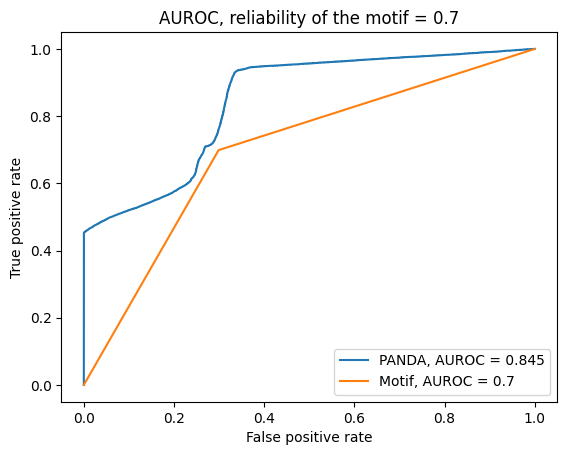

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 186
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5909713798916729
step: 1, hamming: 0.5599365225062404
step: 2, hamming: 0.6841683457360931
step: 3, hamming: 0.7553573783100372
step: 4, hamming: 0.8016703029209853
step: 5, hamming: 0.8291687724667511
step: 6, hamming: 0.8406387611677549
step: 7, hamming: 0.8386025585686744
step: 8, hamming: 0.8255899525088113
step: 9, hamming: 0.8039139559371363
step: 10, hamming: 0.7755279871882759
step: 11, hamming: 0.7420218639606019
step: 12, hamming: 0.7046843755761896
step: 13, hamming: 0.6645751255686656
step: 14, hamming: 0.6225837071590447
step: 15, hamming: 0.5794730826359278
step: 16, hamming: 0.5359095271138489
st

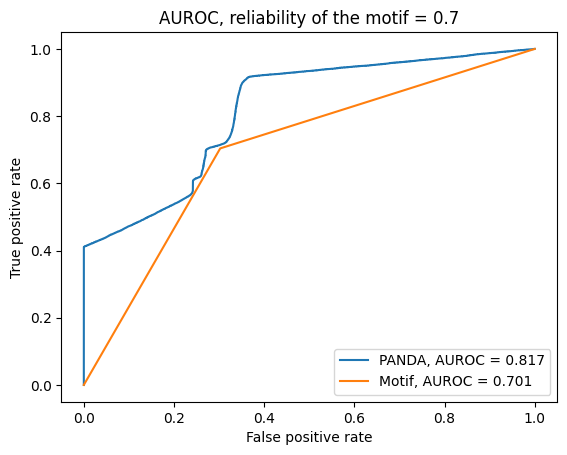

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 146
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5790442227374252
step: 1, hamming: 0.5243944839080832
step: 2, hamming: 0.6454991603983732
step: 3, hamming: 0.7130459009303608
step: 4, hamming: 0.7558563979637688
step: 5, hamming: 0.7801464557265417
step: 6, hamming: 0.788696477086081
step: 7, hamming: 0.7839079505027097
step: 8, hamming: 0.7682061403016046
step: 9, hamming: 0.7438907038014012
step: 10, hamming: 0.7129829049954259
step: 11, hamming: 0.6771820214497172
step: 12, hamming: 0.6378957532543785
step: 13, hamming: 0.596294316735867
step: 14, hamming: 0.5533609639701007
step: 15, hamming: 0.5099304057658297
step: 16, hamming: 0.4667151456899114
step

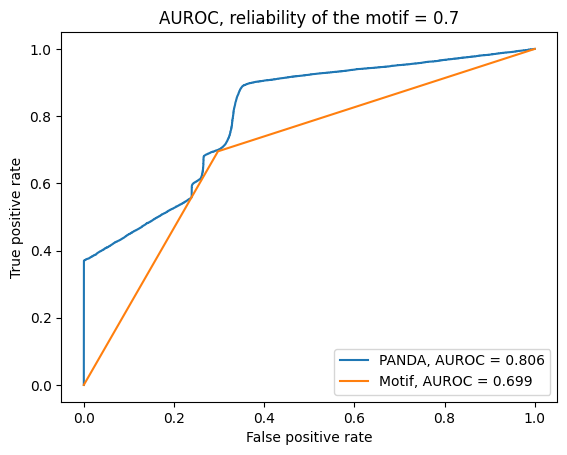

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 168
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5850914541694128
step: 1, hamming: 0.5421112243270843
step: 2, hamming: 0.6646748723541684
step: 3, hamming: 0.7339922385007905
step: 4, hamming: 0.7783669783844857
step: 5, hamming: 0.803949494372016
step: 6, hamming: 0.8135851994018942
step: 7, hamming: 0.8097662342244594
step: 8, hamming: 0.7949602551419032
step: 9, hamming: 0.7714613880637025
step: 10, hamming: 0.7412668529803305
step: 11, hamming: 0.7060481056774829
step: 12, hamming: 0.6671840774959688
step: 13, hamming: 0.6258169381279867
step: 14, hamming: 0.5829052415952053
step: 15, hamming: 0.5392647899492081
step: 16, hamming: 0.4955967510707251
ste

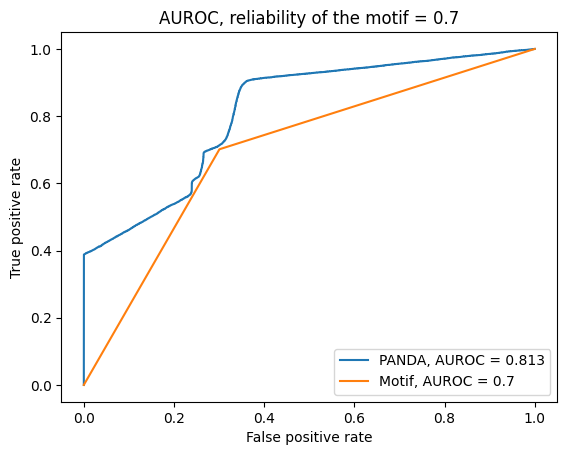

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 176
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5797791219547669
step: 1, hamming: 0.5513153085602409
step: 2, hamming: 0.6800960097306633
step: 3, hamming: 0.7543084131809941
step: 4, hamming: 0.8033371699335536
step: 5, hamming: 0.8333366400310603
step: 6, hamming: 0.8471299705039717
step: 7, hamming: 0.8472059829548798
step: 8, hamming: 0.8359854392680639
step: 9, hamming: 0.8156719512212403
step: 10, hamming: 0.7881610930092644
step: 11, hamming: 0.7550435861021273
step: 12, hamming: 0.7176550464036031
step: 13, hamming: 0.6771320438087781
step: 14, hamming: 0.6344562743747689
step: 15, hamming: 0.5904841908578302
step: 16, hamming: 0.5459659822399245
st

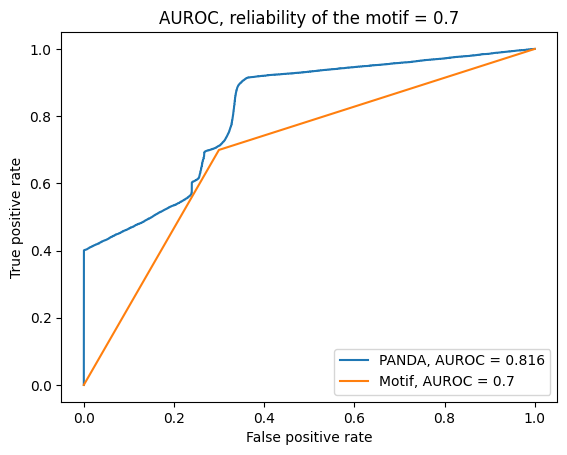

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 200
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5895277472249131
step: 1, hamming: 0.5680233787297793
step: 2, hamming: 0.6987927154997696
step: 3, hamming: 0.7747510642153823
step: 4, hamming: 0.8254154511608807
step: 5, hamming: 0.8570700356973278
step: 6, hamming: 0.8726222396046179
step: 7, hamming: 0.8746663723424734
step: 8, hamming: 0.8657138108232642
step: 9, hamming: 0.8479869467041642
step: 10, hamming: 0.8233247554466858
step: 11, hamming: 0.7932107494789914
step: 12, hamming: 0.7588455415318196
step: 13, hamming: 0.7212177347321486
step: 14, hamming: 0.681159778651237
step: 15, hamming: 0.6393893860527388
step: 16, hamming: 0.5965396932667304
ste

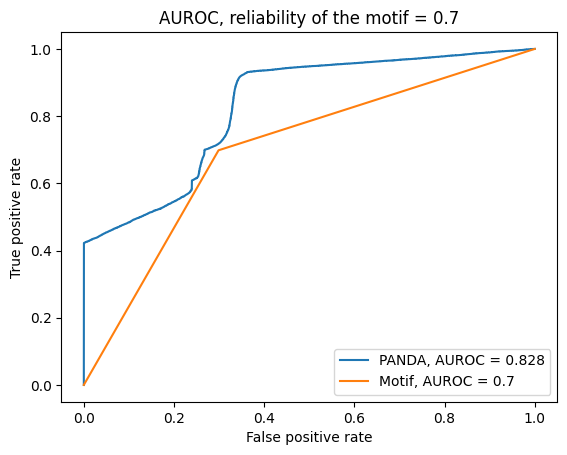

0.4
Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 160
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5798947812882105
step: 1, hamming: 0.5498591479423622
step: 2, hamming: 0.6803172604909099
step: 3, hamming: 0.7557178123328765
step: 4, hamming: 0.8057433250305289
step: 5, hamming: 0.8366549701518081
step: 6, hamming: 0.8512368443613288
step: 7, hamming: 0.8519174925281918
step: 8, hamming: 0.8411082237487387
step: 9, hamming: 0.8210359361295779
step: 10, hamming: 0.7936264935622183
step: 11, hamming: 0.7604963312557594
step: 12, hamming: 0.7229983706210779
step: 13, hamming: 0.6822788791695308
step: 14, hamming: 0.6393256033135629
step: 15, hamming: 0.5950022589884169
step: 16, hamming: 0.550071007922775

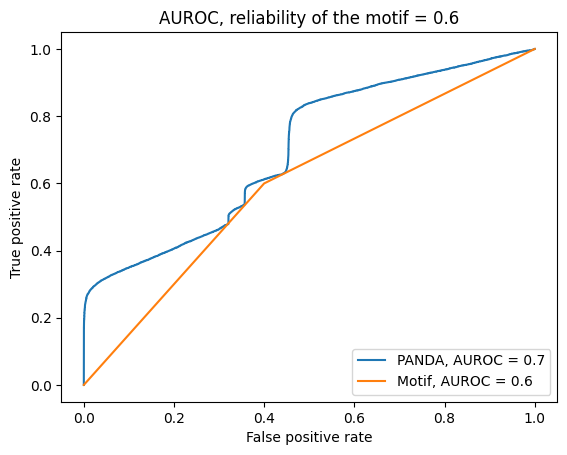

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 182
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5850597354289907
step: 1, hamming: 0.5534096142177002
step: 2, hamming: 0.683032254836938
step: 3, hamming: 0.7584601870481061
step: 4, hamming: 0.8088759227345407
step: 5, hamming: 0.8404840290037418
step: 6, hamming: 0.8560912555723261
step: 7, hamming: 0.8581672185636763
step: 8, hamming: 0.8491663684596588
step: 9, hamming: 0.8313296686282526
step: 10, hamming: 0.8065505350600546
step: 11, hamming: 0.7763704760397865
step: 12, hamming: 0.7420378532666192
step: 13, hamming: 0.7045755284761533
step: 14, hamming: 0.6648365376346193
step: 15, hamming: 0.6235459531327565
step: 16, hamming: 0.5813321743732758
ste

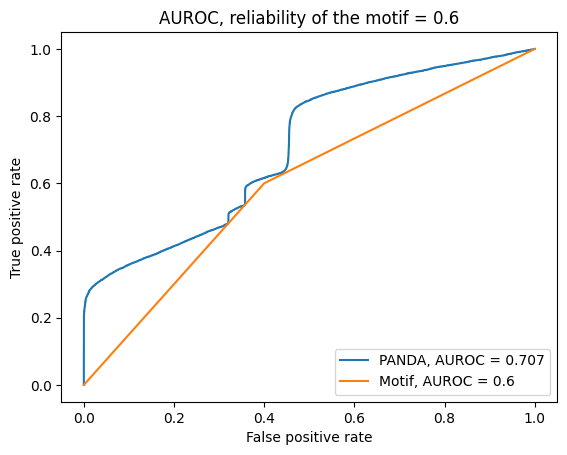

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 198
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5930756519246472
step: 1, hamming: 0.5702206383130158
step: 2, hamming: 0.7048415806718399
step: 3, hamming: 0.7839765953792449
step: 4, hamming: 0.837656756765317
step: 5, hamming: 0.8723507186732042
step: 6, hamming: 0.8910103368829957
step: 7, hamming: 0.89619776034568
step: 8, hamming: 0.8904019205229676
step: 9, hamming: 0.8758450055545424
step: 10, hamming: 0.8543596053587519
step: 11, hamming: 0.8274017035138765
step: 12, hamming: 0.7961251512884636
step: 13, hamming: 0.7614591699208473
step: 14, hamming: 0.7241691751111635
step: 15, hamming: 0.6849010617074407
step: 16, hamming: 0.6442138098975065
step:

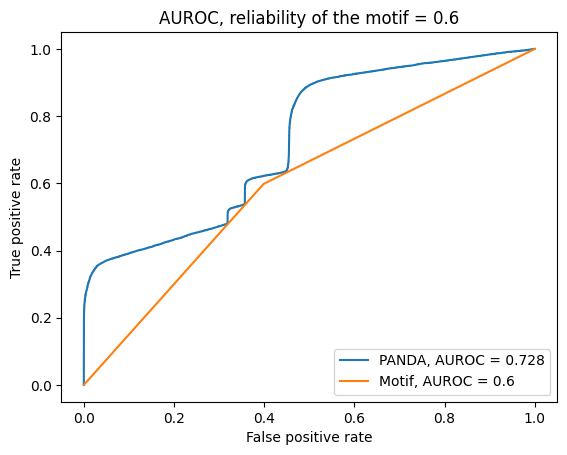

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 182
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.590996385147314
step: 1, hamming: 0.5611101749043057
step: 2, hamming: 0.6915716563287619
step: 3, hamming: 0.766651712846794
step: 4, hamming: 0.8160253440128761
step: 5, hamming: 0.8460561630290536
step: 6, hamming: 0.8597525156356187
step: 7, hamming: 0.859726690256538
step: 8, hamming: 0.8484995941629331
step: 9, hamming: 0.8283678963942511
step: 10, hamming: 0.8013037195365066
step: 11, hamming: 0.768935234790724
step: 12, hamming: 0.7325808198991868
step: 13, hamming: 0.6933071619419717
step: 14, hamming: 0.651989766229114
step: 15, hamming: 0.6093643018058085
step: 16, hamming: 0.5660652332833396
step: 1

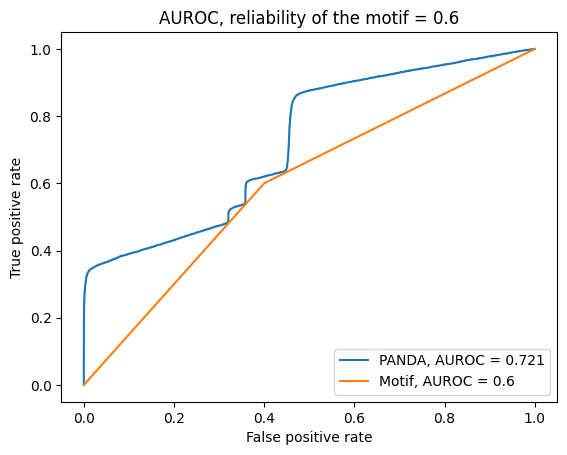

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5934117911698445
step: 1, hamming: 0.5699558126079018
step: 2, hamming: 0.7041065373623742
step: 3, hamming: 0.7831138820916311
step: 4, hamming: 0.8368441918322304
step: 5, hamming: 0.8715460076394416
step: 6, hamming: 0.8900294418735197
step: 7, hamming: 0.8947788527887882
step: 8, hamming: 0.8882237139101813
step: 9, hamming: 0.8725238248234212
step: 10, hamming: 0.8494676930317302
step: 11, hamming: 0.8205091920064884
step: 12, hamming: 0.7868507302980615
step: 13, hamming: 0.749515680958449
step: 14, hamming: 0.7093962852497406
step: 15, hamming: 0.6672821439298556
step: 16, hamming: 0.6238772320580754
ste

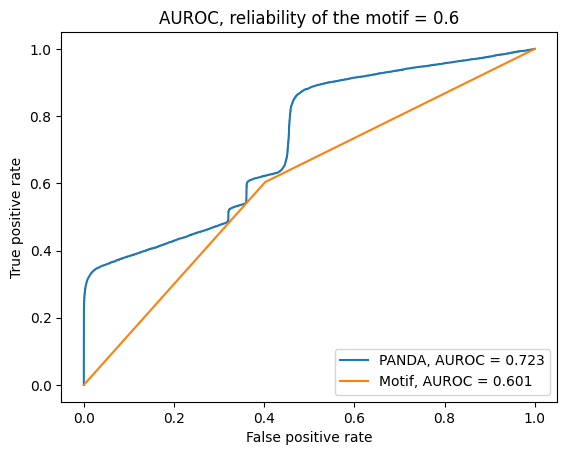

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 186
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5896541307989159
step: 1, hamming: 0.564683182852665
step: 2, hamming: 0.6962501757521014
step: 3, hamming: 0.7730275840157428
step: 4, hamming: 0.824382511721793
step: 5, hamming: 0.8565095924772735
step: 6, hamming: 0.8722959651769434
step: 7, hamming: 0.8742754050354402
step: 8, hamming: 0.8649082612378451
step: 9, hamming: 0.8464155581144989
step: 10, hamming: 0.820687197437596
step: 11, hamming: 0.789290963805283
step: 12, hamming: 0.7535261602504434
step: 13, hamming: 0.7144820385969415
step: 14, hamming: 0.6730860222311271
step: 15, hamming: 0.6301390746896509
step: 16, hamming: 0.5863400690639384
step: 

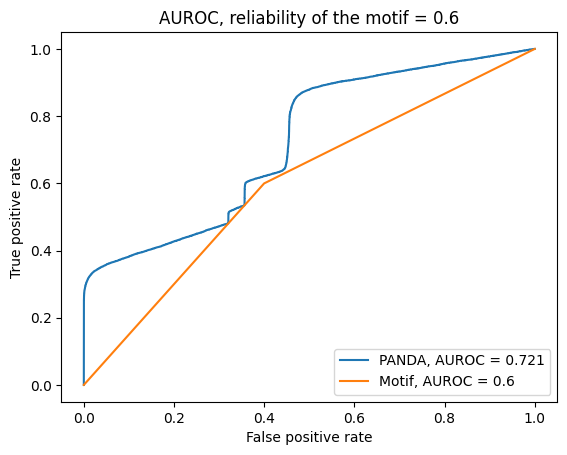

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 210
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5915833149243559
step: 1, hamming: 0.5584766915406912
step: 2, hamming: 0.6970193196106458
step: 3, hamming: 0.7792552181743893
step: 4, hamming: 0.8363413625426159
step: 5, hamming: 0.8748223898947662
step: 6, hamming: 0.8976528517425811
step: 7, hamming: 0.9073447159496435
step: 8, hamming: 0.9062892982344458
step: 9, hamming: 0.8966045824259894
step: 10, hamming: 0.8800363632022337
step: 11, hamming: 0.8579658122173814
step: 12, hamming: 0.8314703884820147
step: 13, hamming: 0.8013948017904929
step: 14, hamming: 0.7684134906677669
step: 15, hamming: 0.7330805281902252
step: 16, hamming: 0.6958681504475956
st

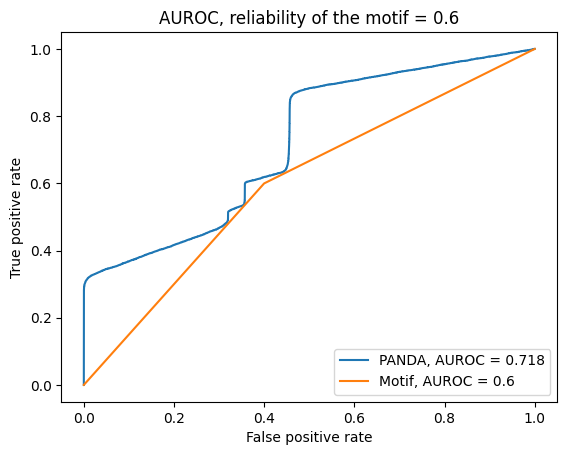

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 210
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5986063383775077
step: 1, hamming: 0.5774341584234737
step: 2, hamming: 0.7111388685630612
step: 3, hamming: 0.7892348437434923
step: 4, hamming: 0.8415799781685048
step: 5, hamming: 0.87450461916861
step: 6, hamming: 0.890854161685997
step: 7, hamming: 0.8931379254240904
step: 8, hamming: 0.8837534745752368
step: 9, hamming: 0.864788200611907
step: 10, hamming: 0.8379422169500684
step: 11, hamming: 0.8045779358183907
step: 12, hamming: 0.765824413702795
step: 13, hamming: 0.7226818717920908
step: 14, hamming: 0.6760996586230028
step: 15, hamming: 0.6270218502267222
step: 16, hamming: 0.5764039067432484
step: 1

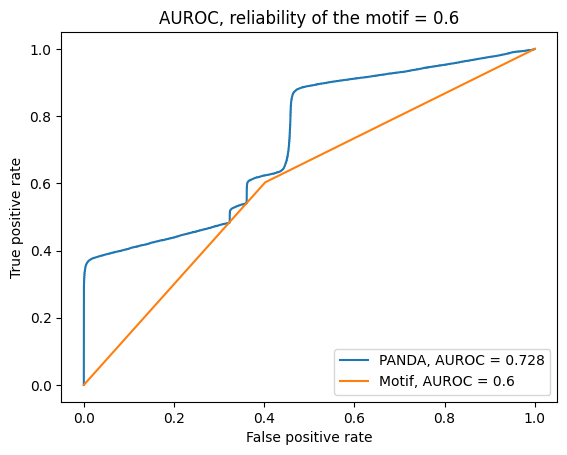

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 154
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5824343164532733
step: 1, hamming: 0.542313913567516
step: 2, hamming: 0.6720066001874907
step: 3, hamming: 0.7469491838073534
step: 4, hamming: 0.7969627296129866
step: 5, hamming: 0.8282791076581956
step: 6, hamming: 0.8436708520843236
step: 7, hamming: 0.8455694026379393
step: 8, hamming: 0.8363913153468949
step: 9, hamming: 0.818356254062285
step: 10, hamming: 0.7933590372972914
step: 11, hamming: 0.7629590147366607
step: 12, hamming: 0.7284288818485085
step: 13, hamming: 0.6908152709294794
step: 14, hamming: 0.6509914845914134
step: 15, hamming: 0.6096987191286679
step: 16, hamming: 0.567577337531185
step:

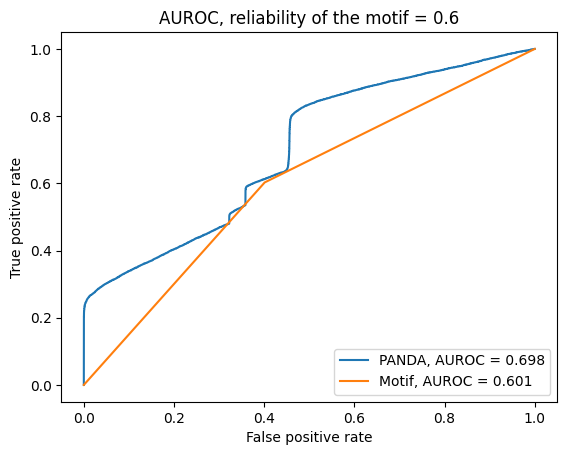

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 158
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5832334345301248
step: 1, hamming: 0.5472299245781491
step: 2, hamming: 0.676172992875637
step: 3, hamming: 0.750225739960085
step: 4, hamming: 0.7989620309106091
step: 5, hamming: 0.8286490298807138
step: 6, hamming: 0.842133841154542
step: 7, hamming: 0.8419131424622477
step: 8, hamming: 0.8304460208902418
step: 9, hamming: 0.8099918268798322
step: 10, hamming: 0.7824971115371102
step: 11, hamming: 0.7495837908199048
step: 12, hamming: 0.7125914429083782
step: 13, hamming: 0.6726339326542894
step: 14, hamming: 0.6306507337020498
step: 15, hamming: 0.5874466588793733
step: 16, hamming: 0.5437201934497904
step:

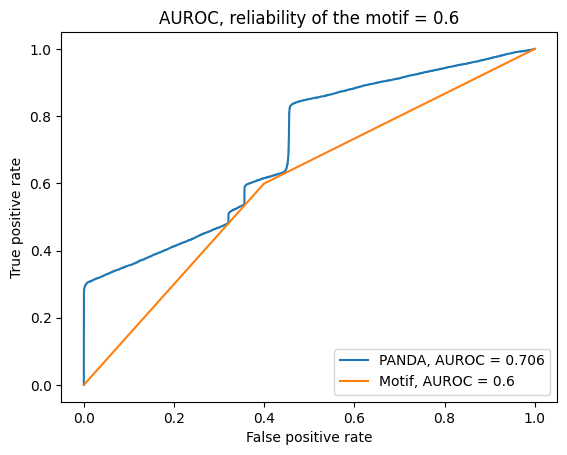

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 202
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.602310407490949
step: 1, hamming: 0.5689489386086054
step: 2, hamming: 0.7008238725747361
step: 3, hamming: 0.777528292645805
step: 4, hamming: 0.828655406617339
step: 5, hamming: 0.8605898214549076
step: 6, hamming: 0.8762973512523602
step: 7, hamming: 0.8783913183161377
step: 8, hamming: 0.8694011977290943
step: 9, hamming: 0.8515871423137653
step: 10, hamming: 0.8268350418926091
step: 11, hamming: 0.7966668697792765
step: 12, hamming: 0.7623049560556721
step: 13, hamming: 0.724744197094668
step: 14, hamming: 0.6848125936398113
step: 15, hamming: 0.6432166562685787
step: 16, hamming: 0.6005741303104631
step: 

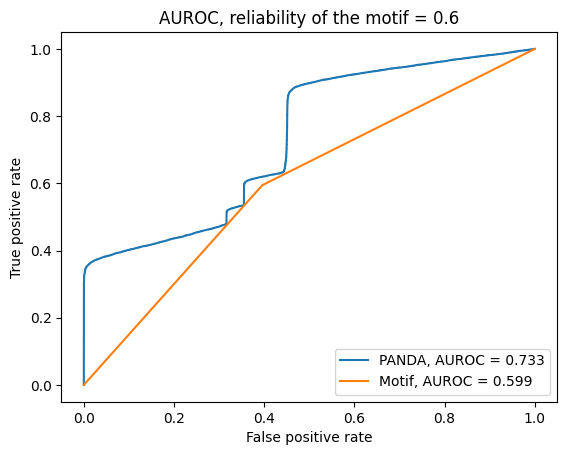

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 202
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5993536838847877
step: 1, hamming: 0.5663046715872809
step: 2, hamming: 0.693963707025407
step: 3, hamming: 0.7674542736283562
step: 4, hamming: 0.8154387029362613
step: 5, hamming: 0.8440648744703187
step: 6, hamming: 0.8562644380085555
step: 7, hamming: 0.8546289634190732
step: 8, hamming: 0.8417035422009426
step: 9, hamming: 0.8198253765173562
step: 10, hamming: 0.7910071983194799
step: 11, hamming: 0.7569193311188648
step: 12, hamming: 0.7189292957084126
step: 13, hamming: 0.6781596189957732
step: 14, hamming: 0.6355418337692115
step: 15, hamming: 0.5918597695136641
step: 16, hamming: 0.5477824497261077
ste

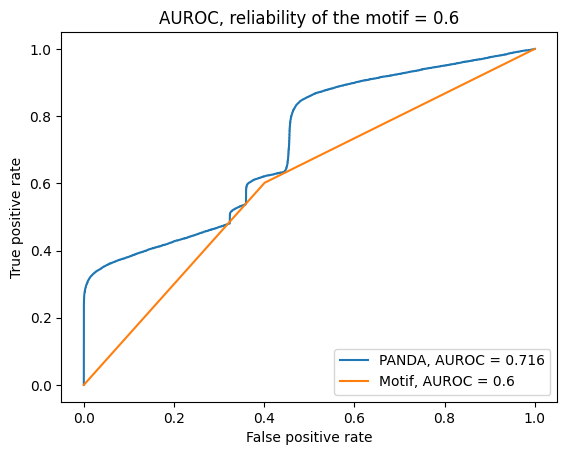

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 200
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6079794433491986
step: 1, hamming: 0.5860927136513768
step: 2, hamming: 0.7215464599559399
step: 3, hamming: 0.8029093279826041
step: 4, hamming: 0.8592684649296845
step: 5, hamming: 0.8968333718506716
step: 6, hamming: 0.9185811304444849
step: 7, hamming: 0.92717709691738
step: 8, hamming: 0.9251188339993905
step: 9, hamming: 0.914537758903751
step: 10, hamming: 0.8971449069133391
step: 11, hamming: 0.8742852022916281
step: 12, hamming: 0.8470184006007255
step: 13, hamming: 0.8161905034052012
step: 14, hamming: 0.7824887582068909
step: 15, hamming: 0.7464831056019086
step: 16, hamming: 0.7086581545101257
step:

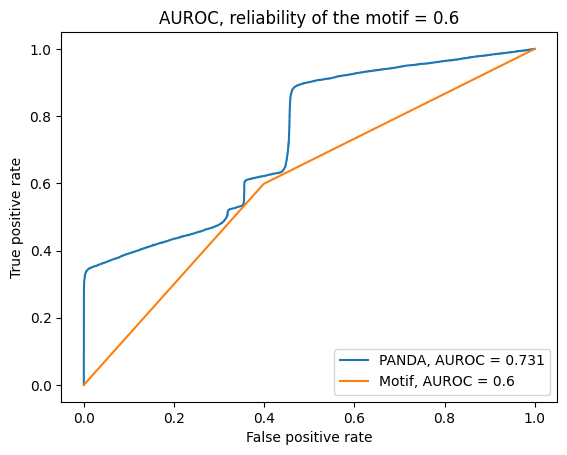

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 196
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5979889224113548
step: 1, hamming: 0.5651495134961035
step: 2, hamming: 0.6967422582278271
step: 3, hamming: 0.7735223994596611
step: 4, hamming: 0.8247125084605946
step: 5, hamming: 0.85659264048578
step: 6, hamming: 0.8720767737434761
step: 7, hamming: 0.8736918643987794
step: 8, hamming: 0.863892871789685
step: 9, hamming: 0.8449325588861697
step: 10, hamming: 0.8187546753702941
step: 11, hamming: 0.7869759833989332
step: 12, hamming: 0.750925347359556
step: 13, hamming: 0.7116999551654742
step: 14, hamming: 0.6702170556201928
step: 15, hamming: 0.6272552338925328
step: 16, hamming: 0.5834859207361291
step: 

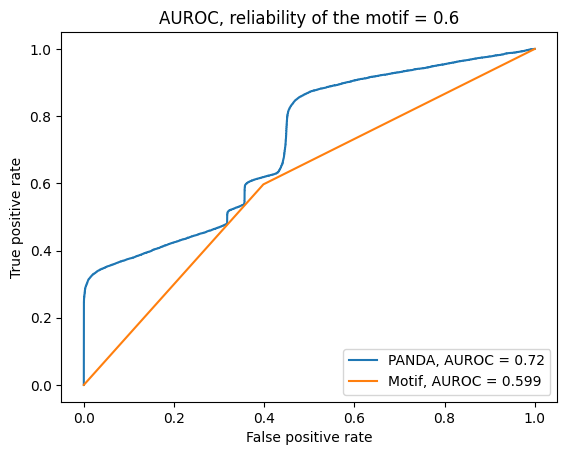

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5916668804387247
step: 1, hamming: 0.5645163948152879
step: 2, hamming: 0.6949860958595169
step: 3, hamming: 0.7700591697408363
step: 4, hamming: 0.8194014641665012
step: 5, hamming: 0.8492854432207295
step: 6, hamming: 0.8625540012377889
step: 7, hamming: 0.861698276893312
step: 8, hamming: 0.8491824107601053
step: 9, hamming: 0.8272609193246776
step: 10, hamming: 0.7978586538020754
step: 11, hamming: 0.7625709252162145
step: 12, hamming: 0.7227352818089162
step: 13, hamming: 0.6795036084269989
step: 14, hamming: 0.6338969916765378
step: 15, hamming: 0.5868416186528105
step: 16, hamming: 0.5391873871038989
ste

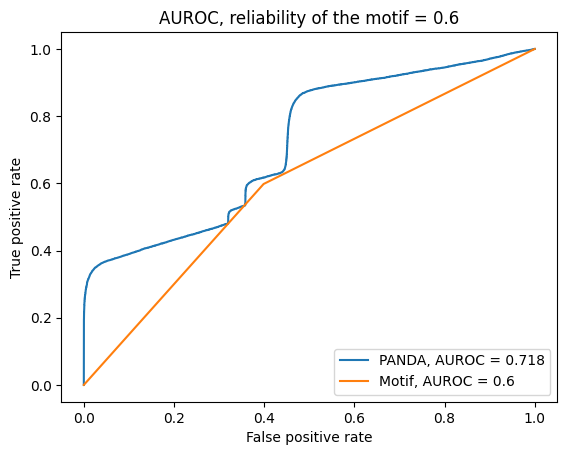

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 172
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.593245365974704
step: 1, hamming: 0.5796438228923081
step: 2, hamming: 0.7177990234215014
step: 3, hamming: 0.8008573841430701
step: 4, hamming: 0.8589007146445298
step: 5, hamming: 0.8983412096108679
step: 6, hamming: 0.9222140110340469
step: 7, hamming: 0.933168018197266
step: 8, hamming: 0.9336786470574192
step: 9, hamming: 0.925873638271828
step: 10, hamming: 0.9114611067329651
step: 11, hamming: 0.8917652138658642
step: 12, hamming: 0.8678006364407744
step: 13, hamming: 0.8403467545075948
step: 14, hamming: 0.8100098083604443
step: 15, hamming: 0.7772724187379582
step: 16, hamming: 0.7425326711004814
step:

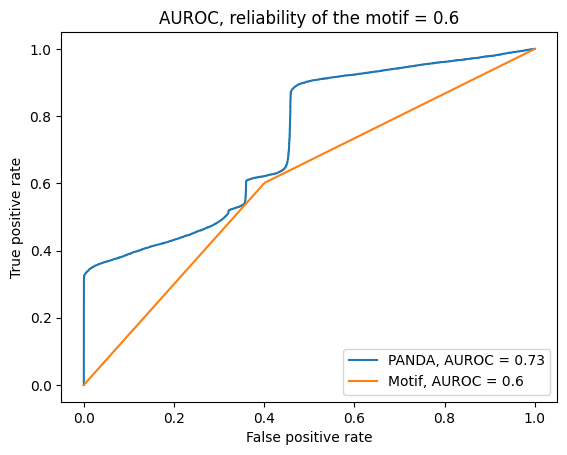

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 180
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5905103764003835
step: 1, hamming: 0.5669079203464491
step: 2, hamming: 0.69870853692079
step: 3, hamming: 0.7754005385251531
step: 4, hamming: 0.8267178346984237
step: 5, hamming: 0.8589727324662468
step: 6, hamming: 0.8750800310172073
step: 7, hamming: 0.877607337979823
step: 8, hamming: 0.8690612700444228
step: 9, hamming: 0.8516946430360292
step: 10, hamming: 0.8273851413092199
step: 11, hamming: 0.7976409442882471
step: 12, hamming: 0.7636690440950236
step: 13, hamming: 0.7264515529594904
step: 14, hamming: 0.6868078780435036
step: 15, hamming: 0.6454401462727021
step: 16, hamming: 0.602965286670446
step: 

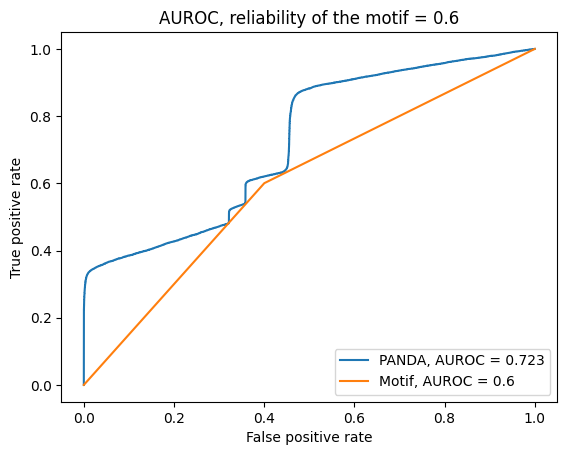

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 218
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6032408245604205
step: 1, hamming: 0.5749340527183663
step: 2, hamming: 0.7051546461249774
step: 3, hamming: 0.780237624790454
step: 4, hamming: 0.8292036369374332
step: 5, hamming: 0.8583692081632859
step: 6, hamming: 0.8707634277069354
step: 7, hamming: 0.8690462016968903
step: 8, hamming: 0.8557830775312322
step: 9, hamming: 0.8333160638468501
step: 10, hamming: 0.8036748023845601
step: 11, hamming: 0.7685631384306144
step: 12, hamming: 0.7293944033721443
step: 13, hamming: 0.6873438148460055
step: 14, hamming: 0.6433970835769591
step: 15, hamming: 0.5983890768149195
step: 16, hamming: 0.553033468392162
step

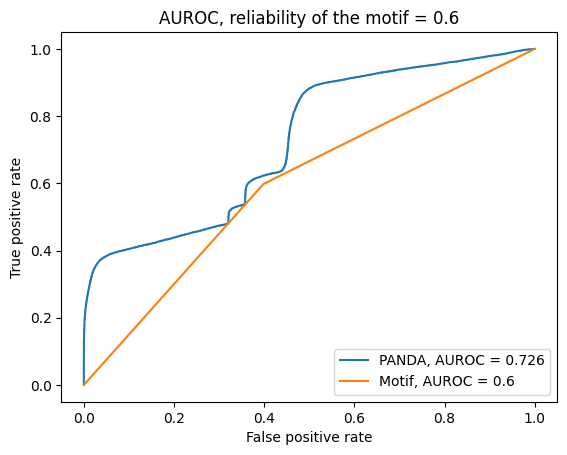

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 206
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5950225052346817
step: 1, hamming: 0.5771382756782611
step: 2, hamming: 0.7160750903424192
step: 3, hamming: 0.7990755354580276
step: 4, hamming: 0.8566282390161316
step: 5, hamming: 0.8952391933366701
step: 6, hamming: 0.9179056172887003
step: 7, hamming: 0.9272058122118578
step: 8, hamming: 0.9255672762135088
step: 9, hamming: 0.9151096776867125
step: 10, hamming: 0.8975717914748876
step: 11, hamming: 0.8743417387174782
step: 12, hamming: 0.8465271013976304
step: 13, hamming: 0.8150235683209026
step: 14, hamming: 0.7805679389645591
step: 15, hamming: 0.7437761624511346
step: 16, hamming: 0.705171798409066
ste

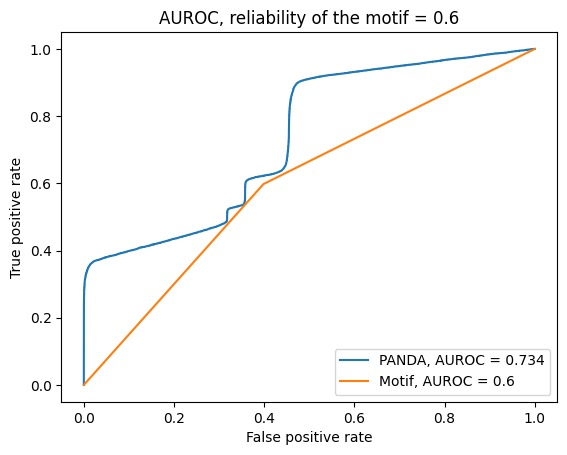

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 198
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5992391422531748
step: 1, hamming: 0.567486540104059
step: 2, hamming: 0.6986053574805184
step: 3, hamming: 0.7755846412541214
step: 4, hamming: 0.8274467281776868
step: 5, hamming: 0.8605140406849958
step: 6, hamming: 0.8776981653266261
step: 7, hamming: 0.8815213054178211
step: 8, hamming: 0.8744510211350265
step: 9, hamming: 0.8587213912371453
step: 10, hamming: 0.836197712726292
step: 11, hamming: 0.8083691816736032
step: 12, hamming: 0.7764109702191281
step: 13, hamming: 0.7412592813566921
step: 14, hamming: 0.7036756216360863
step: 15, hamming: 0.6642963412991454
step: 16, hamming: 0.6236696970855535
step

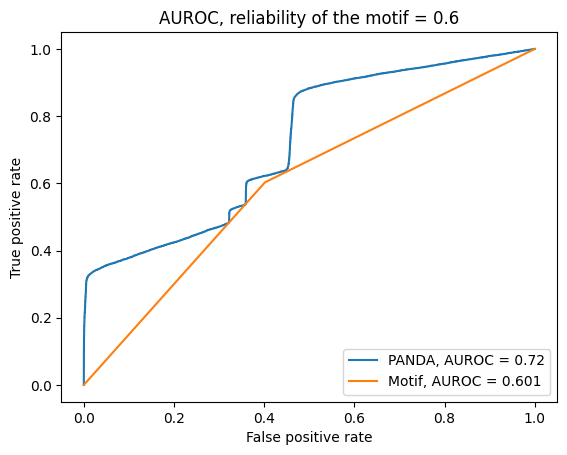

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 170
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5853795126099436
step: 1, hamming: 0.5643268280164211
step: 2, hamming: 0.6984507797277588
step: 3, hamming: 0.7773420831966076
step: 4, hamming: 0.8310097108537329
step: 5, hamming: 0.8658007557953671
step: 6, hamming: 0.88463241687463
step: 7, hamming: 0.8900220650731074
step: 8, hamming: 0.8844017762782569
step: 9, hamming: 0.8699592968597379
step: 10, hamming: 0.8485248332361028
step: 11, hamming: 0.8215679004220048
step: 12, hamming: 0.790254510617861
step: 13, hamming: 0.7555182515619838
step: 14, hamming: 0.7181235881179929
step: 15, hamming: 0.6787157629316587
step: 16, hamming: 0.637858016833239
step: 

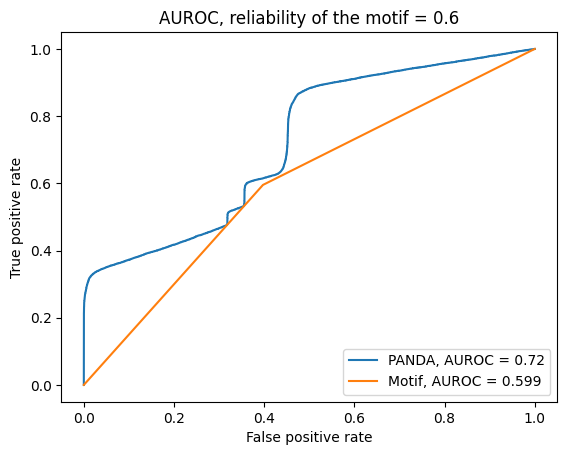

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 198
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5968640759079615
step: 1, hamming: 0.5787443926018732
step: 2, hamming: 0.7133097890740625
step: 3, hamming: 0.7923962633378143
step: 4, hamming: 0.8459036085631981
step: 5, hamming: 0.8800922436010722
step: 6, hamming: 0.8979456972437254
step: 7, hamming: 0.9020954704097136
step: 8, hamming: 0.8950351487561908
step: 9, hamming: 0.8789656543824643
step: 10, hamming: 0.8557301171620417
step: 11, hamming: 0.8268373936552991
step: 12, hamming: 0.7935217010408122
step: 13, hamming: 0.7568031384926304
step: 14, hamming: 0.7175360737473939
step: 15, hamming: 0.6764449589822137
step: 16, hamming: 0.6341513233772346
st

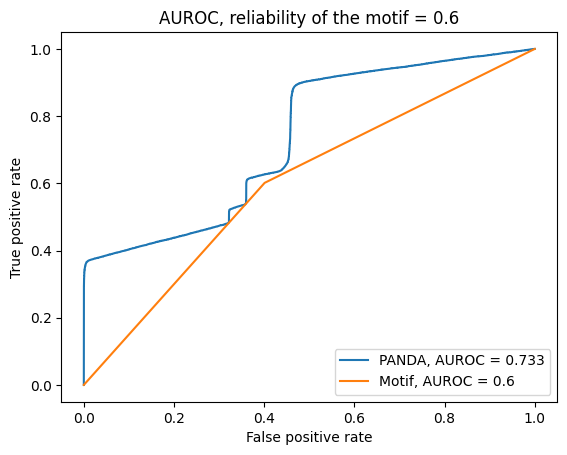

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 162
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5957437137332018
step: 1, hamming: 0.5644360859138615
step: 2, hamming: 0.6984994093712932
step: 3, hamming: 0.7772696368480047
step: 4, hamming: 0.8308282855527678
step: 5, hamming: 0.865541799649593
step: 6, hamming: 0.8843106170333603
step: 7, hamming: 0.8896641482430188
step: 8, hamming: 0.8840637470684417
step: 9, hamming: 0.8697170146767876
step: 10, hamming: 0.8484551607944302
step: 11, hamming: 0.8217342871345571
step: 12, hamming: 0.7907004180098343
step: 13, hamming: 0.7562663674939527
step: 14, hamming: 0.7191779867904051
step: 15, hamming: 0.6800651168154114
step: 16, hamming: 0.639478915909976
step

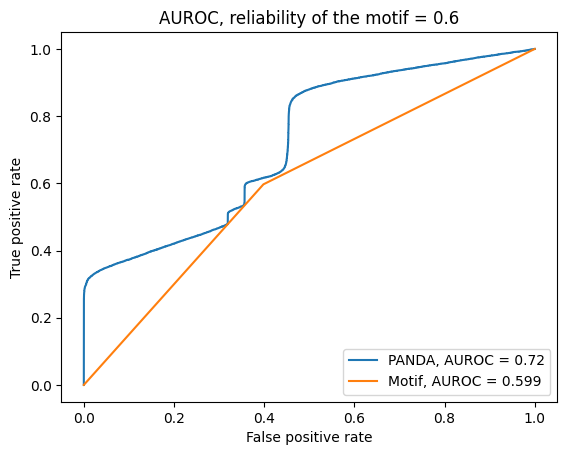

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 182
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5962888120124814
step: 1, hamming: 0.562950736122888
step: 2, hamming: 0.6892969196606321
step: 3, hamming: 0.7612391743078604
step: 4, hamming: 0.8075929743008152
step: 5, hamming: 0.8345966098353285
step: 6, hamming: 0.8451814448536089
step: 7, hamming: 0.841958419485319
step: 8, hamming: 0.8275136190136717
step: 9, hamming: 0.8042229079304432
step: 10, hamming: 0.774126912346994
step: 11, hamming: 0.7389168684524757
step: 12, hamming: 0.6999772657895813
step: 13, hamming: 0.6584434796306743
step: 14, hamming: 0.6152558442213534
step: 15, hamming: 0.571204309360323
step: 16, hamming: 0.5269625565888497
step: 

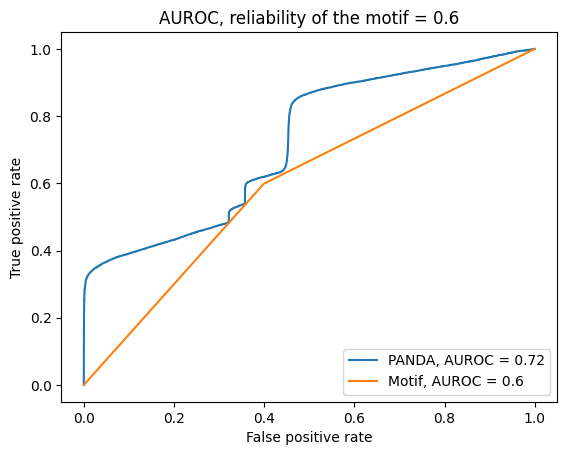

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 256
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6012529206272967
step: 1, hamming: 0.5876063319634968
step: 2, hamming: 0.7280090741661706
step: 3, hamming: 0.8128710697799741
step: 4, hamming: 0.8724944484188365
step: 5, hamming: 0.9134382562971469
step: 6, hamming: 0.938828827719432
step: 7, hamming: 0.951364666563637
step: 8, hamming: 0.9535481292537482
step: 9, hamming: 0.947525037123948
step: 10, hamming: 0.9350133236492031
step: 11, hamming: 0.9173336768360203
step: 12, hamming: 0.8954831646197454
step: 13, hamming: 0.8702124733194377
step: 14, hamming: 0.8420916476760082
step: 15, hamming: 0.8115621893524997
step: 16, hamming: 0.7789776414348009
step:

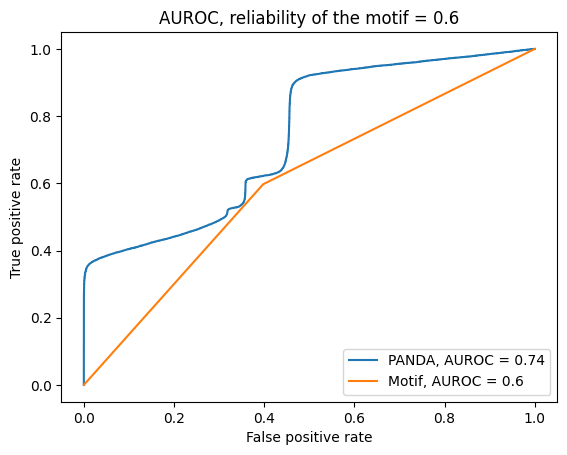

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5922939335601544
step: 1, hamming: 0.5700388584916305
step: 2, hamming: 0.7086109087352743
step: 3, hamming: 0.790752521843676
step: 4, hamming: 0.8473158690663136
step: 5, hamming: 0.8847388473862385
step: 6, hamming: 0.9059899531131521
step: 7, hamming: 0.9136067425748003
step: 8, hamming: 0.9099819898497388
step: 9, hamming: 0.8972345990407177
step: 10, hamming: 0.8771449077293799
step: 11, hamming: 0.8511761555793564
step: 12, hamming: 0.8205286830916871
step: 13, hamming: 0.7861934232182066
step: 14, hamming: 0.7489953594472307
step: 15, hamming: 0.7096285179542731
step: 16, hamming: 0.6686856136311381
ste

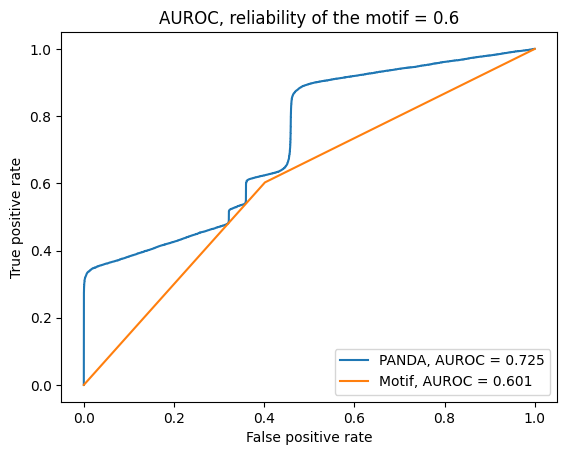

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 170
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5899463711388955
step: 1, hamming: 0.5604752129203814
step: 2, hamming: 0.6978971889174147
step: 3, hamming: 0.7790539624343008
step: 4, hamming: 0.8350135278015755
step: 5, hamming: 0.8722655021915526
step: 6, hamming: 0.8937696507451673
step: 7, hamming: 0.9020533133695404
step: 8, hamming: 0.8995177052751628
step: 9, hamming: 0.8882934801540864
step: 10, hamming: 0.8701498511500202
step: 11, hamming: 0.8465006671678642
step: 12, hamming: 0.8184589979610117
step: 13, hamming: 0.7869028236825388
step: 14, hamming: 0.7525353590348984
step: 15, hamming: 0.7159351920846159
step: 16, hamming: 0.6775960357313889
st

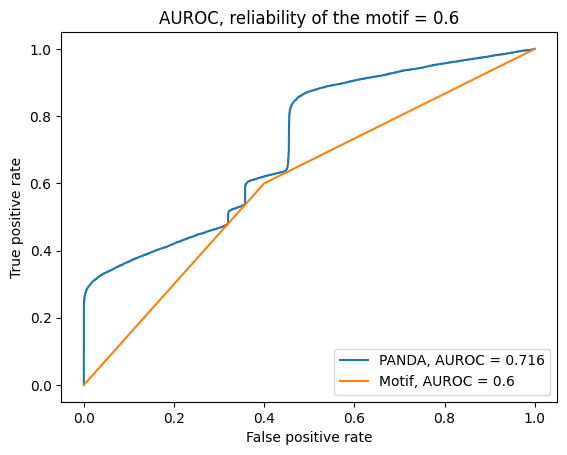

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 190
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5976913663240926
step: 1, hamming: 0.5908991077608632
step: 2, hamming: 0.7345759567674344
step: 3, hamming: 0.821883349808598
step: 4, hamming: 0.8841243540935028
step: 5, hamming: 0.9279597591192041
step: 6, hamming: 0.9565600084065032
step: 7, hamming: 0.9726539206890289
step: 8, hamming: 0.9787463377916481
step: 9, hamming: 0.9769489620529039
step: 10, hamming: 0.9689193557688462
step: 11, hamming: 0.9559083633685568
step: 12, hamming: 0.9388444789103519
step: 13, hamming: 0.9184146552675995
step: 14, hamming: 0.8951296903779685
step: 15, hamming: 0.8693744860964563
step: 16, hamming: 0.8414464426459697
ste

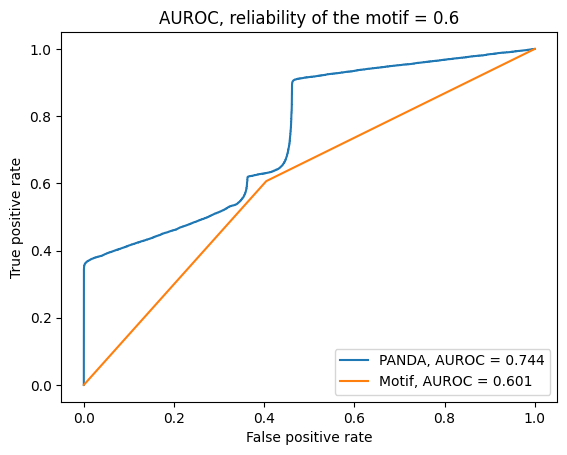

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 198
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5949005918195809
step: 1, hamming: 0.5702307710513693
step: 2, hamming: 0.7059418310951717
step: 3, hamming: 0.7856026908155129
step: 4, hamming: 0.8395787644059154
step: 5, hamming: 0.8744211860375457
step: 6, hamming: 0.8931429393085601
step: 7, hamming: 0.898350152473252
step: 8, hamming: 0.8925468386836328
step: 9, hamming: 0.8779672869240124
step: 10, hamming: 0.8564673301814149
step: 11, hamming: 0.8295264071816538
step: 12, hamming: 0.7983080379823466
step: 13, hamming: 0.7637338396148019
step: 14, hamming: 0.7265497715065514
step: 15, hamming: 0.6873786881988374
step: 16, hamming: 0.6467597844932043
ste

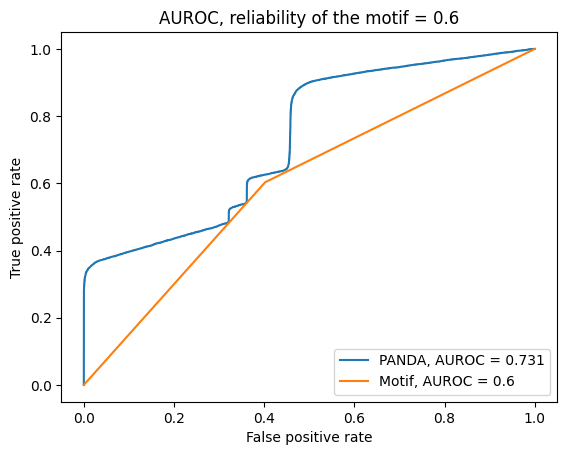

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 202
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5924271768432353
step: 1, hamming: 0.5678176045070745
step: 2, hamming: 0.7027199387726848
step: 3, hamming: 0.7821939622322843
step: 4, hamming: 0.836328366341
step: 5, hamming: 0.8715363260312216
step: 6, hamming: 0.8907474279121324
step: 7, hamming: 0.8965263698225122
step: 8, hamming: 0.8913566477908831
step: 9, hamming: 0.8774499889947529
step: 10, hamming: 0.8566365130292081
step: 11, hamming: 0.830375103732858
step: 12, hamming: 0.7998167118674199
step: 13, hamming: 0.7658755037181814
step: 14, hamming: 0.7292913797290385
step: 15, hamming: 0.6906803216766286
step: 16, hamming: 0.6505732399352346
step: 1

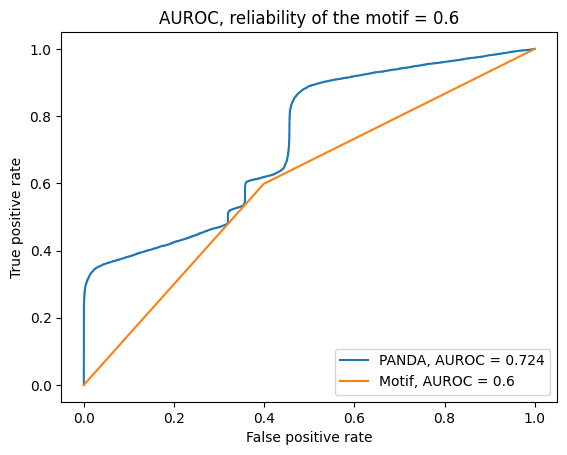

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 218
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5962356527654339
step: 1, hamming: 0.5808251796651575
step: 2, hamming: 0.7203709397539039
step: 3, hamming: 0.8032964628127942
step: 4, hamming: 0.8604804301526717
step: 5, hamming: 0.898463903798371
step: 6, hamming: 0.9202867350305198
step: 7, hamming: 0.92855650715753
step: 8, hamming: 0.925711484777875
step: 9, hamming: 0.9138762343499037
step: 10, hamming: 0.894798119914798
step: 11, hamming: 0.8698780139087762
step: 12, hamming: 0.8402396434722896
step: 13, hamming: 0.8068011350989271
step: 14, hamming: 0.7703337059733968
step: 15, hamming: 0.7315040449581661
step: 16, hamming: 0.6909023169115776
step: 1

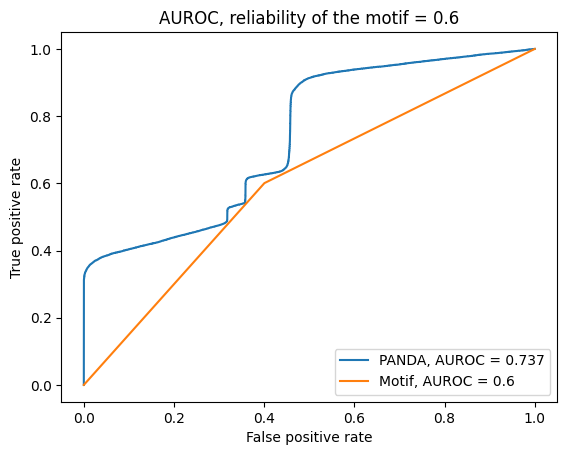

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 164
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5906015485593961
step: 1, hamming: 0.5625785884571765
step: 2, hamming: 0.6968526152745234
step: 3, hamming: 0.7761115765377994
step: 4, hamming: 0.8303578063983753
step: 5, hamming: 0.865928464046694
step: 6, hamming: 0.8857222537650448
step: 7, hamming: 0.8922733340444211
step: 8, hamming: 0.8880189054108182
step: 9, hamming: 0.87511701295374
step: 10, hamming: 0.8553473612703433
step: 11, hamming: 0.8301249554887634
step: 12, hamming: 0.8005640751421503
step: 13, hamming: 0.7675502641387171
step: 14, hamming: 0.7318031618089046
step: 15, hamming: 0.6939261784471863
step: 16, hamming: 0.654443976360754
step: 

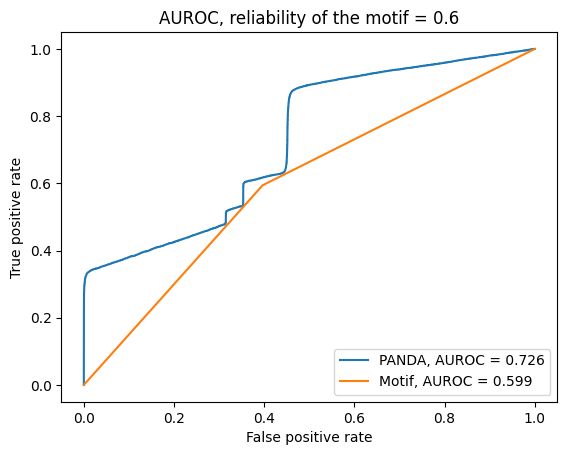

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 258
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5975057461688786
step: 1, hamming: 0.5690597093153481
step: 2, hamming: 0.704824631637902
step: 3, hamming: 0.7844043638216947
step: 4, hamming: 0.8383140989397166
step: 5, hamming: 0.8731179422143794
step: 6, hamming: 0.8918112566396643
step: 7, hamming: 0.8970285936747365
step: 8, hamming: 0.8913056073005878
step: 9, hamming: 0.8768736943008917
step: 10, hamming: 0.8555597655929703
step: 11, hamming: 0.8288113248135518
step: 12, hamming: 0.7977707878757713
step: 13, hamming: 0.7633511310298076
step: 14, hamming: 0.7262976873665438
step: 15, hamming: 0.6872358287801327
step: 16, hamming: 0.6467074255442978
ste

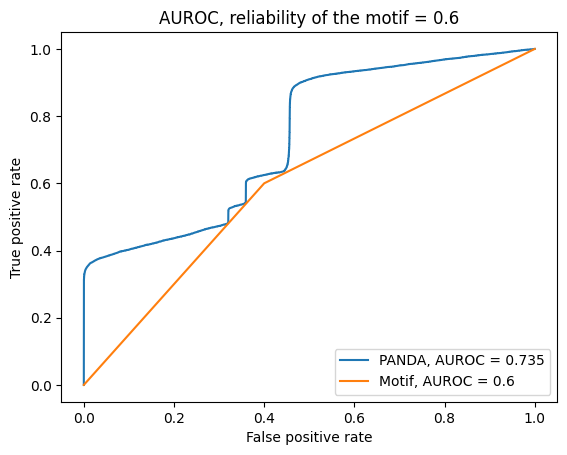

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 204
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5885390363003572
step: 1, hamming: 0.5644123163647244
step: 2, hamming: 0.6953661097959322
step: 3, hamming: 0.7714096934043836
step: 4, hamming: 0.8219402760122154
step: 5, hamming: 0.8533512826797893
step: 6, hamming: 0.8685605549563096
step: 7, hamming: 0.8701126847179218
step: 8, hamming: 0.8605069086728359
step: 9, hamming: 0.8420119591813976
step: 10, hamming: 0.816537139340164
step: 11, hamming: 0.7856296730406518
step: 12, hamming: 0.7505381014218542
step: 13, hamming: 0.7122868063694957
step: 14, hamming: 0.6717367676978049
step: 15, hamming: 0.6296282620662099
step: 16, hamming: 0.586609432588634
step

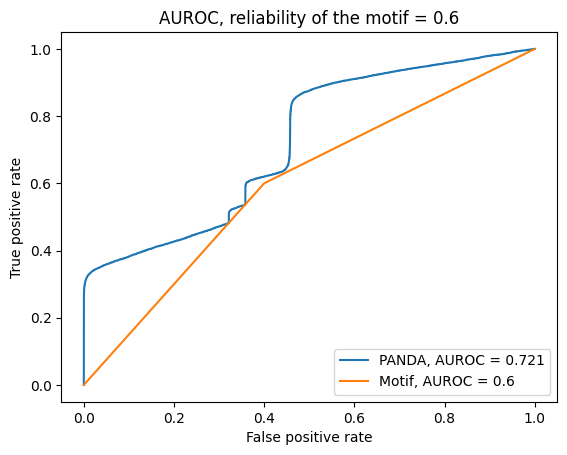

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 228
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6042922092743943
step: 1, hamming: 0.5855263474348911
step: 2, hamming: 0.720939869623836
step: 3, hamming: 0.8008972485031621
step: 4, hamming: 0.8551743463734315
step: 5, hamming: 0.890139553168199
step: 6, hamming: 0.9087096086335703
step: 7, hamming: 0.9134402480558396
step: 8, hamming: 0.906750939789535
step: 9, hamming: 0.8907060828249302
step: 10, hamming: 0.8669272901859995
step: 11, hamming: 0.8366440630863964
step: 12, hamming: 0.8008048080492939
step: 13, hamming: 0.7601991903523148
step: 14, hamming: 0.7155663142009373
step: 15, hamming: 0.6676756771761077
step: 16, hamming: 0.6173738824459168
step:

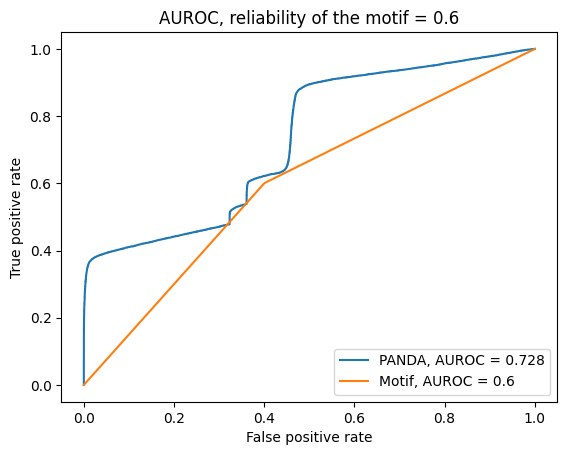

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5916476288781762
step: 1, hamming: 0.5675809551034632
step: 2, hamming: 0.7075483870722302
step: 3, hamming: 0.790625202627226
step: 4, hamming: 0.8483298140689365
step: 5, hamming: 0.8871889436871453
step: 6, hamming: 0.9101718159369662
step: 7, hamming: 0.9198195629802132
step: 8, hamming: 0.9185187518920842
step: 9, hamming: 0.9083478045131901
step: 10, hamming: 0.8910117543743602
step: 11, hamming: 0.8678778530796714
step: 12, hamming: 0.840045410048086
step: 13, hamming: 0.8084113158665562
step: 14, hamming: 0.7737204856944103
step: 15, hamming: 0.7366029368963329
step: 16, hamming: 0.6976021254745803
step

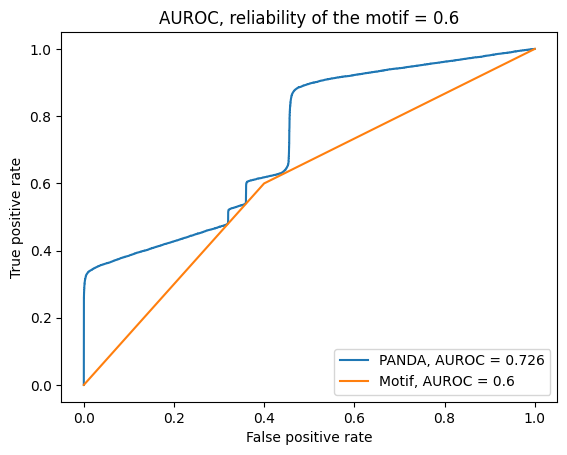

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 200
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5955190521971923
step: 1, hamming: 0.5623639457170522
step: 2, hamming: 0.6926735228092604
step: 3, hamming: 0.767695068091841
step: 4, hamming: 0.8170144773632275
step: 5, hamming: 0.8468843482071147
step: 6, hamming: 0.8601162192327143
step: 7, hamming: 0.8592074718774377
step: 8, hamming: 0.84660636317979
step: 9, hamming: 0.8245196734004522
step: 10, hamming: 0.7948135334631352
step: 11, hamming: 0.7590329664836725
step: 12, hamming: 0.7184736695850954
step: 13, hamming: 0.6742602241483404
step: 14, hamming: 0.6274111016220015
step: 15, hamming: 0.5788833193645254
step: 16, hamming: 0.5295945575566235
step:

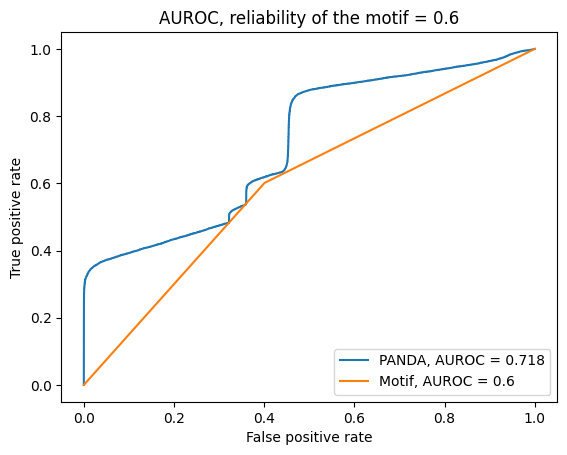

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 206
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5905922410834875
step: 1, hamming: 0.5667031371412572
step: 2, hamming: 0.7054525005252605
step: 3, hamming: 0.7877905576603318
step: 4, hamming: 0.8448035943985439
step: 5, hamming: 0.8830592022033779
step: 6, hamming: 0.9055651433605804
step: 7, hamming: 0.9148843123018392
step: 8, hamming: 0.9134387940618709
step: 9, hamming: 0.9033624883168558
step: 10, hamming: 0.8864108912560216
step: 11, hamming: 0.8639725178545798
step: 12, hamming: 0.8371298802453688
step: 13, hamming: 0.8067297483809508
step: 14, hamming: 0.7734456326323169
step: 15, hamming: 0.7378284225066489
step: 16, hamming: 0.7003459646902805
st

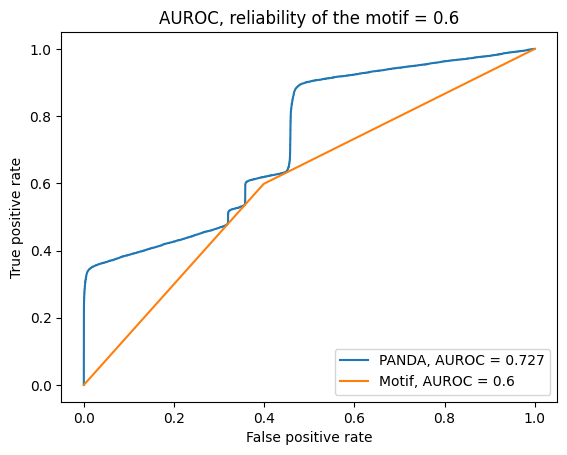

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 204
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.593096589507757
step: 1, hamming: 0.569871862872468
step: 2, hamming: 0.7056192335588236
step: 3, hamming: 0.7857273357346267
step: 4, hamming: 0.8401194546754699
step: 5, hamming: 0.8750389953994023
step: 6, hamming: 0.8932698241465057
step: 7, hamming: 0.8971837948646113
step: 8, hamming: 0.8890216787586362
step: 9, hamming: 0.8707602158959286
step: 10, hamming: 0.8440550453683149
step: 11, hamming: 0.8102872363064167
step: 12, hamming: 0.7706609388568875
step: 13, hamming: 0.7262918081377047
step: 14, hamming: 0.6782680716828802
step: 15, hamming: 0.627681474102643
step: 16, hamming: 0.5756296449994338
step:

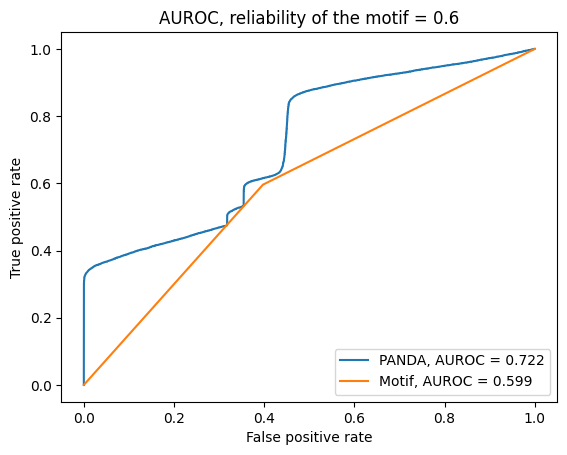

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 214
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5972900394795398
step: 1, hamming: 0.5722975625415753
step: 2, hamming: 0.7041921088690418
step: 3, hamming: 0.7810381199638211
step: 4, hamming: 0.8326220455719451
step: 5, hamming: 0.8652629019253362
step: 6, hamming: 0.8819060979368852
step: 7, hamming: 0.8851838559229663
step: 8, hamming: 0.8776525845396961
step: 9, hamming: 0.8615799325254151
step: 10, hamming: 0.8388253477522931
step: 11, hamming: 0.8108503388237949
step: 12, hamming: 0.7787918085310099
step: 13, hamming: 0.7435462703422823
step: 14, hamming: 0.7058416736543353
step: 15, hamming: 0.666291682241846
step: 16, hamming: 0.6254343240002371
ste

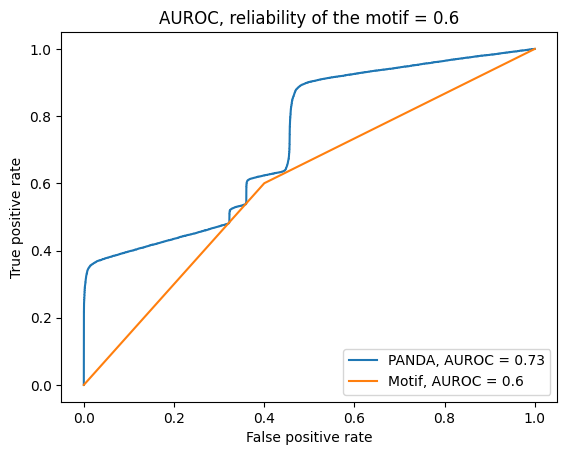

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 224
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.03 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6029090215580669
step: 1, hamming: 0.6008483349105926
step: 2, hamming: 0.740068127406066
step: 3, hamming: 0.8238200659907974
step: 4, hamming: 0.8818605713395571
step: 5, hamming: 0.9207155553004648
step: 6, hamming: 0.9435282288692323
step: 7, hamming: 0.9530694339549478
step: 8, hamming: 0.9519195292888526
step: 9, hamming: 0.9422818443919085
step: 10, hamming: 0.9259189988511645
step: 11, hamming: 0.9041961382140526
step: 12, hamming: 0.8781597947768274
step: 13, hamming: 0.8486149231187974
step: 14, hamming: 0.8161889981722261
step: 15, hamming: 0.7813830314335283
step: 16, hamming: 0.744612064889872
step

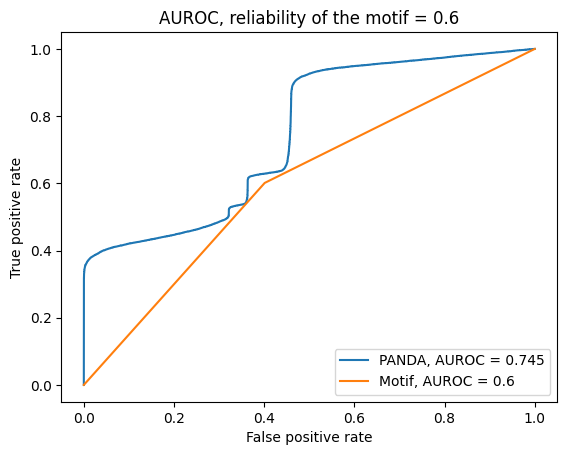

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 164
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5868956121780149
step: 1, hamming: 0.5458135631271477
step: 2, hamming: 0.6733990962442022
step: 3, hamming: 0.745886224412922
step: 4, hamming: 0.7929418036514121
step: 5, hamming: 0.8208217809607735
step: 6, hamming: 0.8324100195779285
step: 7, hamming: 0.8302671503614637
step: 8, hamming: 0.8169069689321647
step: 9, hamming: 0.794642639407414
step: 10, hamming: 0.7654808047175911
step: 11, hamming: 0.7311057394986793
step: 12, hamming: 0.6929090037969302
step: 13, hamming: 0.6520361292653234
step: 14, hamming: 0.609436581567113
step: 15, hamming: 0.565908402222172
step: 16, hamming: 0.522133172195298
step: 1

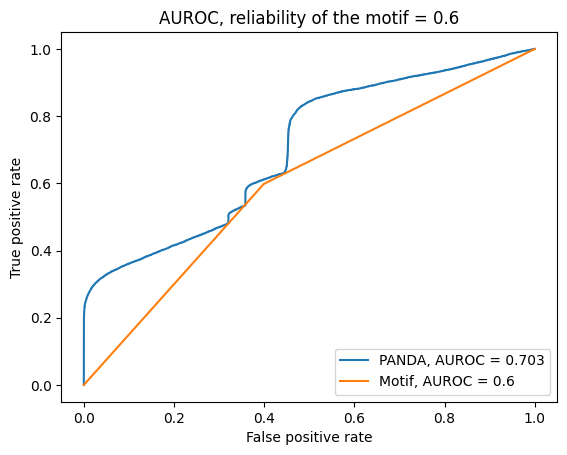

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 170
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5932868486099501
step: 1, hamming: 0.5614207314166635
step: 2, hamming: 0.6977556235399008
step: 3, hamming: 0.7786515204087708
step: 4, hamming: 0.8346939106530931
step: 5, hamming: 0.8722809766330533
step: 6, hamming: 0.894296061153774
step: 7, hamming: 0.9032482086237373
step: 8, hamming: 0.9015471174484235
step: 9, hamming: 0.8913108195997328
step: 10, hamming: 0.8742665283358216
step: 11, hamming: 0.8517727965374968
step: 12, hamming: 0.8248901785208278
step: 13, hamming: 0.7944547272054998
step: 14, hamming: 0.7611393106592718
step: 15, hamming: 0.7255013750936979
step: 16, hamming: 0.6880194993634396
ste

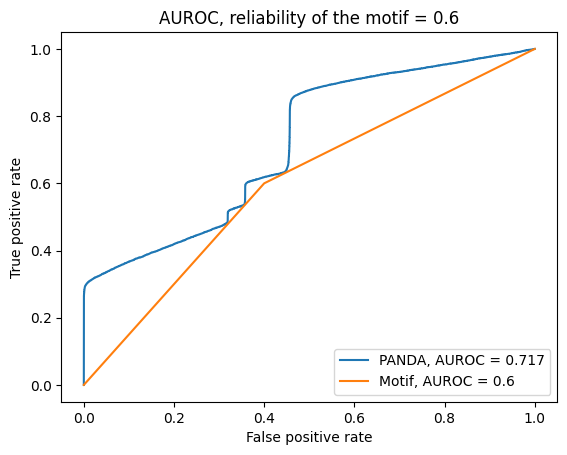

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 202
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5950741992576982
step: 1, hamming: 0.5687312880885872
step: 2, hamming: 0.7037759854254771
step: 3, hamming: 0.7834022889686839
step: 4, hamming: 0.837859986170154
step: 5, hamming: 0.8736001014142208
step: 6, hamming: 0.893581954217764
step: 7, hamming: 0.9004062367472362
step: 8, hamming: 0.8965748273116816
step: 9, hamming: 0.8842803787705248
step: 10, hamming: 0.8652979826500387
step: 11, hamming: 0.8410084243669814
step: 12, hamming: 0.812477078177473
step: 13, hamming: 0.7805371706758907
step: 14, hamming: 0.7458585401078545
step: 15, hamming: 0.7089995664448759
step: 16, hamming: 0.6704451427494259
step:

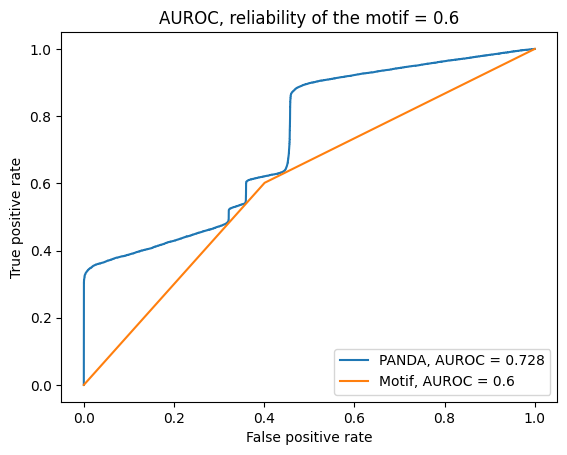

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 178
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6033476298955506
step: 1, hamming: 0.5674151812742783
step: 2, hamming: 0.6978837026190862
step: 3, hamming: 0.7737767387500325
step: 4, hamming: 0.8243863107214408
step: 5, hamming: 0.8558521487641315
step: 6, hamming: 0.8710323289416435
step: 7, hamming: 0.8725073871061473
step: 8, hamming: 0.8627961854461355
step: 9, hamming: 0.8441578028803458
step: 10, hamming: 0.8184945000123794
step: 11, hamming: 0.7873669187809628
step: 12, hamming: 0.7520514196321527
step: 13, hamming: 0.7135995082040864
step: 14, hamming: 0.6728879405652133
step: 15, hamming: 0.630659200708287
step: 16, hamming: 0.5875537597504511
ste

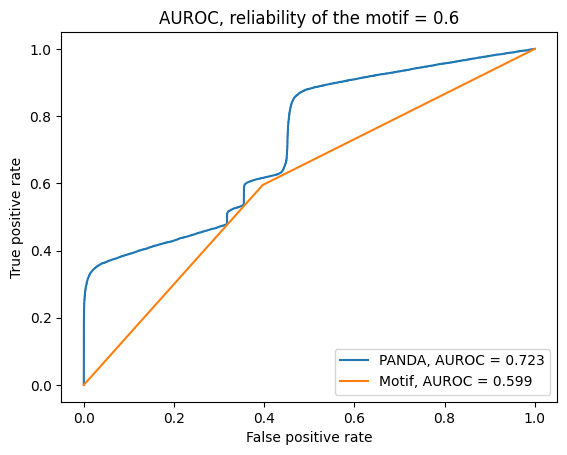

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 178
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5906240535347217
step: 1, hamming: 0.5596287055388144
step: 2, hamming: 0.690832374899762
step: 3, hamming: 0.7672689902772042
step: 4, hamming: 0.818492779207234
step: 5, hamming: 0.8508086414687553
step: 6, hamming: 0.8670803930917412
step: 7, hamming: 0.8698267235007835
step: 8, hamming: 0.8615330489966271
step: 9, hamming: 0.8444517180863716
step: 10, hamming: 0.82046807371926
step: 11, hamming: 0.7910971201037833
step: 12, hamming: 0.7575460849999157
step: 13, hamming: 0.7207891416900188
step: 14, hamming: 0.6816317036704536
step: 15, hamming: 0.6407595408812915
step: 16, hamming: 0.5987741862481477
step: 

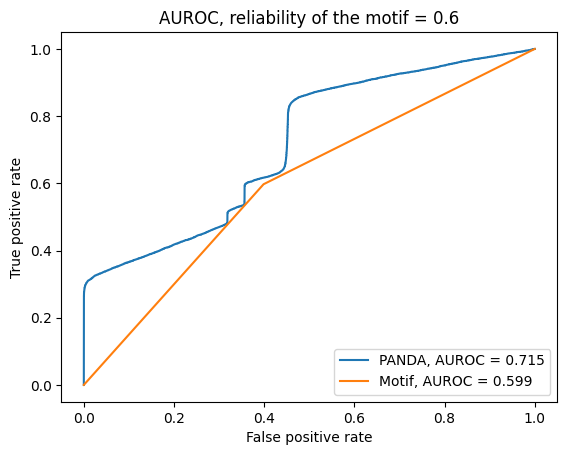

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 180
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5932951384035324
step: 1, hamming: 0.5637434170055711
step: 2, hamming: 0.6961702527722723
step: 3, hamming: 0.7731895235794387
step: 4, hamming: 0.8247961627518392
step: 5, hamming: 0.8572991871540635
step: 6, hamming: 0.8735541024411044
step: 7, hamming: 0.876029597025126
step: 8, hamming: 0.867135629641906
step: 9, hamming: 0.849058954159391
step: 10, hamming: 0.8236444661317868
step: 11, hamming: 0.7923997517186059
step: 12, hamming: 0.7565655576642177
step: 13, hamming: 0.7171941047978122
step: 14, hamming: 0.675208287135874
step: 15, hamming: 0.6314378854144663
step: 16, hamming: 0.5866381837152714
step: 

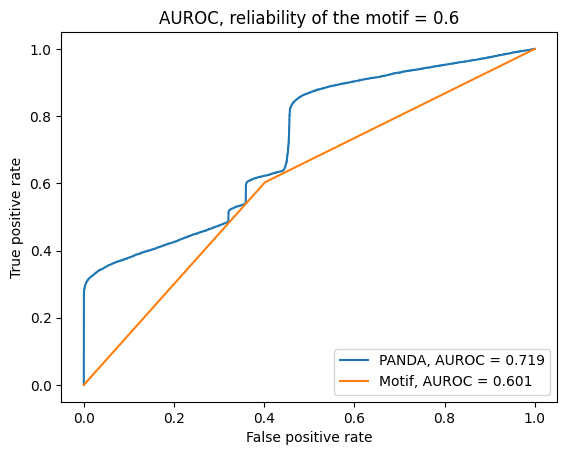

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 180
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5947138721842881
step: 1, hamming: 0.563429037279289
step: 2, hamming: 0.6974830015354386
step: 3, hamming: 0.7771275455014868
step: 4, hamming: 0.8317704826501309
step: 5, hamming: 0.8676555212201275
step: 6, hamming: 0.8876391027237012
step: 7, hamming: 0.8941891993062829
step: 8, hamming: 0.889665946682327
step: 9, hamming: 0.876169683797013
step: 10, hamming: 0.8554535940165447
step: 11, hamming: 0.8289403793683316
step: 12, hamming: 0.7977854098857207
step: 13, hamming: 0.7629439067115181
step: 14, hamming: 0.7252260819105173
step: 15, hamming: 0.6853374622946296
step: 16, hamming: 0.6439063304664661
step:

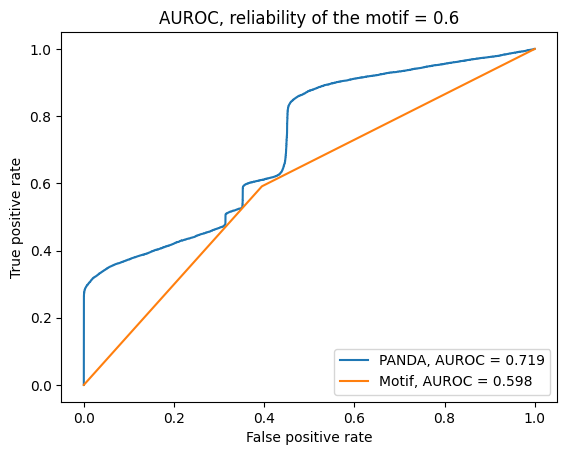

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 198
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5981796970621021
step: 1, hamming: 0.5729832416981897
step: 2, hamming: 0.7116887244888137
step: 3, hamming: 0.7941392017985865
step: 4, hamming: 0.8510074076365755
step: 5, hamming: 0.8887917514209687
step: 6, hamming: 0.9104735131345156
step: 7, hamming: 0.918597907199296
step: 8, hamming: 0.9155736711049205
step: 9, hamming: 0.9035353456556154
step: 10, hamming: 0.8842636870861782
step: 11, hamming: 0.8592002875642867
step: 12, hamming: 0.8295055234284451
step: 13, hamming: 0.796122250584971
step: 14, hamming: 0.7598294418283504
step: 15, hamming: 0.7212831982572425
step: 16, hamming: 0.6810479070790082
step

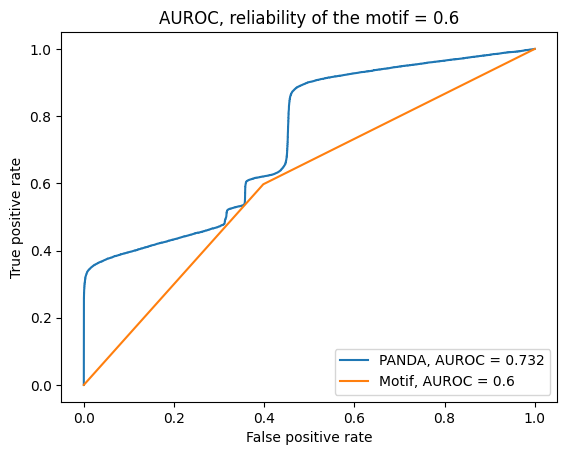

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 156
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5903607307178157
step: 1, hamming: 0.568046534111591
step: 2, hamming: 0.7013704837667304
step: 3, hamming: 0.7796724891244462
step: 4, hamming: 0.8327010969481436
step: 5, hamming: 0.8667107568398982
step: 6, hamming: 0.8845776312193436
step: 7, hamming: 0.8888497289645765
step: 8, hamming: 0.8820030022045275
step: 9, hamming: 0.8662430008466887
step: 10, hamming: 0.8434032279430382
step: 11, hamming: 0.814966105346461
step: 12, hamming: 0.7821309802101085
step: 13, hamming: 0.7458823928682581
step: 14, hamming: 0.7070442216711798
step: 15, hamming: 0.6663199018405881
step: 16, hamming: 0.6243224227313889
step

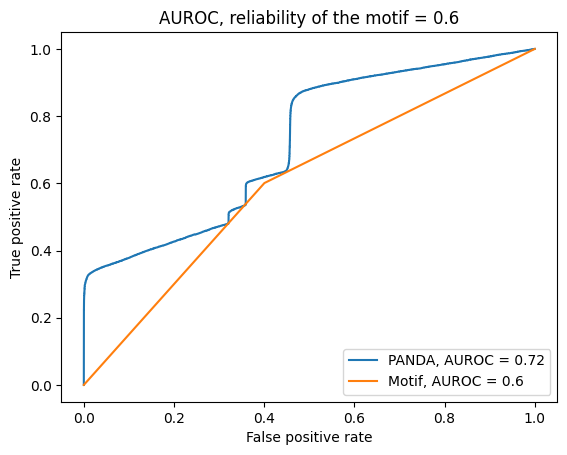

0.5
Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 182
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6006132099903595
step: 1, hamming: 0.592465540198012
step: 2, hamming: 0.7311433031732407
step: 3, hamming: 0.8135213879406961
step: 4, hamming: 0.8700047882208548
step: 5, hamming: 0.9071391584973691
step: 6, hamming: 0.9280780145011984
step: 7, hamming: 0.9355770112380274
step: 8, hamming: 0.9322151968910098
step: 9, hamming: 0.9202276553897177
step: 10, hamming: 0.9014273411384084
step: 11, hamming: 0.8772312507387542
step: 12, hamming: 0.8487326942553314
step: 13, hamming: 0.8167796801752933
step: 14, hamming: 0.7820427633112587
step: 15, hamming: 0.7450688691640475
step: 16, hamming: 0.7063225581395686

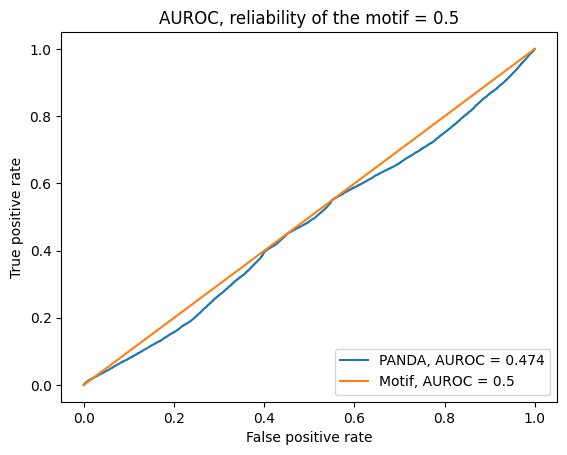

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 178
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6001320738700651
step: 1, hamming: 0.5894830608605859
step: 2, hamming: 0.7309063426971552
step: 3, hamming: 0.8155022564037115
step: 4, hamming: 0.8744271664825286
step: 5, hamming: 0.9143989954064764
step: 6, hamming: 0.9386321233732896
step: 7, hamming: 0.949894132181425
step: 8, hamming: 0.9507601562852698
step: 9, hamming: 0.9434459592015846
step: 10, hamming: 0.9297202864009094
step: 11, hamming: 0.9109308329830107
step: 12, hamming: 0.8880825988687926
step: 13, hamming: 0.8619224597979055
step: 14, hamming: 0.8330114236146493
step: 15, hamming: 0.8017813960944965
step: 16, hamming: 0.7685785516296257
ste

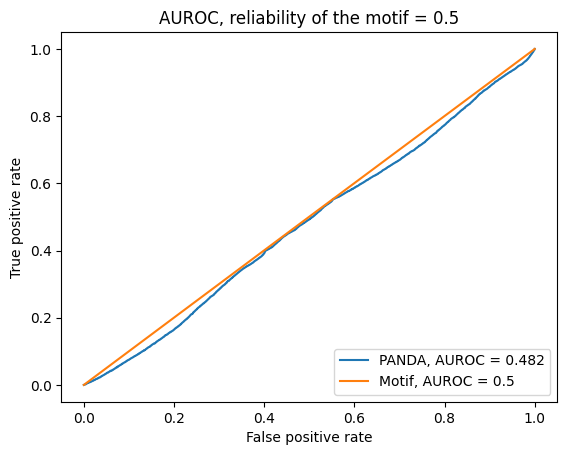

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 144
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6002660172799307
step: 1, hamming: 0.595163759627377
step: 2, hamming: 0.734541525806721
step: 3, hamming: 0.8167969125298508
step: 4, hamming: 0.872890249642865
step: 5, hamming: 0.9092298627136643
step: 6, hamming: 0.9288490162845306
step: 7, hamming: 0.9344134427827803
step: 8, hamming: 0.928430153284719
step: 9, hamming: 0.9130709851123967
step: 10, hamming: 0.8901171131539596
step: 11, hamming: 0.8610155483812474
step: 12, hamming: 0.8269655247707369
step: 13, hamming: 0.78899162440007
step: 14, hamming: 0.7479944064525235
step: 15, hamming: 0.7047813497752997
step: 16, hamming: 0.6600833679286742
step: 17

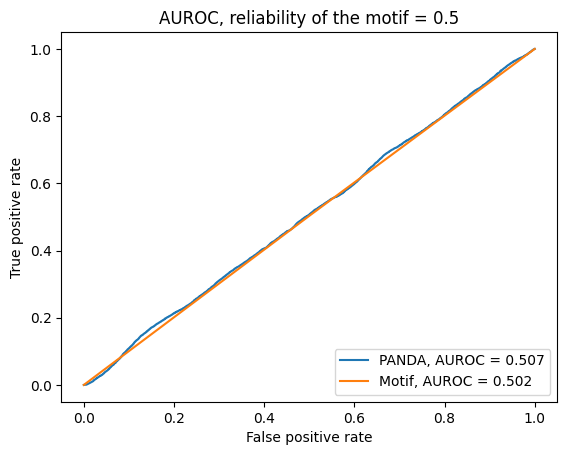

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 166
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.597660083805664
step: 1, hamming: 0.5928069990302165
step: 2, hamming: 0.7363343431956
step: 3, hamming: 0.8231057110465024
step: 4, hamming: 0.884309956327049
step: 5, hamming: 0.92665002523598
step: 6, hamming: 0.9533235784708741
step: 7, hamming: 0.9670822038633718
step: 8, hamming: 0.9704676086051046
step: 9, hamming: 0.965650908483229
step: 10, hamming: 0.9543654179963594
step: 11, hamming: 0.9379415227393714
step: 12, hamming: 0.917380944990623
step: 13, hamming: 0.8934328602521941
step: 14, hamming: 0.866658854325179
step: 15, hamming: 0.8374851279645188
step: 16, hamming: 0.8062438850173493
step: 17, ha

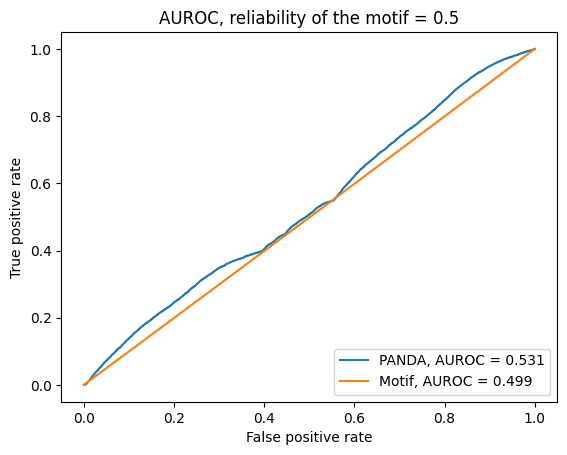

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 206
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6071702485051723
step: 1, hamming: 0.5930941733787649
step: 2, hamming: 0.7335943602313527
step: 3, hamming: 0.8175242834352626
step: 4, hamming: 0.8756265710534217
step: 5, hamming: 0.9144087188647928
step: 6, hamming: 0.9369174423009299
step: 7, hamming: 0.9457749528546502
step: 8, hamming: 0.943395071435426
step: 9, hamming: 0.9318157415613448
step: 10, hamming: 0.9126451052132699
step: 11, hamming: 0.8871095986070909
step: 12, hamming: 0.8561547622301158
step: 13, hamming: 0.8205497916986079
step: 14, hamming: 0.7809755075880204
step: 15, hamming: 0.7380893956049016
step: 16, hamming: 0.6925665881824933
ste

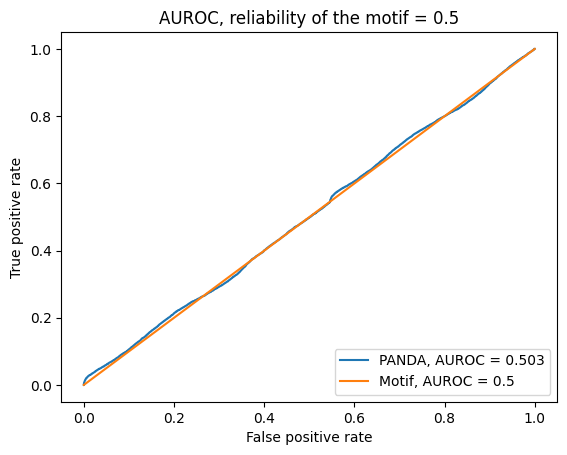

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 182
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6059493230555432
step: 1, hamming: 0.5949072798634195
step: 2, hamming: 0.7335869051067597
step: 3, hamming: 0.8161016150431439
step: 4, hamming: 0.872804417917237
step: 5, hamming: 0.9101535856678341
step: 6, hamming: 0.9312205952549658
step: 7, hamming: 0.9387413421643844
step: 8, hamming: 0.9352955235336418
step: 9, hamming: 0.9231018495670353
step: 10, hamming: 0.9039488481827546
step: 11, hamming: 0.879245086581879
step: 12, hamming: 0.8501015976354097
step: 13, hamming: 0.8174043003402588
step: 14, hamming: 0.7818697426047118
step: 15, hamming: 0.744088625494307
step: 16, hamming: 0.7045613477727087
step:

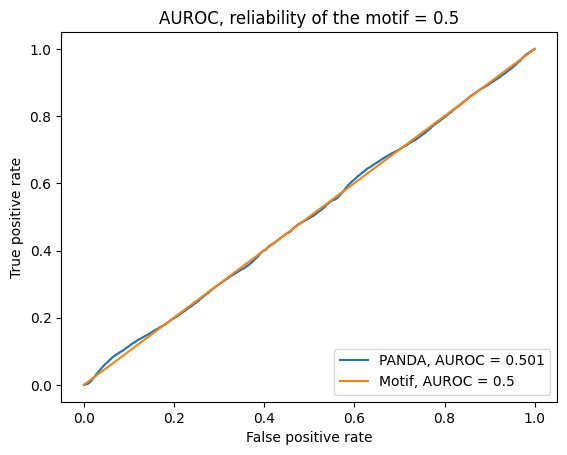

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 192
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6024464196241012
step: 1, hamming: 0.5906663585844766
step: 2, hamming: 0.7366750511971317
step: 3, hamming: 0.82479109577002
step: 4, hamming: 0.8872369749972966
step: 5, hamming: 0.9308598438022238
step: 6, hamming: 0.9588493323611755
step: 7, hamming: 0.9739386692265939
step: 8, hamming: 0.9786649814593179
step: 9, hamming: 0.9751943440206149
step: 10, hamming: 0.9652571961699642
step: 11, hamming: 0.9501945564658457
step: 12, hamming: 0.9310333387272891
step: 13, hamming: 0.9085529697371164
step: 14, hamming: 0.8833387005445682
step: 15, hamming: 0.8558258762575818
step: 16, hamming: 0.826338684329647
step:

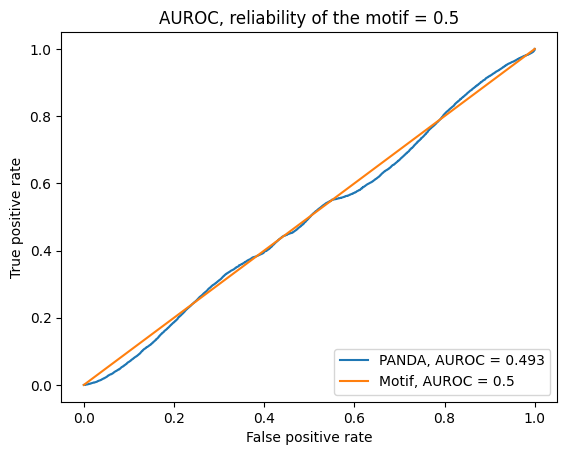

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 186
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6011016142835717
step: 1, hamming: 0.5943551021116881
step: 2, hamming: 0.7371481175458622
step: 3, hamming: 0.8232272327650711
step: 4, hamming: 0.8838543651301715
step: 5, hamming: 0.9257227038756081
step: 6, hamming: 0.9520240286989791
step: 7, hamming: 0.9655638241852358
step: 8, hamming: 0.9689500307652977
step: 9, hamming: 0.9643796969960239
step: 10, hamming: 0.9535647149652187
step: 11, hamming: 0.9377858417539643
step: 12, hamming: 0.9179873265285612
step: 13, hamming: 0.8948657198738266
step: 14, hamming: 0.868940463984247
step: 15, hamming: 0.8406072813772767
step: 16, hamming: 0.8101782882269675
ste

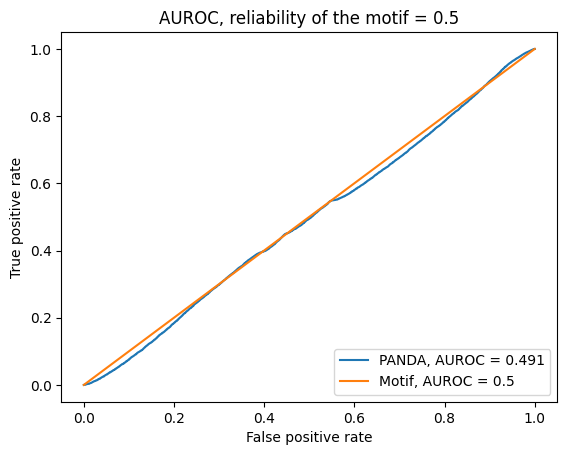

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6200071237193349
step: 1, hamming: 0.6036167211879668
step: 2, hamming: 0.7428889914069131
step: 3, hamming: 0.826645535068125
step: 4, hamming: 0.8847904763057726
step: 5, hamming: 0.9237613545030885
step: 6, hamming: 0.9466653843856838
step: 7, hamming: 0.9562356270254563
step: 8, hamming: 0.9550157684191283
step: 9, hamming: 0.9451675655827529
step: 10, hamming: 0.9284012871133847
step: 11, hamming: 0.9060326032597439
step: 12, hamming: 0.8790832593382328
step: 13, hamming: 0.8483732255573326
step: 14, hamming: 0.8145868951120908
step: 15, hamming: 0.7783140758227348
step: 16, hamming: 0.7400730361253957
ste

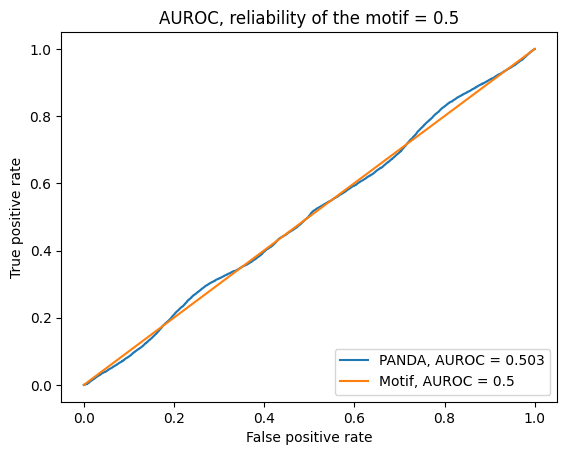

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 186
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5986931341857594
step: 1, hamming: 0.592800530770686
step: 2, hamming: 0.7322090639877075
step: 3, hamming: 0.815393345509615
step: 4, hamming: 0.8728397104265505
step: 5, hamming: 0.9111213872534226
step: 6, hamming: 0.9333821617131564
step: 7, hamming: 0.9424093766996453
step: 8, hamming: 0.9408261400272622
step: 9, hamming: 0.9308800264450375
step: 10, hamming: 0.9143614172667159
step: 11, hamming: 0.8926442954912116
step: 12, hamming: 0.8667697100125414
step: 13, hamming: 0.8375288529153655
step: 14, hamming: 0.8055323144101164
step: 15, hamming: 0.7712645099126995
step: 16, hamming: 0.7351257083315066
step

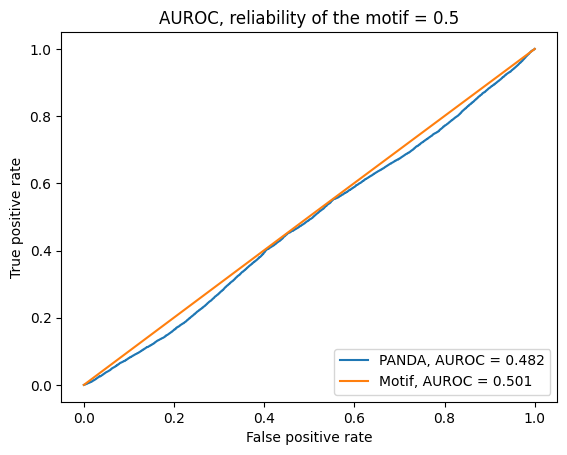

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6080823651079669
step: 1, hamming: 0.5976363974905903
step: 2, hamming: 0.737194616391963
step: 3, hamming: 0.8201516341726685
step: 4, hamming: 0.8770995339495323
step: 5, hamming: 0.9146311117262343
step: 6, hamming: 0.9359455356358496
step: 7, hamming: 0.9437885755804295
step: 8, hamming: 0.9407300219796532
step: 9, hamming: 0.9290264865052433
step: 10, hamming: 0.9105274635605585
step: 11, hamming: 0.8866776961902122
step: 12, hamming: 0.8585796447194037
step: 13, hamming: 0.8270734056310403
step: 14, hamming: 0.7928100288342794
step: 15, hamming: 0.7563107578967425
step: 16, hamming: 0.7180124857518317
ste

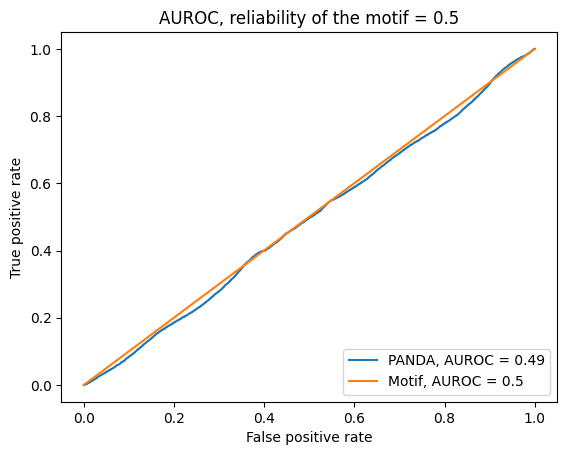

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 172
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6044394057292982
step: 1, hamming: 0.5945829278689055
step: 2, hamming: 0.7325075917264012
step: 3, hamming: 0.8140740668972125
step: 4, hamming: 0.8696085668766631
step: 5, hamming: 0.9056299378106007
step: 6, hamming: 0.9252396715008417
step: 7, hamming: 0.9311521887342482
step: 8, hamming: 0.9259523674646978
step: 9, hamming: 0.911916673956315
step: 10, hamming: 0.8909128850894792
step: 11, hamming: 0.8644158406395523
step: 12, hamming: 0.8335766086981891
step: 13, hamming: 0.7992996550922946
step: 14, hamming: 0.7623099883762963
step: 15, hamming: 0.7232065813413285
step: 16, hamming: 0.6825033358158401
ste

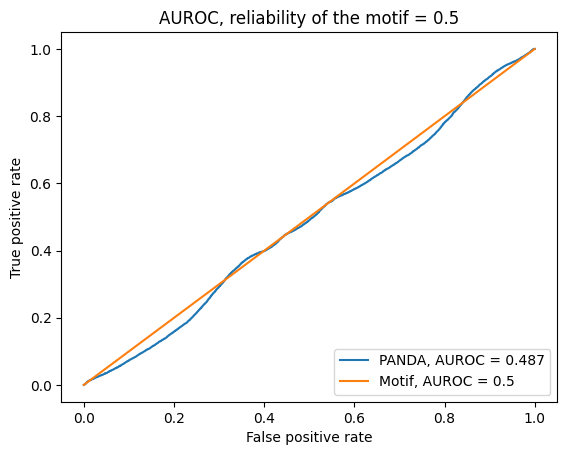

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 210
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6036098954252791
step: 1, hamming: 0.5884946494306666
step: 2, hamming: 0.7272212438662259
step: 3, hamming: 0.8097893733347736
step: 4, hamming: 0.8665147215459353
step: 5, hamming: 0.9039356939492226
step: 6, hamming: 0.9251424774113531
step: 7, hamming: 0.9328162775268112
step: 8, hamming: 0.9294793083813833
step: 9, hamming: 0.9173336517894847
step: 10, hamming: 0.8981800248595216
step: 11, hamming: 0.8734448821034007
step: 12, hamming: 0.8442526611298081
step: 13, hamming: 0.8114978499773188
step: 14, hamming: 0.7759030533156008
step: 15, hamming: 0.7380643181905957
step: 16, hamming: 0.6984875212425918
st

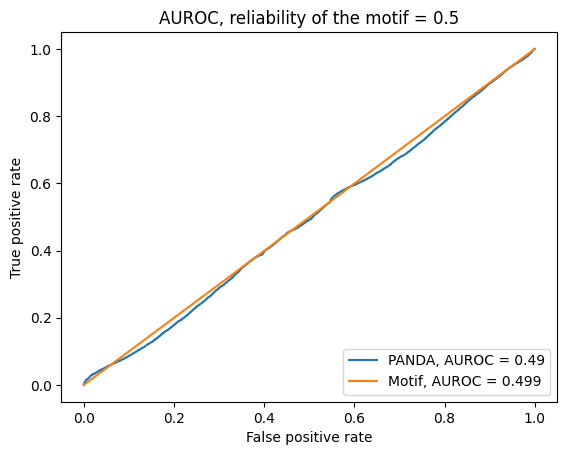

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 164
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5979529578505984
step: 1, hamming: 0.5935532199300835
step: 2, hamming: 0.7318044607511786
step: 3, hamming: 0.8137992192368677
step: 4, hamming: 0.8698461194047402
step: 5, hamming: 0.9064011968762363
step: 6, hamming: 0.926542390897757
step: 7, hamming: 0.9329913454930495
step: 8, hamming: 0.9283237213457278
step: 9, hamming: 0.9147755401435074
step: 10, hamming: 0.8941665516242899
step: 11, hamming: 0.8679410027754139
step: 12, hamming: 0.8372460058490662
step: 13, hamming: 0.8030043598973392
step: 14, hamming: 0.7659716322713568
step: 15, hamming: 0.726779669823143
step: 16, hamming: 0.6859704745207269
step

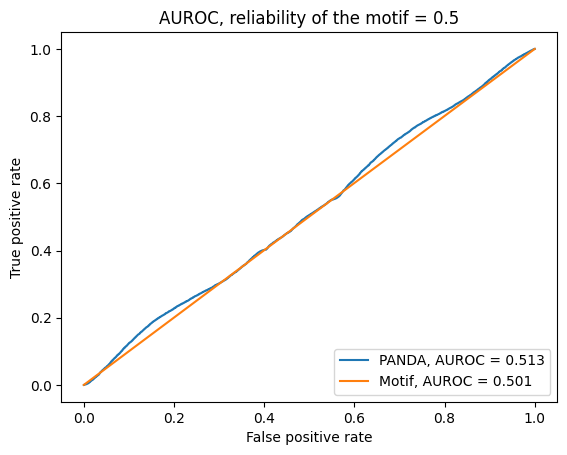

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 172
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5996694225453516
step: 1, hamming: 0.5860583271790536
step: 2, hamming: 0.727742063246713
step: 3, hamming: 0.8120803901049254
step: 4, hamming: 0.8705404956603532
step: 5, hamming: 0.9097407889089109
step: 6, hamming: 0.9327702781625994
step: 7, hamming: 0.9422927183651151
step: 8, hamming: 0.94080781156866
step: 9, hamming: 0.9305032166200086
step: 10, hamming: 0.9131835027265796
step: 11, hamming: 0.8902862342009237
step: 12, hamming: 0.862936765346055
step: 13, hamming: 0.8320128090988447
step: 14, hamming: 0.7982050622816498
step: 15, hamming: 0.762068833099797
step: 16, hamming: 0.72406612641984
step: 17,

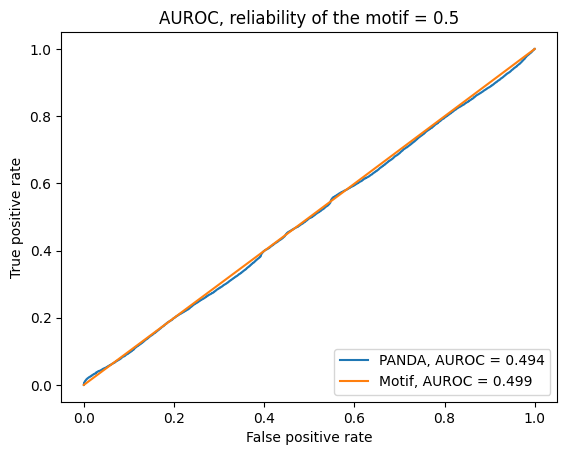

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5982911192569359
step: 1, hamming: 0.590177450897885
step: 2, hamming: 0.7301898605624044
step: 3, hamming: 0.8140072692787819
step: 4, hamming: 0.8721041761958842
step: 5, hamming: 0.9110398615774191
step: 6, hamming: 0.933956324291127
step: 7, hamming: 0.9436074148391536
step: 8, hamming: 0.942558285571663
step: 9, hamming: 0.9330167413937966
step: 10, hamming: 0.9167678077452002
step: 11, hamming: 0.8952054539309049
step: 12, hamming: 0.8694022672408181
step: 13, hamming: 0.8401823476559185
step: 14, hamming: 0.8081845724599056
step: 15, hamming: 0.7739141596462957
step: 16, hamming: 0.7377840231432906
step:

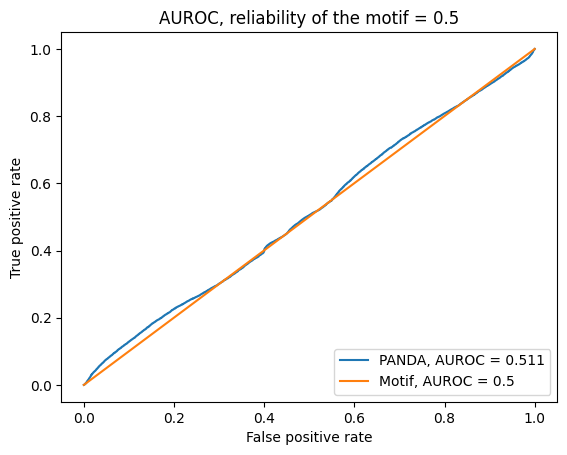

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 178
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6039755357240468
step: 1, hamming: 0.5882376063458856
step: 2, hamming: 0.7244285781083852
step: 3, hamming: 0.8045293135445832
step: 4, hamming: 0.8586475574506074
step: 5, hamming: 0.8931146664969671
step: 6, hamming: 0.9108447407472421
step: 7, hamming: 0.914413910023751
step: 8, hamming: 0.9062692142202338
step: 9, hamming: 0.888521026128878
step: 10, hamming: 0.8628961052969323
step: 11, hamming: 0.8307984157190673
step: 12, hamming: 0.7934097467548841
step: 13, hamming: 0.7517786142712033
step: 14, hamming: 0.7068801812409915
step: 15, hamming: 0.6596471035650566
step: 16, hamming: 0.6109773451400872
step

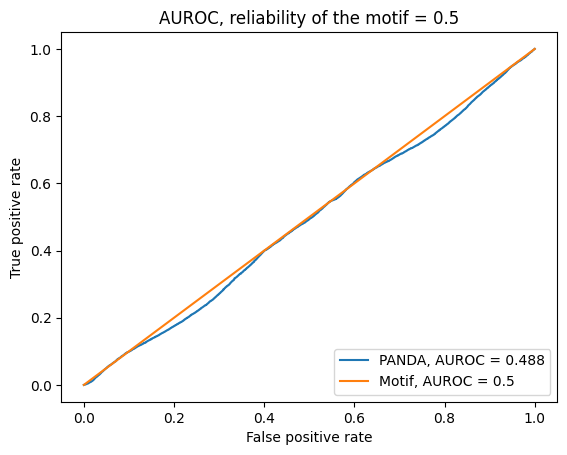

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6113757816794245
step: 1, hamming: 0.5949756495669155
step: 2, hamming: 0.7351640297271976
step: 3, hamming: 0.8190448149038544
step: 4, hamming: 0.8772062427289026
step: 5, hamming: 0.9162529275579703
step: 6, hamming: 0.9394046729783819
step: 7, hamming: 0.9494622776876896
step: 8, hamming: 0.9490115856351509
step: 9, hamming: 0.9402681562041454
step: 10, hamming: 0.9250098469910918
step: 11, hamming: 0.9046050913980958
step: 12, hamming: 0.8800851800867421
step: 13, hamming: 0.8522238864143918
step: 14, hamming: 0.8216076986229066
step: 15, hamming: 0.7886924978702473
step: 16, hamming: 0.7538477343451356
st

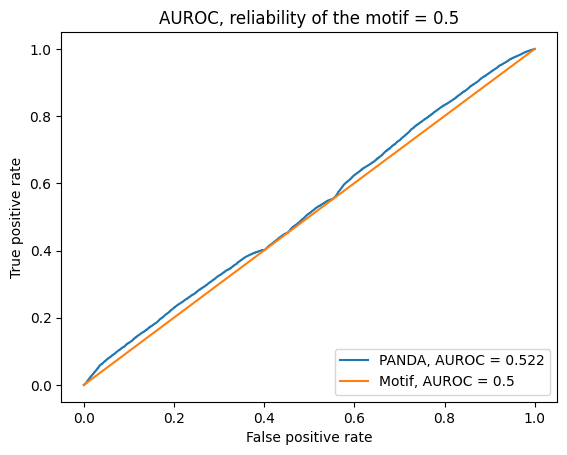

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 168
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6028950404268516
step: 1, hamming: 0.5928383926265051
step: 2, hamming: 0.7283955996012285
step: 3, hamming: 0.8083288736635252
step: 4, hamming: 0.8622866659743684
step: 5, hamming: 0.8966134012910718
step: 6, hamming: 0.914311173374468
step: 7, hamming: 0.9180811330182497
step: 8, hamming: 0.9105171274831907
step: 9, hamming: 0.8939028031983487
step: 10, hamming: 0.8701274466145462
step: 11, hamming: 0.840718376608842
step: 12, hamming: 0.806910905452844
step: 13, hamming: 0.7697137439899864
step: 14, hamming: 0.7299605911035069
step: 15, hamming: 0.6883508330940604
step: 16, hamming: 0.6454830673680629
step:

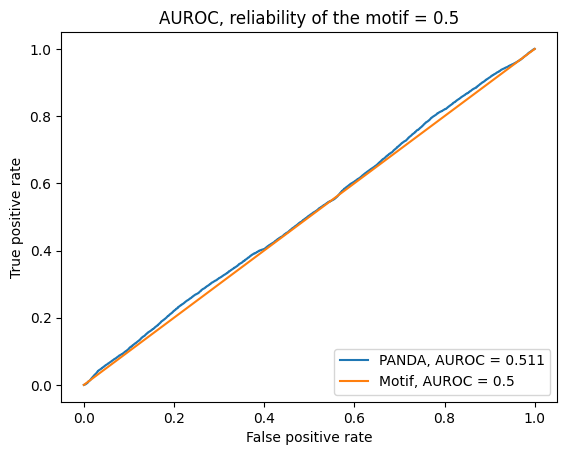

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 184
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6012545401606708
step: 1, hamming: 0.5894144699114722
step: 2, hamming: 0.7305556879521454
step: 3, hamming: 0.815049909138546
step: 4, hamming: 0.8738690169841018
step: 5, hamming: 0.9136326115855038
step: 6, hamming: 0.9374769592768506
step: 7, hamming: 0.9481205776210435
step: 8, hamming: 0.9480982627082676
step: 9, hamming: 0.9395869423723817
step: 10, hamming: 0.924333992940249
step: 11, hamming: 0.903700215494212
step: 12, hamming: 0.8787414193065108
step: 13, hamming: 0.8502827000706856
step: 14, hamming: 0.81897459456131
step: 15, hamming: 0.7853354036084211
step: 16, hamming: 0.7497857343008417
step: 1

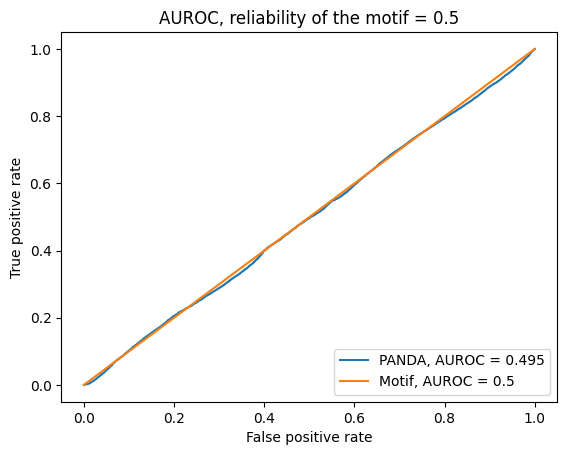

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 176
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6120481893586689
step: 1, hamming: 0.5985117064048648
step: 2, hamming: 0.7343107470087138
step: 3, hamming: 0.814451603398561
step: 4, hamming: 0.8684749778431465
step: 5, hamming: 0.9028028081873923
step: 6, hamming: 0.920448838700311
step: 7, hamming: 0.9240458151925223
step: 8, hamming: 0.9161063255910413
step: 9, hamming: 0.8988337677789486
step: 10, hamming: 0.8740175288622514
step: 11, hamming: 0.8430665392699014
step: 12, hamming: 0.8070968283622543
step: 13, hamming: 0.7670305518022779
step: 14, hamming: 0.7236798001395892
step: 15, hamming: 0.6778071684300895
step: 16, hamming: 0.6301623795873296
step

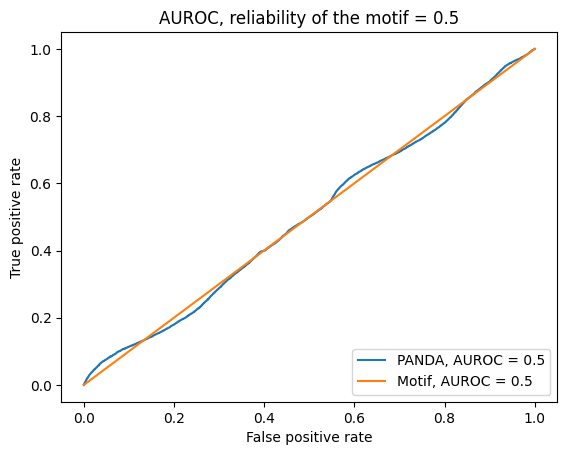

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 186
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6023136471775664
step: 1, hamming: 0.5971224208063274
step: 2, hamming: 0.7405118964941989
step: 3, hamming: 0.8275976676141524
step: 4, hamming: 0.8891398898917957
step: 5, hamming: 0.9317710354750779
step: 6, hamming: 0.958740891351232
step: 7, hamming: 0.9728674229084691
step: 8, hamming: 0.9767171673122793
step: 9, hamming: 0.9724501940128445
step: 10, hamming: 0.9617808752148559
step: 11, hamming: 0.9460292092444054
step: 12, hamming: 0.9261959174836232
step: 13, hamming: 0.9030318854566325
step: 14, hamming: 0.8770966239533055
step: 15, hamming: 0.8488074167761039
step: 16, hamming: 0.8184809059322369
ste

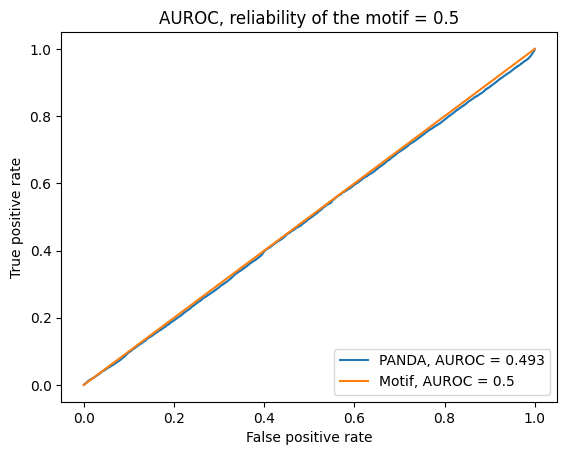

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 192
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6015565036677918
step: 1, hamming: 0.5866631827681396
step: 2, hamming: 0.7282306010783199
step: 3, hamming: 0.8129470355475993
step: 4, hamming: 0.8718458453529959
step: 5, hamming: 0.911583308736703
step: 6, hamming: 0.9352576819651192
step: 7, hamming: 0.9455278751363477
step: 8, hamming: 0.9448885652600194
step: 9, hamming: 0.935502303733598
step: 10, hamming: 0.9191212392541587
step: 11, hamming: 0.8971252261533412
step: 12, hamming: 0.8706011407106903
step: 13, hamming: 0.8404157938410992
step: 14, hamming: 0.8072704055413729
step: 15, hamming: 0.7717402813496687
step: 16, hamming: 0.7343058120900103
step

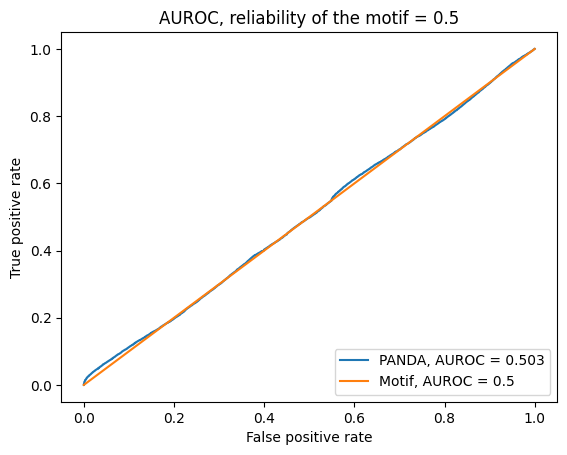

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 156
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5977853447867829
step: 1, hamming: 0.5835395681690274
step: 2, hamming: 0.7223100373364452
step: 3, hamming: 0.8042597789281626
step: 4, hamming: 0.860387400613267
step: 5, hamming: 0.8973046962632469
step: 6, hamming: 0.9181055410684524
step: 7, hamming: 0.9254989779896653
step: 8, hamming: 0.9220678621952566
step: 9, hamming: 0.9100647606204433
step: 10, hamming: 0.8913095469039964
step: 11, hamming: 0.8672152567827315
step: 12, hamming: 0.8388666212375612
step: 13, hamming: 0.807102916834171
step: 14, hamming: 0.7725877824241233
step: 15, hamming: 0.7358635176128481
step: 16, hamming: 0.6973921121413934
step

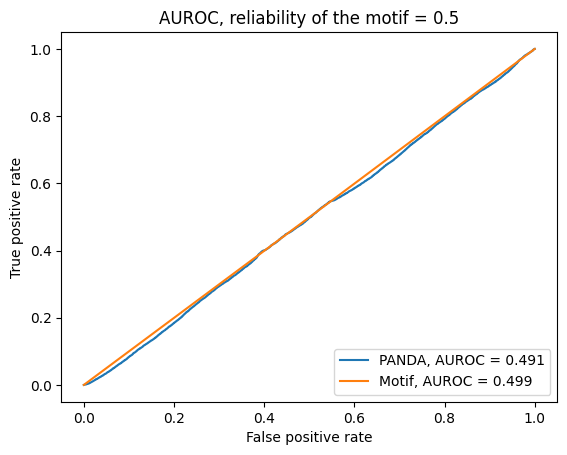

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 232
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6109007126295073
step: 1, hamming: 0.5903527891393888
step: 2, hamming: 0.73055203375268
step: 3, hamming: 0.8147265031953471
step: 4, hamming: 0.8732575072503571
step: 5, hamming: 0.9127713960874184
step: 6, hamming: 0.9363902117915208
step: 7, hamming: 0.9468221205514826
step: 8, hamming: 0.9465945247291276
step: 9, hamming: 0.9378685636086643
step: 10, hamming: 0.9223659750308003
step: 11, hamming: 0.9014178022491937
step: 12, hamming: 0.8760548651880292
step: 13, hamming: 0.8470903534422153
step: 14, hamming: 0.8151801704678845
step: 15, hamming: 0.7808639786028274
step: 16, hamming: 0.7445943068291347
step

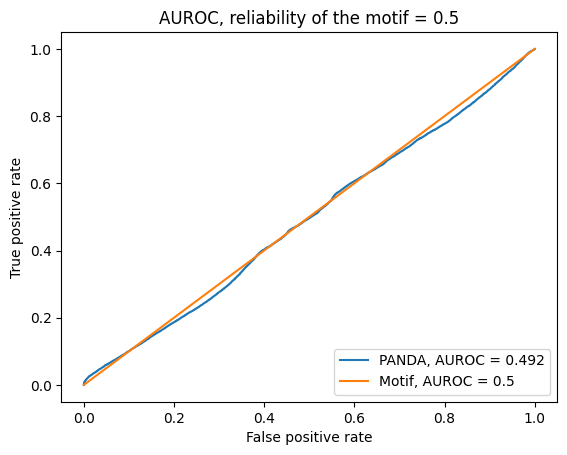

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 164
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6001541553323195
step: 1, hamming: 0.591957453023501
step: 2, hamming: 0.7273119054034344
step: 3, hamming: 0.806496010798036
step: 4, hamming: 0.8595019943022301
step: 5, hamming: 0.8927367123527721
step: 6, hamming: 0.909229906706042
step: 7, hamming: 0.9116437810672336
step: 8, hamming: 0.9025445203113392
step: 9, hamming: 0.884220810566927
step: 10, hamming: 0.8585840167946416
step: 11, hamming: 0.8271936238932585
step: 12, hamming: 0.7913290838770185
step: 13, hamming: 0.752056285151482
step: 14, hamming: 0.7102771323733551
step: 15, hamming: 0.666765942513599
step: 16, hamming: 0.6221971329427294
step: 17

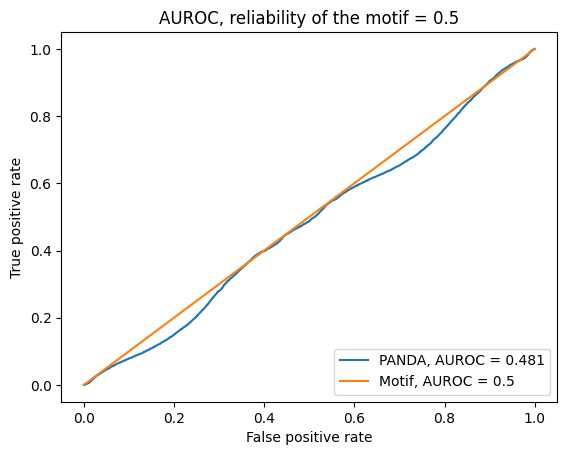

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 180
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5968065397689849
step: 1, hamming: 0.5927642657494904
step: 2, hamming: 0.7342351065016958
step: 3, hamming: 0.8191143666825422
step: 4, hamming: 0.8782197352844795
step: 5, hamming: 0.9181457354068535
step: 6, hamming: 0.941999876062561
step: 7, hamming: 0.9524640009638088
step: 8, hamming: 0.9520311823852458
step: 9, hamming: 0.942835772708807
step: 10, hamming: 0.9265872730135295
step: 11, hamming: 0.9046156054923725
step: 12, hamming: 0.8779598477296126
step: 13, hamming: 0.8474555176828745
step: 14, hamming: 0.8138007974258713
step: 15, hamming: 0.7775986005534548
step: 16, hamming: 0.7393798891881518
step

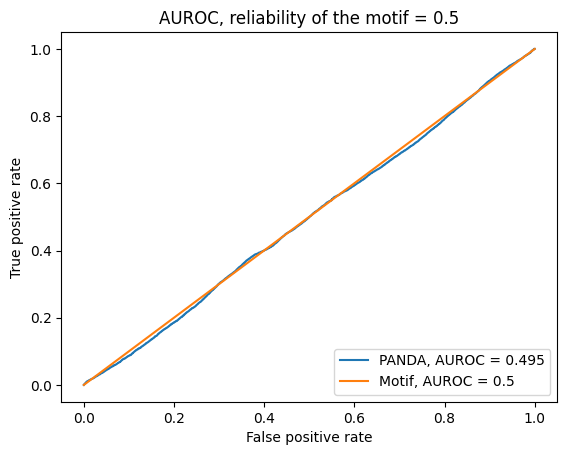

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6003991805076574
step: 1, hamming: 0.5945841435446222
step: 2, hamming: 0.7396069558413995
step: 3, hamming: 0.8274393906672146
step: 4, hamming: 0.8894340310172834
step: 5, hamming: 0.9323197946638654
step: 6, hamming: 0.9592890921691731
step: 7, hamming: 0.97304633291675
step: 8, hamming: 0.9760808699655994
step: 9, hamming: 0.9705395216662384
step: 10, hamming: 0.9581706935176767
step: 11, hamming: 0.9403532417839803
step: 12, hamming: 0.9181571338785739
step: 13, hamming: 0.8924054169769888
step: 14, hamming: 0.8637281714805412
step: 15, hamming: 0.8326083464227964
step: 16, hamming: 0.7994214263244669
step

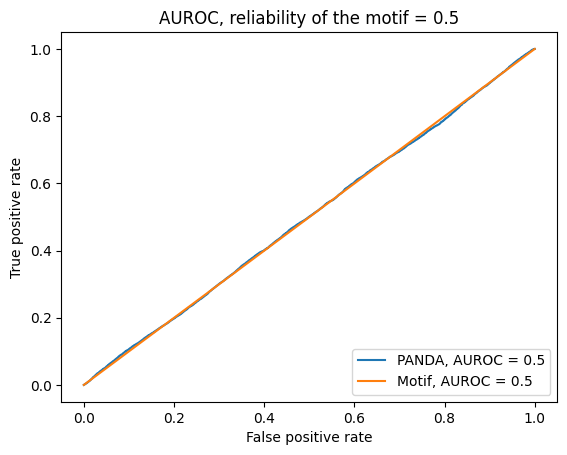

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 166
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6024333296072012
step: 1, hamming: 0.5888131368475401
step: 2, hamming: 0.7312335198040333
step: 3, hamming: 0.8160170748351321
step: 4, hamming: 0.8750292709330614
step: 5, hamming: 0.9149866692744117
step: 6, hamming: 0.9390714037153999
step: 7, hamming: 0.9500521914575659
step: 8, hamming: 0.950508872806138
step: 9, hamming: 0.9426431297211412
step: 10, hamming: 0.9281996528313806
step: 11, hamming: 0.9085075455558319
step: 12, hamming: 0.8845668656521359
step: 13, hamming: 0.8571342463798629
step: 14, hamming: 0.8267927262315481
step: 15, hamming: 0.7940052824181618
step: 16, hamming: 0.7591553620763695
ste

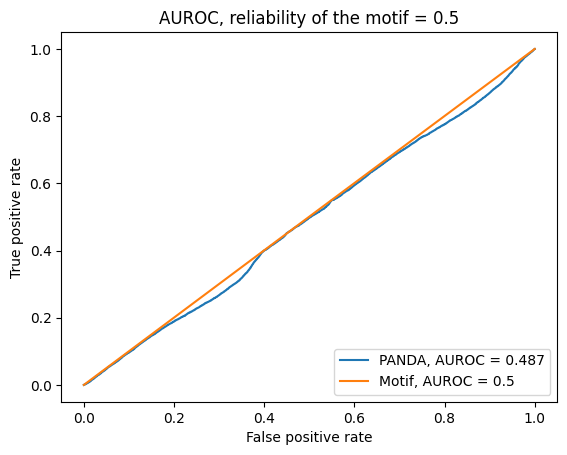

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 204
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6049188047191796
step: 1, hamming: 0.5970921127616486
step: 2, hamming: 0.7417450092566741
step: 3, hamming: 0.8296086483375396
step: 4, hamming: 0.8920703384742903
step: 5, hamming: 0.9358011350170056
step: 6, hamming: 0.9640092193491537
step: 7, hamming: 0.9794581044804906
step: 8, hamming: 0.9846770129191226
step: 9, hamming: 0.9818036485043468
step: 10, hamming: 0.9725284739664788
step: 11, hamming: 0.9581396251598739
step: 12, hamming: 0.9396028835463504
step: 13, hamming: 0.9176392474198602
step: 14, hamming: 0.8927886740254494
step: 15, hamming: 0.8654599898112678
step: 16, hamming: 0.8359698935834594
st

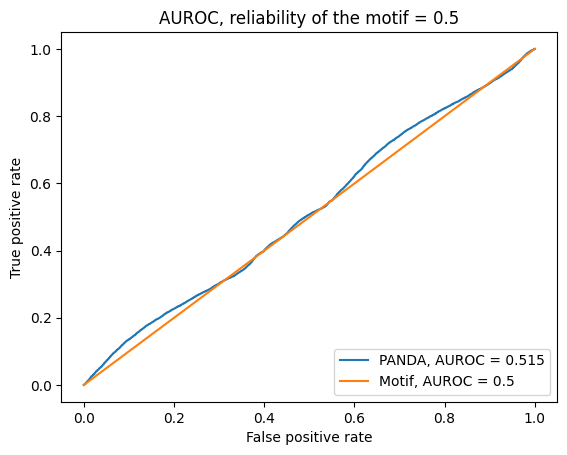

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 200
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5982376445080906
step: 1, hamming: 0.5881870399552883
step: 2, hamming: 0.7346153168381158
step: 3, hamming: 0.8235029433533896
step: 4, hamming: 0.8869402577968669
step: 5, hamming: 0.9317090565840943
step: 6, hamming: 0.9610097130991484
step: 7, hamming: 0.9775555760448057
step: 8, hamming: 0.9838243072721286
step: 9, hamming: 0.9819269556921382
step: 10, hamming: 0.9735617883403074
step: 11, hamming: 0.9600530268304833
step: 12, hamming: 0.9424169709249165
step: 13, hamming: 0.9214256276062742
step: 14, hamming: 0.897660169939767
step: 15, hamming: 0.8715551374066034
step: 16, hamming: 0.8434358488808897
ste

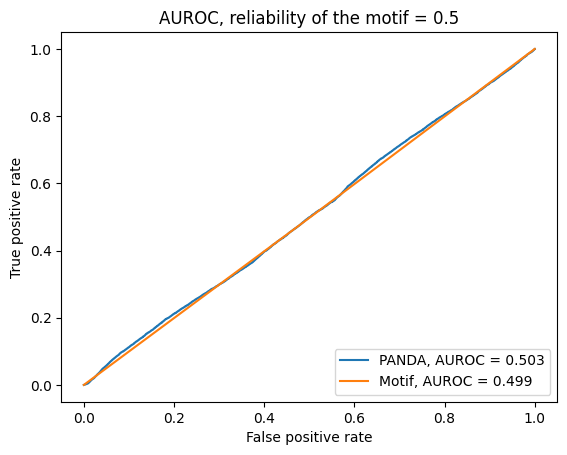

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5999157945194309
step: 1, hamming: 0.589684052589271
step: 2, hamming: 0.7282663485007561
step: 3, hamming: 0.8101269487714368
step: 4, hamming: 0.8657299588236369
step: 5, hamming: 0.9015700721057779
step: 6, hamming: 0.920733081175905
step: 7, hamming: 0.9258845300979176
step: 8, hamming: 0.9195325132606633
step: 9, hamming: 0.9038893579256874
step: 10, hamming: 0.8808058695387454
step: 11, hamming: 0.8518008831080479
step: 12, hamming: 0.8181278900878748
step: 13, hamming: 0.7808362983553301
step: 14, hamming: 0.7408153791836602
step: 15, hamming: 0.6988253182577494
step: 16, hamming: 0.6555215200830633
step

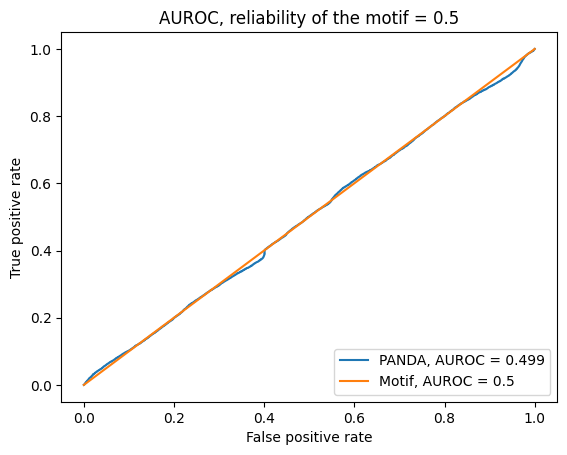

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 176
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5949326601179888
step: 1, hamming: 0.5964350848209617
step: 2, hamming: 0.7368017435470829
step: 3, hamming: 0.8209439630327799
step: 4, hamming: 0.8793634203832388
step: 5, hamming: 0.9185925164978322
step: 6, hamming: 0.941783259668083
step: 7, hamming: 0.9516983697134015
step: 8, hamming: 0.9509032125291803
step: 9, hamming: 0.9415971094417671
step: 10, hamming: 0.9255492691852645
step: 11, hamming: 0.9041342377656901
step: 12, hamming: 0.8784056451114464
step: 13, hamming: 0.84917221325979
step: 14, hamming: 0.8170627286704921
step: 15, hamming: 0.7825780918099727
step: 16, hamming: 0.7461323547398906
step:

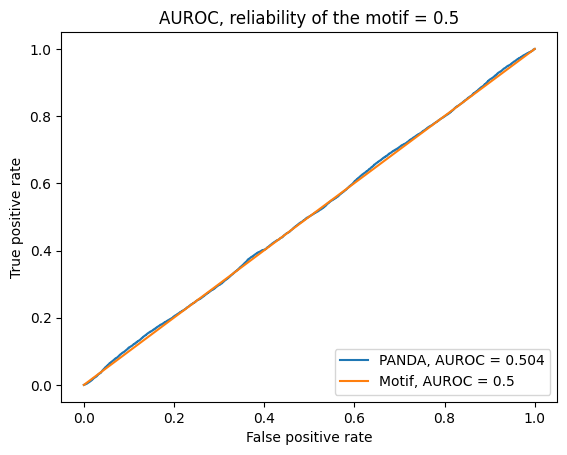

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 190
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6069126548824825
step: 1, hamming: 0.5912868391579165
step: 2, hamming: 0.7328543904209336
step: 3, hamming: 0.8177251570787865
step: 4, hamming: 0.8767729541341818
step: 5, hamming: 0.916522162856959
step: 6, hamming: 0.9400674784482693
step: 7, hamming: 0.9500756363117507
step: 8, hamming: 0.9489988706983227
step: 9, hamming: 0.9389344301458806
step: 10, hamming: 0.9215855752969949
step: 11, hamming: 0.8983137900830268
step: 12, hamming: 0.8702166857474289
step: 13, hamming: 0.838197723628569
step: 14, hamming: 0.8030179950311057
step: 15, hamming: 0.7653312685362732
step: 16, hamming: 0.7257073354737247
step

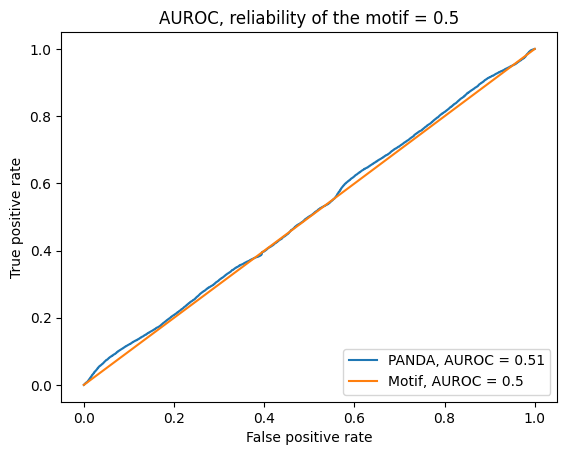

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 204
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6051825620816179
step: 1, hamming: 0.5962519001090887
step: 2, hamming: 0.7391445705687264
step: 3, hamming: 0.8252245332367931
step: 4, hamming: 0.8856347687485349
step: 5, hamming: 0.9269565059721533
step: 6, hamming: 0.9523491074860113
step: 7, hamming: 0.9645431219897902
step: 8, hamming: 0.9660519632479613
step: 9, hamming: 0.9590158190091951
step: 10, hamming: 0.9451514799277062
step: 11, hamming: 0.9258003130307777
step: 12, hamming: 0.9020058358222965
step: 13, hamming: 0.8745845278792475
step: 14, hamming: 0.8441809249000658
step: 15, hamming: 0.8113094171918429
step: 16, hamming: 0.7763874929099076
st

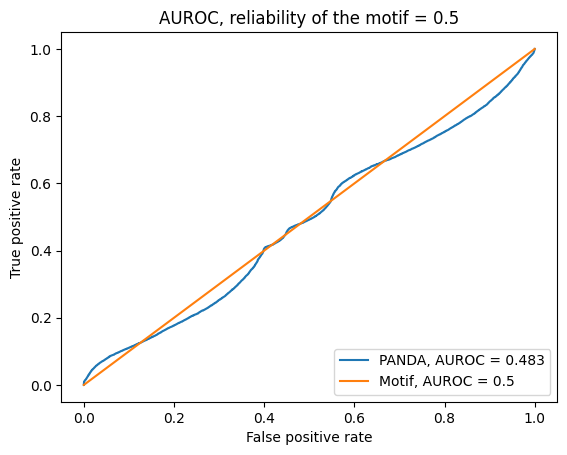

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 154
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5990164900828964
step: 1, hamming: 0.5878655188211299
step: 2, hamming: 0.7308760257148132
step: 3, hamming: 0.8160996445024074
step: 4, hamming: 0.8752877607109066
step: 5, hamming: 0.9152018533661591
step: 6, hamming: 0.9390317116248861
step: 7, hamming: 0.9495035044918706
step: 8, hamming: 0.9491604181090306
step: 9, hamming: 0.9402187955394165
step: 10, hamming: 0.9244887047985682
step: 11, hamming: 0.903389844268682
step: 12, hamming: 0.8780126027056276
step: 13, hamming: 0.8491885453063323
step: 14, hamming: 0.8175549920973256
step: 15, hamming: 0.7836094006823696
step: 16, hamming: 0.747753659835725
step

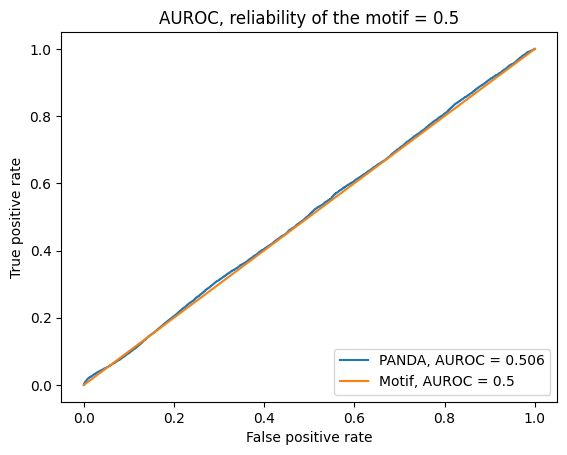

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 182
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6007261382973019
step: 1, hamming: 0.5871250587689688
step: 2, hamming: 0.7277925319143678
step: 3, hamming: 0.8114639865350397
step: 4, hamming: 0.8691961819603763
step: 5, hamming: 0.9074765418107587
step: 6, hamming: 0.9293014773120617
step: 7, hamming: 0.9372462372594031
step: 8, hamming: 0.9336521864289422
step: 9, hamming: 0.9204626821111845
step: 10, hamming: 0.8991816067112691
step: 11, hamming: 0.8709404000069929
step: 12, hamming: 0.8366081513279828
step: 13, hamming: 0.79691026615211
step: 14, hamming: 0.7525386995712092
step: 15, hamming: 0.7042409587512543
step: 16, hamming: 0.6528766633819983
step

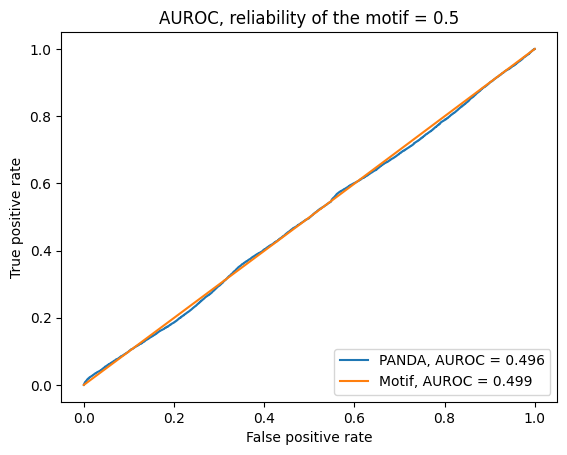

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 256
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6130820003396207
step: 1, hamming: 0.5967330586503407
step: 2, hamming: 0.737453184352017
step: 3, hamming: 0.8220096454575143
step: 4, hamming: 0.8806417783051648
step: 5, hamming: 0.9199298552262446
step: 6, hamming: 0.9429326879702861
step: 7, hamming: 0.9522319706207014
step: 8, hamming: 0.9501868229751864
step: 9, hamming: 0.9387693289253881
step: 10, hamming: 0.9194919984496039
step: 11, hamming: 0.8934639226844971
step: 12, hamming: 0.861500830419972
step: 13, hamming: 0.8242453549510739
step: 14, hamming: 0.7822793327739159
step: 15, hamming: 0.7362177377232557
step: 16, hamming: 0.6867752687510754
step

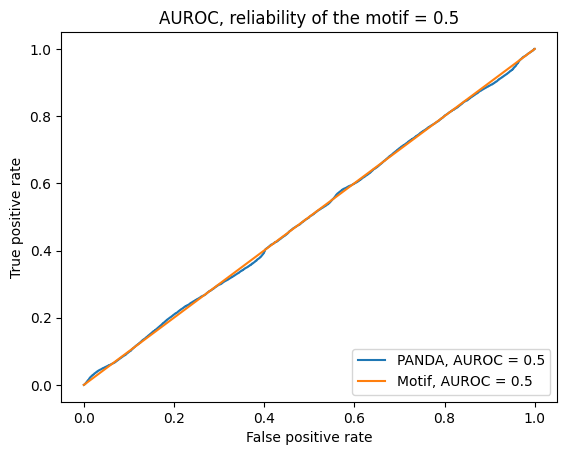

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 174
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6021555856938424
step: 1, hamming: 0.5971388117680085
step: 2, hamming: 0.7393571274185493
step: 3, hamming: 0.825068279014438
step: 4, hamming: 0.8851509761158
step: 5, hamming: 0.9262608317807639
step: 6, hamming: 0.9516380327121192
step: 7, hamming: 0.964091388531539
step: 8, hamming: 0.9662147265566227
step: 9, hamming: 0.960215437521326
step: 10, hamming: 0.9478377965540564
step: 11, hamming: 0.9304017268469151
step: 12, hamming: 0.9088885952236695
step: 13, hamming: 0.884027301553159
step: 14, hamming: 0.8563647623586094
step: 15, hamming: 0.8263200542654475
step: 16, hamming: 0.7942256244574288
step: 17,

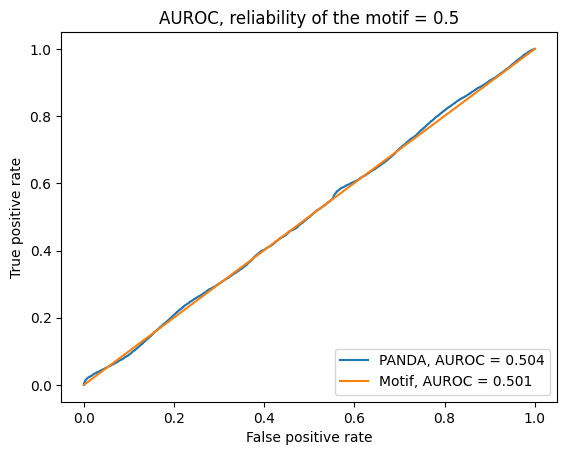

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 212
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6044395057498828
step: 1, hamming: 0.5930557987401858
step: 2, hamming: 0.7259851402782519
step: 3, hamming: 0.8039557901157314
step: 4, hamming: 0.8558005828264387
step: 5, hamming: 0.8877558169729992
step: 6, hamming: 0.9027858809000855
step: 7, hamming: 0.9035542434150828
step: 8, hamming: 0.8925978694412966
step: 9, hamming: 0.8721535106205829
step: 10, hamming: 0.8440921519954389
step: 11, hamming: 0.8099600199275526
step: 12, hamming: 0.7710566391368335
step: 13, hamming: 0.7285077765320525
step: 14, hamming: 0.6833182930581932
step: 15, hamming: 0.6364032970075649
step: 16, hamming: 0.5886018710604143
st

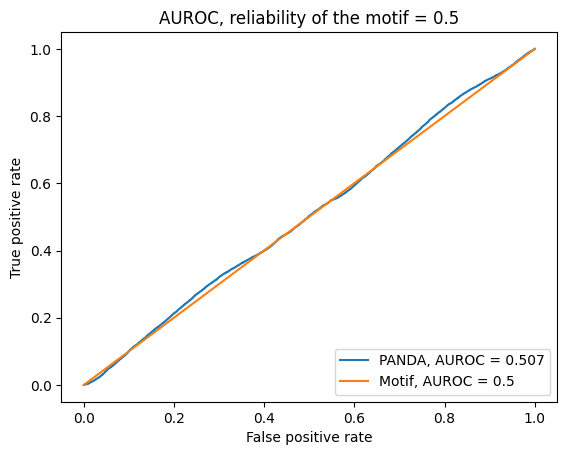

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 222
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6083882070805531
step: 1, hamming: 0.5933759731300717
step: 2, hamming: 0.7378446377240552
step: 3, hamming: 0.8251536720611206
step: 4, hamming: 0.886791826204781
step: 5, hamming: 0.9294669975554657
step: 6, hamming: 0.9563308049352675
step: 7, hamming: 0.9700643269260454
step: 8, hamming: 0.9731274679322957
step: 9, hamming: 0.9676122410582855
step: 10, hamming: 0.955193190872598
step: 11, hamming: 0.9371768502967099
step: 12, hamming: 0.9145815868412602
step: 13, hamming: 0.8882097611595664
step: 14, hamming: 0.8587026116964234
step: 15, hamming: 0.8265801759194435
step: 16, hamming: 0.7922712050401913
step

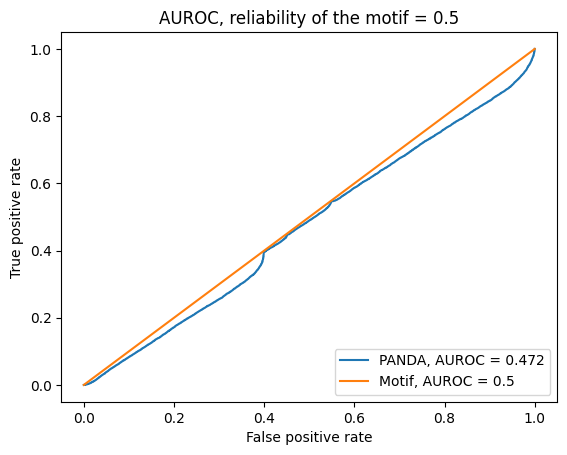

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 186
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5985198226631162
step: 1, hamming: 0.5876881712661177
step: 2, hamming: 0.7287812778667399
step: 3, hamming: 0.8130300192336646
step: 4, hamming: 0.8713836631232292
step: 5, hamming: 0.9104567163037935
step: 6, hamming: 0.9333550366399178
step: 7, hamming: 0.9427643023466826
step: 8, hamming: 0.9412032842964569
step: 9, hamming: 0.930857153165911
step: 10, hamming: 0.9135094858613673
step: 11, hamming: 0.8905795492237337
step: 12, hamming: 0.863191240851874
step: 13, hamming: 0.8322363421663953
step: 14, hamming: 0.7984257458997434
step: 15, hamming: 0.7623319747087328
step: 16, hamming: 0.7244260568182634
step

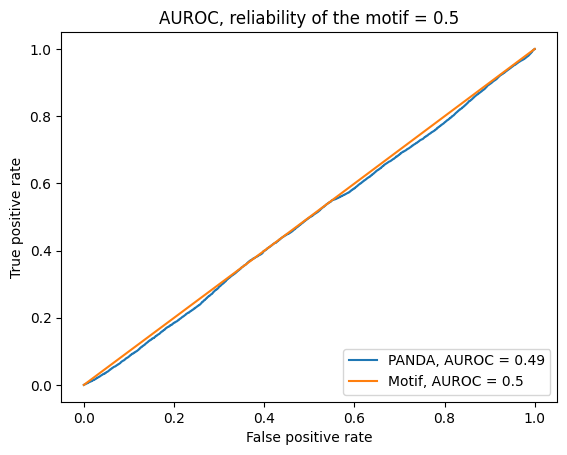

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 192
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5967613378273816
step: 1, hamming: 0.588632444723978
step: 2, hamming: 0.7328676674621393
step: 3, hamming: 0.8202025706443856
step: 4, hamming: 0.882105857787159
step: 5, hamming: 0.9253045053251427
step: 6, hamming: 0.9530350036801496
step: 7, hamming: 0.9681013546142171
step: 8, hamming: 0.9730539787603167
step: 9, hamming: 0.9700253729402861
step: 10, hamming: 0.9606865687669996
step: 11, hamming: 0.946303179474324
step: 12, hamming: 0.9278212817068431
step: 13, hamming: 0.905947342749337
step: 14, hamming: 0.881212393387583
step: 15, hamming: 0.8540213803290664
step: 16, hamming: 0.8246911361847512
step: 1

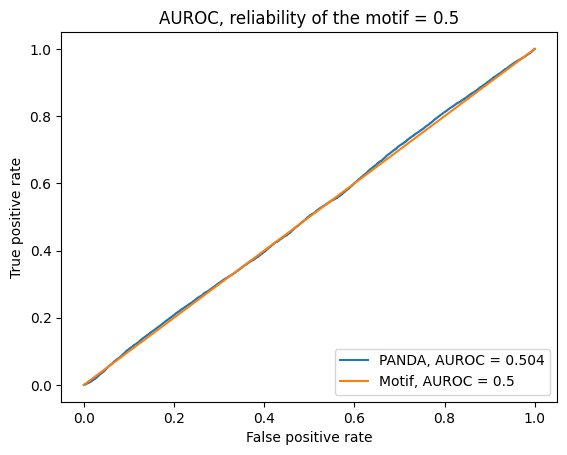

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 198
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6048506472634324
step: 1, hamming: 0.6015857566504172
step: 2, hamming: 0.7473807740366651
step: 3, hamming: 0.8362450103242922
step: 4, hamming: 0.8995831508642921
step: 5, hamming: 0.9441070701597254
step: 6, hamming: 0.9730590188950607
step: 7, hamming: 0.989242622241354
step: 8, hamming: 0.9951732633570839
step: 9, hamming: 0.9929085094209227
step: 10, hamming: 0.984030174315837
step: 11, hamming: 0.9697342366863505
step: 12, hamming: 0.9509404822403728
step: 13, hamming: 0.9283804103468237
step: 14, hamming: 0.9026545676944215
step: 15, hamming: 0.8742641756849335
step: 16, hamming: 0.843626446650383
step:

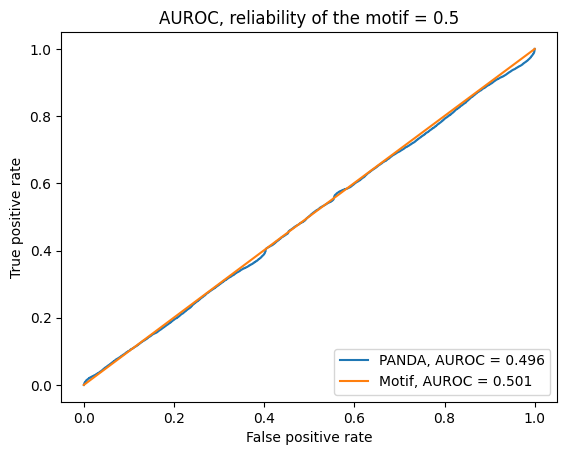

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6034310141451873
step: 1, hamming: 0.5828035465233674
step: 2, hamming: 0.7142998990364481
step: 3, hamming: 0.7902550587399019
step: 4, hamming: 0.8400512271664002
step: 5, hamming: 0.8701471520118104
step: 6, hamming: 0.8835168947915181
step: 7, hamming: 0.8827177209071553
step: 8, hamming: 0.8702469866079089
step: 9, hamming: 0.8483768166439853
step: 10, hamming: 0.8190293874853092
step: 11, hamming: 0.7837788866672964
step: 12, hamming: 0.7439249738044659
step: 13, hamming: 0.7005824172716419
step: 14, hamming: 0.6547489463777271
step: 15, hamming: 0.6073434875118924
step: 16, hamming: 0.5592204921380752
st

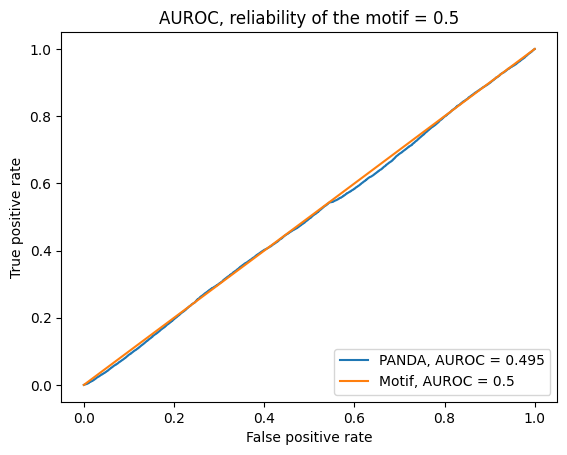

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 194
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.03 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5981256460592909
step: 1, hamming: 0.5868235224639051
step: 2, hamming: 0.7289300994845245
step: 3, hamming: 0.8140415660948467
step: 4, hamming: 0.8734804371384204
step: 5, hamming: 0.9138670811273352
step: 6, hamming: 0.9382846004263105
step: 7, hamming: 0.9493677302819145
step: 8, hamming: 0.9495189623486837
step: 9, hamming: 0.9407578665629359
step: 10, hamming: 0.9246594801520325
step: 11, hamming: 0.9024083804067544
step: 12, hamming: 0.8749013434487148
step: 13, hamming: 0.8428523723456887
step: 14, hamming: 0.8068803515647635
step: 15, hamming: 0.7675732338493655
step: 16, hamming: 0.72552809696079
step

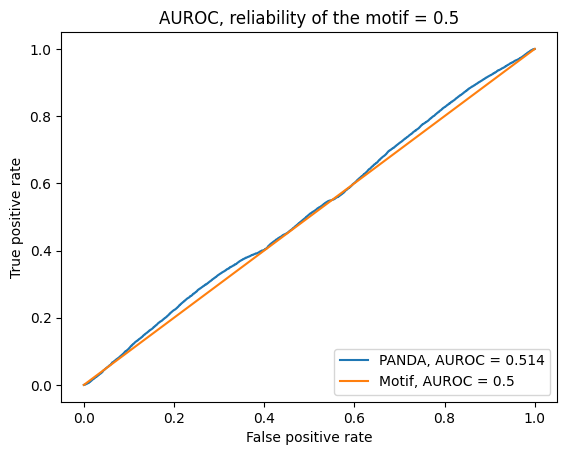

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 166
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6018443343982253
step: 1, hamming: 0.5898044349025278
step: 2, hamming: 0.7278497137484264
step: 3, hamming: 0.8091562696601374
step: 4, hamming: 0.8645655097048535
step: 5, hamming: 0.9005661994080965
step: 6, hamming: 0.9202104734984069
step: 7, hamming: 0.9262094988651778
step: 8, hamming: 0.9211350712385264
step: 9, hamming: 0.907214190888318
step: 10, hamming: 0.8862443736058682
step: 11, hamming: 0.8596357382942086
step: 12, hamming: 0.8285008530722048
step: 13, hamming: 0.7937408105641949
step: 14, hamming: 0.7561098487920642
step: 15, hamming: 0.7162590842112837
step: 16, hamming: 0.6747654009520362
ste

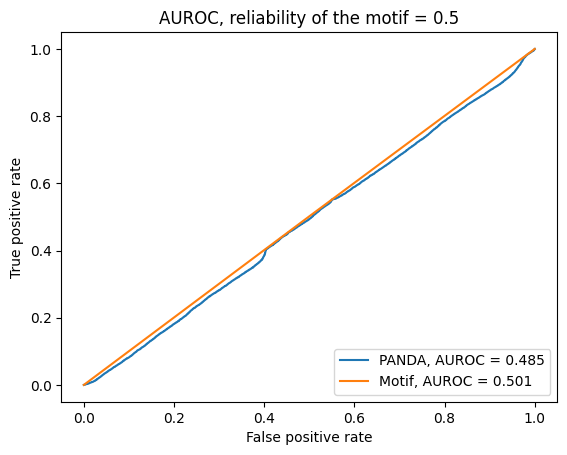

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 204
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.6034658913325126
step: 1, hamming: 0.5856341711124894
step: 2, hamming: 0.7225295056708219
step: 3, hamming: 0.8030409878770797
step: 4, hamming: 0.8576602734135836
step: 5, hamming: 0.8928537626985789
step: 6, hamming: 0.9116258720790906
step: 7, hamming: 0.9166095151119287
step: 8, hamming: 0.9102961978245964
step: 9, hamming: 0.894830914855616
step: 10, hamming: 0.8719257833323302
step: 11, hamming: 0.8429163897303954
step: 12, hamming: 0.808855508307293
step: 13, hamming: 0.7706132908391191
step: 14, hamming: 0.7289598293713966
step: 15, hamming: 0.6846243222706639
step: 16, hamming: 0.6383306621908049
step

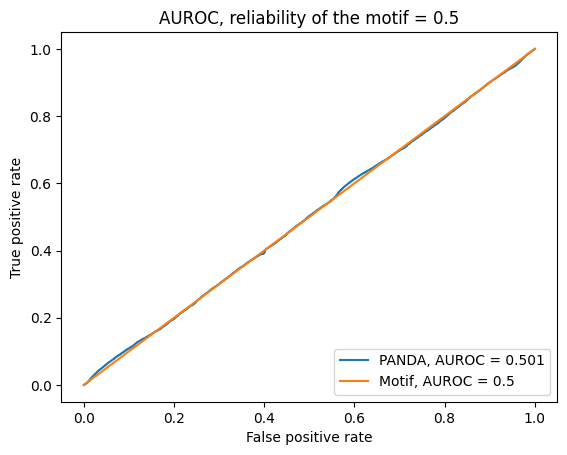

Loading motif data ...
  Elapsed time: 0.01 sec.
Loading PPI data ...
Number of PPIs: 144
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.01 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.594377997336486
step: 1, hamming: 0.5935109965334074
step: 2, hamming: 0.736785867024211
step: 3, hamming: 0.8228868276619026
step: 4, hamming: 0.8832427630699613
step: 5, hamming: 0.9244118618076363
step: 6, hamming: 0.9495017615007659
step: 7, hamming: 0.9611626652392371
step: 8, hamming: 0.9617966086717767
step: 9, hamming: 0.9533958418658696
step: 10, hamming: 0.9375074795121102
step: 11, hamming: 0.9153087670190242
step: 12, hamming: 0.8877145846292949
step: 13, hamming: 0.8554775470051006
step: 14, hamming: 0.8192680490041279
step: 15, hamming: 0.7797308119094435
step: 16, hamming: 0.7375172070847428
step

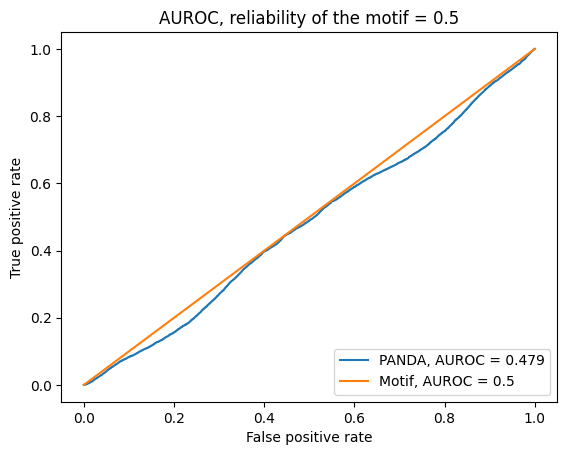

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 162
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
Normalizing networks ...
  Elapsed time: 0.02 sec.
Running PANDA algorithm ...
step: 0, hamming: 0.5999804665658738
step: 1, hamming: 0.5932564184191567
step: 2, hamming: 0.7368832169654729
step: 3, hamming: 0.8231699820060918
step: 4, hamming: 0.883535958569872
step: 5, hamming: 0.9245466934860873
step: 6, hamming: 0.9492933888742053
step: 7, hamming: 0.960425517297684
step: 8, hamming: 0.9604011806222821
step: 9, hamming: 0.9513437481602813
step: 10, hamming: 0.934988589188625
step: 11, hamming: 0.9127238568010853
step: 12, hamming: 0.8856595107001656
step: 13, hamming: 0.8546904977706244
step: 14, hamming: 0.8205469409254684
step: 15, hamming: 0.7838336180708161
step: 16, hamming: 0.7450621841193865
step:

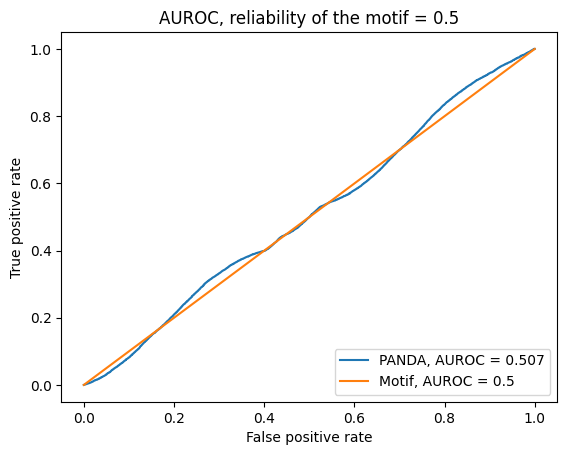

In [11]:
B = 50
res_panda = {}
shuffling = [0.01, 0.1, 0.2, 0.3, 0.4, 0.5]
for shuffle in shuffling:
    print(shuffle)
    for i in range(B):
        score = simulation(shuffling = shuffle)[0]
        if shuffle in res_panda.keys():
            res_panda[shuffle] += [score]
        else:
            res_panda[shuffle] = [score]

In [12]:
for shuffle in shuffling:
    print(f"Prior reliability {1 - shuffle}: mean {np.mean(res_panda[shuffle])}, sd {np.std(res_panda[shuffle])}")

Prior reliability 0.99: mean 0.9941999999999999, sd 0.001019803902718558
Prior reliability 0.9: mean 0.9469399999999999, sd 0.005869957410407664
Prior reliability 0.8: mean 0.89196, sd 0.01093976233745506
Prior reliability 0.7: mean 0.8206600000000001, sd 0.010195312648467415
Prior reliability 0.6: mean 0.7232999999999998, sd 0.009794386147176358
Prior reliability 0.5: mean 0.49760000000000004, sd 0.011859173664298884


## GENIE3

In [6]:
def simulation(n = 50, shuffling = 0.2, sparsity = .15, a = 1, approx = True):
    ppi = generate_ppi(TF)
    TFA = generate_tfa(ppi, n)
    R = generate_regulation(G, TF, ppi, sparsity = sparsity, a = a)
    gene_expression = compute_expression(R, TFA)
    motif = generate_motif(R, shuffling)

    model = notebooks.GENIE3((np.vstack([gene_expression, TFA]) + np.random.uniform(0, 1e-3, (600, 50))).T)[0:500, 500:]
    return notebooks.plot_auroc(R, [model, motif], ["GENIE3", "Motif"], title = "AUROC, reliability of the motif = " + str(1 - shuffling), approx = approx)

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

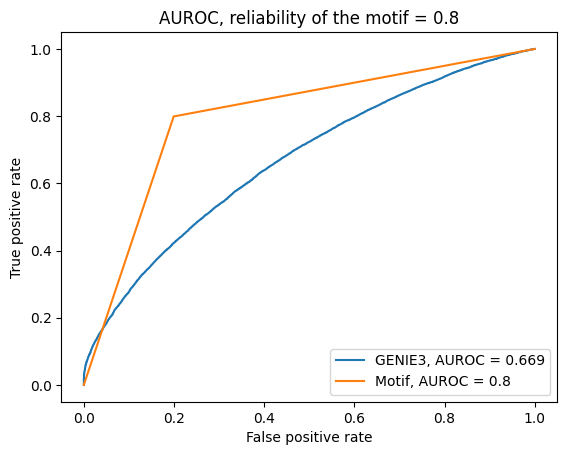

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

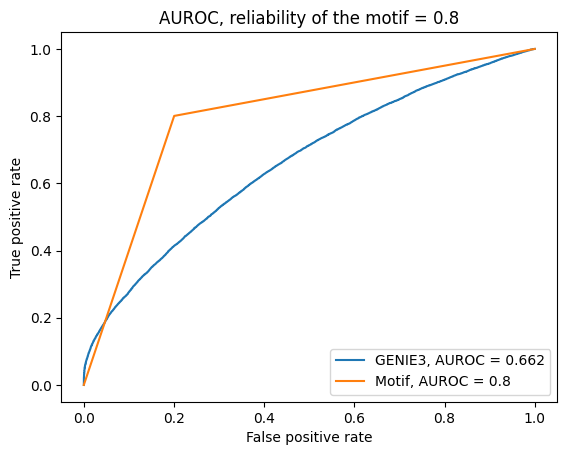

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

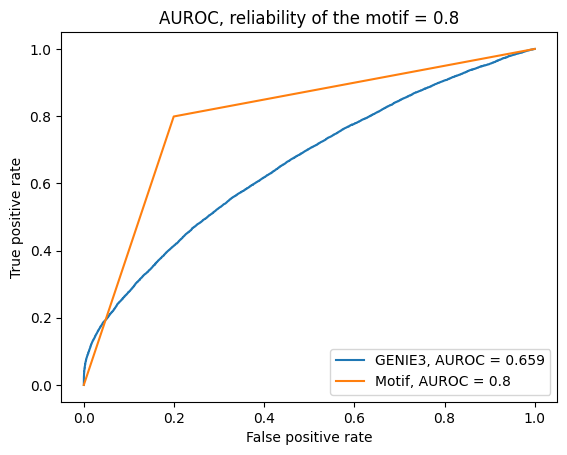

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

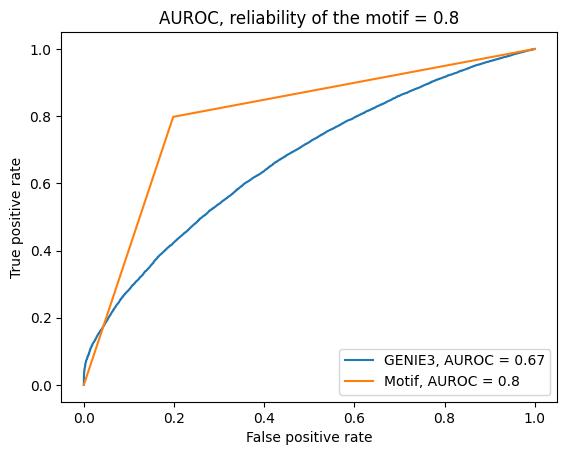

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

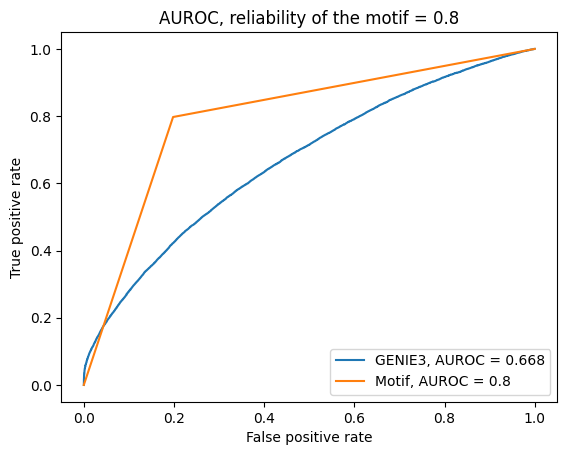

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

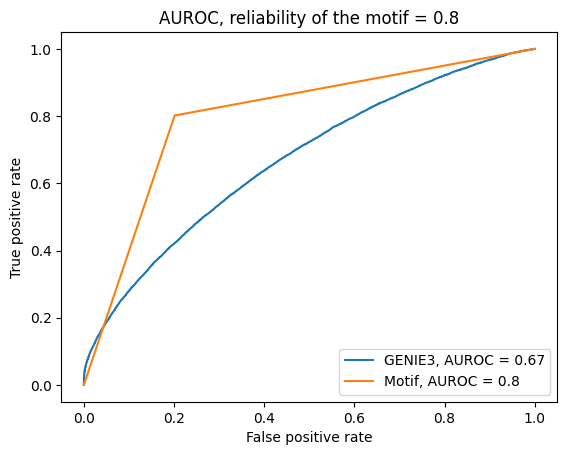

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

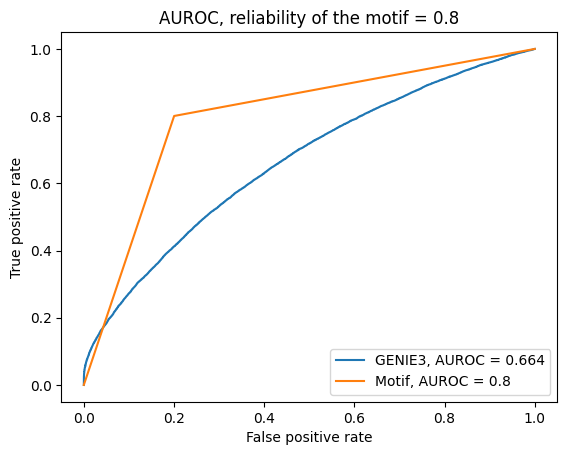

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

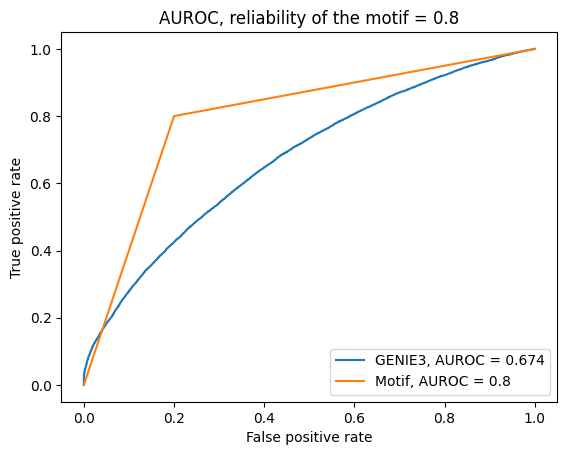

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

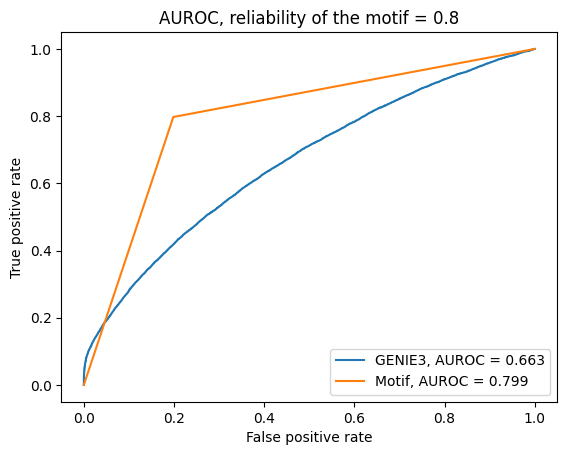

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

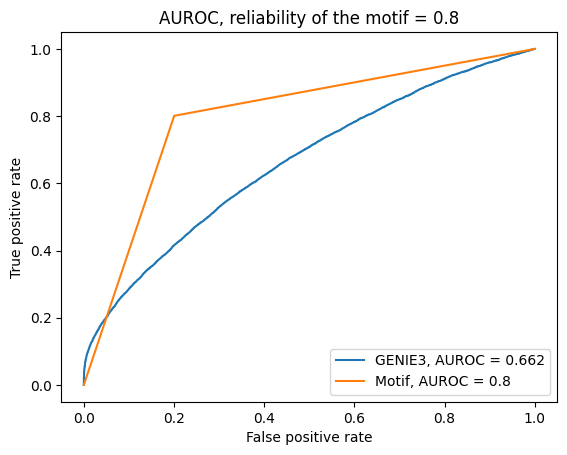

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

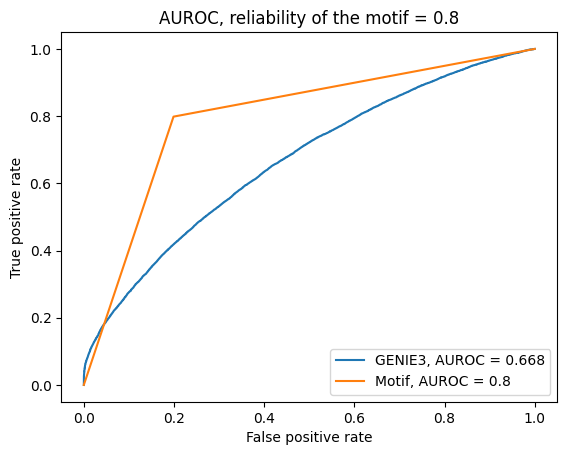

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

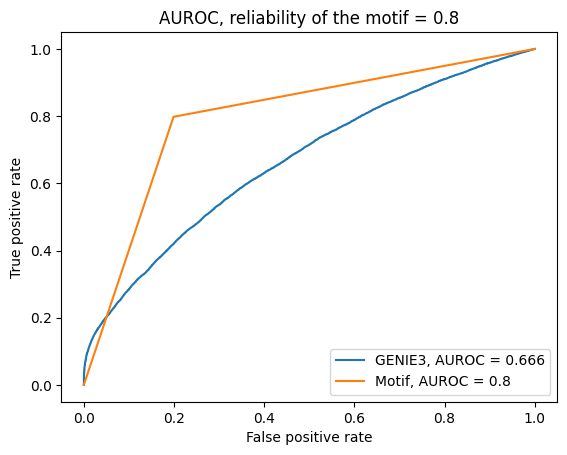

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

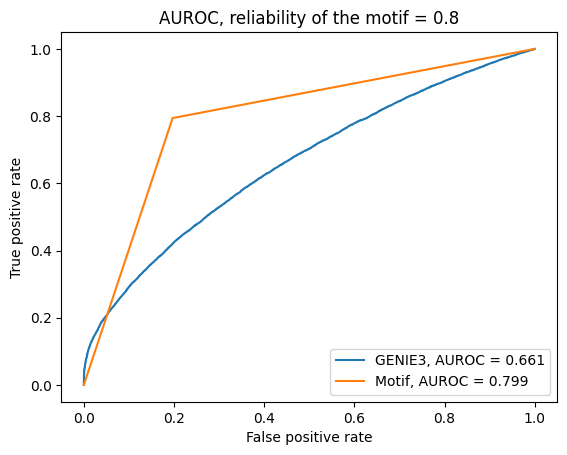

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

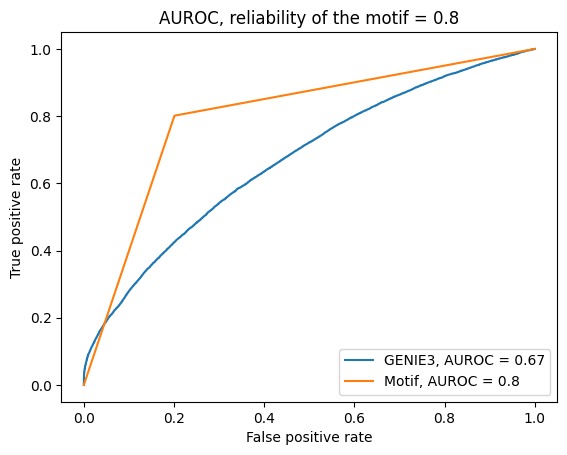

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

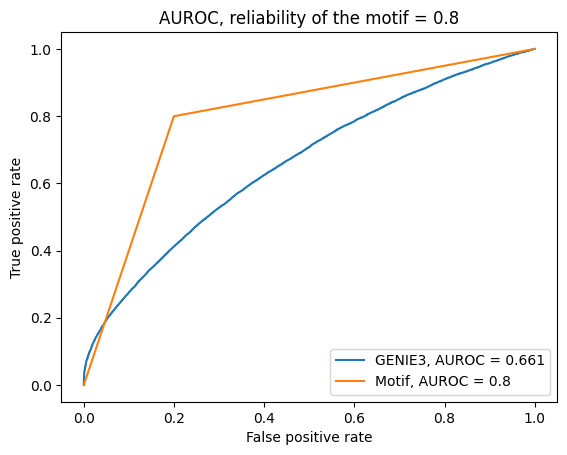

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

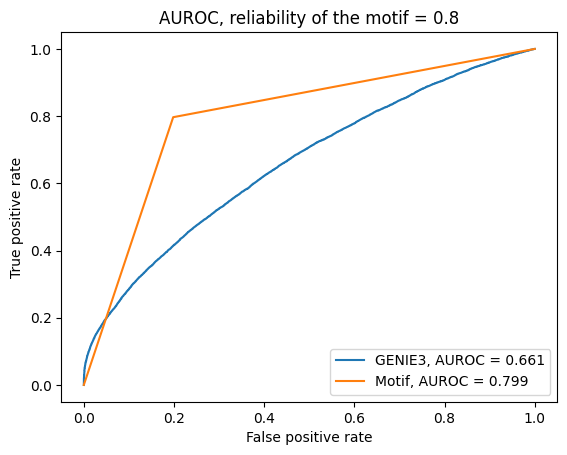

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

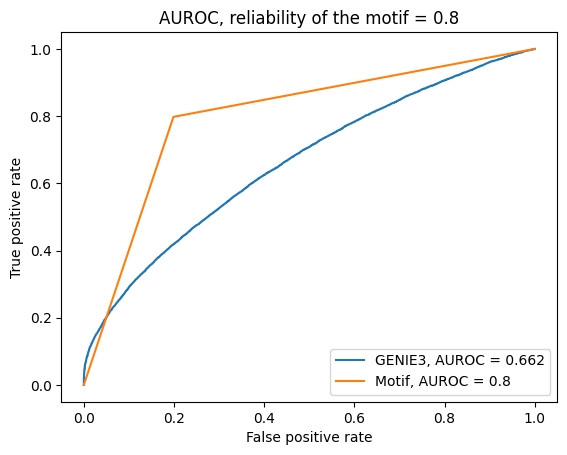

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

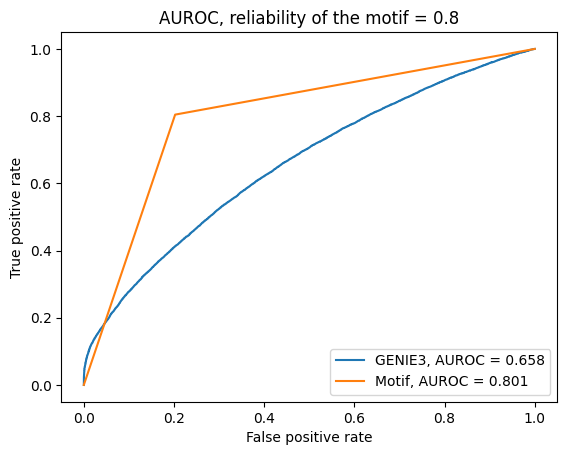

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

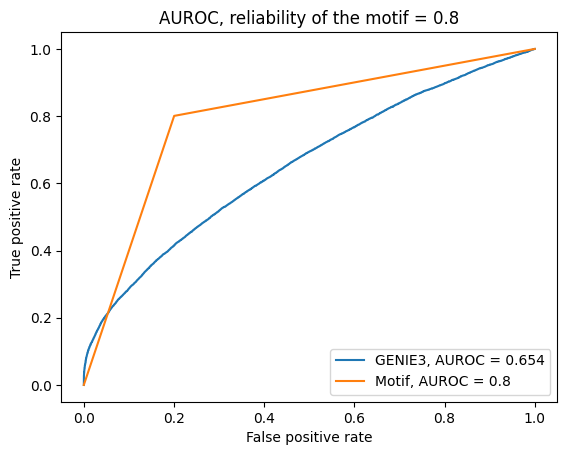

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

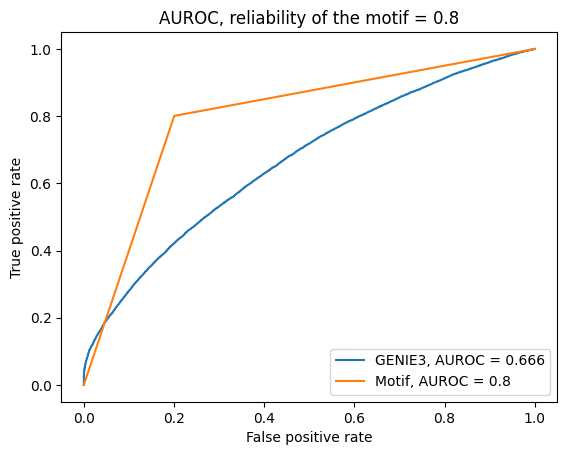

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

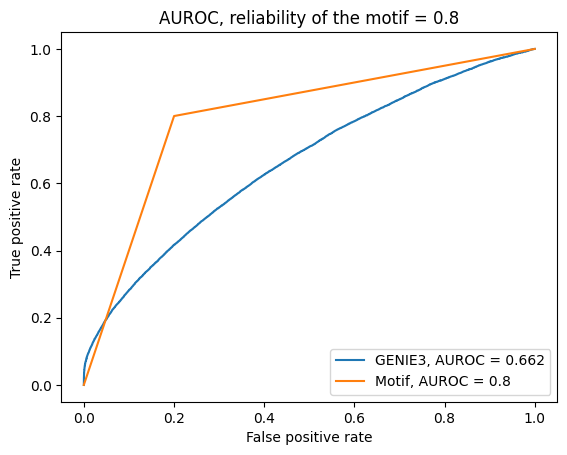

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

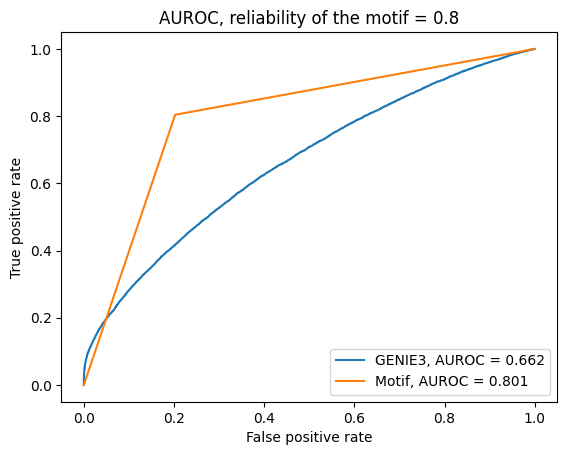

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

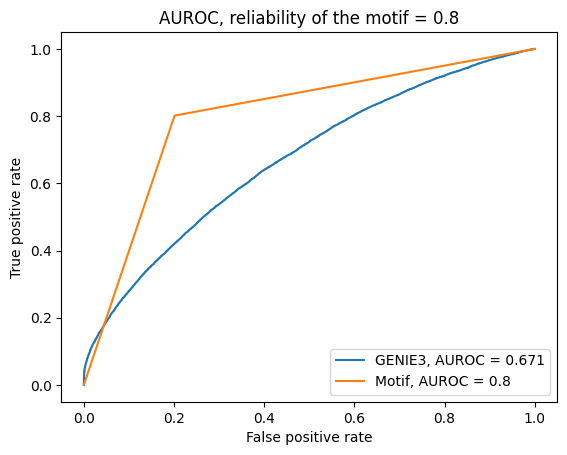

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

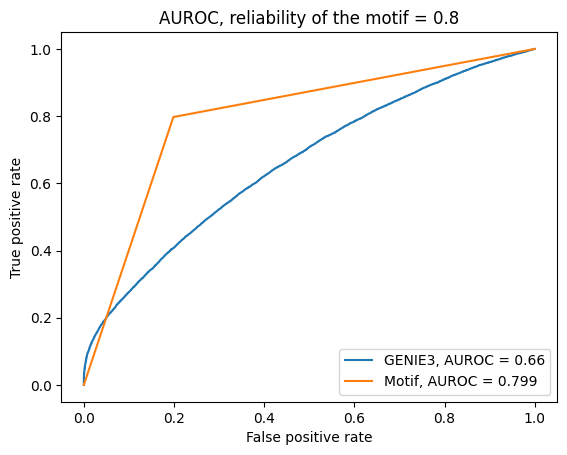

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

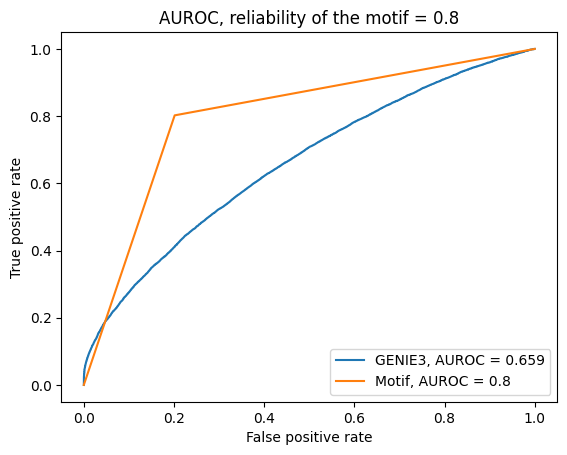

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

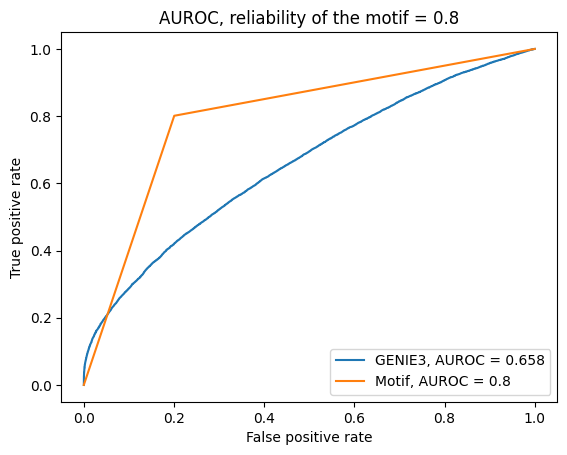

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

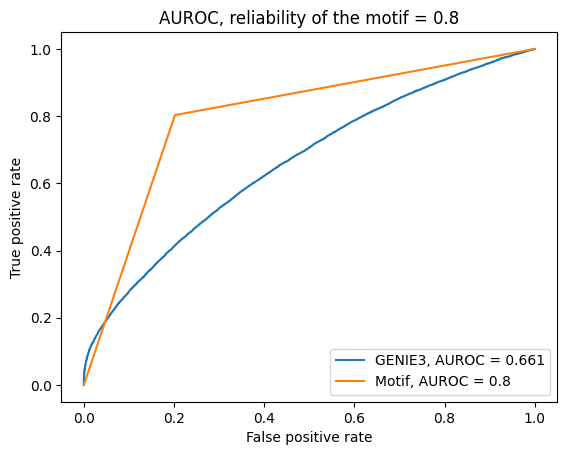

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

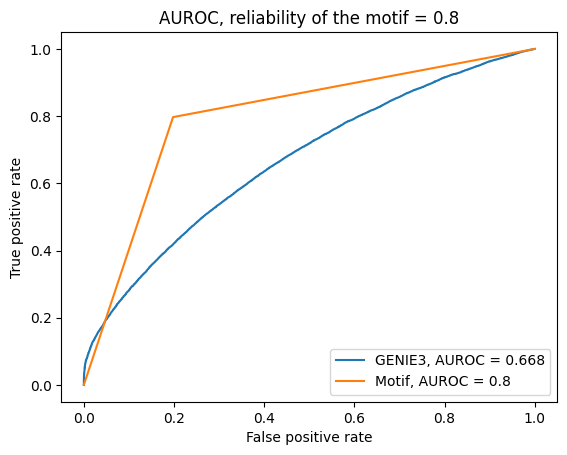

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

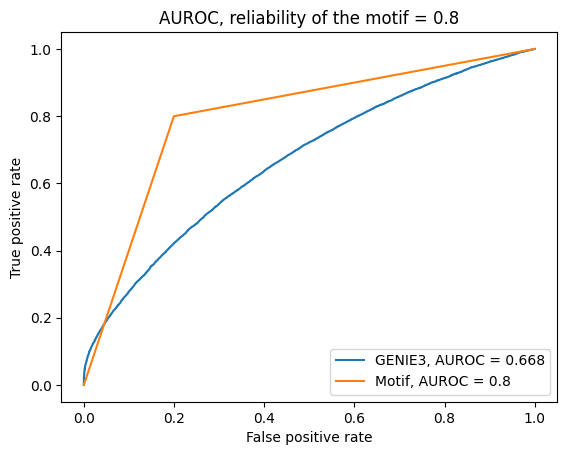

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

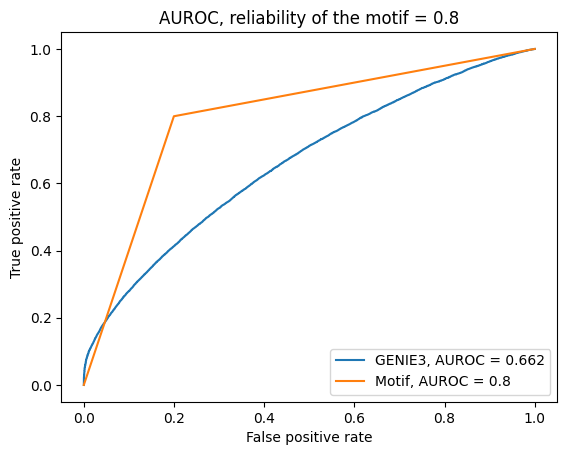

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

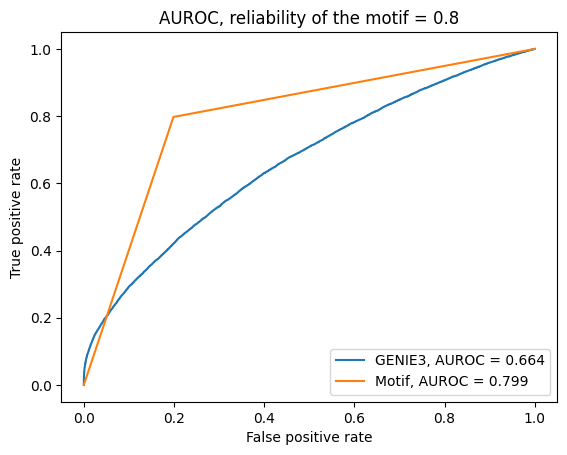

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

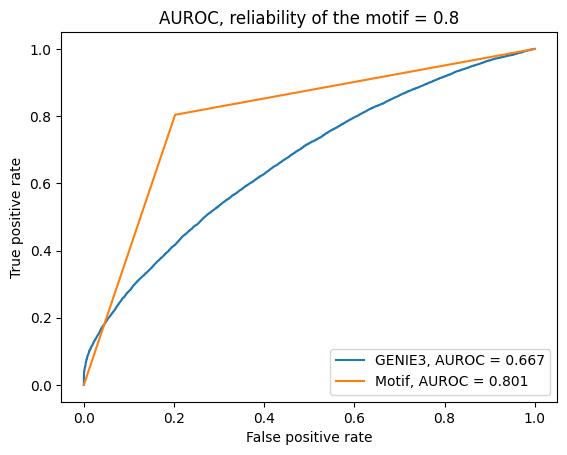

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

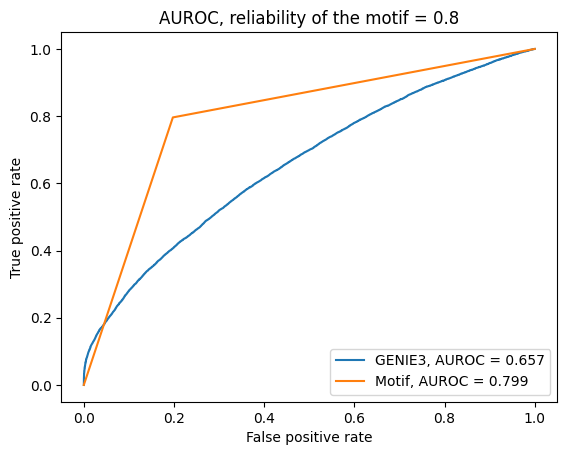

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

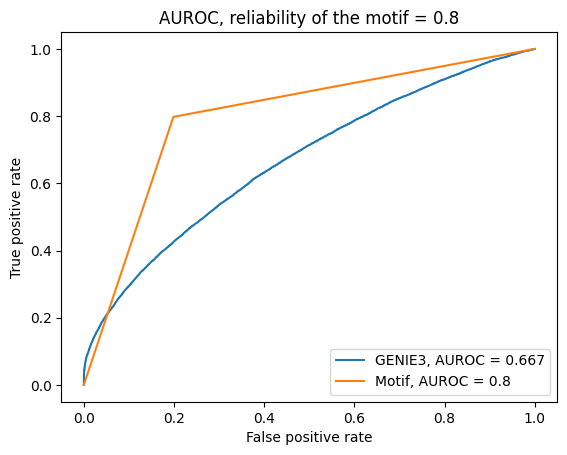

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

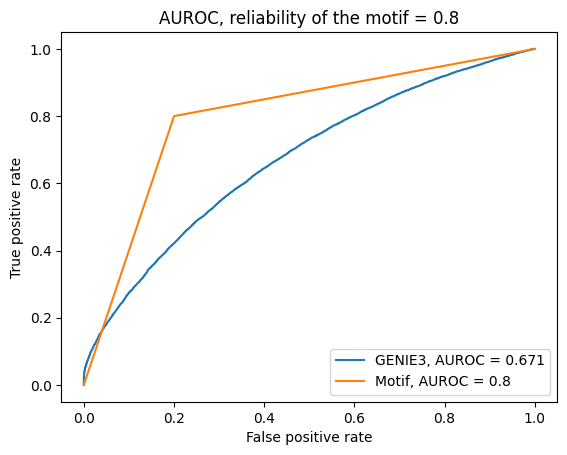

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

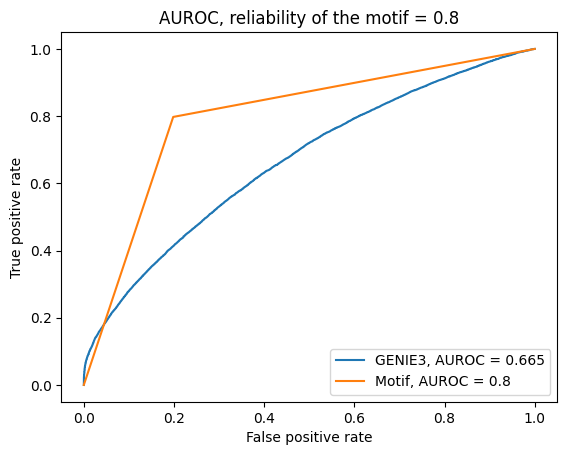

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

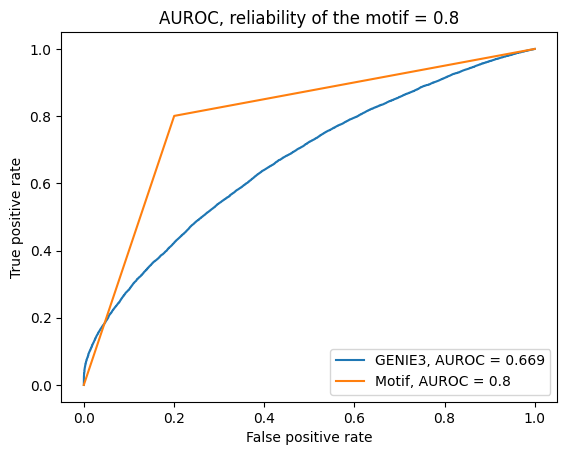

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

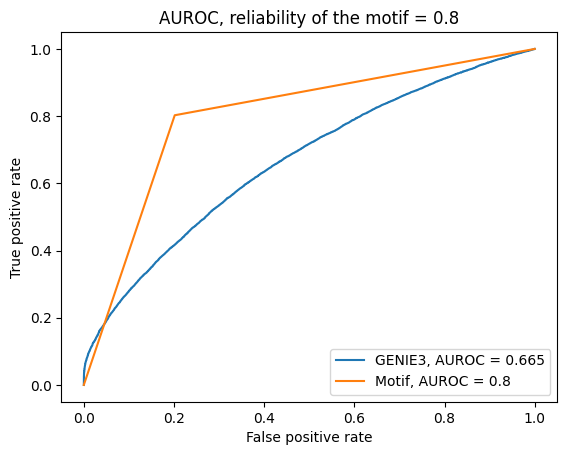

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

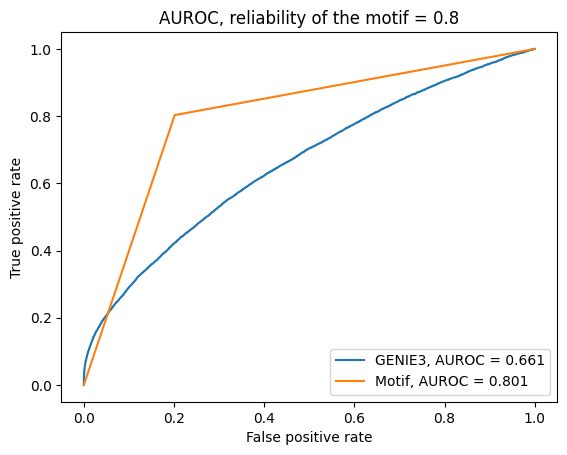

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

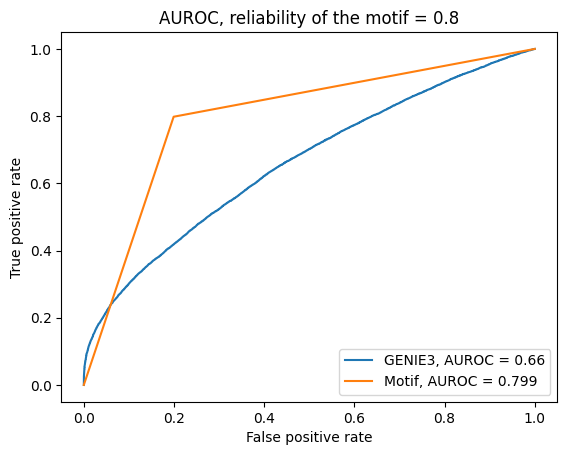

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

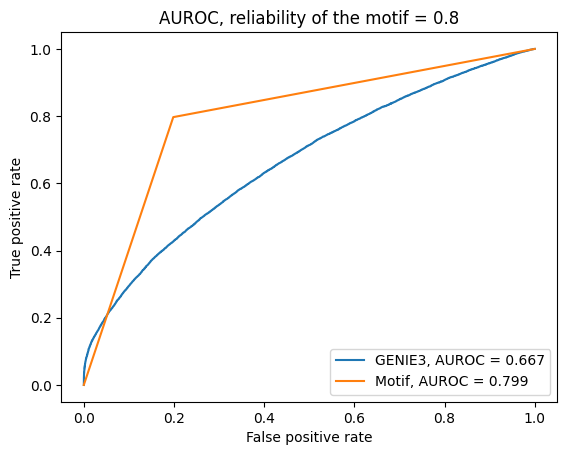

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

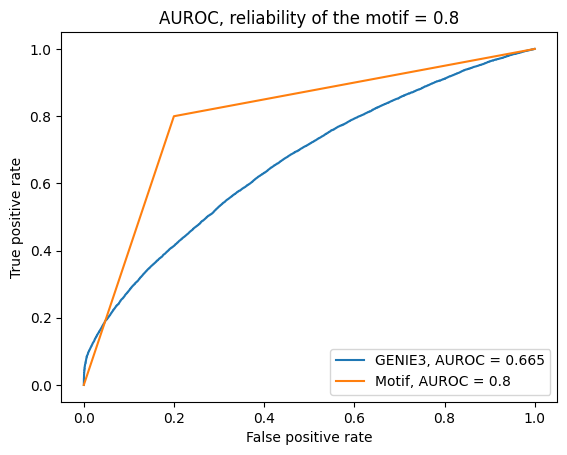

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

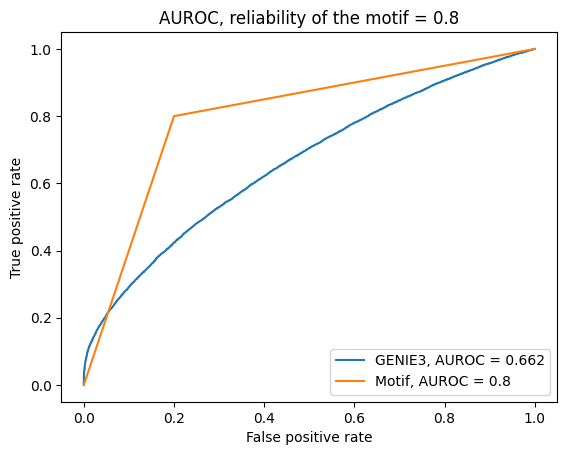

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

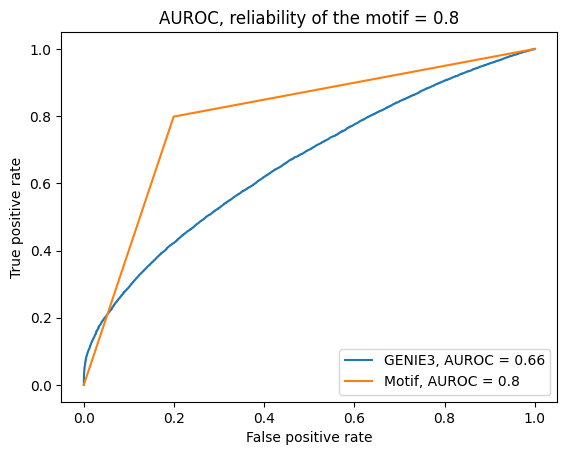

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

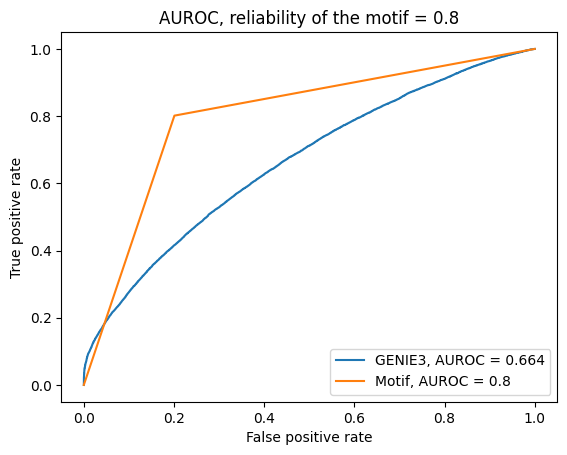

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

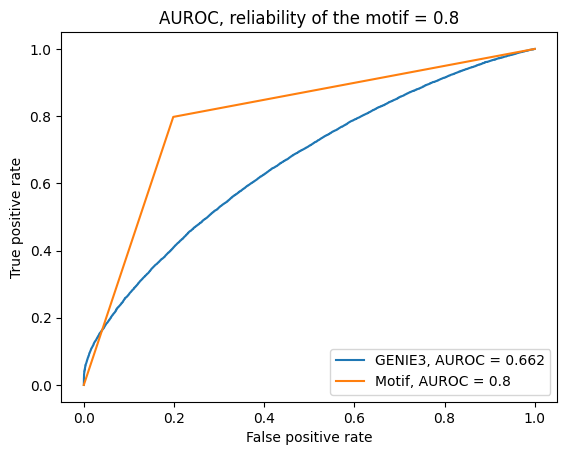

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

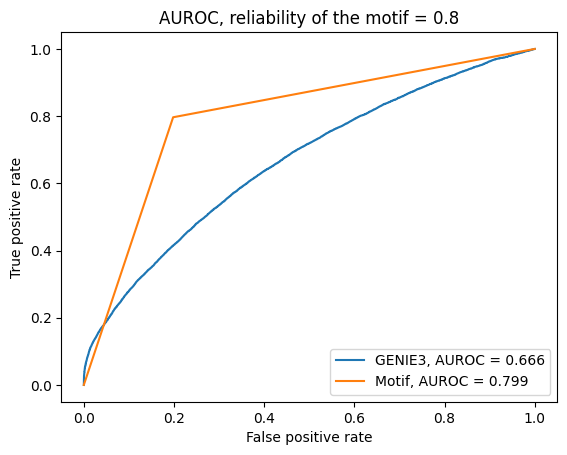

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

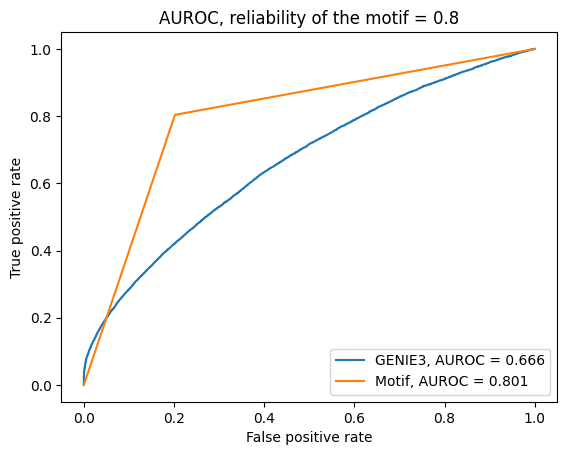

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

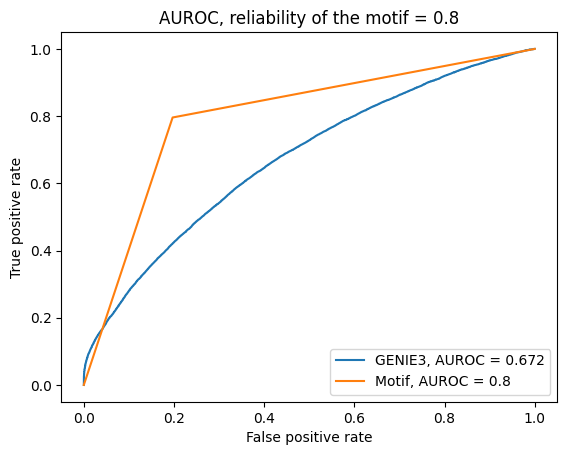

Tree method: RF
K: sqrt
Number of trees: 1000


running single threaded jobs
Gene 1/600...
Gene 2/600...
Gene 3/600...
Gene 4/600...
Gene 5/600...
Gene 6/600...
Gene 7/600...
Gene 8/600...
Gene 9/600...
Gene 10/600...
Gene 11/600...
Gene 12/600...
Gene 13/600...
Gene 14/600...
Gene 15/600...
Gene 16/600...
Gene 17/600...
Gene 18/600...
Gene 19/600...
Gene 20/600...
Gene 21/600...
Gene 22/600...
Gene 23/600...
Gene 24/600...
Gene 25/600...
Gene 26/600...
Gene 27/600...
Gene 28/600...
Gene 29/600...
Gene 30/600...
Gene 31/600...
Gene 32/600...
Gene 33/600...
Gene 34/600...
Gene 35/600...
Gene 36/600...
Gene 37/600...
Gene 38/600...
Gene 39/600...
Gene 40/600...
Gene 41/600...
Gene 42/600...
Gene 43/600...
Gene 44/600...
Gene 45/600...
Gene 46/600...
Gene 47/600...
Gene 48/600...
Gene 49/600...
Gene 50/600...
Gene 51/600...
Gene 52/600...
Gene 53/600...
Gene 54/600...
Gene 55/600...
Gene 56/600...
Gene 57/600...
Gene 58/600...
Gene 59/600...
Gene 60/600...
Gene 61/600...
Gene 62/600...
Ge

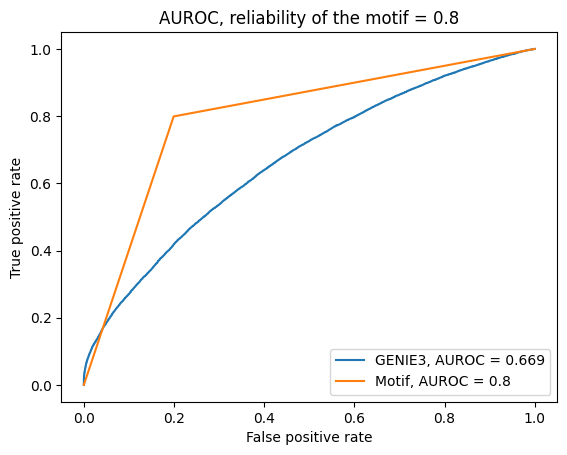

In [7]:
B = 50
res_genie = []
for i in range(B):
    score = simulation()[0]
    res_genie += [score]

In [8]:
print(f"Mean {np.mean(res_genie)}, sd {np.std(res_genie)}")

Mean 0.66436, sd 0.0043486089729935515


## Correlation

In [6]:
def simulation(n = 50, shuffling = 0.2, sparsity = .15, a = 1, approx = True):
    ppi = generate_ppi(TF)
    TFA = generate_tfa(ppi, n)
    R = generate_regulation(G, TF, ppi, sparsity = sparsity, a = a)
    gene_expression = compute_expression(R, TFA)
    motif = generate_motif(R, shuffling)

    model = np.corrcoef((np.vstack([gene_expression, TFA]) + np.random.uniform(0, 1e-6, (600, 50))))[0:500, 500:]
    return notebooks.plot_auroc(R, [model, motif], ["Cor", "Motif"], title = "AUROC, reliability of the motif = " + str(1 - shuffling), approx = approx)

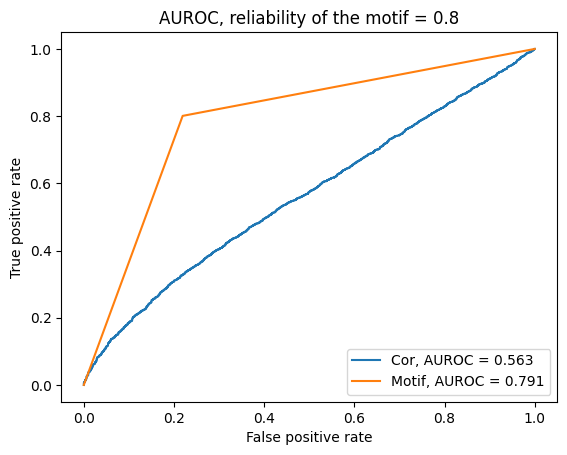

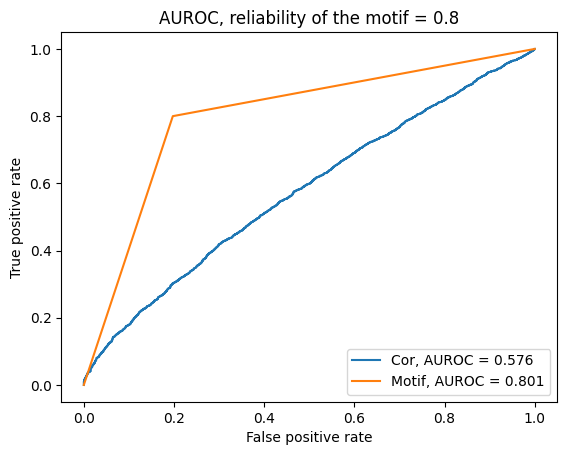

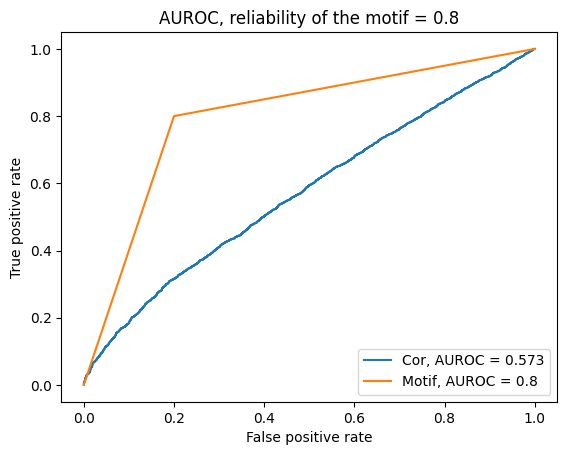

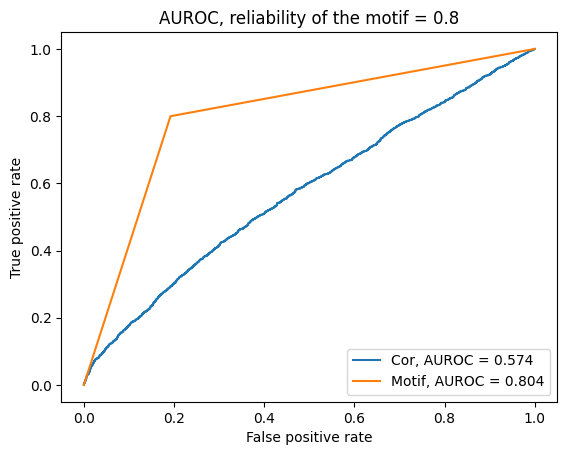

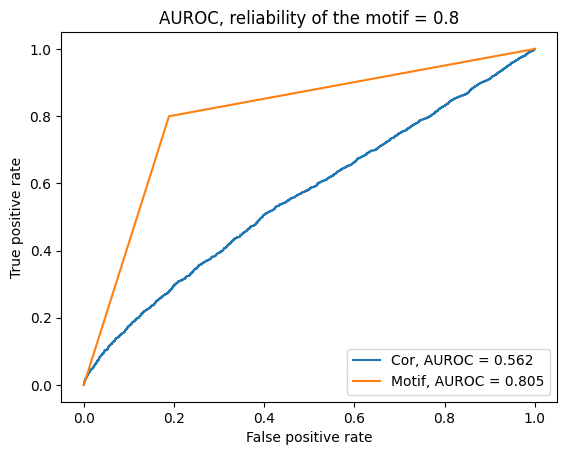

In [7]:
B = 5
res_cor = []
for i in range(B):
    score = simulation()[0]
    res_cor += [score]

In [35]:
print(f"Mean {np.mean(res_cor)}, sd {np.std(res_cor)}")

Mean 0.58202, sd 0.012073922312156898


## WGCNA

In [18]:
def simulation(n = 50, shuffling = 0.2, sparsity = .9, a = 1, approx = True):
    ppi = generate_ppi(TF)
    TFA = generate_tfa(ppi, n)
    R = generate_regulation(G, TF, ppi, sparsity = sparsity, a = a)
    gene_expression = compute_expression(R, TFA)
    motif = generate_motif(R, shuffling)
    C = np.abs(np.corrcoef((np.vstack([gene_expression, TFA])) + np.random.uniform(0, 1e-6, (600, 50))))
    b = 8
    model = (((C ** b) + (C ** b).T) / 2)[0:500, 500:]
    return notebooks.plot_auroc(R, [model, motif], ["Cor", "Motif"], title = "AUROC, reliability of the motif = " + str(1 - shuffling), approx = approx)

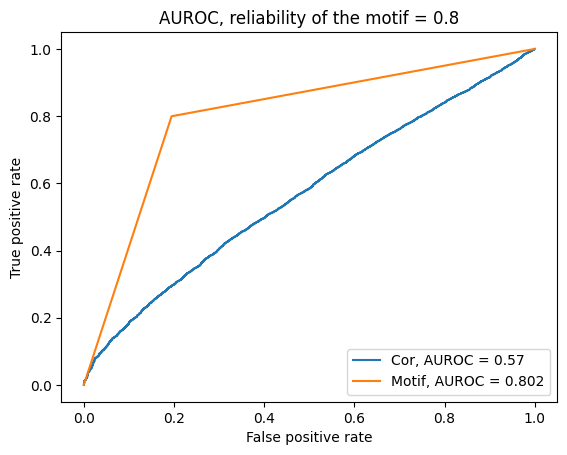

In [19]:
B = 50
res_wgcna = []
for i in range(B):
    score = simulation()[0]
    res_wgcna += [score]

In [148]:
print(f"Mean {np.mean(res_wgcna)}, sd {np.std(res_wgcna)}")

Mean 0.56902, sd 0.005735817291371804
